# Estimating Redshifts using Pixel Variations in Survey Images of Ultra-Diffuse Galaxies Candidates
### <center> A Jupyter Notebook by Jennifer Kadowaki </center>


## Introduction to Ultra-Diffuse Galaxies
Ultra-diffuse galaxies (UDGs)--an enigmatic population of spatially-extended, low surface-brightness galaxies--were recently discovered in large numbers (~1000) near the core of the Coma Cluster (Figure 1a). Despite their low stellar masses, UDGs survive in harsh and dense environments, implying that a subset of UDGs must reside in massive dark matter halos. To date, the largest and most massive UDG known is Dragonfly 44 (DF44; Figure 1b), which is as large as the Milky Way with only 1% of its stellar population. Based on scaling relations, globular cluster counts, and velocity dispersion measurements, the halo of DF44 is estimated to be as massive as the Milky Way’s, challenging our current framework on galaxy evolution: galaxies residing in dark matter halos of this mass regime are maximally efficient, typically producing 100x more stars (Figure 2). To remedy this discrepancy, we must understand what drives star formation in dark matter halos and why UDGs deviate so far from their expected star formation efficiency. My dissertation will (1) confirm the properties (e.g., size, mass) of UDGs to verify that this discrepancy is real and (2) test both large-scale and small-scale environmental mechanisms for halting star formation in UDGs.

UDGs in Coma  | DF44 Spectra
------------- | -------------
<img src="notebook_images/coma_all.png"/> | <img src="notebook_images/df44_spectra.png"/>
**Figure 1a**: The red dots highlight the locations of UDGs in the core of the Coma Galaxy Cluster. These UDGs initially discovered from a survey conducted with the Dragonfly Telephoto Array. The left image is a composite of the Dragonfly g+r bands. A higher resolution i-band image from the Canada-France-Hawaii Telescope (CFHT) confirms the presence of these galaxies.

**Figure 1b**: DF44 is the largest known UDG to date (until I publish my next paper). van Dokkum, et al. (2015b, 2016) confirms that this galaxy is indeed as large and as massive as the Milky Way by acquiring spectroscopic measurements with the Keck II Telescope.

<img src="notebook_images/behroozi13.png" alt="Evolution of Star Formation Efficiency" style="width: 800px;" align="center"/>
**Figure 2**: *The evolution of star formation efficiency across several orders of dark matter halo mass (Behroozi, et al. 2013).* Across most redshifts, the star formation efficiency appears to peak in galaxies residing in a $10^{12} \, \mathrm{M_{\odot}}$ dark matter halo--the Milky Way's estimated dark matter halo mass. If the population of massive UDGs are as massive as the Milky Way, our current understanding of galaxy evolution suggests that they should be extremely efficient at forming stars.


**Footnote**:
$1 \, \mathrm{M_{\odot}}$ (i.e. 1 "solar mass") corresponds to the mass of our Sun. The largest Milky Way dwarfs (i.e. Large and Small Magellanic Clouds) are roughly $10^{10} \, \mathrm{M_{\odot}}$. The Milky Way is considered to be a massive galaxy at $10^{12} \, \mathrm{M_{\odot}}$. Galaxies are often found in large clusterings of galaxies (i.e. galaxy clusters) with an estimated dynamical mass of $10^{14}-10^{15} \, \mathrm{M_{\odot}}$. These environments are extremely violent due to the strong gravitational interactions with other galaxies and the presence of the intercluster medium (ICM)--the extremely hot, x-ray emitting gas existing between clustered galaxies.

## Science Motivation
__What are the drivers of star formation in the dark matter halos of massive galaxies? Are environmental mechanisms responsible for star formation quenching in UDGs?__ To understand why massive UDGs deviate two orders of magnitude from their expected star formation efficiency and to identify potential environmental mechanisms causing this extreme quenching, we must obtain statistics of the local environments of UDGs. To do so, we must find more extremely massive UDGs across environments of various densities. This will require accurate distance measurements to (1) determine whether a candidate is a true UDG by confirming its physical size and (2) properly assess the environment of the UDG.


## Project Goal
Our group is conducting an extensive search throughout the DECaLS, BASS, and MzLS pre-imaging surveys to find large, spatially-extended, low-surface brightness (LSB) objects. So far, we have identified ~50 LSB targets for our next observational run at the Large Binocular Telescope in January 2018. However, as demonstrated in Kadowaki, et al. (in prep), by targeting the largest UDG candiates, our samples are contaminated by small foreground objects (e.g. large dwarf galaxies in the Local Group). __To maximize our efficiency at finding the largest and most massive UDGs for future galaxy evolution and dark matter studies, we must develop an algorithm to crudely estimate the redshifts of UDG candidates from available imaging data.__ We will use the results of this algorithm to select priority targets for our upcoming observation run. This notebook presents a preliminary analysis for our initiative, using machine learning methods.


## Methodology
Our UDG candidates are in proximity to the outskirts of the Coma Cluster. As such, a true UDG will more likely be at the redshift of the cluster. This distance is roughly ~100 Mpc (~326 million light years). For context, the distance to the Coma Cluster is roughly 100x the distance to the edge of the Local Group, where some of our dwarf galaxy contaminates reside. As such, UDGs appear as featureless "blobs." Due to the sheer distance, any structures or features in the UDG will appear washed out compared to our more local contaminants. I will exploit this known feature to help us determine UDG candidates from survery images.

I will use pixel variations as a proxy for clumpiness and structure in our images.

#### Importing Packages

In [1]:
%matplotlib inline

from astropy.io import fits
import glob as g
import errno
import math
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
import numpy as np
import pandas as pd
import os
import gc
import pickle
from scipy.stats import norm
import seaborn as sns
from sklearn.neighbors import KernelDensity
from skimage.measure import label, regionprops

# Turn off annoying matplotlib warning
import warnings
warnings.filterwarnings("ignore", ".*GUI is implemented.*")
warnings.filterwarnings("ignore", ".*LaTeX*")
warnings.filterwarnings("ignore", ".*clobber*")
warnings.filterwarnings("ignore", ".*Future*")

# Pretty Plot Text
plt.rcParams['savefig.facecolor'] = "1."
plt.rc('text', usetex=True)
plt.rc('font', family='serif', size=20)


In [2]:
# CONSTANTS
c  = 3.*10**5 # km/s                  # Speed of Light
H0 = 70 # (km/s)/Mpc                  # Hubble Constant
ARCSEC_IN_PIXEL  = 0.27               # DECam Plate Scale
ARCSEC_IN_RADIAN = 60*60*360/2/np.pi  # Radian to Arcsec Conversion
UDG_RADIUS       = 1.5 # kpc

In [3]:
# Expand the Artificial File Limit of OSx
os.system("ulimit -Sn 10000")
os.system("ulimit -n")

0

#### File Name Convension

In [4]:
data_dir   = 'data'
im_dir     = 'images'
pickle_dir = 'pickle'

fits_file  = '.fits'
pdf_file   = '.pdf'
png_file   = '.png'

info_ext  = '.data'
model_ext = '_model'
sub_ext   = '_subtracted'
unsub_ext = '_unsubtracted'
mask_ext  = '_mask'
res_ext   = '_res'
hist_ext  = '_hist'
kde_ext   = '_kde'

#### Data Directories

In [5]:
data_dir = 'lbt2017a'
ned_dir  = 'lbt2018a/NED'      # UDGs with Known Velocities from NED
coma_dir = 'lbt2018a/Coma'     # UDGs to be Observed
mid_dir  = 'lbt2018a/Middle'   # UDGs to be Observed
s82_dir  = 'lbt2018a/Stripe82' # UDGs to be Observed

all_dir = [data_dir] + [ned_dir] + [coma_dir] + [mid_dir] + [s82_dir]

#### Observation Class
This class stores file name information for all unique objects and observed bands.

In [6]:
class Observation:
    def __init__(self, UDG, band, info, model, sub, unsub, directory):
        self.UDG   = UDG
        self.name  = UDG
        self.band  = band
        
        self.info  = info
        self.model = model
        self.sub   = sub
        self.unsub = unsub
        
        if directory != None: 
            self.dir   = directory
        else:
            self.dir   = data_dir

        # Assign Values Later
        self.bkg_mean   = np.nan
        self.bkg_stdev  = np.nan
        self.gal_sma    = np.nan
        self.gal_mean   = np.nan
        self.gal_median = np.nan
        self.gal_stdev  = np.nan
        self.kde        = []
        
        self.mse          = np.nan
        self.velocity     = np.nan
        self.angular_size = np.nan
        self.radius_hlr   = np.nan
        self.radius_eff   = np.nan

        self.process = False
        
        
    def get_info(self):
        return os.path.join(self.dir, self.UDG, self.band, self.info)

    def get_basename(self):
        return self.get_info()[:-5]
    
    def get_mask(self, mask=mask_ext, fits=fits_file):
        return self.get_basename() + mask + fits
    
    def get_model(self):
        return os.path.join(self.dir, self.UDG, self.band, self.model)
    
    def get_res(self, res=res_ext, fits=fits_file):
        return self.get_basename() + res + fits
    
    def get_sub(self):
        return os.path.join(self.dir, self.UDG, self.band, self.sub)
    
    def get_unsub(self):
        return os.path.join(self.dir, self.UDG, self.band, self.unsub)

#### Constructing New Obervation Objects based on Data Hierarchy
To run this code on the sample data provided, unpack data.zip in the same directory as this Jupyter notebook.

In [7]:
def create_observation_list(directory=data_dir):
    
    obs_list  = []
    
    for obj_path in [path for path in g.glob(directory + '/*') if os.path.isdir(path)]:

        obj = os.path.basename(obj_path)
        band_list = []
        print('\n', obj)

        for band_path in [path for path in g.glob(obj_path  + '/*') if os.path.isdir(path)]:

            band = os.path.basename(band_path)
            band_list.append(band)
            file_list = []
            print('\t',band)

            for file_path in g.glob(band_path + '/*'):

                file = os.path.basename(file_path)
                file_list.append(file)

                if info_ext in file_path:
                    info = file
                    print('\t\tINFO: ',file)

                if model_ext in file_path:
                    model = file
                    print('\t\tMODEL:',file)

                if sub_ext in file_path:
                    sub = file
                    print('\t\tSUB:  ',file)

                if unsub_ext in file_path:
                    unsub = file
                    print('\t\tUNSUB:',file)

            new_obs = Observation(obj, band, info, model, sub, unsub, directory)
            obs_list.append(new_obs)

    return obs_list

In [8]:
obs_list = []

for directory in all_dir:
    obs_list.extend(create_observation_list(directory=directory))


 PU0838589
	 g
		INFO:  PU0838589_260428_g.data
		MODEL: PU0838589_260428_g_model.fits
		SUB:   PU0838589_260428_g_subtracted.fits
		UNSUB: PU0838589_260428_g_unsubtracted.fits
	 z
		INFO:  PU0838589_260428_z.data
		MODEL: PU0838589_260428_z_model.fits
		SUB:   PU0838589_260428_z_subtracted.fits
		UNSUB: PU0838589_260428_z_unsubtracted.fits

 PU0914401
	 g
		INFO:  PU0914401_283036_g.data
		MODEL: PU0914401_283036_g_model.fits
		SUB:   PU0914401_283036_g_subtracted.fits
		UNSUB: PU0914401_283036_g_unsubtracted.fits
	 z
		INFO:  PU0914401_283036_z.data
		MODEL: PU0914401_283036_z_model.fits
		SUB:   PU0914401_283036_z_subtracted.fits
		UNSUB: PU0914401_283036_z_unsubtracted.fits

 PU1006233
	 z
		INFO:  PU1006233_285219_z.data
		MODEL: PU1006233_285219_z_model.fits
		SUB:   PU1006233_285219_z_subtracted.fits
		UNSUB: PU1006233_285219_z_unsubtracted.fits
	 z1
		INFO:  PU1006234_285219_z.data
		MODEL: PU1006234_285219_z_model.fits
		SUB:   PU1006234_285219_z_subtracted.fits
		UNSUB: PU10

In [9]:
ob_li=g.glob(coma_dir)
ba_li = []
for ob in ob_li:
    ba_li.append(os.path.basename(ob))
    
    for ba in [ba for ba in g.glob(ob + '/*') if os.path.isdir(ba)]:
        print(ba)

lbt2018a/Coma/UDG1217267_275955
lbt2018a/Coma/UDG1218389_285051
lbt2018a/Coma/UDG1233477_230210
lbt2018a/Coma/UDG1237294_204442
lbt2018a/Coma/UDG1245277_181803


#### Set Recessional Velocity & Effective Radius

In [10]:
for obs in obs_list:
    
    # LBT 2017a UDGs
    if obs.UDG == 'PU1302165':
        obs.name       = 'DF03'
        obs.velocity   = 10150
        obs.radius_eff = 9.13
        
    elif obs.UDG == 'PU1257017':
        obs.name       = 'DF07'
        obs.velocity   = 6587
        obs.radius_eff = 9.04
        
    elif obs.UDG == 'PU1301303':
        obs.name       = 'DF08'
        obs.velocity   = 7051
        obs.radius_eff = np.nan
        
    elif obs.UDG == 'PU1301582':
        obs.name       = 'DF17'
        obs.velocity   = np.nan
        obs.radius_eff = 8.19
        
    elif obs.UDG == 'PU1253151':
        obs.name       = 'DF30'
        obs.velocity   = 7316
        obs.radius_eff = np.nan
        
    elif obs.UDG == 'PU1258011':
        obs.name       = 'DF40'
        obs.velocity   = 7792
        obs.radius_eff = np.nan
        
    elif obs.UDG == 'PU0838589':
        obs.velocity   = np.nan
        obs.radius_eff = np.nan
        
    elif obs.UDG == 'PU0914401':
        obs.velocity   = 6558
        obs.radius_eff = 4.5
        
    elif obs.UDG == 'PU1006233':
        obs.velocity   = 1202
        obs.radius_eff = 0.7
        
    elif obs.UDG == 'PU1217378':
        obs.name       = 'PU1217377'
        obs.velocity   = 526
        obs.radius_eff = 0.5

    elif obs.UDG == 'PU1221086':
        obs.velocity   = 1287
        obs.radius_eff = 2.4
        
    elif obs.UDG == 'PU1224081':
        obs.velocity   = 37
        obs.radius_eff = 0.04
        
    elif obs.UDG == 'PU1251013':
        obs.velocity   = 6159
        obs.radius_eff = 4.3
        
    elif obs.UDG == 'PU1304535':
        obs.velocity   = 7333
        obs.radius_eff = 4.6
    
    
    
    # NED Objects   
    elif obs.UDG == 'UDG1220185_280134':
        obs.name         = 'UDG1220185'
        obs.velocity     = 2282 # possible correspondence with HI detection 30 arcsec away
        obs.angular_size = 12.7
        obs.radius_eff   = 6.4

    elif obs.UDG == 'UDG1221576_281436':
        obs.name         = 'UDG1221576'
        obs.velocity     = 450
        obs.angular_size = 30.9
        obs.radius_eff   = 15.4

    elif obs.UDG == 'UDG1225265_282910':
        obs.name         = 'UDG1225265'
        obs.velocity     = 483 # on edge of actual galaxy
        obs.angular_size = 29.4
        obs.radius_eff   = 14.7

    elif obs.UDG == 'UDG1230359_273312':
        obs.name         = 'UDG1230359'
        obs.velocity     = -111 # large angular offsets but could be associated
        obs.angular_size = 7.2
        obs.radius_eff   = 3.6
        
        #if udg.band == 'r':
        #    udg.model = 'COADD1230359_273312_z_model.fits'

    elif obs.UDG == 'UDG1239266_274737':
        obs.name         = 'UDG1239266'
        obs.velocity     = 55 # large angular offsets but could be associated
        obs.angular_size = 7.2
        obs.radius_eff   = 3.6

    elif obs.UDG == 'UDG1240017_261920':
        obs.name         = 'UDG1240017'
        obs.velocity     = 451
        obs.angular_size = 11.9
        obs.radius_eff   = 5.9
        
        #if udg.band == 'r':
        #    udg.model = 'COADD1240017_261920_g_model.fits'

    elif obs.UDG == 'UDG1253571':
        obs.name         = 'UDG1253571'
        obs.velocity     = 45 # large angular offsets but could be associated
        obs.angular_size = np.nan
        obs.radius_eff   = np.nan

    elif obs.UDG == 'UDG1255409_191235':
        obs.name         = 'UDG1255409'
        obs.velocity     = 420 # on edge of actual galaxy / large angular offsets but could be associated
        obs.angular_size = 121.
        obs.radius_eff   = 60.4

    elif obs.UDG == 'UDG1302413_215955':
        obs.name         = 'UDG1302413'
        obs.velocity     = 267
        obs.angular_size = 32.
        obs.radius_eff   = 16.

    elif obs.UDG == 'UDG1328467_295950':
        obs.name         = 'UDG1328467'
        obs.velocity     = 0.511 # but offset is 1.3 arcsec to a high redshift cluster!
        obs.angular_size = 4.3
        obs.radius_eff   = 2.2

    else:
        obs.name         = obs.UDG.split('_')[0]
        obs.velocity     = np.nan
        obs.angular_size = np.nan
        
    # udg.radius_eff = physical_size(udg.angular_size, udg.velocity)
    # print(udg.name, "\t", udg.velocity, "km/s\t", str(udg.angular_size) + "\"", "\t", udg.radius_eff)
    

### Functions for Organizing Data
The primary purpose for these functions is to keep consistent file names convensions and data hierarchy.
* create_directory(path)
* fname_split(path)

In [11]:
def create_directory(path):
    
    """Creates a new directory if one does not exist.

    Args:
        path (str): Name of directory

    Returns:
        N/A

    Raises:
        AttributeError: Blahblah
        ValueError: Blahblah.
    """
    
    try:
        os.makedirs(path)
    except OSError as exception:
        if exception.errno != errno.EEXIST:
            raise

In [12]:
def fname_split(path):
    
    """Splits a pathname into a list of strings comprimsed of the directory name,
        the basename of the file, and the file extension.

    Example:
        >>> path = 'dir/fname.ext'
        >>> fname_split('dir/fname.ext')
            ['dir', 'fname', '.ext']

    Args:
        path (str): Name of path

    Returns:
        list: List of 3 strings containing directory, basename, and extension for a file.
              If a directory is called, the list returns empty strings for the basename and extension.
    """
    
    directory = os.path.dirname(path)
    base, ext = os.path.splitext(os.path.basename(path))
    
    return [directory, base, ext]

# DATA

PU0914401 (g) | PU0914401 (z) | Spectroscopy
------------- | ------------- | ------------
<img src="notebook_images/PU0914401_g.png"/> | <img src="notebook_images/PU0914401_z.png"/> | <img src="notebook_images/PU0914401_spec.png" style="width: 325px;"/>

**Figure 3ab**: The cleaned Dark Energy Survey (DES) g- and z-band images of PU0914401. This faint galaxy (at the center of the image) was initially found by applying wavelet transformations on DES survey images to identify  diffuse, spatially-extended sources.

**Figure 3c**: The spectrum of PU0914401 clearly features several Balmer and Ca II H&K absorption lines, as well as [OII] and [OIII] emission lines. Because we can match these features to their rest-frame wavelengths, we know how fast this object is travelling away from us due to the expansion rate of the universe. In the nearby universe, this recessional velocity linearly scales with the object's redshift. (Therefore, we will use recessional velocity ($cz$) synonymously with redshift ($z$) for the remainer of the notebook.)

## Spectroscopic Data from the Large Binocular Telescope (LBT)
We obtain accurate redshifts for UDG candidates by cross-correleating its spectra (Figure 3c) with stellar templates featuring absorption lines commonly found in UDGs. The Doppler shift (i.e. velocity offset) found between the UDG spectra and stellar templates correspond to a velocity attributed to the universe's expansion rate. From Hubble's law, we can determine the distances to these candidates. Given the known angular size of the galaxies, a higher redshift would imply a larger physical size. Table 1 lists the coordinates [RA (J2000), dec (J2000)], the recessional velocity, and the resulting effective radius for each UDG candidate from Kadowaki, et al. (2017) and Kadowaki, et al. (in prep). Of the 14 objects, we sucessfully acquired redshift estimates for 12 candidates.

We will use our spectroscopic redshift measurements in the latter half of the notebook.

 OBJECT   | RA (J2000) | dec (J2000) | $cz$ (km/s) | $R_\mathrm{eff}$ (kpc)
--------- | ---------- | ----------- | ----------- | ----------------------    
DF03      | 13:02:16.5 |  28:57:17   |    10150    | 4.2
DF07      | 12:57:01.7 |  28:23:25   |    6587     | 4.3
DF08      | 13:01:30.4 |  28:22:28   |    7051     | 4.4
DF17      | 13:01:58.3 |  27:50:11   |    ----     | ---
DF30      | 12:53:15.1 |  27:41:15   |    7316     | 3.2
DF40      | 12:58:01.1 |  27:11:26   |    7792     | 2.9
PU0838589 | 08:38:58.9 |  26:04:28   |    ----     | ---
PU0914401 | 09:14:40.1 |  28:30:36   |    6558     | 4.5
PU1006233 | 10:06:23.3 |  28:52:19   |    1202     | 0.7
PU1217377 | 12:17:37.7 |  28:35:20   |    526      | 0.5
PU1221086 | 12:21:08.6 |  29:29:21   |    1287     | 2.4
PU1224081 | 12:24:08.1 |  28:05:45   |    37       | 0.04
PU1251013 | 12:51:01.3 |  27:47:53   |    6159     | 4.3
PU1304535 | 13:04:53.5 |  27:42:53   |    7333     | 4.6

## Imaging Data from the Dark Energy Camera Legacy Survery (DECaLS)

Our imaging data for objects we have observed and for candidates we will be observing are from the DESI pre-imaging surveys. For most of our targets, we have at least two bands (g-, r-, and i-bands) for each object.

### Plotting Imaging Data
All imaging data from the UDG candidates observed in the past are included in data.zip.

In [13]:
def plot_image(im, sigma=3, data=None, plot_file=None, directory=None, shape=(200,200), verbose=False, show=False):

    """ Plots imaging data to a .pdf file.
    If data is not specified, data is acquired by reading in im. Otherwise, the data is written out to im.
    Plots data and writes out displayed image to plot_file in directory. If plot_file is not specified,
    the plot_file is taken from the basename of im with extension '.pdf'. If directory is not specified,
    the plot is written out to a new subdirectory 'images'.
    
    Args:
        im (str): Name of .fits file for (1) reading & importing data or (2) writing out data.
        
        data (:obj:`nd.array`, optional):
            Array containing imaging data. If set to None, the data is acquired by reading it from im,
            a pre-existing .fits file. If it contains an array, the data is written out to im.
        
        pdf_file (str): Name of .pdf file to display data.
        
        directory (str): Name of directory to save pdf_file.
        
    Returns:
        data (float).
        
    """
    
    direc, base, ext = fname_split(im)
    #print('DEBUG: \n\tim=,',im, '\n\td=', direc, '\n\tb=', base, '\n\te=', ext)
    
    if directory == None:
        directory = direc
        im_directory = os.path.join(direc, im_dir)
    else:
        im_directory = os.path.join(directory, im_dir)
        
    create_directory(directory)
    create_directory(im_directory)
    
    #print('DEBUG: \n\tdirectory=', directory, '\n\tim_dir=', im_dir, '\n\tim_directory=', im_directory)
    
    if plot_file == None:
        plot_file = os.path.join(im_directory, base + pdf_file)
        #print('DEBUG: \n\tplot_file=', plot_file)

        
    if data == None:
        if verbose: print("\nReading", im, ".")
        data = fits.getdata(im)
        
        if data.shape != shape:
            data = data[0:shape[0],0:shape[1]]
            hdu = fits.PrimaryHDU(np.array(data))
            hdu.writeto(im, clobber=True)

    else:
        im = os.path.join(directory, base + fits_file)
        if verbose: print("\nWriting", im, ".")
        hdu = fits.PrimaryHDU(np.array(data[0:shape[0],0:shape[1]]))
        hdu.writeto(im, clobber=True)
    
    
    mean  = np.mean(data)
    std  = np.std(data)
       
    
    plt.clf()
    plt.figure(figsize=(8,8))
    plt.gca().set_aspect('equal')
    plt.rcParams.update({'font.size': 22})
    
    ax = plt.subplot(111)    
    ax.set_xlabel(r"x (Pixels)")
    ax.set_ylabel(r"y (Pixels)")
    ax.set_title(r"$\mathrm{}$".format("{" + base.split("_")[0] + "}"))

    im = ax.imshow(data, interpolation='none', aspect='equal', cmap='inferno', vmin=mean-sigma*std, vmax=mean+sigma*std)
    ax.grid(color='w', linestyle='-', linewidth=0.5)

    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    plt.colorbar(im, cax=cax)
        
    if verbose: print("Writing", plot_file, ".")
    plt.savefig(plot_file, format='pdf', bbox_inches='tight', dpi=72)
    plt.savefig(plot_file.replace(pdf_file, png_file), format='png', bbox_inches='tight')

    if show: plt.show()
    plt.close()
    
    return data

#### Plots of all Observed UDG Candidates in Available DES Survey Bands with their Model & Residual Images

In [14]:
for obs in obs_list:

    data_unsub = plot_image(obs.get_unsub(), sigma=2, verbose=True)
    data_model = plot_image(obs.get_model(), sigma=10, verbose=True)
    data_ures  = plot_image(obs.get_res(), data=data_unsub-data_model, sigma=1, verbose=True)


Reading lbt2017a/PU0838589/g/PU0838589_260428_g_unsubtracted.fits .
Writing lbt2017a/PU0838589/g/images/PU0838589_260428_g_unsubtracted.pdf .

Reading lbt2017a/PU0838589/g/PU0838589_260428_g_model.fits .
Writing lbt2017a/PU0838589/g/images/PU0838589_260428_g_model.pdf .

Writing lbt2017a/PU0838589/g/PU0838589_260428_g_res.fits .
Writing lbt2017a/PU0838589/g/images/PU0838589_260428_g_res.pdf .

Reading lbt2017a/PU0838589/z/PU0838589_260428_z_unsubtracted.fits .
Writing lbt2017a/PU0838589/z/images/PU0838589_260428_z_unsubtracted.pdf .

Reading lbt2017a/PU0838589/z/PU0838589_260428_z_model.fits .
Writing lbt2017a/PU0838589/z/images/PU0838589_260428_z_model.pdf .

Writing lbt2017a/PU0838589/z/PU0838589_260428_z_res.fits .
Writing lbt2017a/PU0838589/z/images/PU0838589_260428_z_res.pdf .

Reading lbt2017a/PU0914401/g/PU0914401_283036_g_unsubtracted.fits .
Writing lbt2017a/PU0914401/g/images/PU0914401_283036_g_unsubtracted.pdf .

Reading lbt2017a/PU0914401/g/PU0914401_283036_g_model.fits .
W


Writing lbt2017a/PU1257017/z/PU1257017_282325_z_res.fits .
Writing lbt2017a/PU1257017/z/images/PU1257017_282325_z_res.pdf .

Reading lbt2017a/PU1258011/g/PU1258011_271126_g_unsubtracted.fits .
Writing lbt2017a/PU1258011/g/images/PU1258011_271126_g_unsubtracted.pdf .

Reading lbt2017a/PU1258011/g/PU1258011_271126_g_model.fits .
Writing lbt2017a/PU1258011/g/images/PU1258011_271126_g_model.pdf .

Writing lbt2017a/PU1258011/g/PU1258011_271126_g_res.fits .
Writing lbt2017a/PU1258011/g/images/PU1258011_271126_g_res.pdf .

Reading lbt2017a/PU1258011/r/PU1258011_271126_r_unsubtracted.fits .
Writing lbt2017a/PU1258011/r/images/PU1258011_271126_r_unsubtracted.pdf .

Reading lbt2017a/PU1258011/r/PU1258011_271126_r_model.fits .
Writing lbt2017a/PU1258011/r/images/PU1258011_271126_r_model.pdf .

Writing lbt2017a/PU1258011/r/PU1258011_271126_r_res.fits .
Writing lbt2017a/PU1258011/r/images/PU1258011_271126_r_res.pdf .

Reading lbt2017a/PU1258011/z/PU1258011_271126_z_unsubtracted.fits .
Writing lbt2


Reading lbt2018a/NED/UDG1221576_281436/z/COADD1221576_281436_z_model.fits .
Writing lbt2018a/NED/UDG1221576_281436/z/images/COADD1221576_281436_z_model.pdf .

Writing lbt2018a/NED/UDG1221576_281436/z/COADD1221576_281436_z_res.fits .
Writing lbt2018a/NED/UDG1221576_281436/z/images/COADD1221576_281436_z_res.pdf .

Reading lbt2018a/NED/UDG1225265_282910/g/COADD1225265_282910_g_unsubtracted.fits .
Writing lbt2018a/NED/UDG1225265_282910/g/images/COADD1225265_282910_g_unsubtracted.pdf .

Reading lbt2018a/NED/UDG1225265_282910/g/COADD1225265_282910_g_model.fits .
Writing lbt2018a/NED/UDG1225265_282910/g/images/COADD1225265_282910_g_model.pdf .

Writing lbt2018a/NED/UDG1225265_282910/g/COADD1225265_282910_g_res.fits .
Writing lbt2018a/NED/UDG1225265_282910/g/images/COADD1225265_282910_g_res.pdf .

Reading lbt2018a/NED/UDG1225265_282910/r/COADD1225265_282910_r_unsubtracted.fits .
Writing lbt2018a/NED/UDG1225265_282910/r/images/COADD1225265_282910_r_unsubtracted.pdf .

Reading lbt2018a/NED/UDG1


Reading lbt2018a/Coma/UDG1217267_275955/g/COADD1217267_275955_g_model.fits .
Writing lbt2018a/Coma/UDG1217267_275955/g/images/COADD1217267_275955_g_model.pdf .

Writing lbt2018a/Coma/UDG1217267_275955/g/COADD1217267_275955_g_res.fits .
Writing lbt2018a/Coma/UDG1217267_275955/g/images/COADD1217267_275955_g_res.pdf .

Reading lbt2018a/Coma/UDG1217267_275955/r/COADD1217267_275955_r_unsubtracted.fits .
Writing lbt2018a/Coma/UDG1217267_275955/r/images/COADD1217267_275955_r_unsubtracted.pdf .

Reading lbt2018a/Coma/UDG1217267_275955/r/COADD1217267_275955_r_model.fits .
Writing lbt2018a/Coma/UDG1217267_275955/r/images/COADD1217267_275955_r_model.pdf .

Writing lbt2018a/Coma/UDG1217267_275955/r/COADD1217267_275955_r_res.fits .
Writing lbt2018a/Coma/UDG1217267_275955/r/images/COADD1217267_275955_r_res.pdf .

Reading lbt2018a/Coma/UDG1217267_275955/z/COADD1217267_275955_z_unsubtracted.fits .
Writing lbt2018a/Coma/UDG1217267_275955/z/images/COADD1217267_275955_z_unsubtracted.pdf .

Reading lbt20


Reading lbt2018a/Middle/UDG0849322_293026/r/COADD0849322_293026_r_unsubtracted.fits .
Writing lbt2018a/Middle/UDG0849322_293026/r/images/COADD0849322_293026_r_unsubtracted.pdf .

Reading lbt2018a/Middle/UDG0849322_293026/r/COADD0849322_293026_r_model.fits .
Writing lbt2018a/Middle/UDG0849322_293026/r/images/COADD0849322_293026_r_model.pdf .

Writing lbt2018a/Middle/UDG0849322_293026/r/COADD0849322_293026_r_res.fits .
Writing lbt2018a/Middle/UDG0849322_293026/r/images/COADD0849322_293026_r_res.pdf .

Reading lbt2018a/Middle/UDG0849322_293026/z/COADD0849322_293026_z_unsubtracted.fits .
Writing lbt2018a/Middle/UDG0849322_293026/z/images/COADD0849322_293026_z_unsubtracted.pdf .

Reading lbt2018a/Middle/UDG0849322_293026/z/COADD0849322_293026_z_model.fits .
Writing lbt2018a/Middle/UDG0849322_293026/z/images/COADD0849322_293026_z_model.pdf .

Writing lbt2018a/Middle/UDG0849322_293026/z/COADD0849322_293026_z_res.fits .
Writing lbt2018a/Middle/UDG0849322_293026/z/images/COADD0849322_293026_z_


Reading lbt2018a/Stripe82/UDG0113101_001223/z/COADD0113101_001223_z_model.fits .
Writing lbt2018a/Stripe82/UDG0113101_001223/z/images/COADD0113101_001223_z_model.pdf .

Writing lbt2018a/Stripe82/UDG0113101_001223/z/COADD0113101_001223_z_res.fits .
Writing lbt2018a/Stripe82/UDG0113101_001223/z/images/COADD0113101_001223_z_res.pdf .

Reading lbt2018a/Stripe82/UDG0113177_-001416/g/COADD0113177_001416_g_unsubtracted.fits .
Writing lbt2018a/Stripe82/UDG0113177_-001416/g/images/COADD0113177_001416_g_unsubtracted.pdf .

Reading lbt2018a/Stripe82/UDG0113177_-001416/g/COADD0113177_001416_g_model.fits .
Writing lbt2018a/Stripe82/UDG0113177_-001416/g/images/COADD0113177_001416_g_model.pdf .

Writing lbt2018a/Stripe82/UDG0113177_-001416/g/COADD0113177_001416_g_res.fits .
Writing lbt2018a/Stripe82/UDG0113177_-001416/g/images/COADD0113177_001416_g_res.pdf .

Reading lbt2018a/Stripe82/UDG0113177_-001416/r/COADD0113177_001416_r_unsubtracted.fits .
Writing lbt2018a/Stripe82/UDG0113177_-001416/r/images

## GALFIT Models & Residual Images
Each of the original images were fed into GALFIT--an astronomical software used to model and extract galaxies. The models were fit with parameters characterizing the effective radii (i.e. size), brightness, and sersic index (i.e. concentration of density profile) for each target.

The residual image is the difference between the original image and the GALFIT model. **We use the residual image to determine clumpiness via pixel intensity variations.**

|       | DF03 (g) | DF03 (r) | DF03 (z) | DF07 (g) | DF07 (r) | DF07 (z) |
| :---- | :------: | :------: | :------: | :------: | :------: | :------: |
| ORIG  | <img src="lbt2017a/PU1302165/g/images/PU1302165_285718_g_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2017a/PU1302165/r/images/PU1302165_285718_r_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2017a/PU1302165/z/images/PU1302165_285718_z_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2017a/PU1257017/g/images/PU1257017_282325_g_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2017a/PU1257017/r/images/PU1257017_282325_r_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2017a/PU1257017/z/images/PU1257017_282325_z_unsubtracted.png" style="width: 150px;"/> | 
| MODEL | <img src="lbt2017a/PU1302165/g/images/PU1302165_285718_g_model.png" style="width: 150px;"/> | <img src="lbt2017a/PU1302165/r/images/PU1302165_285718_r_model.png" style="width: 150px;"/> | <img src="lbt2017a/PU1302165/z/images/PU1302165_285718_z_model.png" style="width: 150px;"/> | <img src="lbt2017a/PU1257017/g/images/PU1257017_282325_g_model.png" style="width: 150px;"/> | <img src="lbt2017a/PU1257017/r/images/PU1257017_282325_r_model.png" style="width: 150px;"/> | <img src="lbt2017a/PU1257017/z/images/PU1257017_282325_z_model.png" style="width: 150px;"/> |
| RES   | <img src="lbt2017a/PU1302165/g/images/PU1302165_285718_g_res.png" style="width: 150px;"/> | <img src="lbt2017a/PU1302165/r/images/PU1302165_285718_r_res.png" style="width: 150px;"/> | <img src="lbt2017a/PU1302165/z/images/PU1302165_285718_z_res.png" style="width: 150px;"/> | <img src="lbt2017a/PU1257017/g/images/PU1257017_282325_g_res.png" style="width: 150px;"/> | <img src="lbt2017a/PU1257017/r/images/PU1257017_282325_r_res.png" style="width: 150px;"/> | <img src="lbt2017a/PU1257017/z/images/PU1257017_282325_z_res.png" style="width: 150px;"/> |



|       | DF08 (g) | DF08 (r) | DF08 (z) | DF17 (g) | DF17 (r) | DF17 (z) |
| :---- | :------: | :------: | :------: | :------: | :------: | :------: |
| ORIG  | <img src="lbt2017a/PU1301303/g/images/PU1301303_282229_g_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2017a/PU1301303/r/images/PU1301303_282229_r_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2017a/PU1301303/z/images/PU1301303_282229_z_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2017a/PU1301582/g/images/PU1301582_275011_g_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2017a/PU1301582/r/images/PU1301582_275011_r_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2017a/PU1301582/z/images/PU1301582_275011_z_unsubtracted.png" style="width: 150px;"/> | 
| MODEL | <img src="lbt2017a/PU1301303/g/images/PU1301303_282229_g_model.png" style="width: 150px;"/> | <img src="lbt2017a/PU1301303/r/images/PU1301303_282229_r_model.png" style="width: 150px;"/> | <img src="lbt2017a/PU1301303/z/images/PU1301303_282229_z_model.png" style="width: 150px;"/> | <img src="lbt2017a/PU1301582/g/images/PU1301582_275011_g_model.png" style="width: 150px;"/> | <img src="lbt2017a/PU1301582/r/images/PU1301582_275011_r_model.png" style="width: 150px;"/> | <img src="lbt2017a/PU1301582/z/images/PU1301582_275011_z_model.png" style="width: 150px;"/> |
| RES   | <img src="lbt2017a/PU1301303/g/images/PU1301303_282229_g_res.png" style="width: 150px;"/> | <img src="lbt2017a/PU1301303/r/images/PU1301303_282229_r_res.png" style="width: 150px;"/> | <img src="lbt2017a/PU1301303/z/images/PU1301303_282229_z_res.png" style="width: 150px;"/> | <img src="lbt2017a/PU1301582/g/images/PU1301582_275011_g_res.png" style="width: 150px;"/> | <img src="lbt2017a/PU1301582/r/images/PU1301582_275011_r_res.png" style="width: 150px;"/> | <img src="lbt2017a/PU1301582/z/images/PU1301582_275011_z_res.png" style="width: 150px;"/> |



|       | DF30 (g) | DF30 (z) | DF40 (g) | DF40 (r) | DF40 (z) |
| :---- | :------: | :------: | :------: | :------: | :------: |
| ORIG  | <img src="lbt2017a/PU1253151/g/images/PU1253151_274116_g_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2017a/PU1253151/z/images/PU1253151_274116_z_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2017a/PU1258011/g/images/PU1258011_271126_g_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2017a/PU1258011/r/images/PU1258011_271126_r_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2017a/PU1258011/z/images/PU1258011_271126_z_unsubtracted.png" style="width: 150px;"/> | 
| MODEL | <img src="lbt2017a/PU1253151/g/images/PU1253151_274116_g_model.png" style="width: 150px;"/> | <img src="lbt2017a/PU1253151/z/images/PU1253151_274116_z_model.png" style="width: 150px;"/> | <img src="lbt2017a/PU1258011/g/images/PU1258011_271126_g_model.png" style="width: 150px;"/> | <img src="lbt2017a/PU1258011/r/images/PU1258011_271126_r_model.png" style="width: 150px;"/> | <img src="lbt2017a/PU1258011/z/images/PU1258011_271126_z_model.png" style="width: 150px;"/> |
| RES   | <img src="lbt2017a/PU1253151/g/images/PU1253151_274116_g_res.png" style="width: 150px;"/> | <img src="lbt2017a/PU1253151/z/images/PU1253151_274116_z_res.png" style="width: 150px;"/> | <img src="lbt2017a/PU1258011/g/images/PU1258011_271126_g_res.png" style="width: 150px;"/> | <img src="lbt2017a/PU1258011/r/images/PU1258011_271126_r_res.png" style="width: 150px;"/> | <img src="lbt2017a/PU1258011/z/images/PU1258011_271126_z_res.png" style="width: 150px;"/> |



|       | PU0838589 (g) | PU0838589 (z) | PU0914401 (g) | PU0914401 (z) | PU1006233 (z) | PU1006233 (z) |
| :---- | :-----------: | :-----------: | :-----------: | :-----------: | :-----------: | :-----------: |
| ORIG  | <img src="lbt2017a/PU0838589/g/images/PU0838589_260428_g_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2017a/PU0838589/z/images/PU0838589_260428_z_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2017a/PU0914401/g/images/PU0914401_283036_g_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2017a/PU0914401/z/images/PU0914401_283036_z_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2017a/PU1006233/z/images/PU1006233_285219_z_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2017a/PU1006233/z1/images/PU1006234_285219_z_unsubtracted.png" style="width: 150px;"/> | 
| MODEL | <img src="lbt2017a/PU0838589/g/images/PU0838589_260428_g_model.png" style="width: 150px;"/> | <img src="lbt2017a/PU0838589/z/images/PU0838589_260428_z_model.png" style="width: 150px;"/> | <img src="lbt2017a/PU0914401/g/images/PU0914401_283036_g_model.png" style="width: 150px;"/> | <img src="lbt2017a/PU0914401/z/images/PU0914401_283036_z_model.png" style="width: 150px;"/> | <img src="lbt2017a/PU1006233/z/images/PU1006233_285219_z_model.png" style="width: 150px;"/> | <img src="lbt2017a/PU1006233/z1/images/PU1006234_285219_z_model.png" style="width: 150px;"/> |
| RES   | <img src="lbt2017a/PU0838589/g/images/PU0838589_260428_g_res.png" style="width: 150px;"/> | <img src="lbt2017a/PU0838589/z/images/PU0838589_260428_z_res.png" style="width: 150px;"/> | <img src="lbt2017a/PU0914401/g/images/PU0914401_283036_g_res.png" style="width: 150px;"/> | <img src="lbt2017a/PU0914401/z/images/PU0914401_283036_z_res.png" style="width: 150px;"/> | <img src="lbt2017a/PU1006233/z/images/PU1006233_285219_z_res.png" style="width: 150px;"/> | <img src="lbt2017a/PU1006233/z1/images/PU1006234_285219_z_res.png" style="width: 150px;"/> |



|       | PU1217377 (g) | PU1217377 (r) | PU1217377 (z) | PU1221086 (z) | PU1224081 (g) | PU1224081 (r) | PU1224081 (z) |
| :---- | :-----------: | :-----------: | :-----------: | :-----------: | :-----------: | :-----------: |  :-----------: |
| ORIG  | <img src="lbt2017a/PU1217378/g/images/PU1217378_283521_g_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2017a/PU1217378/r/images/PU1217378_283521_r_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2017a/PU1217378/z/images/PU1217378_283521_z_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2017a/PU1221086/z/images/PU1221086_292920_z_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2017a/PU1224081/g/images/PU1224081_280545_g_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2017a/PU1224081/r/images/PU1224081_280545_r_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2017a/PU1224081/z/images/PU1224081_280545_z_unsubtracted.png" style="width: 150px;"/> |
| MODEL | <img src="lbt2017a/PU1217378/g/images/PU1217378_283521_g_model.png" style="width: 150px;"/> | <img src="lbt2017a/PU1217378/r/images/PU1217378_283521_r_model.png" style="width: 150px;"/> | <img src="lbt2017a/PU1217378/z/images/PU1217378_283521_z_model.png" style="width: 150px;"/> | <img src="lbt2017a/PU1221086/z/images/PU1221086_292920_z_model.png" style="width: 150px;"/> | <img src="lbt2017a/PU1224081/g/images/PU1224081_280545_g_model.png" style="width: 150px;"/> | <img src="lbt2017a/PU1224081/r/images/PU1224081_280545_r_model.png" style="width: 150px;"/> | <img src="lbt2017a/PU1224081/z/images/PU1224081_280545_z_model.png" style="width: 150px;"/> |
| RES   | <img src="lbt2017a/PU1217378/g/images/PU1217378_283521_g_res.png" style="width: 150px;"/> | <img src="lbt2017a/PU1217378/r/images/PU1217378_283521_r_res.png" style="width: 150px;"/> | <img src="lbt2017a/PU1217378/z/images/PU1217378_283521_z_res.png" style="width: 150px;"/> | <img src="lbt2017a/PU1221086/z/images/PU1221086_292920_z_res.png" style="width: 150px;"/> | <img src="lbt2017a/PU1224081/g/images/PU1224081_280545_g_res.png" style="width: 150px;"/> | <img src="lbt2017a/PU1224081/r/images/PU1224081_280545_r_res.png" style="width: 150px;"/> | <img src="lbt2017a/PU1224081/z/images/PU1224081_280545_z_res.png" style="width: 150px;"/> |



|       | PU1251013 (g) | PU1251013 (r) | PU1251013 (z) | PU1304535 (g) | PU1304535 (r) | PU1304535 (z) |
| :---- | :-----------: | :-----------: | :-----------: | :-----------: | :-----------: | :-----------: |
| ORIG  | <img src="lbt2017a/PU1251013/g/images/PU1251013_274753_g_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2017a/PU1251013/r/images/PU1251013_274753_r_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2017a/PU1251013/z/images/PU1251013_274753_z_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2017a/PU1304535/g/images/PU1304535_274253_g_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2017a/PU1304535/r/images/PU1304535_274253_r_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2017a/PU1304535/z/images/PU1304535_274253_z_unsubtracted.png" style="width: 150px;"/> |
| MODEL | <img src="lbt2017a/PU1251013/g/images/PU1251013_274753_g_model.png" style="width: 150px;"/> | <img src="lbt2017a/PU1251013/r/images/PU1251013_274753_r_model.png" style="width: 150px;"/> | <img src="lbt2017a/PU1251013/z/images/PU1251013_274753_z_model.png" style="width: 150px;"/> | <img src="lbt2017a/PU1304535/g/images/PU1304535_274253_g_model.png" style="width: 150px;"/> | <img src="lbt2017a/PU1304535/r/images/PU1304535_274253_r_model.png" style="width: 150px;"/> | <img src="lbt2017a/PU1304535/z/images/PU1304535_274253_z_model.png" style="width: 150px;"/> |
| RES   | <img src="lbt2017a/PU1251013/g/images/PU1251013_274753_g_res.png" style="width: 150px;"/> | <img src="lbt2017a/PU1251013/r/images/PU1251013_274753_r_res.png" style="width: 150px;"/> | <img src="lbt2017a/PU1251013/z/images/PU1251013_274753_z_res.png" style="width: 150px;"/> | <img src="lbt2017a/PU1304535/g/images/PU1304535_274253_g_res.png" style="width: 150px;"/> | <img src="lbt2017a/PU1304535/r/images/PU1304535_274253_r_res.png" style="width: 150px;"/> | <img src="lbt2017a/PU1304535/z/images/PU1304535_274253_z_res.png" style="width: 150px;"/> |

**Figure 4**: Observed UDG candidates with known spectroscopic redshifts.

__Tow Row__: The cleaned Dark Energy Survey (DES) images of UDG candidates. We discovered these faint galaxies (at the center of the image) by applying wavelet transformation on DES survey images to identify any diffuse, spatially-extended sources.

__Center Row__: The galaxy models were created using galfit, a common astronomy software used to estimate key galaxy model parameters.

__Bottom Row__: The difference image is the residual between the cleaned DES image and the model of the UDG. The model does a decent job at subtracting the overall profile of the galaxy. Any remaining structure within the difference image will be used to estimate redshift.

## LBT 2018a Targets

### NED
|       | UDG1220185 (g) | UDG1220185 (r) | UDG1221576 (g) | UDG1221576 (r) | UDG1221576 (z) | UDG1225265 (g) | UDG1225265 (r) |
| :---- | :-----------: | :-----------: | :-----------: | :-----------: | :-----------: | :-----------: |  :-----------: |
| ORIG  | <img src="lbt2018a/NED/UDG1220185_280134/g/images/COADD1220185_280134_g_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1220185_280134/r/images/COADD1220185_280134_r_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1221576_281436/g/images/COADD1221576_281436_g_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1221576_281436/r/images/COADD1221576_281436_r_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1221576_281436/z/images/COADD1221576_281436_z_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1225265_282910/g/images/COADD1225265_282910_g_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1225265_282910/r/images/COADD1225265_282910_r_unsubtracted.png" style="width: 150px;"/>
| MODEL | <img src="lbt2018a/NED/UDG1220185_280134/g/images/COADD1220185_280134_g_model.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1220185_280134/r/images/COADD1220185_280134_r_model.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1221576_281436/g/images/COADD1221576_281436_g_model.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1221576_281436/r/images/COADD1221576_281436_r_model.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1221576_281436/z/images/COADD1221576_281436_z_model.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1225265_282910/g/images/COADD1225265_282910_g_model.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1225265_282910/r/images/COADD1225265_282910_r_model.png" style="width: 150px;"/> 
| RES   | <img src="lbt2018a/NED/UDG1220185_280134/g/images/COADD1220185_280134_g_res.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1220185_280134/r/images/COADD1220185_280134_r_res.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1221576_281436/g/images/COADD1221576_281436_g_res.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1221576_281436/r/images/COADD1221576_281436_r_res.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1221576_281436/z/images/COADD1221576_281436_z_res.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1225265_282910/g/images/COADD1225265_282910_g_res.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1225265_282910/r/images/COADD1225265_282910_r_res.png" style="width: 150px;"/> 


|       | UDG1225265 (z) | UDG1230359 (z) | UDG1239266 (g) | UDG1239266 (r) | UDG1239266 (z) | UDG1240017 (g) | UDG1240017 (z) |
| :---- | :-----------: | :-----------: | :-----------: | :-----------: | :-----------: | :-----------: |  :-----------: |
| ORIG  | <img src="lbt2018a/NED/UDG1225265_282910/z/images/COADD1225265_282910_z_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1230359_273312/z/images/COADD1230359_273312_z_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1239266_274737/g/images/COADD1239266_274737_g_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1239266_274737/r/images/COADD1239266_274737_r_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1239266_274737/z/images/COADD1239266_274737_z_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1240017_261920/g/images/COADD1240017_261920_g_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1240017_261920/z/images/COADD1240017_261920_z_unsubtracted.png" style="width: 150px;"/>
| MODEL | <img src="lbt2018a/NED/UDG1225265_282910/z/images/COADD1225265_282910_z_model.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1230359_273312/z/images/COADD1230359_273312_z_model.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1239266_274737/g/images/COADD1239266_274737_g_model.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1239266_274737/r/images/COADD1239266_274737_r_model.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1239266_274737/z/images/COADD1239266_274737_z_model.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1240017_261920/g/images/COADD1240017_261920_g_model.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1240017_261920/z/images/COADD1240017_261920_z_model.png" style="width: 150px;"/> 
| RES   | <img src="lbt2018a/NED/UDG1225265_282910/z/images/COADD1225265_282910_z_res.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1230359_273312/z/images/COADD1230359_273312_z_res.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1239266_274737/g/images/COADD1239266_274737_g_res.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1239266_274737/r/images/COADD1239266_274737_r_res.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1239266_274737/z/images/COADD1239266_274737_z_res.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1240017_261920/g/images/COADD1240017_261920_g_res.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1240017_261920/z/images/COADD1240017_261920_z_res.png" style="width: 150px;"/> 


|       | UDG1255409 (g) | UDG1255409 (r) | UDG1255409 (z) | UDG1302413 (g) | UDG1302413 (r) | UDG1302413 (z) | UDG1328467 (z) |
| :---- | :-----------: | :-----------: | :-----------: | :-----------: | :-----------: | :-----------: |  :-----------: |
| ORIG  | <img src="lbt2018a/NED/UDG1255409_191235/g/images/COADD1255409_191235_g_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1255409_191235/r/images/COADD1255409_191235_r_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1255409_191235/z/images/COADD1255409_191235_z_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1302413_215955/g/images/COADD1302413_215955_g_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1302413_215955/r/images/COADD1302413_215955_r_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1302413_215955/z/images/COADD1302413_215955_z_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1328467_295950/z/images/COADD1328467_295950_z_unsubtracted.png" style="width: 150px;"/> 
| MODEL | <img src="lbt2018a/NED/UDG1255409_191235/g/images/COADD1255409_191235_g_model.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1255409_191235/r/images/COADD1255409_191235_r_model.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1255409_191235/z/images/COADD1255409_191235_z_model.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1302413_215955/g/images/COADD1302413_215955_g_model.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1302413_215955/r/images/COADD1302413_215955_r_model.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1302413_215955/z/images/COADD1302413_215955_z_model.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1328467_295950/z/images/COADD1328467_295950_z_model.png" style="width: 150px;"/> 
| RES   | <img src="lbt2018a/NED/UDG1255409_191235/g/images/COADD1255409_191235_g_res.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1255409_191235/r/images/COADD1255409_191235_r_res.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1255409_191235/z/images/COADD1255409_191235_z_res.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1302413_215955/g/images/COADD1302413_215955_g_res.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1302413_215955/r/images/COADD1302413_215955_r_res.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1302413_215955/z/images/COADD1302413_215955_z_res.png" style="width: 150px;"/> | <img src="lbt2018a/NED/UDG1328467_295950/z/images/COADD1328467_295950_z_res.png" style="width: 150px;"/> 



### Coma
|       | UDG1217267 (g) | UDG1217267 (r) | UDG1217267 (z) | UDG1218389 (g) | UDG1218389 (r) | UDG1218389 (z) | UDG1233477 (g) |
| :---- | :-----------: | :-----------: | :-----------: | :-----------: | :-----------: | :-----------: |  :-----------: |
| ORIG  | <img src="lbt2018a/Coma/UDG1217267_275955/g/images/COADD1217267_275955_g_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1217267_275955/r/images/COADD1217267_275955_r_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1217267_275955/z/images/COADD1217267_275955_z_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1218389_285051/g/images/COADD1218389_285051_g_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1218389_285051/r/images/COADD1218389_285051_r_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1218389_285051/z/images/COADD1218389_285051_z_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1233477_230210/g/images/COADD1233477_230210_g_unsubtracted.png" style="width: 150px;"/> 
| MODEL | <img src="lbt2018a/Coma/UDG1217267_275955/g/images/COADD1217267_275955_g_model.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1217267_275955/r/images/COADD1217267_275955_r_model.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1217267_275955/z/images/COADD1217267_275955_z_model.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1218389_285051/g/images/COADD1218389_285051_g_model.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1218389_285051/r/images/COADD1218389_285051_r_model.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1218389_285051/z/images/COADD1218389_285051_z_model.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1233477_230210/g/images/COADD1233477_230210_g_model.png" style="width: 150px;"/> 
| RES   | <img src="lbt2018a/Coma/UDG1217267_275955/g/images/COADD1217267_275955_g_res.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1217267_275955/r/images/COADD1217267_275955_r_res.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1217267_275955/z/images/COADD1217267_275955_z_res.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1218389_285051/g/images/COADD1218389_285051_g_res.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1218389_285051/r/images/COADD1218389_285051_r_res.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1218389_285051/z/images/COADD1218389_285051_z_res.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1233477_230210/g/images/COADD1233477_230210_g_res.png" style="width: 150px;"/> 


|       | UDG1233477 (r) | UDG1237294 (g) | UDG1237294 (r) | UDG1237294 (z) | UDG1245277 (g) | UDG1245277 (r) | UDG1245277 (z) |
| :---- | :-----------: | :-----------: | :-----------: | :-----------: | :-----------: | :-----------: |  :-----------: |
| ORIG  | <img src="lbt2018a/Coma/UDG1233477_230210/r/images/COADD1233477_230210_r_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1237294_204442/g/images/COADD1237294_204442_g_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1237294_204442/r/images/COADD1237294_204442_r_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1237294_204442/z/images/COADD1237294_204442_z_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1245277_181803/g/images/COADD1245277_181803_g_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1245277_181803/r/images/COADD1245277_181803_r_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1245277_181803/z/images/COADD1245277_181803_z_unsubtracted.png" style="width: 150px;"/> 
| MODEL | <img src="lbt2018a/Coma/UDG1233477_230210/r/images/COADD1233477_230210_r_model.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1237294_204442/g/images/COADD1237294_204442_g_model.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1237294_204442/r/images/COADD1237294_204442_r_model.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1237294_204442/z/images/COADD1237294_204442_z_model.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1245277_181803/g/images/COADD1245277_181803_g_model.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1245277_181803/r/images/COADD1245277_181803_r_model.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1245277_181803/z/images/COADD1245277_181803_z_model.png" style="width: 150px;"/>
| RES   | <img src="lbt2018a/Coma/UDG1233477_230210/r/images/COADD1233477_230210_r_res.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1237294_204442/g/images/COADD1237294_204442_g_res.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1237294_204442/r/images/COADD1237294_204442_r_res.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1237294_204442/z/images/COADD1237294_204442_z_res.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1245277_181803/g/images/COADD1245277_181803_g_res.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1245277_181803/r/images/COADD1245277_181803_r_res.png" style="width: 150px;"/> | <img src="lbt2018a/Coma/UDG1245277_181803/z/images/COADD1245277_181803_z_res.png" style="width: 150px;"/> 



### Middle
|       | UDG0842120 (g) | UDG0842120 (r) | UDG0842120 (z) | UDG0849322 (r) | UDG0849322 (z) | UDG0852477 (g) |
| :---- | :-----------: | :-----------: | :-----------: | :-----------: | :-----------: | :-----------: |
| ORIG  | <img src="lbt2018a/Middle/UDG0842120_301954/g/images/COADD0842120_301954_g_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0842120_301954/r/images/COADD0842120_301954_r_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0842120_301954/z/images/COADD0842120_301954_z_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0849322_293026/r/images/COADD0849322_293026_r_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0849322_293026/z/images/COADD0849322_293026_z_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0852477_324943/g/images/COADD0852477_324943_g_unsubtracted.png" style="width: 150px;"/> 
| MODEL | <img src="lbt2018a/Middle/UDG0842120_301954/g/images/COADD0842120_301954_g_model.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0842120_301954/r/images/COADD0842120_301954_r_model.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0842120_301954/z/images/COADD0842120_301954_z_model.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0849322_293026/r/images/COADD0849322_293026_r_model.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0849322_293026/z/images/COADD0849322_293026_z_model.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0852477_324943/g/images/COADD0852477_324943_g_model.png" style="width: 150px;"/> 
| RES   | <img src="lbt2018a/Middle/UDG0842120_301954/g/images/COADD0842120_301954_g_res.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0842120_301954/r/images/COADD0842120_301954_r_res.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0842120_301954/z/images/COADD0842120_301954_z_res.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0849322_293026/r/images/COADD0849322_293026_r_res.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0849322_293026/z/images/COADD0849322_293026_z_res.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0852477_324943/g/images/COADD0852477_324943_g_res.png" style="width: 150px;"/> 


|       | UDG0852477 (r) | UDG0854195 (g) | UDG0854195 (r) | UDG0854195 (z) | UDG0855549 (g) | UDG0855549 (r) |
| :---- | :-----------: | :-----------: | :-----------: | :-----------: | :-----------: | :-----------: |
| ORIG  | <img src="lbt2018a/Middle/UDG0852477_324943/r/images/COADD0852477_324943_r_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0854195_310242/g/images/COADD0854195_310242_g_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0854195_310242/r/images/COADD0854195_310242_r_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0854195_310242/z/images/COADD0854195_310242_z_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0855549_312823/g/images/COADD0855549_312823_g_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0855549_312823/r/images/COADD0855549_312823_r_unsubtracted.png" style="width: 150px;"/> 
| MODEL | <img src="lbt2018a/Middle/UDG0852477_324943/r/images/COADD0852477_324943_r_model.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0854195_310242/g/images/COADD0854195_310242_g_model.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0854195_310242/r/images/COADD0854195_310242_r_model.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0854195_310242/z/images/COADD0854195_310242_z_model.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0855549_312823/g/images/COADD0855549_312823_g_model.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0855549_312823/r/images/COADD0855549_312823_r_model.png" style="width: 150px;"/> 
| RES   | <img src="lbt2018a/Middle/UDG0852477_324943/r/images/COADD0852477_324943_r_res.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0854195_310242/g/images/COADD0854195_310242_g_res.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0854195_310242/r/images/COADD0854195_310242_r_res.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0854195_310242/z/images/COADD0854195_310242_z_res.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0855549_312823/g/images/COADD0855549_312823_g_res.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0855549_312823/r/images/COADD0855549_312823_r_res.png" style="width: 150px;"/> 


|       | UDG0855549 (z) | UDG0856259 (g) | UDG0856259 (r) |
| :---- | :-----------: | :-----------: | :-----------: |
| ORIG  | <img src="lbt2018a/Middle/UDG0855549_312823/z/images/COADD0855549_312823_z_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0856259_315502/g/images/COADD0856259_315502_g_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0856259_315502/r/images/COADD0856259_315502_r_unsubtracted.png" style="width: 150px;"/> 
| MODEL | <img src="lbt2018a/Middle/UDG0855549_312823/z/images/COADD0855549_312823_z_model.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0856259_315502/g/images/COADD0856259_315502_g_model.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0856259_315502/r/images/COADD0856259_315502_r_model.png" style="width: 150px;"/> 
| RES   | <img src="lbt2018a/Middle/UDG0855549_312823/z/images/COADD0855549_312823_z_res.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0856259_315502/g/images/COADD0856259_315502_g_res.png" style="width: 150px;"/> | <img src="lbt2018a/Middle/UDG0856259_315502/r/images/COADD0856259_315502_r_res.png" style="width: 150px;"/> 



### Stripe 82
|       | UDG0112072 (g) | UDG0112072 (r) | UDG0112072 (z) | UDG0113101 (g) | UDG0113101 (z) | UDG0113177 (g) |
| :---- | :-----------: | :-----------: | :-----------: | :-----------: | :-----------: | :-----------: |
| ORIG | <img src="lbt2018a/Stripe82/UDG0112072_012904/g/images/COADD0112072_012904_g_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0112072_012904/r/images/COADD0112072_012904_r_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0112072_012904/z/images/COADD0112072_012904_z_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0113101_001223/g/images/COADD0113101_001223_g_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0113101_001223/z/images/COADD0113101_001223_z_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0113177_-001416/g/images/COADD0113177_001416_g_unsubtracted.png" style="width: 150px;"/>
| MODEL | <img src="lbt2018a/Stripe82/UDG0112072_012904/g/images/COADD0112072_012904_g_model.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0112072_012904/r/images/COADD0112072_012904_r_model.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0112072_012904/z/images/COADD0112072_012904_z_model.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0113101_001223/g/images/COADD0113101_001223_g_model.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0113101_001223/z/images/COADD0113101_001223_z_model.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0113177_-001416/g/images/COADD0113177_001416_g_model.png" style="width: 150px;"/> 
| RES   | <img src="lbt2018a/Stripe82/UDG0112072_012904/g/images/COADD0112072_012904_g_res.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0112072_012904/r/images/COADD0112072_012904_r_res.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0112072_012904/z/images/COADD0112072_012904_z_res.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0113101_001223/g/images/COADD0113101_001223_g_res.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0113101_001223/z/images/COADD0113101_001223_z_res.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0113177_-001416/g/images/COADD0113177_001416_g_res.png" style="width: 150px;"/> 


|       | UDG0113177 (r) | UDG0113177 (z) | UDG0115016 (g) | UDG0115016 (r) | UDG0115016 (z) | UDG0239472 (g) |
| :---- | :-----------: | :-----------: | :-----------: | :-----------: | :-----------: | :-----------: |
| ORIG | <img src="lbt2018a/Stripe82/UDG0113177_-001416/r/images/COADD0113177_001416_r_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0113177_-001416/z/images/COADD0113177_001416_z_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0115016_-012850/g/images/COADD0115016_-012850_g_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0115016_-012850/r/images/COADD0115016_-012850_r_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0115016_-012850/z/images/COADD0115016_-012850_z_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0239472_011236/g/images/COADD0239472_011236_g_unsubtracted.png" style="width: 150px;"/> 
| MODEL | <img src="lbt2018a/Stripe82/UDG0113177_-001416/r/images/COADD0113177_001416_r_model.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0113177_-001416/z/images/COADD0113177_001416_z_model.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0115016_-012850/g/images/COADD0115016_-012850_g_model.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0115016_-012850/r/images/COADD0115016_-012850_r_model.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0115016_-012850/z/images/COADD0115016_-012850_z_model.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0239472_011236/g/images/COADD0239472_011236_g_model.png" style="width: 150px;"/> 
| RES   | <img src="lbt2018a/Stripe82/UDG0113177_-001416/r/images/COADD0113177_001416_r_res.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0113177_-001416/z/images/COADD0113177_001416_z_res.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0115016_-012850/g/images/COADD0115016_-012850_g_res.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0115016_-012850/r/images/COADD0115016_-012850_r_res.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0115016_-012850/z/images/COADD0115016_-012850_z_res.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0239472_011236/g/images/COADD0239472_011236_g_res.png" style="width: 150px;"/> |


|       | UDG0239472 (r) | UDG0244338 (g) | UDG0244338 (r) | UDG0244338 (z) |
| :---- | :-----------: | :-----------: | :-----------: | :-----------: |
| ORIG | <img src="lbt2018a/Stripe82/UDG0239472_011236/r/images/COADD0239472_011236_r_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0244338_-001601/g/images/COADD0244338_001601_g_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0244338_-001601/r/images/COADD0244338_001601_r_unsubtracted.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0244338_-001601/z/images/COADD0244338_001601_z_unsubtracted.png" style="width: 150px;"/> |
| MODEL | <img src="lbt2018a/Stripe82/UDG0239472_011236/r/images/COADD0239472_011236_r_model.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0244338_-001601/g/images/COADD0244338_001601_g_model.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0244338_-001601/r/images/COADD0244338_001601_r_model.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0244338_-001601/z/images/COADD0244338_001601_z_model.png" style="width: 150px;"/> |
| RES   | <img src="lbt2018a/Stripe82/UDG0239472_011236/r/images/COADD0239472_011236_r_res.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0244338_-001601/g/images/COADD0244338_001601_g_res.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0244338_-001601/r/images/COADD0244338_001601_r_res.png" style="width: 150px;"/> | <img src="lbt2018a/Stripe82/UDG0244338_-001601/z/images/COADD0244338_001601_z_res.png" style="width: 150px;"/> |


# Separating the UDG Candidate from the Background
Like most astronomical objects, there's no hard boundary between where the object starts and ends. (e.g. Where is the boundary of the our atmosphere? It's hard to define where it "stops.")

We define the half-light radius--a commonly used metric in extragalactic astronomy--as the radius which contains half of the object's light. To define this boundary, we typicaly use a true astronomical image. However, due to contamination from background objects (e.g. the bright source in the bottom left corner), we will use the model image (center) for the purpose of this project. The model contains a uniform background and a smooth sersic profile for the galaxy.

In [15]:
def background_statistics(obs, percent=40, plot=True, verbose=False):
    
    """Naively estimates the background statistics from model image.
    This algorithm assumes that any pixel value above some percentile (percent) has some light
    contribution from diffuse UDG candidates or other astronomical contaminants, as opposed to
    background noise from pixel-to-pixel variations. The method estimates the mean and standard
    deviation in pixel intensities within the identified background, primarily for the use to
    create more sophisticated object masks.
    
    
    Args:
        data (nd.array): Input image assumed to be a 2D array.
        
        percent (float): Percentile value assumed to be [0,100). All pixel intensities that
            fall below this percentile threshold is assumed to be the background.
            
        plot (bool): Flag to create a plot of the background mask.
        
    Returns:
        bkg_mean (float):  Mean value of background region.
        
        bkg_stdev (float): Standard deviation of the background region.
        
    """
    
    model = fits.getdata(obs.get_model())
    
    # Quick & Unsophisticated Statistics of UDG Candidate Models
    mini  = np.min(model)    # Min Value in the Model
    maxi  = np.max(model)    # Max
    mean  = np.mean(model)   # Mean
    stdev = np.std(model)    # Standard Deviation of Pixel Values

    if verbose:
        print("{0} ({1})".format(obs.name, obs.band))
        print("Global Image",
              "\n\tMEAN: ", mean,
              "\n\tSTD:  ", stdev,
              "\n\tMIN:  ", mini,
              "\n\tMAX:  ", maxi)

    # Image Statistics on Isolated Background
    bkg_mask      = np.array(model < np.percentile(model, percent))
    obs.bkg_mean  = np.mean(model[bkg_mask])
    obs.bkg_stdev = np.std(model[bkg_mask])

    if verbose:
        print("Background",
              "\n\tMean: %.3f" % obs.bkg_mean,
              "\n\tSTD:  %.3f" % obs.bkg_stdev)
    
    if plot:
        
        plt.clf()
        plt.figure(figsize=(8,8))
        plt.gca().set_aspect('equal')
        plt.rcParams.update({'font.size': 22})

        ax = plt.subplot(111)    
        ax.set_xlabel(r"x (Pixels)")
        ax.set_ylabel(r"y (Pixels)")
        ax.set_title("Background Statistics for {0} ({1})".format(obs.name, obs.band))

        im = ax.imshow(plot_bm, interpolation='none', aspect='equal', cmap='inferno', vmin=mean-sigma*std, vmax=mean+sigma*std)
        ax.grid(color='w', linestyle='-', linewidth=0.5)

        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="5%", pad=0.05)
        plt.colorbar(im, cax=cax)

        
        if show: plt.show()
        plt.close()
    
        del plot_bm
        
    
    del model, bkg_mask
    gc.collect()
    
    return obs.bkg_mean, obs.bkg_stdev 

#### Computing the Physical Size of the UDG Candidate
The angular diameter distance is $d_A \equiv \frac{x}{\theta}$, where $x$ is the physical size and $\theta$ is the angular size of an object. Assuming that the universe has a flat cosmology, $d_A = \frac{S_k(r)}{1+z} = \frac{r(z)}{1+z}$, such that $S_k$ is the comoving coordinate for the Friedmann–Lemaître–Robertson–Walker (FLRW) metric, $r$ is the comoving distance, and $z$ is the redshift. Equating the two relations results in:
<center> $x = \frac{r(z) \cdot \theta}{1+z}$. </center>

The comoving distance is defined as $r(z) = \int\limits_0^z \frac{c dz}{H(z)}$, where $c$ is the speed of light and $H(z)$ is the Hubble parameter. In the very low-redshift universe (where the universe's acceleration is undetectable), $H(z) = H_0 \approx 70 \, \mathrm{\frac{km/s}{Mpc}}$, the Hubble constant. This results in the relation:
<center> $x = \frac{cz}{H_0} \frac{\theta}{1+z} = \frac{\theta}{H_0} \frac{v}{1+v/c}$. </center>

In [16]:
def physical_size(angular_size, velocity):
    """Computes an object's physical size (in kpc).
    
    Args:
        angular_size (float): An object's observed angular size (in arcseconds).
        velocity (float): An object's measured recessional velocity (in km/s).
    
    Returns:
        (float): The object's physical size (in kpc).
    """
    
    return velocity * angular_size / ARCSEC_IN_RADIAN / H0 / (1. + velocity/c) * 1000.

In [17]:
def half_light_mask(obs, percent=70, plow=0, phigh=100, threshold=0.005, plot=True, verbose=False):
    
    """Computes the half-light radius by using a binary search method to find the optimal radius.
    
    
    Args:
        obs (Observation): 
        
        percent (float): Percentile value assumed to be [0,100). All pixel intensities that
            fall below this percentile threshold is assumed to be the background.
        
        plow (float): Lower boundary
        
        phigh (float): Upper boundary
        
        threshold (float): Increment and Precision of Half-light Radii
        
        plot (bool): Flag to create a plot of the background mask.
        
        verbose (bool): Flag to output progress.
        
    Returns:
        
        stdev (float): Standard deviation of the background region.
        
    """
    # GET DATA FROM OBSERVATION
    model     = fits.getdata(obs.get_model())
    bkg_mean  = obs.bkg_mean
    bkg_stdev = obs.bkg_stdev
    mask_file = obs.get_mask()
 
    nobkg = model - bkg_mean
    mask  = np.array(nobkg > np.percentile(nobkg, percent))
    #print ("\nPercentile:", percent)
    
    # STATISTICS INSIDE MASK
    in_flux  = np.sum(nobkg[mask])    # Total Flux of Background-Subtracted Galaxy
    in_mean  = np.mean(nobkg[mask])   # Mean of Background-Subtracted Galaxy
    in_stdev = np.std(nobkg[mask])    # StDev of Background-Subtracted Galaxy
    in_area  = np.sum(mask)           # Pixels Contained in Galaxy
    
    # STATISTICS OUTSIDE MASK
    ext_flux  = np.sum(nobkg[~mask])   # Total Flux Outside of the Background-Subtracted Galaxy
    ext_mean  = np.mean(nobkg[~mask])  # Mean Outside of the Background-Subtracted Galaxy
    ext_stdev = np.std(nobkg[~mask])   # StDev Outside of the Background-Subtracted Galaxy
    ext_area  = np.sum(~mask)               # Pixels Contained Outside of the Galaxy
    
    # Binary Search for Optimal HLR Threshold via Recursion
    if in_flux/ext_flux-1 > threshold:
        return half_light_mask(obs, percent + (phigh-percent)/2, plow=percent, phigh=phigh,   threshold=threshold, plot=plot, verbose=verbose)
    elif ext_flux/in_flux-1 > threshold:
        return half_light_mask(obs, percent - (percent-plow)/2., plow=plow,    phigh=percent, threshold=threshold, plot=plot, verbose=verbose)
    else:
        if verbose:
            print("\n{0} ({1}) MODEL".format(obs.name, obs.band),
                  "\nPercentile: %.3f" % percent)
            
            print("\nInterior",
                  "\n\tFlux: %.3f ADU" % in_flux,
                  "\n\tMean: %.3f ADU" % in_mean,
                  "\n\tRMS:  %.3f ADU" % in_stdev,
                  "\n\tArea: %s ADU"   % in_area)
            
            print("Exterior",
                  "\n\tFlux: %.3f ADU" % ext_flux,
                  "\n\tMean: %.3f ADU" % ext_mean,
                  "\n\tRMS:  %.3f ADU" % ext_stdev,
                  "\n\tArea: %s ADU"   % ext_area)

        # Plots HLR Mask
        plot_in = model * 1.
        plot_in[~mask] = np.nan    
        
        plt.clf()
        plt.figure(figsize=(8,8))
        plt.gca().set_aspect('equal')
        plt.rcParams.update({'font.size': 22})

        ax = plt.subplot(111)    
        ax.set_xlabel(r"x (Pixels)")
        ax.set_ylabel(r"y (Pixels)")
        ax.set_title("HLR Mask for {0} ({1})".format(obs.name.split("_")[0], obs.band))

        im = ax.imshow(plot_in, interpolation='none', aspect='equal', cmap='inferno')
        ax.grid(color='w', linestyle='-', linewidth=0.5)

        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="5%", pad=0.05)
        plt.colorbar(im, cax=cax)
        
        
        
        # Overlays Ellipsoid Statistics & Computes Effective Radii
        regions = regionprops(label(mask))

        for props in regions:
            y0, x0 = props.centroid
            orientation = props.orientation
            x1 = x0 + math.cos(orientation) * 0.5 * props.major_axis_length
            y1 = y0 - math.sin(orientation) * 0.5 * props.major_axis_length
            x2 = x0 - math.sin(orientation) * 0.5 * props.minor_axis_length
            y2 = y0 - math.cos(orientation) * 0.5 * props.minor_axis_length

            plt.plot((x0, x1), (y0, y1), '-r', linewidth=2.5)
            plt.plot((x0, x2), (y0, y2), '-r', linewidth=2.5)
            plt.plot(x0, y0, '.g', markersize=15)

            obs.gal_sma      = props.major_axis_length
            obs.angular_size = ARCSEC_IN_PIXEL * props.major_axis_length
            #obs.radius_hlr   = physical_size(obs.angular_size, obs.velocity)
            if verbose:
                print("\nSEMI-MAJOR AXIS:   %.3f pixels" % obs.gal_sma,
                      "\nANGULAR SIZE:      %.3f arcsec" % obs.angular_size)#,
                      #"\nHalf-Light Radius: %.3f kpc"    % obs.radius_hlr)
        
        
        plt.savefig(mask_file.replace(pdf_file, png_file), format='png', bbox_inches='tight')

        if plot: plt.show()
        plt.close()

    hdu = fits.PrimaryHDU(mask * 1.)
    hdu.writeto(mask_file, clobber=True)
    
    del hdu, model, nobkg, plot_in
    gc.collect()
    
    return mask, percent


PU0838589 (g) MODEL 
Percentile: 96.953

Interior 
	Flux: 2464.230 ADU 
	Mean: 2.022 ADU 
	RMS:  0.882 ADU 
	Area: 1219 ADU
Exterior 
	Flux: 2467.209 ADU 
	Mean: 0.064 ADU 
	RMS:  0.155 ADU 
	Area: 38781 ADU

SEMI-MAJOR AXIS:   51.196 pixels 
ANGULAR SIZE:      13.823 arcsec


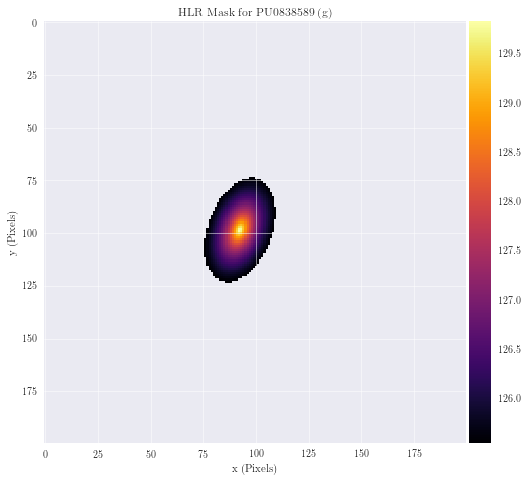


PU0838589 (z) MODEL 
Percentile: 92.773

Interior 
	Flux: 14289.117 ADU 
	Mean: 4.944 ADU 
	RMS:  1.977 ADU 
	Area: 2890 ADU
Exterior 
	Flux: 14281.949 ADU 
	Mean: 0.385 ADU 
	RMS:  0.589 ADU 
	Area: 37110 ADU

SEMI-MAJOR AXIS:   93.885 pixels 
ANGULAR SIZE:      25.349 arcsec


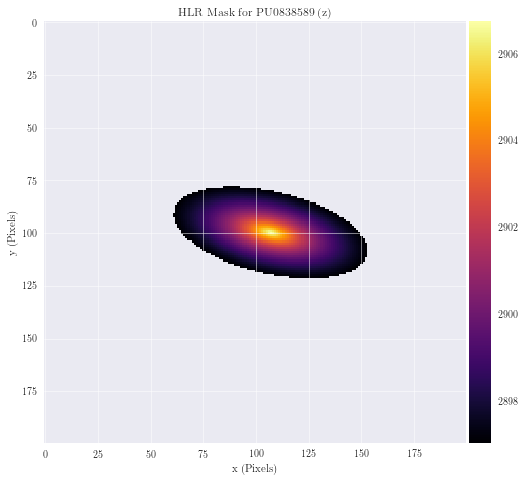


PU0914401 (g) MODEL 
Percentile: 93.672

Interior 
	Flux: 8114.725 ADU 
	Mean: 3.205 ADU 
	RMS:  1.320 ADU 
	Area: 2532 ADU
Exterior 
	Flux: 8094.889 ADU 
	Mean: 0.216 ADU 
	RMS:  0.350 ADU 
	Area: 37468 ADU

SEMI-MAJOR AXIS:   76.400 pixels 
ANGULAR SIZE:      20.628 arcsec


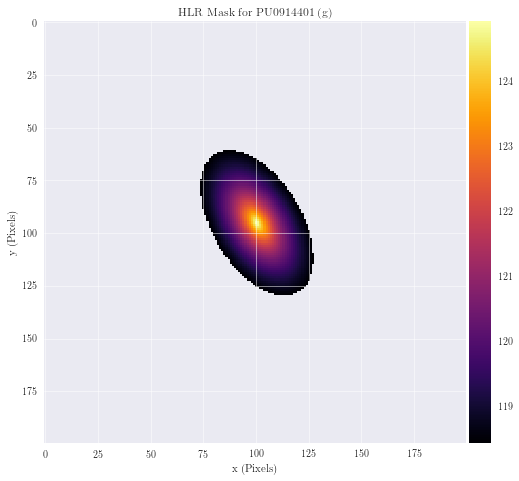


PU0914401 (z) MODEL 
Percentile: 95.391

Interior 
	Flux: 16901.008 ADU 
	Mean: 9.165 ADU 
	RMS:  3.889 ADU 
	Area: 1844 ADU
Exterior 
	Flux: 16976.271 ADU 
	Mean: 0.445 ADU 
	RMS:  0.860 ADU 
	Area: 38156 ADU

SEMI-MAJOR AXIS:   55.485 pixels 
ANGULAR SIZE:      14.981 arcsec


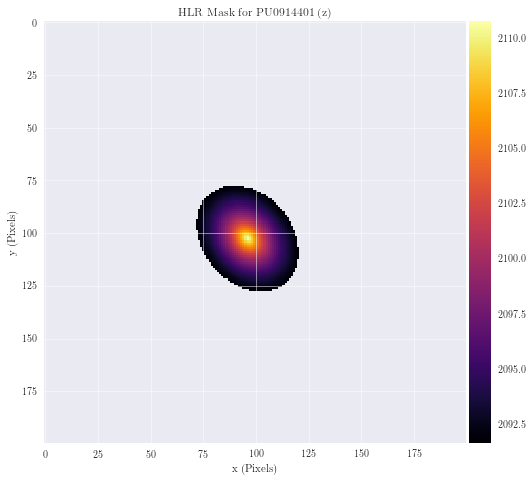


PU1006233 (z) MODEL 
Percentile: 96.562

Interior 
	Flux: 11213.023 ADU 
	Mean: 8.155 ADU 
	RMS:  3.553 ADU 
	Area: 1375 ADU
Exterior 
	Flux: 11180.700 ADU 
	Mean: 0.289 ADU 
	RMS:  0.660 ADU 
	Area: 38625 ADU

SEMI-MAJOR AXIS:   52.972 pixels 
ANGULAR SIZE:      14.302 arcsec


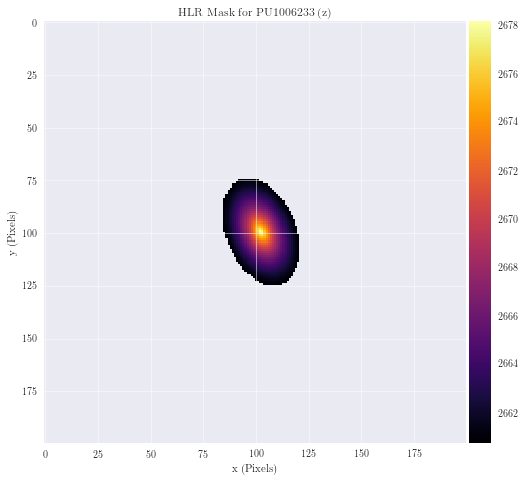


PU1006233 (z1) MODEL 
Percentile: 95.664

Interior 
	Flux: 10890.462 ADU 
	Mean: 6.277 ADU 
	RMS:  2.687 ADU 
	Area: 1735 ADU
Exterior 
	Flux: 10908.631 ADU 
	Mean: 0.285 ADU 
	RMS:  0.570 ADU 
	Area: 38265 ADU

SEMI-MAJOR AXIS:   56.800 pixels 
ANGULAR SIZE:      15.336 arcsec


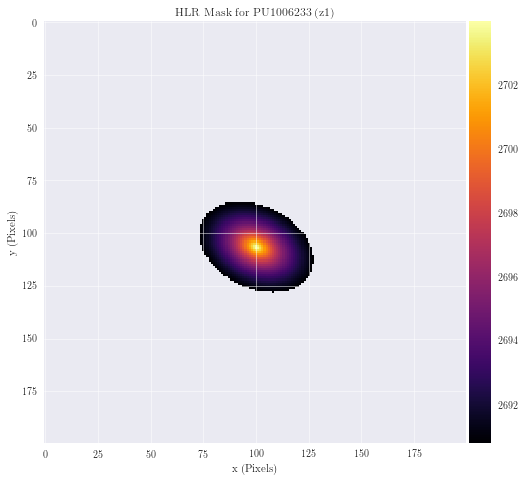


PU1217377 (g) MODEL 
Percentile: 90.625

Interior 
	Flux: 16868.559 ADU 
	Mean: 4.498 ADU 
	RMS:  1.631 ADU 
	Area: 3750 ADU
Exterior 
	Flux: 16920.740 ADU 
	Mean: 0.467 ADU 
	RMS:  0.631 ADU 
	Area: 36250 ADU

SEMI-MAJOR AXIS:   79.815 pixels 
ANGULAR SIZE:      21.550 arcsec


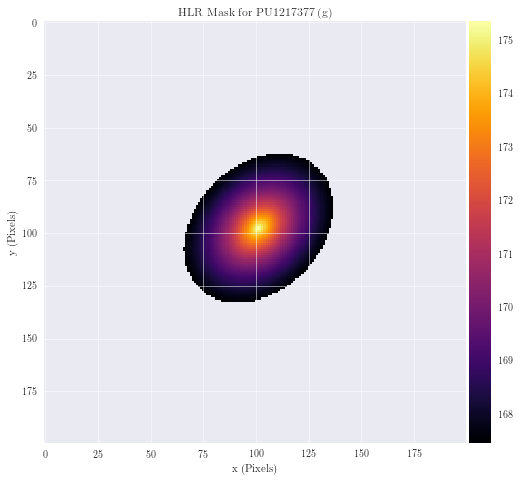


PU1217377 (r) MODEL 
Percentile: 91.641

Interior 
	Flux: 16240.182 ADU 
	Mean: 4.857 ADU 
	RMS:  1.850 ADU 
	Area: 3344 ADU
Exterior 
	Flux: 16182.098 ADU 
	Mean: 0.441 ADU 
	RMS:  0.628 ADU 
	Area: 36656 ADU

SEMI-MAJOR AXIS:   75.292 pixels 
ANGULAR SIZE:      20.329 arcsec


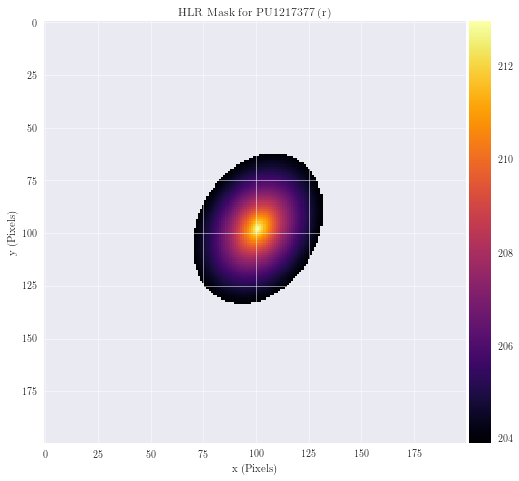


PU1217377 (z) MODEL 
Percentile: 91.406

Interior 
	Flux: 25599.326 ADU 
	Mean: 7.446 ADU 
	RMS:  2.803 ADU 
	Area: 3438 ADU
Exterior 
	Flux: 25656.961 ADU 
	Mean: 0.702 ADU 
	RMS:  0.983 ADU 
	Area: 36562 ADU

SEMI-MAJOR AXIS:   79.164 pixels 
ANGULAR SIZE:      21.374 arcsec


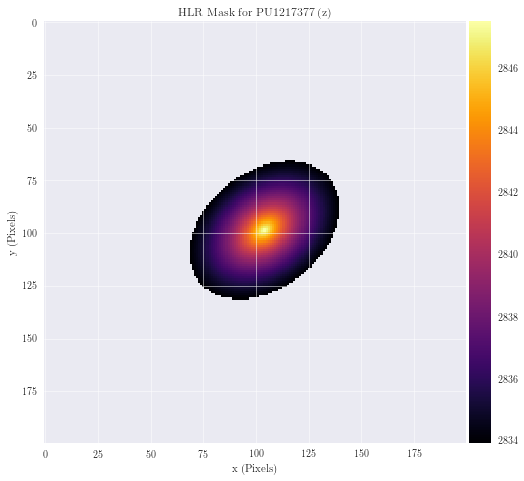


PU1221086 (z) MODEL 
Percentile: 86.484

Interior 
	Flux: 48142.492 ADU 
	Mean: 8.904 ADU 
	RMS:  2.718 ADU 
	Area: 5407 ADU
Exterior 
	Flux: 47937.109 ADU 
	Mean: 1.386 ADU 
	RMS:  1.624 ADU 
	Area: 34593 ADU

SEMI-MAJOR AXIS:   113.332 pixels 
ANGULAR SIZE:      30.600 arcsec


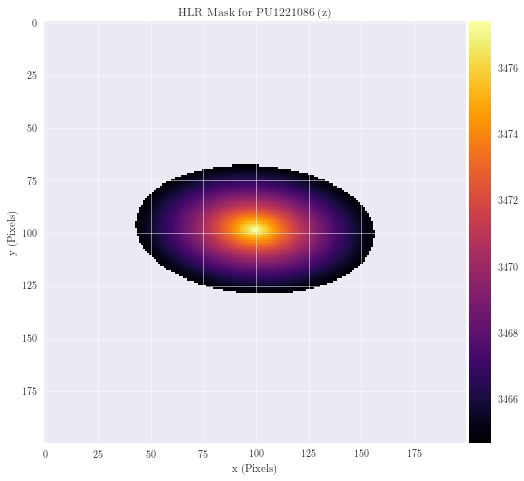


PU1224081 (g) MODEL 
Percentile: 91.094

Interior 
	Flux: 21136.770 ADU 
	Mean: 5.932 ADU 
	RMS:  2.215 ADU 
	Area: 3563 ADU
Exterior 
	Flux: 21142.947 ADU 
	Mean: 0.580 ADU 
	RMS:  0.799 ADU 
	Area: 36437 ADU

SEMI-MAJOR AXIS:   80.425 pixels 
ANGULAR SIZE:      21.715 arcsec


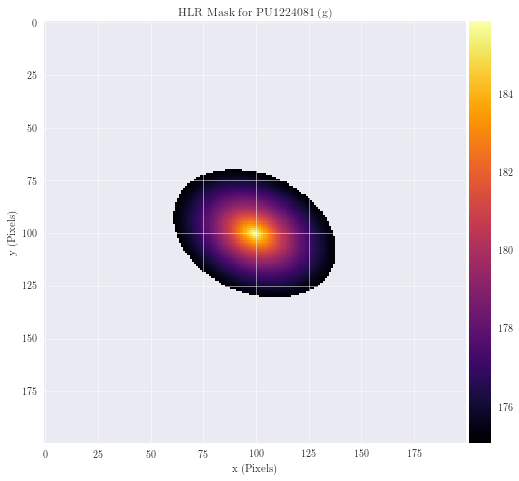


PU1224081 (r) MODEL 
Percentile: 91.367

Interior 
	Flux: 22960.299 ADU 
	Mean: 6.649 ADU 
	RMS:  2.509 ADU 
	Area: 3453 ADU
Exterior 
	Flux: 22965.207 ADU 
	Mean: 0.628 ADU 
	RMS:  0.878 ADU 
	Area: 36547 ADU

SEMI-MAJOR AXIS:   78.126 pixels 
ANGULAR SIZE:      21.094 arcsec


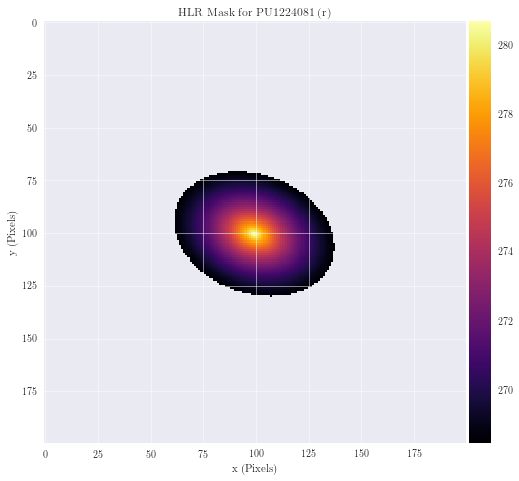


PU1224081 (z) MODEL 
Percentile: 91.953

Interior 
	Flux: 33795.449 ADU 
	Mean: 10.499 ADU 
	RMS:  4.045 ADU 
	Area: 3219 ADU
Exterior 
	Flux: 33796.855 ADU 
	Mean: 0.919 ADU 
	RMS:  1.328 ADU 
	Area: 36781 ADU

SEMI-MAJOR AXIS:   73.358 pixels 
ANGULAR SIZE:      19.807 arcsec


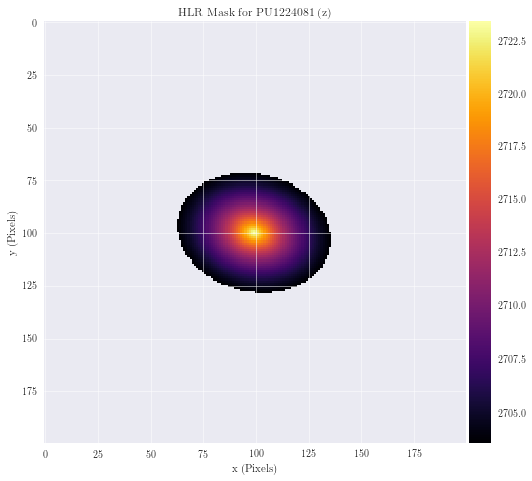


PU1251013 (g) MODEL 
Percentile: 93.828

Interior 
	Flux: 11750.514 ADU 
	Mean: 4.759 ADU 
	RMS:  1.955 ADU 
	Area: 2469 ADU
Exterior 
	Flux: 11710.275 ADU 
	Mean: 0.312 ADU 
	RMS:  0.516 ADU 
	Area: 37531 ADU

SEMI-MAJOR AXIS:   67.194 pixels 
ANGULAR SIZE:      18.142 arcsec


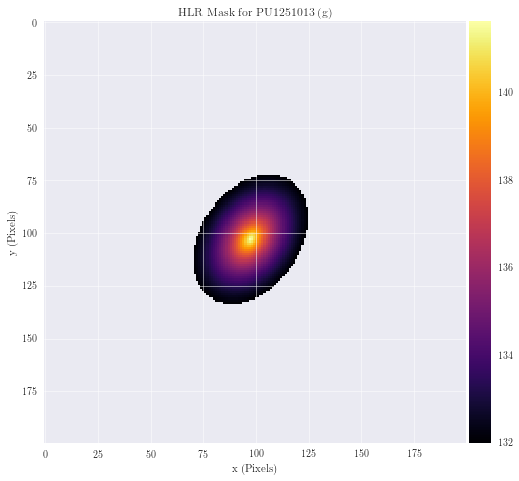


PU1251013 (r) MODEL 
Percentile: 93.164

Interior 
	Flux: 12138.289 ADU 
	Mean: 4.438 ADU 
	RMS:  1.777 ADU 
	Area: 2735 ADU
Exterior 
	Flux: 12131.677 ADU 
	Mean: 0.326 ADU 
	RMS:  0.512 ADU 
	Area: 37265 ADU

SEMI-MAJOR AXIS:   64.372 pixels 
ANGULAR SIZE:      17.380 arcsec


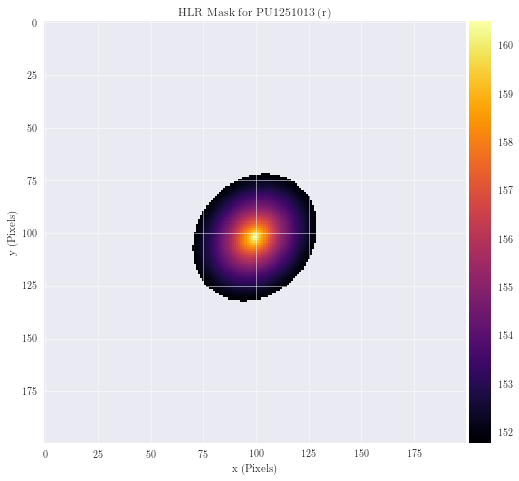


PU1251013 (z) MODEL 
Percentile: 92.969

Interior 
	Flux: 38449.125 ADU 
	Mean: 13.668 ADU 
	RMS:  5.426 ADU 
	Area: 2813 ADU
Exterior 
	Flux: 38570.383 ADU 
	Mean: 1.037 ADU 
	RMS:  1.605 ADU 
	Area: 37187 ADU

SEMI-MAJOR AXIS:   67.514 pixels 
ANGULAR SIZE:      18.229 arcsec


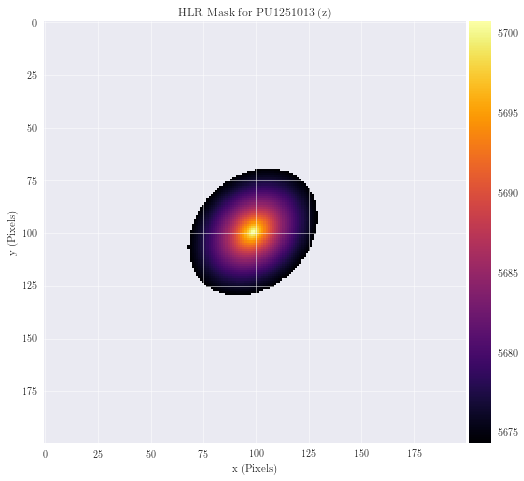


DF30 (g) MODEL 
Percentile: 95.977

Interior 
	Flux: 9061.442 ADU 
	Mean: 5.628 ADU 
	RMS:  2.422 ADU 
	Area: 1610 ADU
Exterior 
	Flux: 9059.913 ADU 
	Mean: 0.236 ADU 
	RMS:  0.493 ADU 
	Area: 38390 ADU

SEMI-MAJOR AXIS:   51.970 pixels 
ANGULAR SIZE:      14.032 arcsec


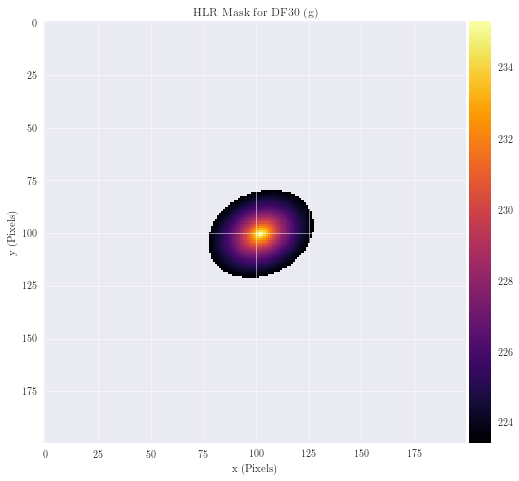


DF30 (z) MODEL 
Percentile: 97.012

Interior 
	Flux: 19454.496 ADU 
	Mean: 16.266 ADU 
	RMS:  7.093 ADU 
	Area: 1196 ADU
Exterior 
	Flux: 19485.766 ADU 
	Mean: 0.502 ADU 
	RMS:  1.238 ADU 
	Area: 38804 ADU

SEMI-MAJOR AXIS:   43.643 pixels 
ANGULAR SIZE:      11.784 arcsec


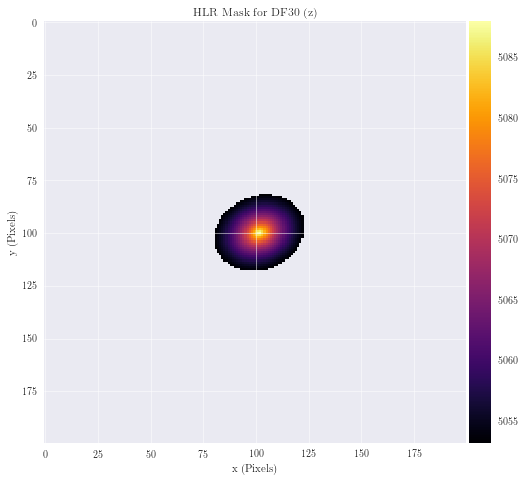


DF07 (g) MODEL 
Percentile: 93.984

Interior 
	Flux: 12971.412 ADU 
	Mean: 5.389 ADU 
	RMS:  2.209 ADU 
	Area: 2407 ADU
Exterior 
	Flux: 13028.265 ADU 
	Mean: 0.347 ADU 
	RMS:  0.580 ADU 
	Area: 37593 ADU

SEMI-MAJOR AXIS:   63.903 pixels 
ANGULAR SIZE:      17.254 arcsec


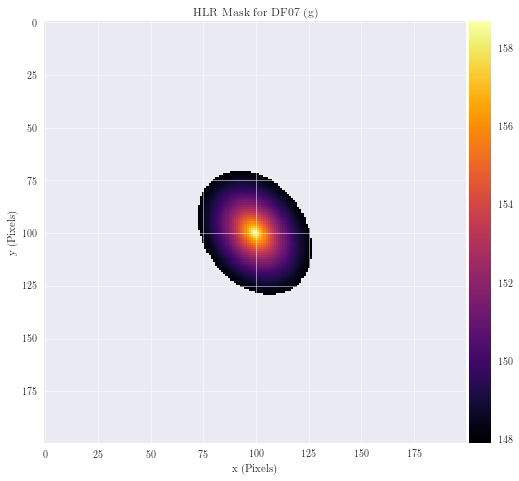


DF07 (r) MODEL 
Percentile: 94.609

Interior 
	Flux: 12668.868 ADU 
	Mean: 5.873 ADU 
	RMS:  2.449 ADU 
	Area: 2157 ADU
Exterior 
	Flux: 12702.236 ADU 
	Mean: 0.336 ADU 
	RMS:  0.597 ADU 
	Area: 37843 ADU

SEMI-MAJOR AXIS:   59.562 pixels 
ANGULAR SIZE:      16.082 arcsec


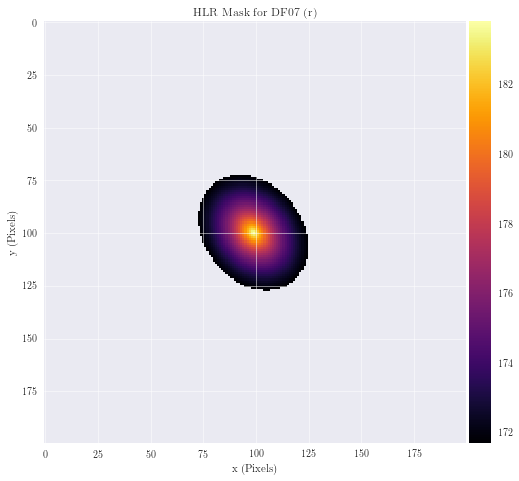


DF07 (z) MODEL 
Percentile: 93.594

Interior 
	Flux: 33563.164 ADU 
	Mean: 13.095 ADU 
	RMS:  5.321 ADU 
	Area: 2563 ADU
Exterior 
	Flux: 33552.152 ADU 
	Mean: 0.896 ADU 
	RMS:  1.455 ADU 
	Area: 37437 ADU

SEMI-MAJOR AXIS:   65.815 pixels 
ANGULAR SIZE:      17.770 arcsec


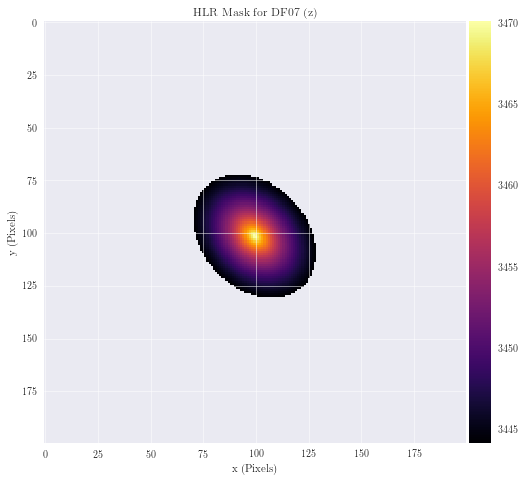


DF40 (g) MODEL 
Percentile: 97.168

Interior 
	Flux: 5591.340 ADU 
	Mean: 4.935 ADU 
	RMS:  2.161 ADU 
	Area: 1133 ADU
Exterior 
	Flux: 5584.445 ADU 
	Mean: 0.144 ADU 
	RMS:  0.365 ADU 
	Area: 38867 ADU

SEMI-MAJOR AXIS:   56.111 pixels 
ANGULAR SIZE:      15.150 arcsec


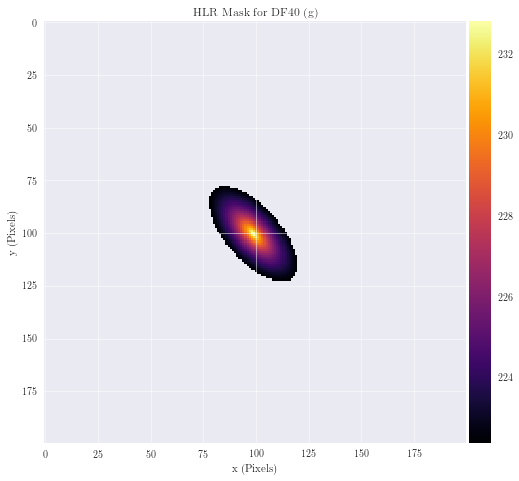


DF40 (r) MODEL 
Percentile: 97.734

Interior 
	Flux: 7090.409 ADU 
	Mean: 7.817 ADU 
	RMS:  3.438 ADU 
	Area: 907 ADU
Exterior 
	Flux: 7067.131 ADU 
	Mean: 0.181 ADU 
	RMS:  0.521 ADU 
	Area: 39093 ADU

SEMI-MAJOR AXIS:   44.599 pixels 
ANGULAR SIZE:      12.042 arcsec


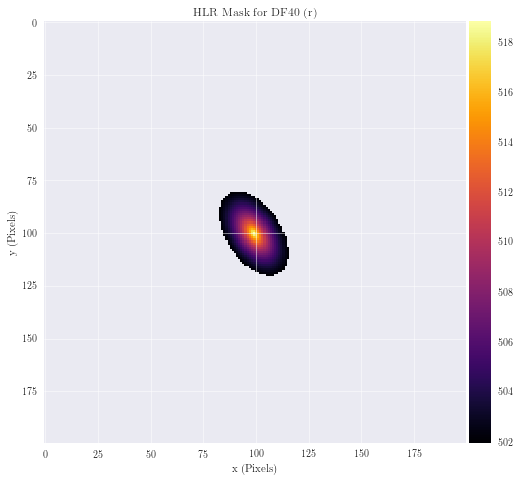


DF40 (z) MODEL 
Percentile: 95.938

Interior 
	Flux: 11960.322 ADU 
	Mean: 7.365 ADU 
	RMS:  3.159 ADU 
	Area: 1624 ADU
Exterior 
	Flux: 12009.154 ADU 
	Mean: 0.313 ADU 
	RMS:  0.649 ADU 
	Area: 38376 ADU

SEMI-MAJOR AXIS:   50.717 pixels 
ANGULAR SIZE:      13.694 arcsec


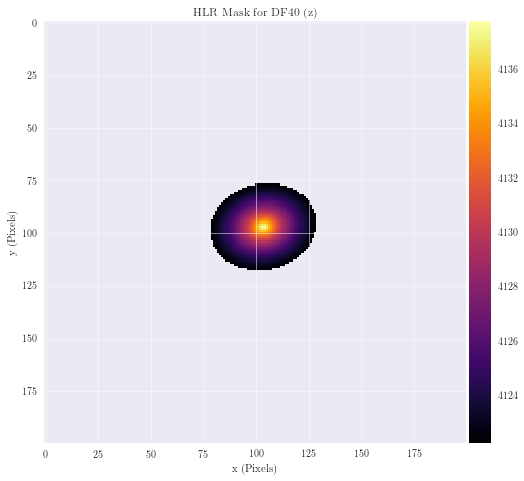


DF08 (g) MODEL 
Percentile: 96.250

Interior 
	Flux: 3803.444 ADU 
	Mean: 2.536 ADU 
	RMS:  1.094 ADU 
	Area: 1500 ADU
Exterior 
	Flux: 3807.380 ADU 
	Mean: 0.099 ADU 
	RMS:  0.215 ADU 
	Area: 38500 ADU

SEMI-MAJOR AXIS:   45.976 pixels 
ANGULAR SIZE:      12.414 arcsec


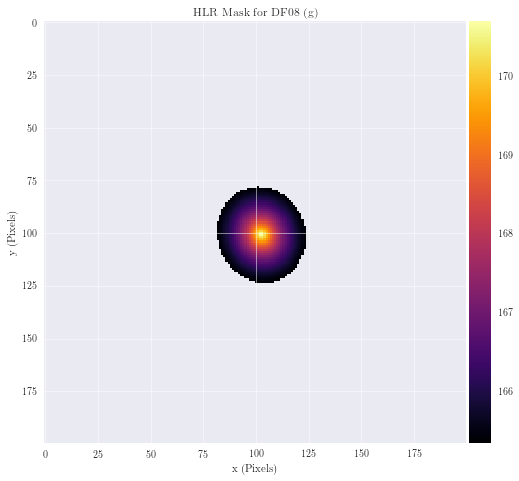


DF08 (r) MODEL 
Percentile: 96.367

Interior 
	Flux: 7128.920 ADU 
	Mean: 4.903 ADU 
	RMS:  2.118 ADU 
	Area: 1454 ADU
Exterior 
	Flux: 7157.626 ADU 
	Mean: 0.186 ADU 
	RMS:  0.410 ADU 
	Area: 38546 ADU

SEMI-MAJOR AXIS:   47.301 pixels 
ANGULAR SIZE:      12.771 arcsec


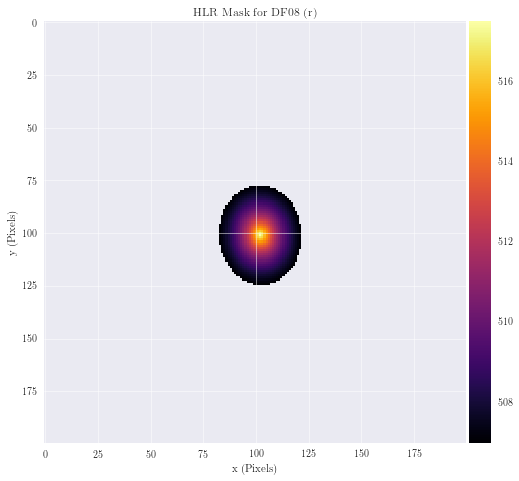


DF08 (z) MODEL 
Percentile: 96.875

Interior 
	Flux: 7902.048 ADU 
	Mean: 6.322 ADU 
	RMS:  2.750 ADU 
	Area: 1250 ADU
Exterior 
	Flux: 7916.017 ADU 
	Mean: 0.204 ADU 
	RMS:  0.492 ADU 
	Area: 38750 ADU

SEMI-MAJOR AXIS:   45.410 pixels 
ANGULAR SIZE:      12.261 arcsec


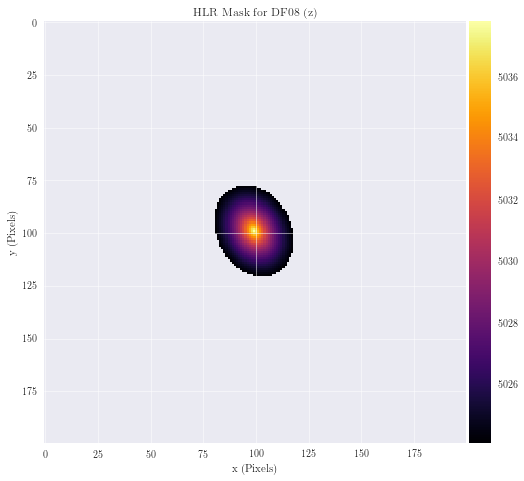


DF17 (g) MODEL 
Percentile: 92.617

Interior 
	Flux: 8208.202 ADU 
	Mean: 2.779 ADU 
	RMS:  1.097 ADU 
	Area: 2954 ADU
Exterior 
	Flux: 8212.782 ADU 
	Mean: 0.222 ADU 
	RMS:  0.334 ADU 
	Area: 37046 ADU

SEMI-MAJOR AXIS:   74.060 pixels 
ANGULAR SIZE:      19.996 arcsec


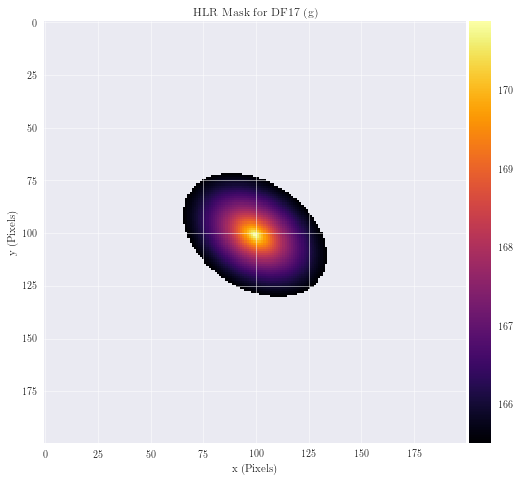


DF17 (r) MODEL 
Percentile: 93.672

Interior 
	Flux: 13747.607 ADU 
	Mean: 5.430 ADU 
	RMS:  2.212 ADU 
	Area: 2532 ADU
Exterior 
	Flux: 13698.422 ADU 
	Mean: 0.366 ADU 
	RMS:  0.599 ADU 
	Area: 37468 ADU

SEMI-MAJOR AXIS:   56.824 pixels 
ANGULAR SIZE:      15.342 arcsec


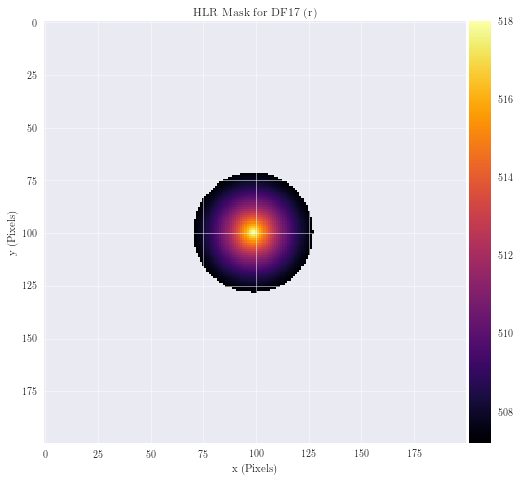


DF17 (z) MODEL 
Percentile: 96.641

Interior 
	Flux: 13140.467 ADU 
	Mean: 9.777 ADU 
	RMS:  4.243 ADU 
	Area: 1344 ADU
Exterior 
	Flux: 13168.285 ADU 
	Mean: 0.341 ADU 
	RMS:  0.787 ADU 
	Area: 38656 ADU

SEMI-MAJOR AXIS:   41.411 pixels 
ANGULAR SIZE:      11.181 arcsec


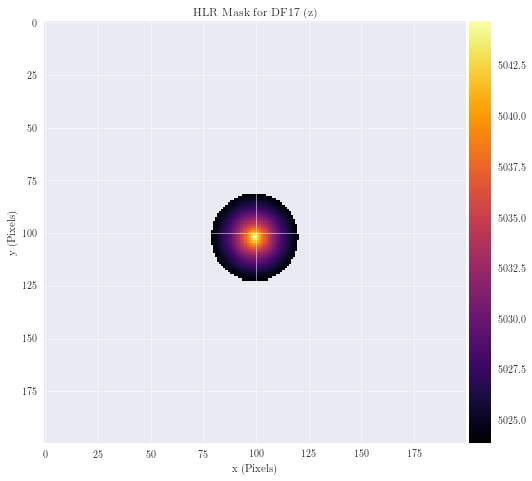


DF03 (g) MODEL 
Percentile: 96.719

Interior 
	Flux: 4171.987 ADU 
	Mean: 3.177 ADU 
	RMS:  1.387 ADU 
	Area: 1313 ADU
Exterior 
	Flux: 4153.085 ADU 
	Mean: 0.107 ADU 
	RMS:  0.252 ADU 
	Area: 38687 ADU

SEMI-MAJOR AXIS:   58.718 pixels 
ANGULAR SIZE:      15.854 arcsec


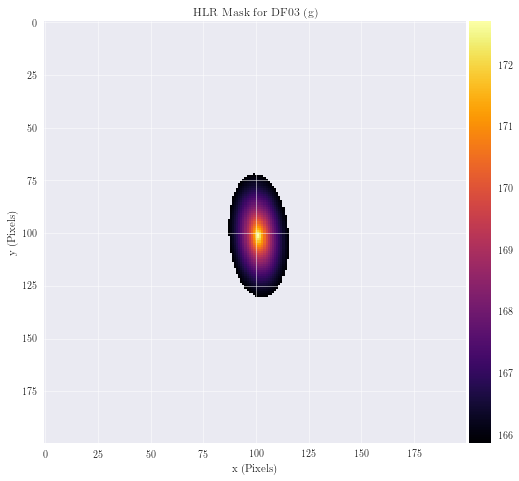


DF03 (r) MODEL 
Percentile: 97.266

Interior 
	Flux: 5784.460 ADU 
	Mean: 5.287 ADU 
	RMS:  2.309 ADU 
	Area: 1094 ADU
Exterior 
	Flux: 5811.179 ADU 
	Mean: 0.149 ADU 
	RMS:  0.386 ADU 
	Area: 38906 ADU

SEMI-MAJOR AXIS:   48.165 pixels 
ANGULAR SIZE:      13.005 arcsec


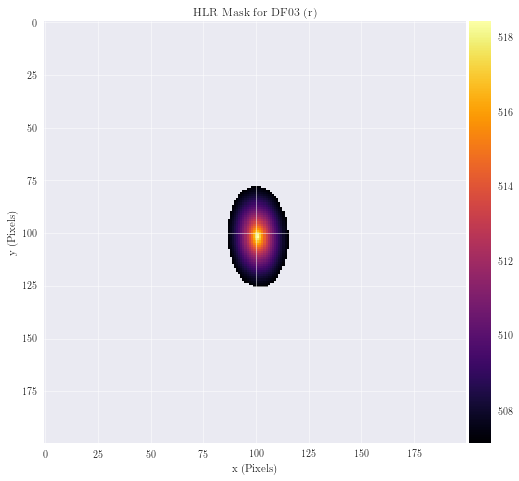


DF03 (z) MODEL 
Percentile: 97.871

Interior 
	Flux: 7765.821 ADU 
	Mean: 9.126 ADU 
	RMS:  3.991 ADU 
	Area: 851 ADU
Exterior 
	Flux: 7799.842 ADU 
	Mean: 0.199 ADU 
	RMS:  0.595 ADU 
	Area: 39149 ADU

SEMI-MAJOR AXIS:   52.852 pixels 
ANGULAR SIZE:      14.270 arcsec


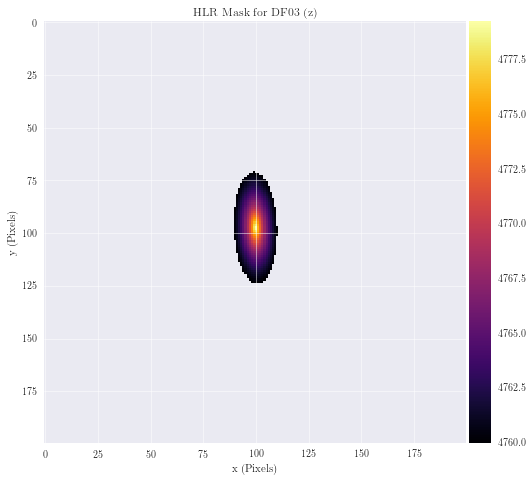


PU1304535 (g) MODEL 
Percentile: 88.682

Interior 
	Flux: 21503.711 ADU 
	Mean: 4.749 ADU 
	RMS:  1.555 ADU 
	Area: 4528 ADU
Exterior 
	Flux: 21511.594 ADU 
	Mean: 0.606 ADU 
	RMS:  0.764 ADU 
	Area: 35472 ADU

SEMI-MAJOR AXIS:   80.389 pixels 
ANGULAR SIZE:      21.705 arcsec


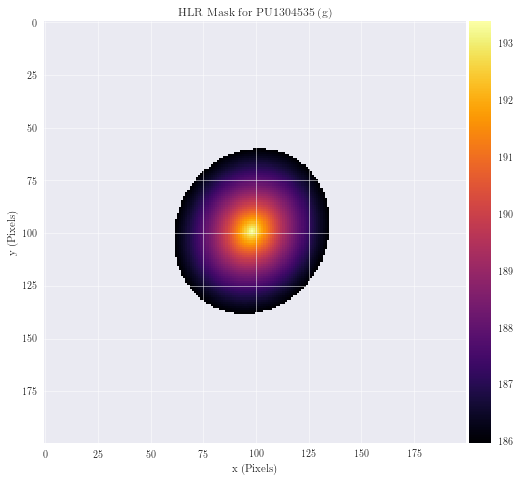


PU1304535 (r) MODEL 
Percentile: 88.770

Interior 
	Flux: 32861.180 ADU 
	Mean: 7.314 ADU 
	RMS:  2.403 ADU 
	Area: 4493 ADU
Exterior 
	Flux: 32949.691 ADU 
	Mean: 0.928 ADU 
	RMS:  1.171 ADU 
	Area: 35507 ADU

SEMI-MAJOR AXIS:   79.430 pixels 
ANGULAR SIZE:      21.446 arcsec


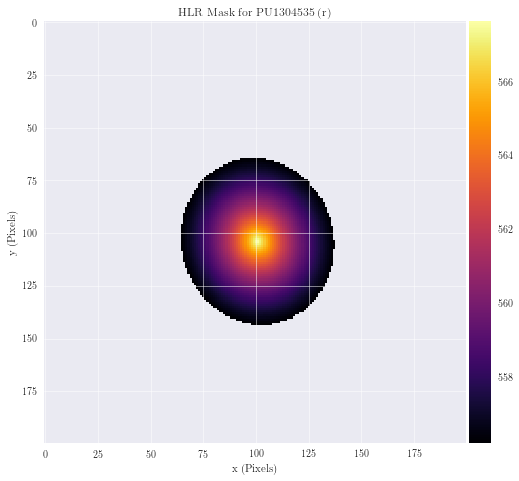


PU1304535 (z) MODEL 
Percentile: 94.219

Interior 
	Flux: 64346.820 ADU 
	Mean: 27.820 ADU 
	RMS:  11.520 ADU 
	Area: 2313 ADU
Exterior 
	Flux: 64162.941 ADU 
	Mean: 1.703 ADU 
	RMS:  2.921 ADU 
	Area: 37687 ADU

SEMI-MAJOR AXIS:   57.942 pixels 
ANGULAR SIZE:      15.644 arcsec


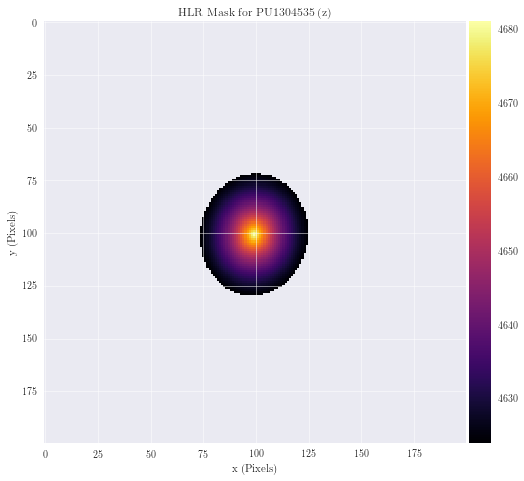


UDG1220185 (g) MODEL 
Percentile: 92.031

Interior 
	Flux: 21475.879 ADU 
	Mean: 6.736 ADU 
	RMS:  2.629 ADU 
	Area: 3188 ADU
Exterior 
	Flux: 21454.311 ADU 
	Mean: 0.583 ADU 
	RMS:  0.843 ADU 
	Area: 36812 ADU

SEMI-MAJOR AXIS:   81.049 pixels 
ANGULAR SIZE:      21.883 arcsec


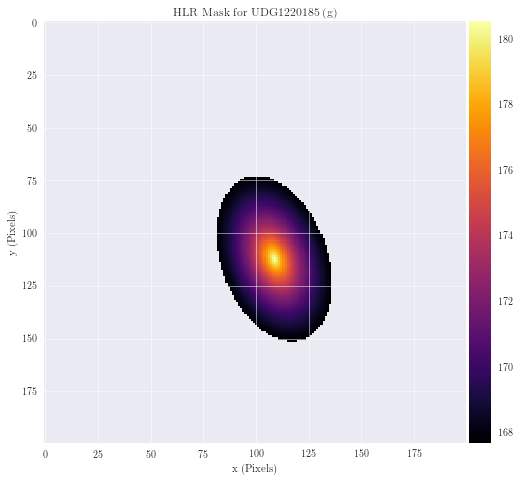


UDG1220185 (r) MODEL 
Percentile: 93.125

Interior 
	Flux: 17516.566 ADU 
	Mean: 6.370 ADU 
	RMS:  2.565 ADU 
	Area: 2750 ADU
Exterior 
	Flux: 17578.564 ADU 
	Mean: 0.472 ADU 
	RMS:  0.734 ADU 
	Area: 37250 ADU

SEMI-MAJOR AXIS:   73.946 pixels 
ANGULAR SIZE:      19.965 arcsec


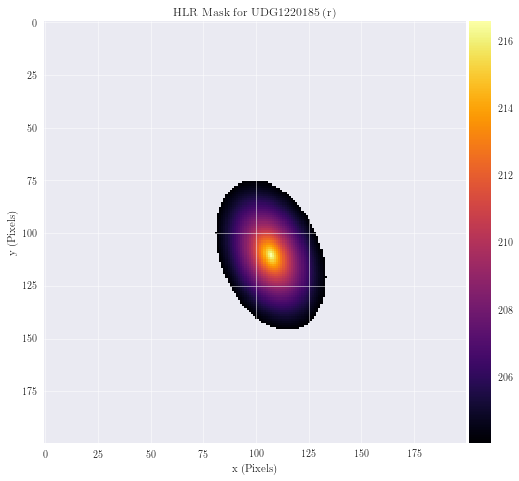


UDG1221576 (g) MODEL 
Percentile: 85.430

Interior 
	Flux: 29712.873 ADU 
	Mean: 5.098 ADU 
	RMS:  1.437 ADU 
	Area: 5828 ADU
Exterior 
	Flux: 29701.012 ADU 
	Mean: 0.869 ADU 
	RMS:  1.003 ADU 
	Area: 34172 ADU

SEMI-MAJOR AXIS:   113.059 pixels 
ANGULAR SIZE:      30.526 arcsec


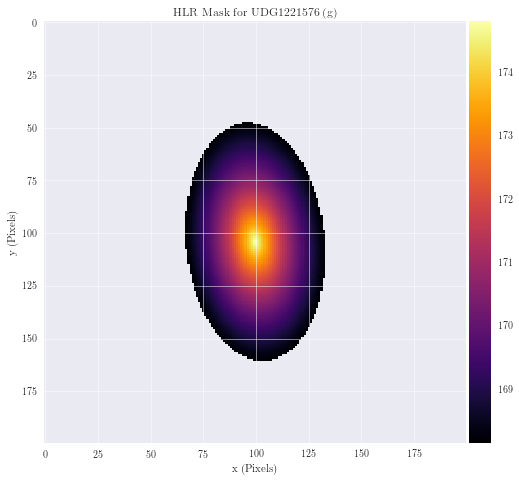


UDG1221576 (r) MODEL 
Percentile: 85.078

Interior 
	Flux: 32577.660 ADU 
	Mean: 5.458 ADU 
	RMS:  1.484 ADU 
	Area: 5969 ADU
Exterior 
	Flux: 32671.238 ADU 
	Mean: 0.960 ADU 
	RMS:  1.105 ADU 
	Area: 34031 ADU

SEMI-MAJOR AXIS:   112.045 pixels 
ANGULAR SIZE:      30.252 arcsec


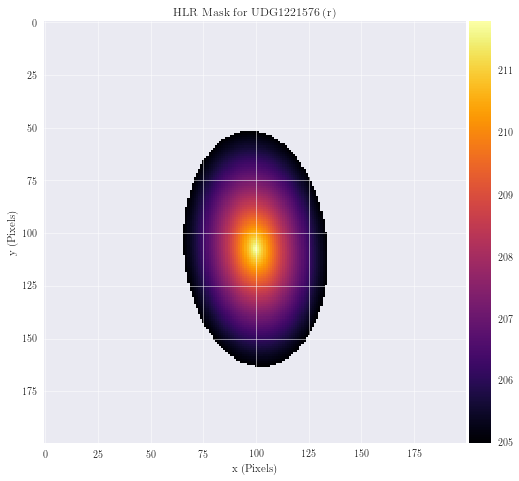


UDG1221576 (z) MODEL 
Percentile: 84.990

Interior 
	Flux: 51077.938 ADU 
	Mean: 8.507 ADU 
	RMS:  2.312 ADU 
	Area: 6004 ADU
Exterior 
	Flux: 51045.039 ADU 
	Mean: 1.502 ADU 
	RMS:  1.728 ADU 
	Area: 33996 ADU

SEMI-MAJOR AXIS:   112.807 pixels 
ANGULAR SIZE:      30.458 arcsec


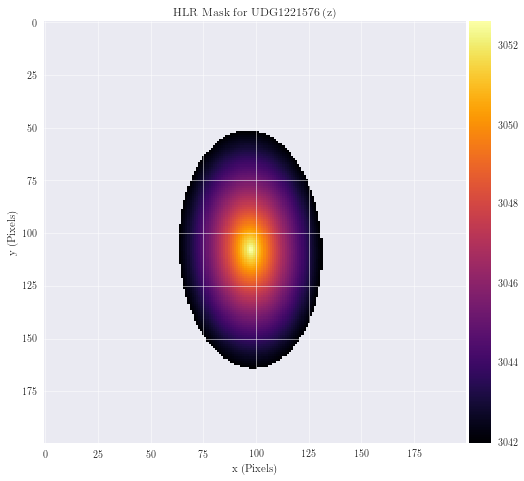


UDG1225265 (g) MODEL 
Percentile: 91.992

Interior 
	Flux: 79089.812 ADU 
	Mean: 24.685 ADU 
	RMS:  8.651 ADU 
	Area: 3204 ADU
Exterior 
	Flux: 79039.016 ADU 
	Mean: 2.148 ADU 
	RMS:  3.192 ADU 
	Area: 36796 ADU

SEMI-MAJOR AXIS:   85.119 pixels 
ANGULAR SIZE:      22.982 arcsec


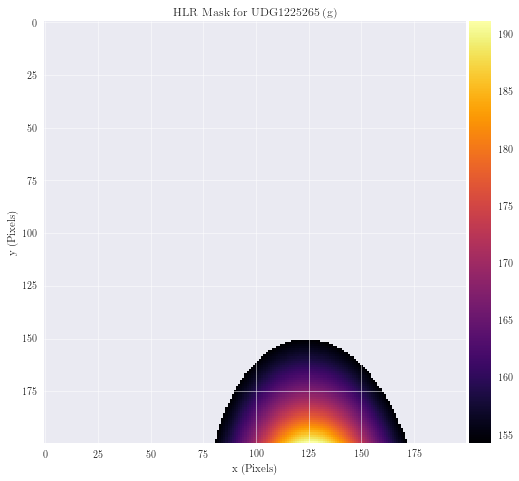


UDG1225265 (r) MODEL 
Percentile: 87.100

Interior 
	Flux: 73857.594 ADU 
	Mean: 14.311 ADU 
	RMS:  3.734 ADU 
	Area: 5161 ADU
Exterior 
	Flux: 73568.383 ADU 
	Mean: 2.112 ADU 
	RMS:  2.636 ADU 
	Area: 34839 ADU

SEMI-MAJOR AXIS:   97.449 pixels 
ANGULAR SIZE:      26.311 arcsec


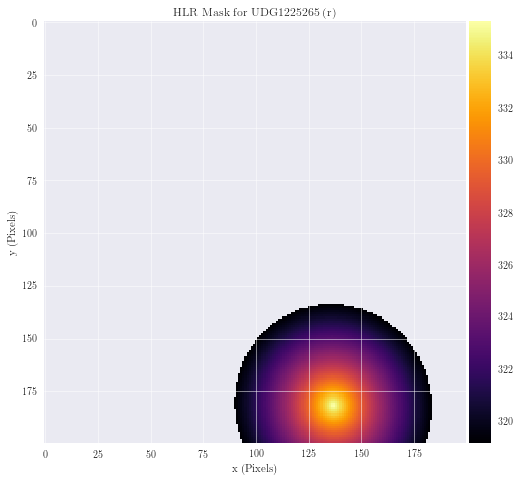


UDG1225265 (z) MODEL 
Percentile: 84.727

Interior 
	Flux: 42922.281 ADU 
	Mean: 7.025 ADU 
	RMS:  1.591 ADU 
	Area: 6110 ADU
Exterior 
	Flux: 42976.367 ADU 
	Mean: 1.268 ADU 
	RMS:  1.488 ADU 
	Area: 33890 ADU

SEMI-MAJOR AXIS:   101.300 pixels 
ANGULAR SIZE:      27.351 arcsec


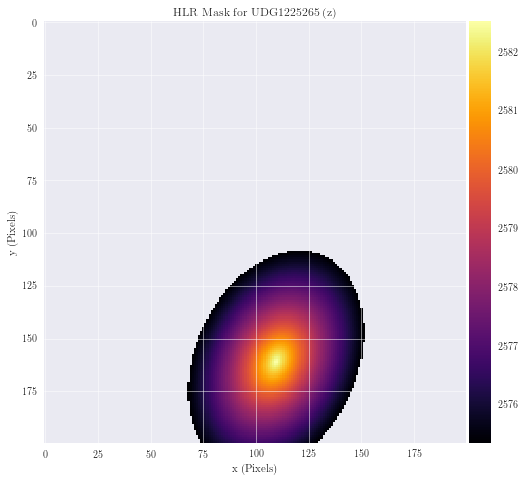


UDG1230359 (z) MODEL 
Percentile: 97.578

Interior 
	Flux: 7826.153 ADU 
	Mean: 8.077 ADU 
	RMS:  3.545 ADU 
	Area: 969 ADU
Exterior 
	Flux: 7802.912 ADU 
	Mean: 0.200 ADU 
	RMS:  0.556 ADU 
	Area: 39031 ADU

SEMI-MAJOR AXIS:   54.586 pixels 
ANGULAR SIZE:      14.738 arcsec


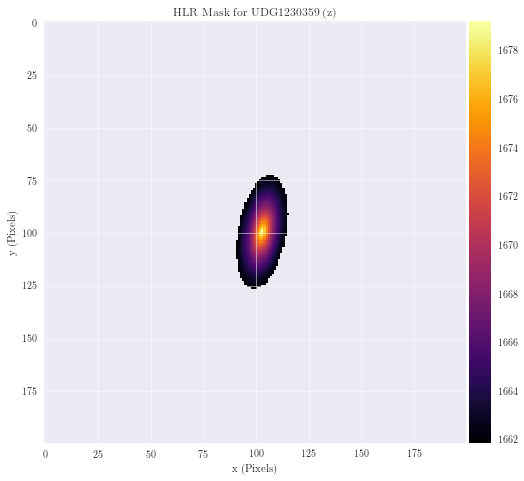


UDG1239266 (g) MODEL 
Percentile: 95.625

Interior 
	Flux: 7504.645 ADU 
	Mean: 4.288 ADU 
	RMS:  1.833 ADU 
	Area: 1750 ADU
Exterior 
	Flux: 7499.833 ADU 
	Mean: 0.196 ADU 
	RMS:  0.391 ADU 
	Area: 38250 ADU

SEMI-MAJOR AXIS:   51.116 pixels 
ANGULAR SIZE:      13.801 arcsec


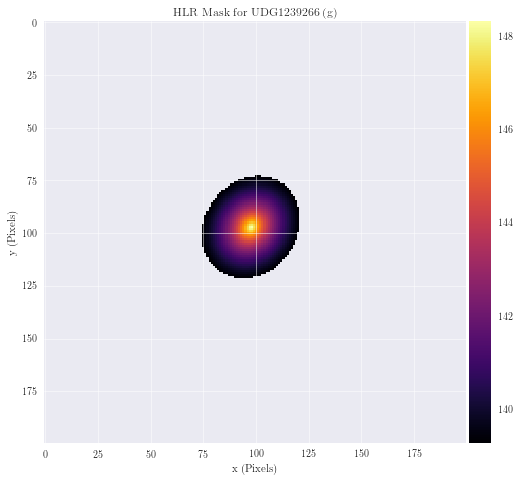


UDG1239266 (r) MODEL 
Percentile: 95.352

Interior 
	Flux: 9301.019 ADU 
	Mean: 5.001 ADU 
	RMS:  2.124 ADU 
	Area: 1860 ADU
Exterior 
	Flux: 9300.034 ADU 
	Mean: 0.244 ADU 
	RMS:  0.471 ADU 
	Area: 38140 ADU

SEMI-MAJOR AXIS:   52.095 pixels 
ANGULAR SIZE:      14.066 arcsec


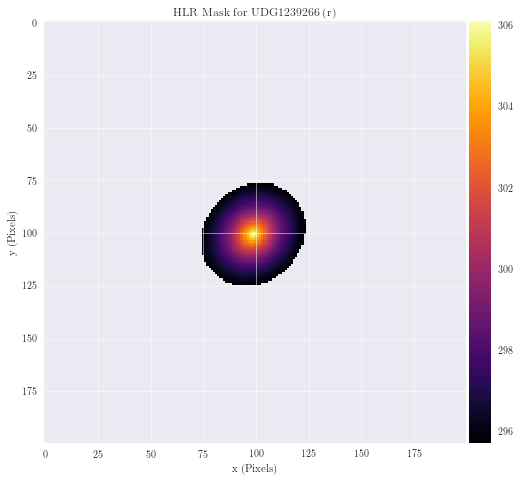


UDG1239266 (z) MODEL 
Percentile: 95.078

Interior 
	Flux: 43110.988 ADU 
	Mean: 21.895 ADU 
	RMS:  9.255 ADU 
	Area: 1969 ADU
Exterior 
	Flux: 43024.480 ADU 
	Mean: 1.131 ADU 
	RMS:  2.117 ADU 
	Area: 38031 ADU

SEMI-MAJOR AXIS:   51.989 pixels 
ANGULAR SIZE:      14.037 arcsec


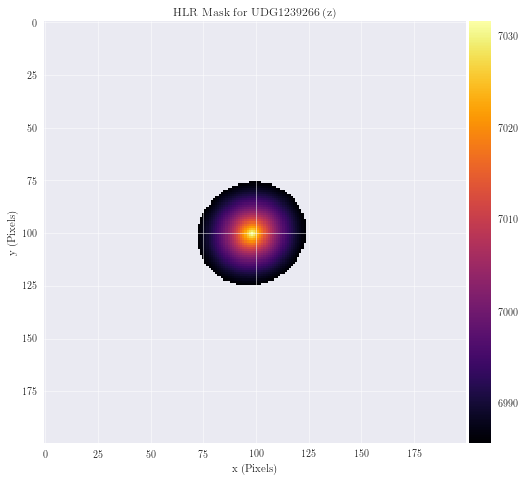


UDG1240017 (g) MODEL 
Percentile: 91.641

Interior 
	Flux: 24043.941 ADU 
	Mean: 7.190 ADU 
	RMS:  2.739 ADU 
	Area: 3344 ADU
Exterior 
	Flux: 23927.619 ADU 
	Mean: 0.653 ADU 
	RMS:  0.930 ADU 
	Area: 36656 ADU

SEMI-MAJOR AXIS:   74.667 pixels 
ANGULAR SIZE:      20.160 arcsec


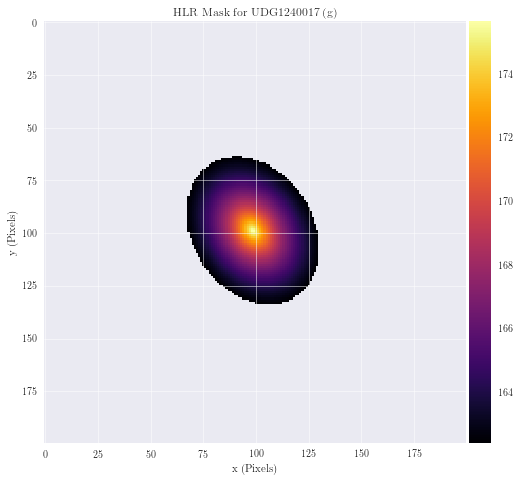


UDG1240017 (z) MODEL 
Percentile: 92.266

Interior 
	Flux: 35321.957 ADU 
	Mean: 11.420 ADU 
	RMS:  4.452 ADU 
	Area: 3093 ADU
Exterior 
	Flux: 35158.992 ADU 
	Mean: 0.953 ADU 
	RMS:  1.409 ADU 
	Area: 36907 ADU

SEMI-MAJOR AXIS:   71.027 pixels 
ANGULAR SIZE:      19.177 arcsec


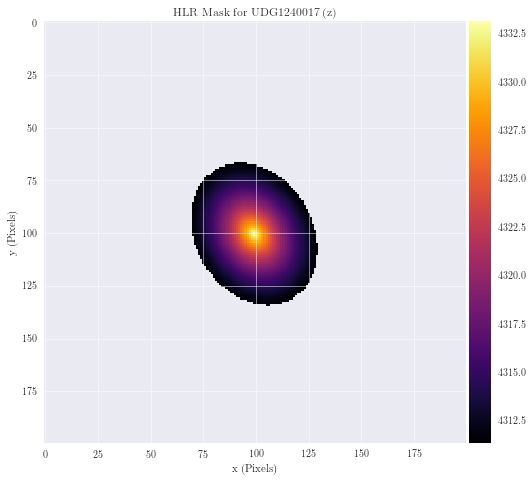


UDG1255409 (g) MODEL 
Percentile: 81.387

Interior 
	Flux: 38091.848 ADU 
	Mean: 5.116 ADU 
	RMS:  0.939 ADU 
	Area: 7446 ADU
Exterior 
	Flux: 38249.320 ADU 
	Mean: 1.175 ADU 
	RMS:  1.347 ADU 
	Area: 32554 ADU

SEMI-MAJOR AXIS:   185.916 pixels 
ANGULAR SIZE:      50.197 arcsec


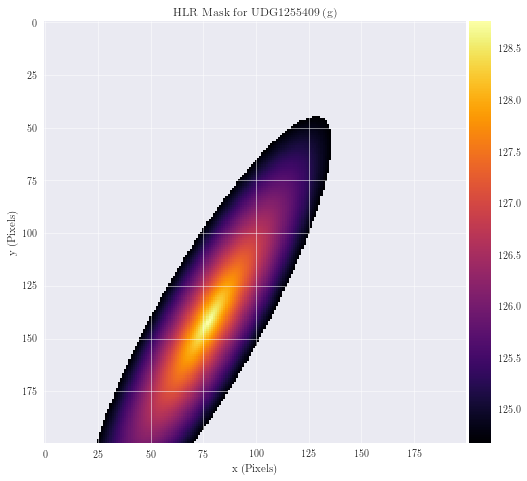


UDG1255409 (r) MODEL 
Percentile: 79.980

Interior 
	Flux: 58759.680 ADU 
	Mean: 7.338 ADU 
	RMS:  1.182 ADU 
	Area: 8008 ADU
Exterior 
	Flux: 58581.883 ADU 
	Mean: 1.831 ADU 
	RMS:  2.129 ADU 
	Area: 31992 ADU

SEMI-MAJOR AXIS:   205.528 pixels 
ANGULAR SIZE:      55.493 arcsec


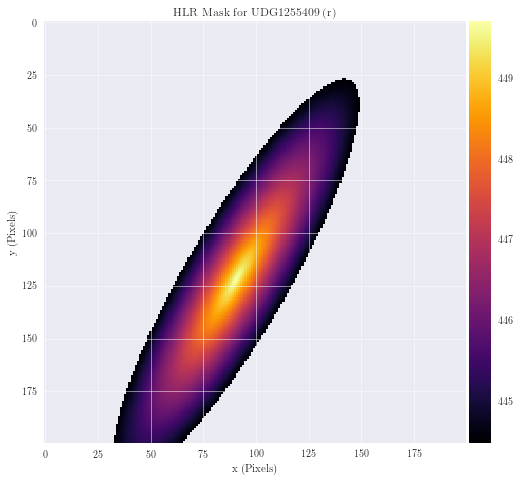


UDG1255409 (z) MODEL 
Percentile: 79.629

Interior 
	Flux: 44320.117 ADU 
	Mean: 5.439 ADU 
	RMS:  0.907 ADU 
	Area: 8148 ADU
Exterior 
	Flux: 44381.328 ADU 
	Mean: 1.393 ADU 
	RMS:  1.635 ADU 
	Area: 31852 ADU

SEMI-MAJOR AXIS:   191.077 pixels 
ANGULAR SIZE:      51.591 arcsec


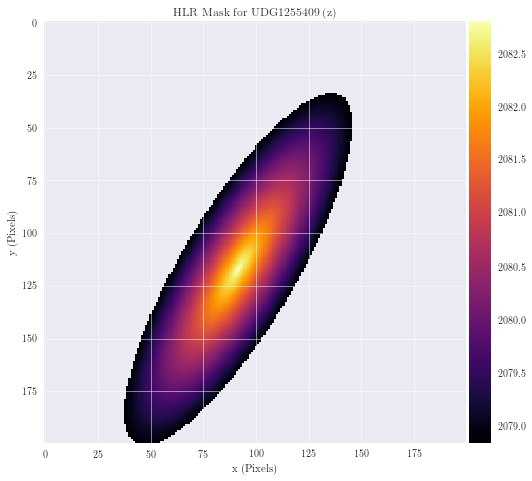


UDG1302413 (g) MODEL 
Percentile: 84.111

Interior 
	Flux: 90475.484 ADU 
	Mean: 14.235 ADU 
	RMS:  3.529 ADU 
	Area: 6356 ADU
Exterior 
	Flux: 90322.398 ADU 
	Mean: 2.685 ADU 
	RMS:  3.106 ADU 
	Area: 33644 ADU

SEMI-MAJOR AXIS:   95.220 pixels 
ANGULAR SIZE:      25.709 arcsec


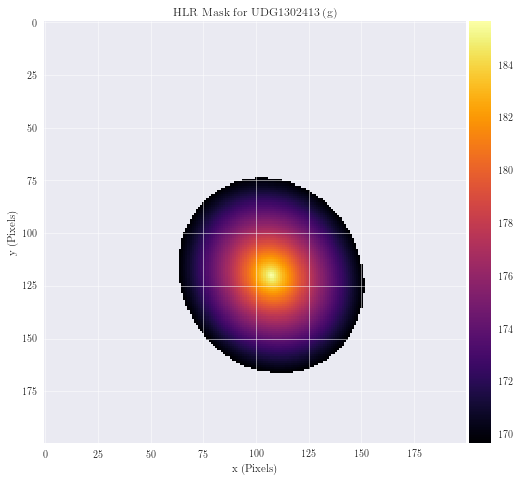


UDG1302413 (r) MODEL 
Percentile: 83.936

Interior 
	Flux: 150573.859 ADU 
	Mean: 23.432 ADU 
	RMS:  5.741 ADU 
	Area: 6426 ADU
Exterior 
	Flux: 150196.656 ADU 
	Mean: 4.474 ADU 
	RMS:  5.170 ADU 
	Area: 33574 ADU

SEMI-MAJOR AXIS:   98.186 pixels 
ANGULAR SIZE:      26.510 arcsec


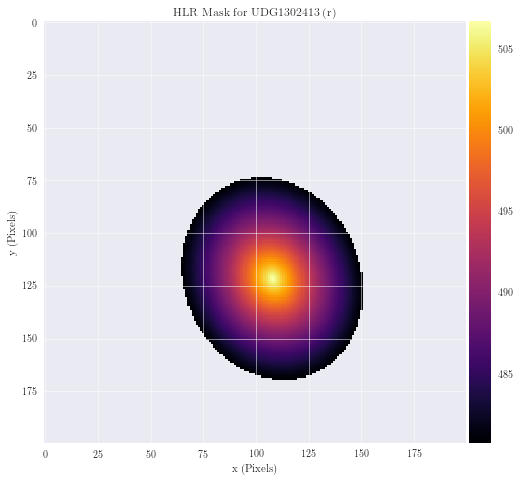


UDG1302413 (z) MODEL 
Percentile: 83.848

Interior 
	Flux: 171807.062 ADU 
	Mean: 26.591 ADU 
	RMS:  6.485 ADU 
	Area: 6461 ADU
Exterior 
	Flux: 171284.375 ADU 
	Mean: 5.107 ADU 
	RMS:  5.902 ADU 
	Area: 33539 ADU

SEMI-MAJOR AXIS:   101.114 pixels 
ANGULAR SIZE:      27.301 arcsec


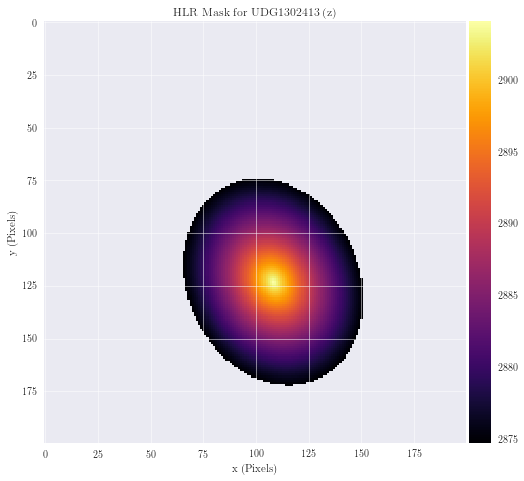


UDG1328467 (z) MODEL 
Percentile: 97.812

Interior 
	Flux: 9397.379 ADU 
	Mean: 10.740 ADU 
	RMS:  4.720 ADU 
	Area: 875 ADU
Exterior 
	Flux: 9377.836 ADU 
	Mean: 0.240 ADU 
	RMS:  0.705 ADU 
	Area: 39125 ADU

SEMI-MAJOR AXIS:   36.605 pixels 
ANGULAR SIZE:      9.883 arcsec


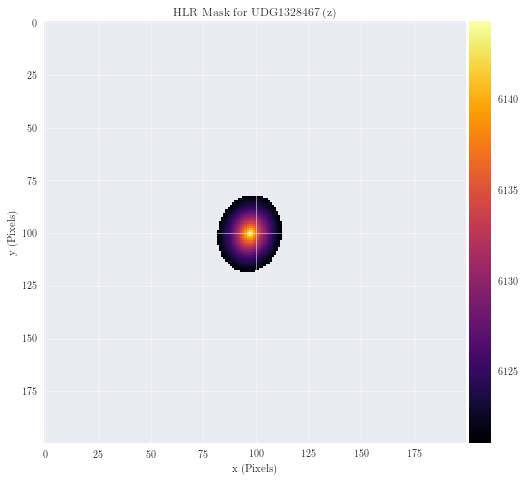


UDG1217267 (g) MODEL 
Percentile: 96.055

Interior 
	Flux: 6285.769 ADU 
	Mean: 3.981 ADU 
	RMS:  1.715 ADU 
	Area: 1579 ADU
Exterior 
	Flux: 6300.769 ADU 
	Mean: 0.164 ADU 
	RMS:  0.345 ADU 
	Area: 38421 ADU

SEMI-MAJOR AXIS:   55.932 pixels 
ANGULAR SIZE:      15.102 arcsec


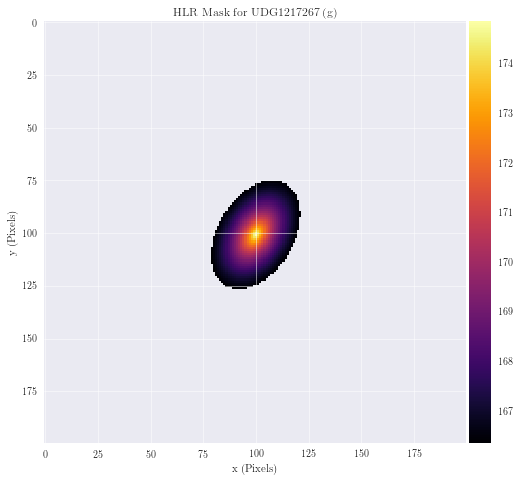


UDG1217267 (r) MODEL 
Percentile: 96.113

Interior 
	Flux: 7353.948 ADU 
	Mean: 4.729 ADU 
	RMS:  2.040 ADU 
	Area: 1555 ADU
Exterior 
	Flux: 7354.862 ADU 
	Mean: 0.191 ADU 
	RMS:  0.407 ADU 
	Area: 38445 ADU

SEMI-MAJOR AXIS:   50.529 pixels 
ANGULAR SIZE:      13.643 arcsec


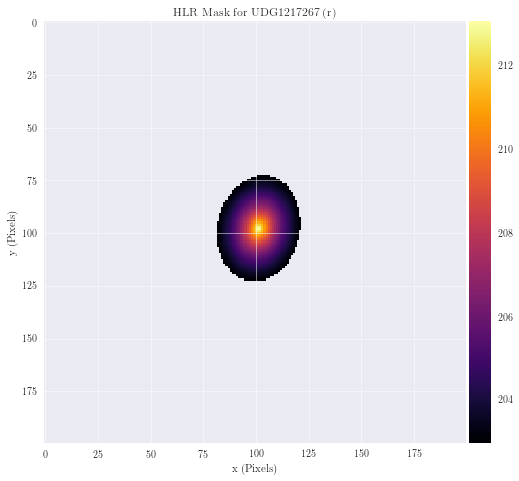


UDG1217267 (z) MODEL 
Percentile: 97.148

Interior 
	Flux: 9400.602 ADU 
	Mean: 8.239 ADU 
	RMS:  3.601 ADU 
	Area: 1141 ADU
Exterior 
	Flux: 9408.453 ADU 
	Mean: 0.242 ADU 
	RMS:  0.613 ADU 
	Area: 38859 ADU

SEMI-MAJOR AXIS:   47.313 pixels 
ANGULAR SIZE:      12.775 arcsec


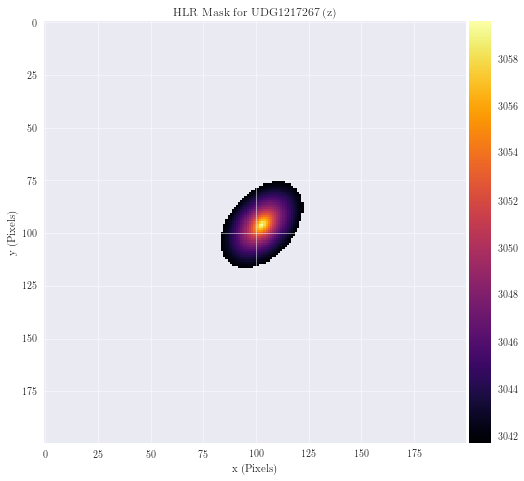


UDG1218389 (g) MODEL 
Percentile: 98.594

Interior 
	Flux: 1030.387 ADU 
	Mean: 1.830 ADU 
	RMS:  0.806 ADU 
	Area: 563 ADU
Exterior 
	Flux: 1028.176 ADU 
	Mean: 0.026 ADU 
	RMS:  0.098 ADU 
	Area: 39437 ADU

SEMI-MAJOR AXIS:   36.243 pixels 
ANGULAR SIZE:      9.786 arcsec


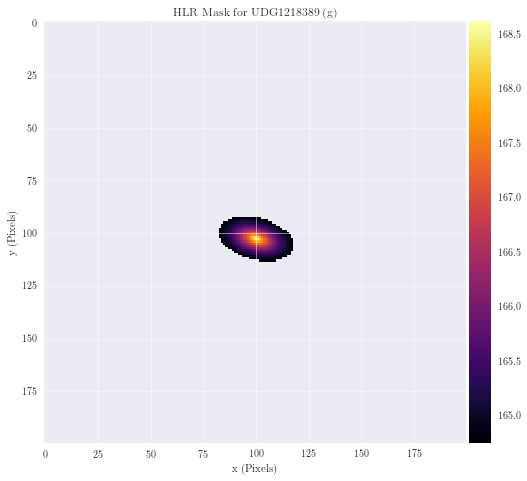


UDG1218389 (r) MODEL 
Percentile: 97.109

Interior 
	Flux: 2184.817 ADU 
	Mean: 1.888 ADU 
	RMS:  0.823 ADU 
	Area: 1157 ADU
Exterior 
	Flux: 2192.733 ADU 
	Mean: 0.056 ADU 
	RMS:  0.142 ADU 
	Area: 38843 ADU

SEMI-MAJOR AXIS:   41.984 pixels 
ANGULAR SIZE:      11.336 arcsec


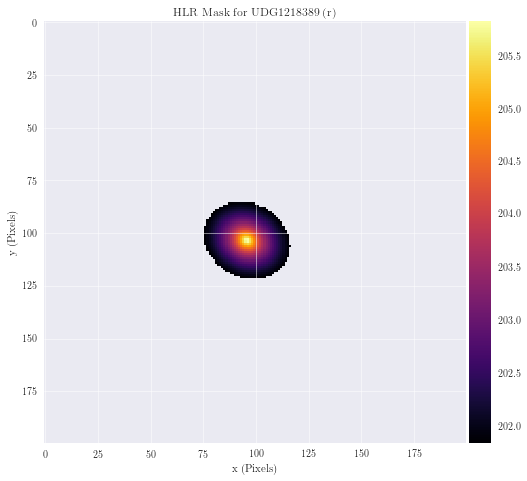


UDG1218389 (z) MODEL 
Percentile: 95.703

Interior 
	Flux: 2673.194 ADU 
	Mean: 1.555 ADU 
	RMS:  0.670 ADU 
	Area: 1719 ADU
Exterior 
	Flux: 2663.598 ADU 
	Mean: 0.070 ADU 
	RMS:  0.140 ADU 
	Area: 38281 ADU

SEMI-MAJOR AXIS:   58.577 pixels 
ANGULAR SIZE:      15.816 arcsec


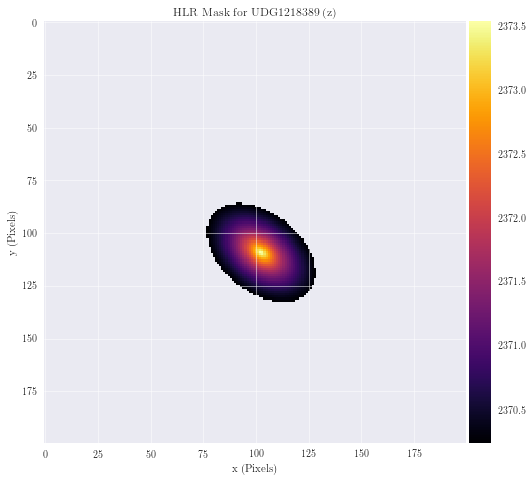


UDG1233477 (g) MODEL 
Percentile: 97.305

Interior 
	Flux: 2654.124 ADU 
	Mean: 2.460 ADU 
	RMS:  1.075 ADU 
	Area: 1079 ADU
Exterior 
	Flux: 2663.572 ADU 
	Mean: 0.068 ADU 
	RMS:  0.178 ADU 
	Area: 38921 ADU

SEMI-MAJOR AXIS:   48.064 pixels 
ANGULAR SIZE:      12.977 arcsec


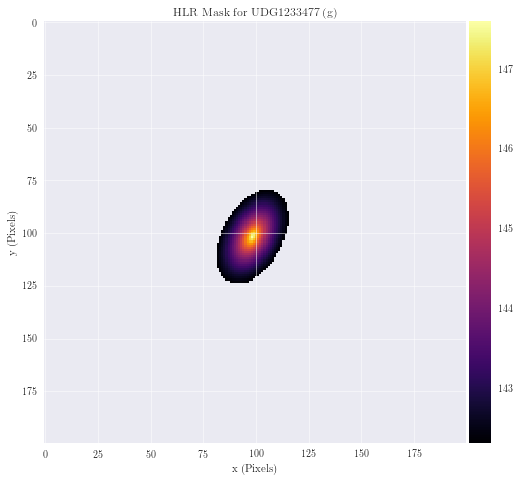


UDG1233477 (r) MODEL 
Percentile: 97.207

Interior 
	Flux: 4282.443 ADU 
	Mean: 3.830 ADU 
	RMS:  1.677 ADU 
	Area: 1118 ADU
Exterior 
	Flux: 4272.995 ADU 
	Mean: 0.110 ADU 
	RMS:  0.282 ADU 
	Area: 38882 ADU

SEMI-MAJOR AXIS:   46.238 pixels 
ANGULAR SIZE:      12.484 arcsec


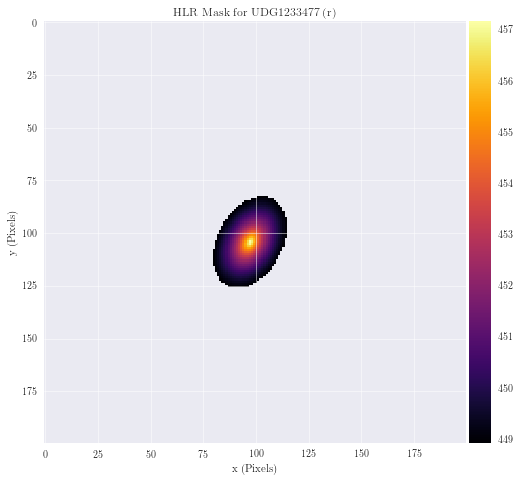


UDG1237294 (g) MODEL 
Percentile: 98.066

Interior 
	Flux: 3825.761 ADU 
	Mean: 4.949 ADU 
	RMS:  2.179 ADU 
	Area: 773 ADU
Exterior 
	Flux: 3816.697 ADU 
	Mean: 0.097 ADU 
	RMS:  0.306 ADU 
	Area: 39227 ADU

SEMI-MAJOR AXIS:   35.967 pixels 
ANGULAR SIZE:      9.711 arcsec


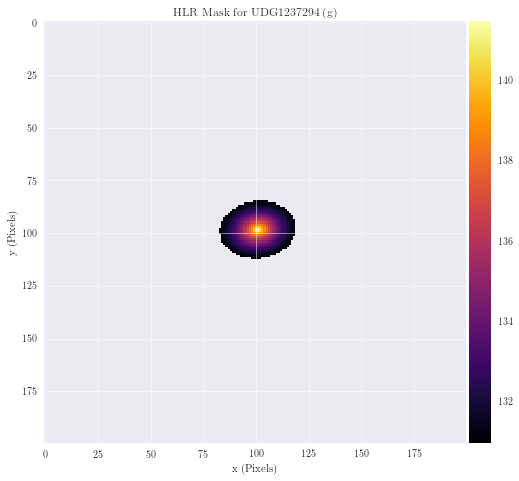


UDG1237294 (r) MODEL 
Percentile: 97.480

Interior 
	Flux: 4892.129 ADU 
	Mean: 4.853 ADU 
	RMS:  2.127 ADU 
	Area: 1008 ADU
Exterior 
	Flux: 4890.500 ADU 
	Mean: 0.125 ADU 
	RMS:  0.341 ADU 
	Area: 38992 ADU

SEMI-MAJOR AXIS:   41.120 pixels 
ANGULAR SIZE:      11.102 arcsec


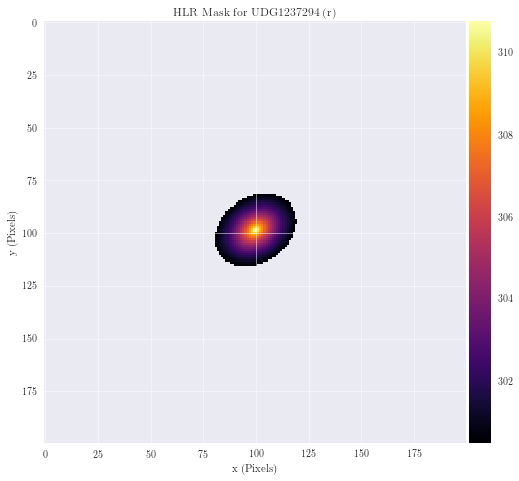


UDG1237294 (z) MODEL 
Percentile: 96.797

Interior 
	Flux: 7653.130 ADU 
	Mean: 5.970 ADU 
	RMS:  2.603 ADU 
	Area: 1282 ADU
Exterior 
	Flux: 7644.301 ADU 
	Mean: 0.197 ADU 
	RMS:  0.468 ADU 
	Area: 38718 ADU

SEMI-MAJOR AXIS:   53.389 pixels 
ANGULAR SIZE:      14.415 arcsec


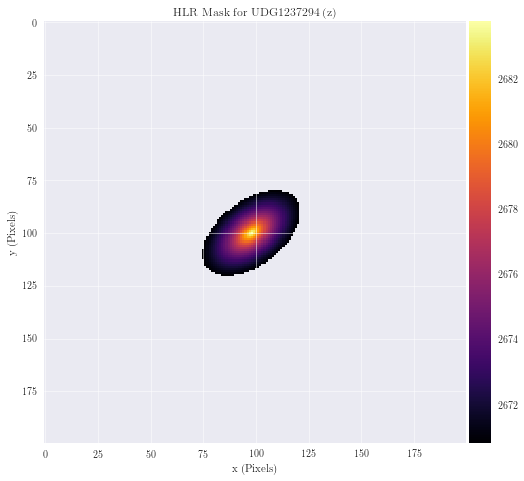


UDG1245277 (g) MODEL 
Percentile: 82.178

Interior 
	Flux: 15468.695 ADU 
	Mean: 2.170 ADU 
	RMS:  0.449 ADU 
	Area: 7128 ADU
Exterior 
	Flux: 15461.646 ADU 
	Mean: 0.470 ADU 
	RMS:  0.554 ADU 
	Area: 32872 ADU

SEMI-MAJOR AXIS:   112.641 pixels 
ANGULAR SIZE:      30.413 arcsec


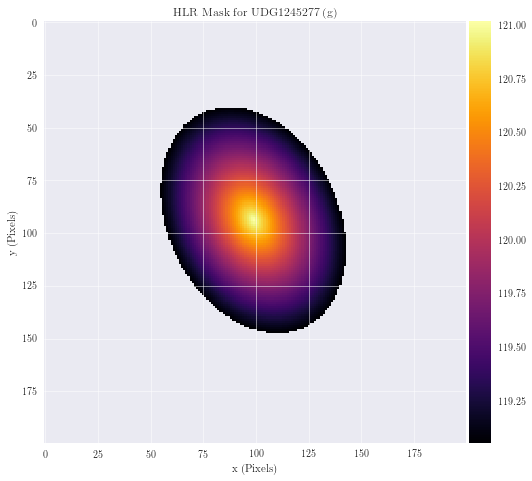


UDG1245277 (r) MODEL 
Percentile: 82.705

Interior 
	Flux: 16859.469 ADU 
	Mean: 2.437 ADU 
	RMS:  0.525 ADU 
	Area: 6918 ADU
Exterior 
	Flux: 16843.174 ADU 
	Mean: 0.509 ADU 
	RMS:  0.598 ADU 
	Area: 33082 ADU

SEMI-MAJOR AXIS:   108.745 pixels 
ANGULAR SIZE:      29.361 arcsec


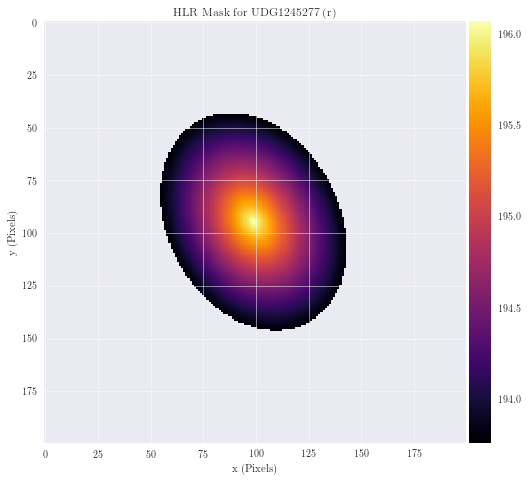


UDG1245277 (z) MODEL 
Percentile: 83.232

Interior 
	Flux: 28907.982 ADU 
	Mean: 4.310 ADU 
	RMS:  0.968 ADU 
	Area: 6707 ADU
Exterior 
	Flux: 28916.633 ADU 
	Mean: 0.869 ADU 
	RMS:  1.022 ADU 
	Area: 33293 ADU

SEMI-MAJOR AXIS:   106.366 pixels 
ANGULAR SIZE:      28.719 arcsec


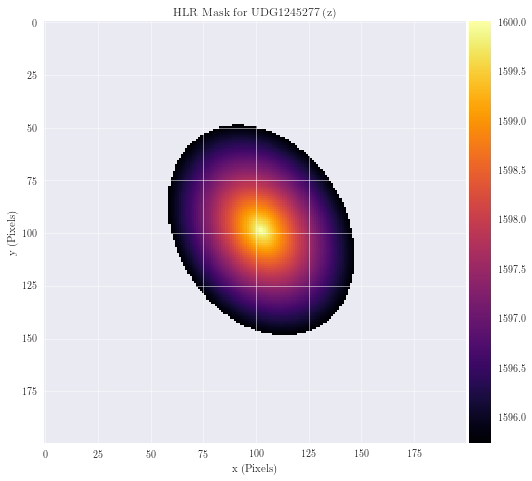


UDG0842120 (g) MODEL 
Percentile: 94.492

Interior 
	Flux: 18409.865 ADU 
	Mean: 8.357 ADU 
	RMS:  3.477 ADU 
	Area: 2203 ADU
Exterior 
	Flux: 18433.084 ADU 
	Mean: 0.488 ADU 
	RMS:  0.858 ADU 
	Area: 37797 ADU

SEMI-MAJOR AXIS:   58.460 pixels 
ANGULAR SIZE:      15.784 arcsec


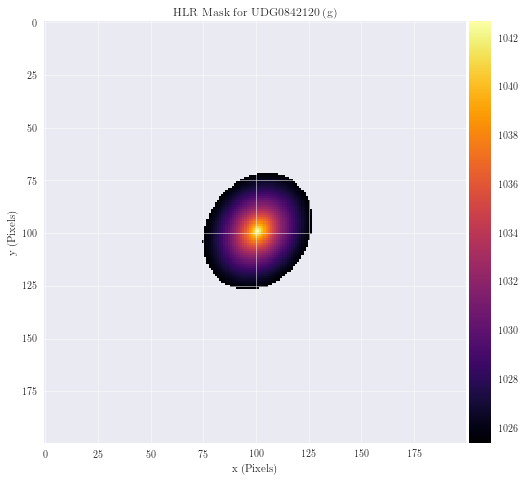


UDG0842120 (r) MODEL 
Percentile: 94.492

Interior 
	Flux: 18409.865 ADU 
	Mean: 8.357 ADU 
	RMS:  3.477 ADU 
	Area: 2203 ADU
Exterior 
	Flux: 18433.084 ADU 
	Mean: 0.488 ADU 
	RMS:  0.858 ADU 
	Area: 37797 ADU

SEMI-MAJOR AXIS:   58.460 pixels 
ANGULAR SIZE:      15.784 arcsec


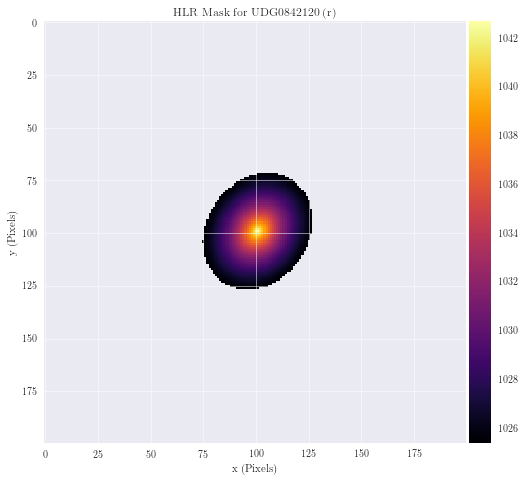


UDG0842120 (z) MODEL 
Percentile: 94.688

Interior 
	Flux: 35856.680 ADU 
	Mean: 16.882 ADU 
	RMS:  7.123 ADU 
	Area: 2124 ADU
Exterior 
	Flux: 35882.523 ADU 
	Mean: 0.947 ADU 
	RMS:  1.687 ADU 
	Area: 37876 ADU

SEMI-MAJOR AXIS:   68.367 pixels 
ANGULAR SIZE:      18.459 arcsec


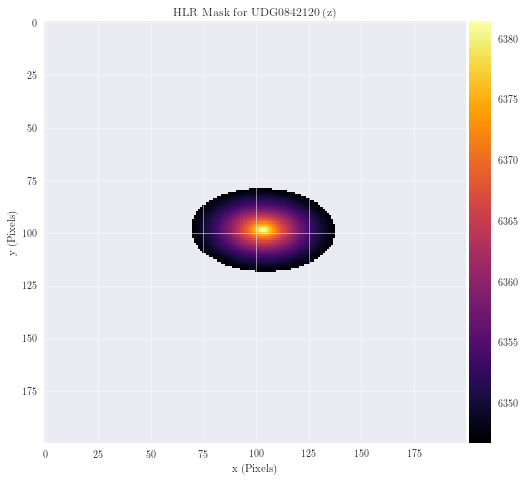


UDG0849322 (r) MODEL 
Percentile: 96.992

Interior 
	Flux: 3388.684 ADU 
	Mean: 2.815 ADU 
	RMS:  1.229 ADU 
	Area: 1204 ADU
Exterior 
	Flux: 3386.483 ADU 
	Mean: 0.087 ADU 
	RMS:  0.214 ADU 
	Area: 38796 ADU

SEMI-MAJOR AXIS:   51.410 pixels 
ANGULAR SIZE:      13.881 arcsec


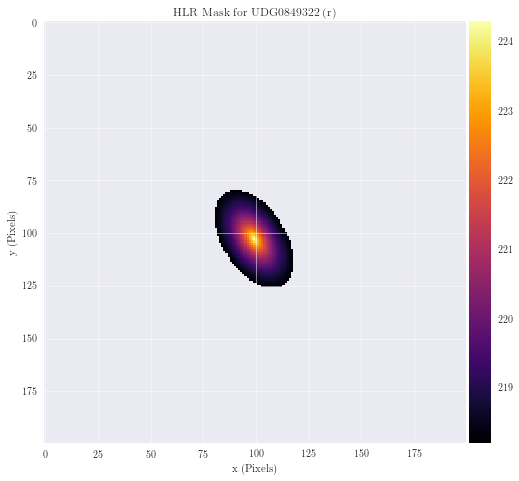


UDG0849322 (z) MODEL 
Percentile: 96.992

Interior 
	Flux: 3388.684 ADU 
	Mean: 2.815 ADU 
	RMS:  1.229 ADU 
	Area: 1204 ADU
Exterior 
	Flux: 3386.483 ADU 
	Mean: 0.087 ADU 
	RMS:  0.214 ADU 
	Area: 38796 ADU

SEMI-MAJOR AXIS:   51.410 pixels 
ANGULAR SIZE:      13.881 arcsec


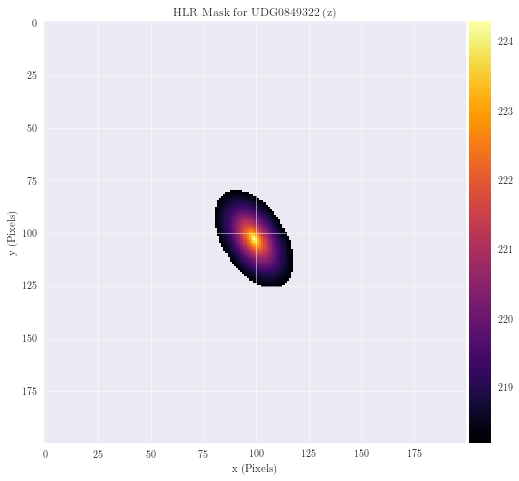


UDG0852477 (g) MODEL 
Percentile: 94.922

Interior 
	Flux: 6411.682 ADU 
	Mean: 3.155 ADU 
	RMS:  1.339 ADU 
	Area: 2032 ADU
Exterior 
	Flux: 6398.682 ADU 
	Mean: 0.169 ADU 
	RMS:  0.308 ADU 
	Area: 37968 ADU

SEMI-MAJOR AXIS:   71.399 pixels 
ANGULAR SIZE:      19.278 arcsec


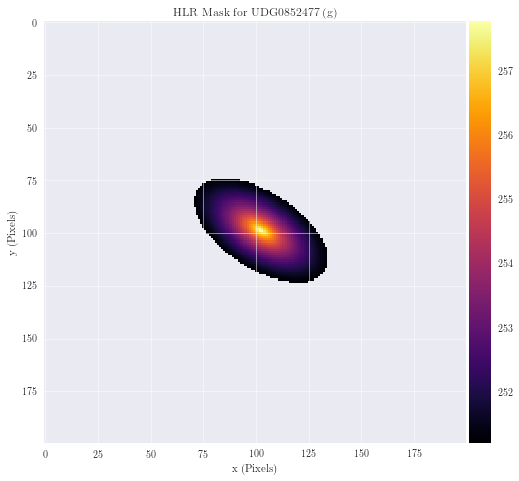


UDG0852477 (r) MODEL 
Percentile: 97.129

Interior 
	Flux: 5119.088 ADU 
	Mean: 4.455 ADU 
	RMS:  1.949 ADU 
	Area: 1149 ADU
Exterior 
	Flux: 5119.823 ADU 
	Mean: 0.132 ADU 
	RMS:  0.332 ADU 
	Area: 38851 ADU

SEMI-MAJOR AXIS:   54.319 pixels 
ANGULAR SIZE:      14.666 arcsec


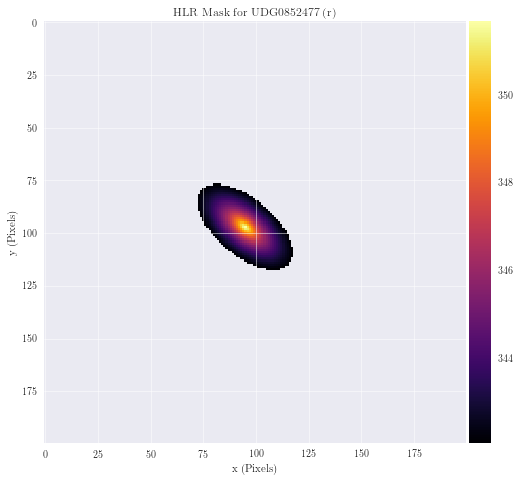


UDG0854195 (g) MODEL 
Percentile: 92.266

Interior 
	Flux: 5863.413 ADU 
	Mean: 1.895 ADU 
	RMS:  0.749 ADU 
	Area: 3094 ADU
Exterior 
	Flux: 5878.567 ADU 
	Mean: 0.159 ADU 
	RMS:  0.232 ADU 
	Area: 36906 ADU

SEMI-MAJOR AXIS:   90.005 pixels 
ANGULAR SIZE:      24.301 arcsec


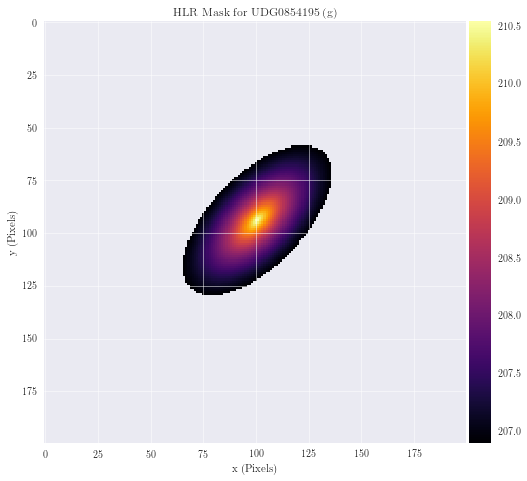


UDG0854195 (r) MODEL 
Percentile: 88.242

Interior 
	Flux: 18147.457 ADU 
	Mean: 3.858 ADU 
	RMS:  1.268 ADU 
	Area: 4704 ADU
Exterior 
	Flux: 18172.549 ADU 
	Mean: 0.515 ADU 
	RMS:  0.634 ADU 
	Area: 35296 ADU

SEMI-MAJOR AXIS:   99.413 pixels 
ANGULAR SIZE:      26.842 arcsec


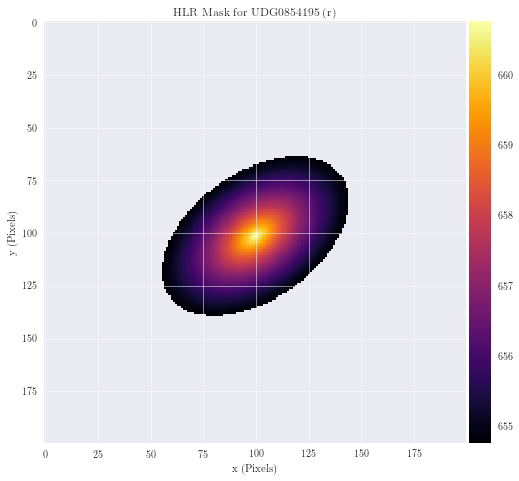


UDG0854195 (z) MODEL 
Percentile: 89.121

Interior 
	Flux: 27136.115 ADU 
	Mean: 6.235 ADU 
	RMS:  2.130 ADU 
	Area: 4352 ADU
Exterior 
	Flux: 27214.289 ADU 
	Mean: 0.763 ADU 
	RMS:  0.964 ADU 
	Area: 35648 ADU

SEMI-MAJOR AXIS:   89.292 pixels 
ANGULAR SIZE:      24.109 arcsec


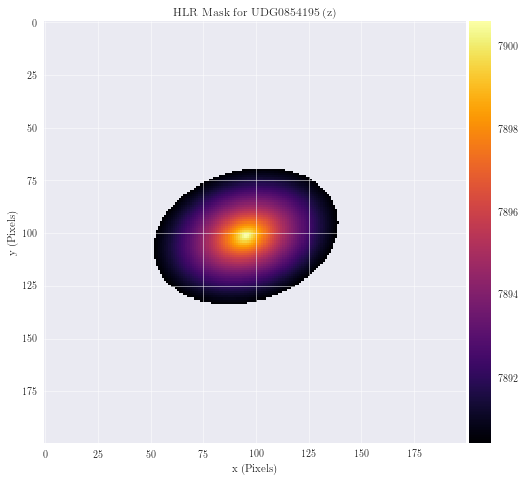


UDG0855549 (g) MODEL 
Percentile: 98.193

Interior 
	Flux: 3884.965 ADU 
	Mean: 5.373 ADU 
	RMS:  2.363 ADU 
	Area: 723 ADU
Exterior 
	Flux: 3886.087 ADU 
	Mean: 0.099 ADU 
	RMS:  0.323 ADU 
	Area: 39277 ADU

SEMI-MAJOR AXIS:   40.756 pixels 
ANGULAR SIZE:      11.004 arcsec


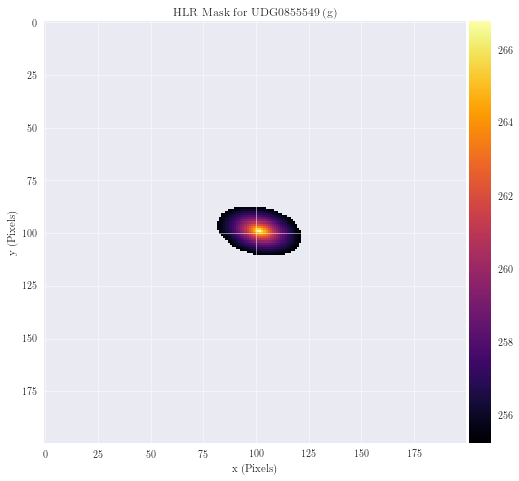


UDG0855549 (r) MODEL 
Percentile: 98.701

Interior 
	Flux: 5010.821 ADU 
	Mean: 9.636 ADU 
	RMS:  4.237 ADU 
	Area: 520 ADU
Exterior 
	Flux: 5014.903 ADU 
	Mean: 0.127 ADU 
	RMS:  0.496 ADU 
	Area: 39480 ADU

SEMI-MAJOR AXIS:   36.149 pixels 
ANGULAR SIZE:      9.760 arcsec


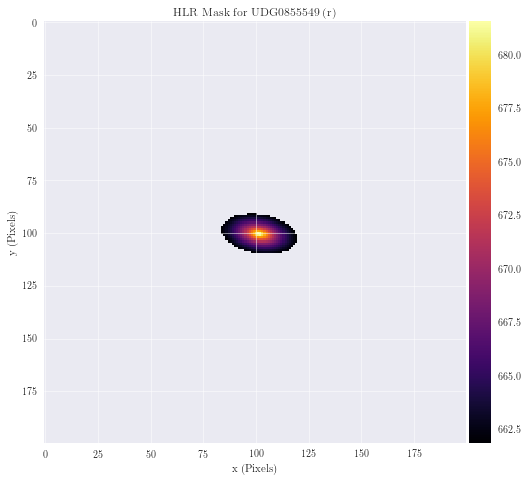


UDG0855549 (z) MODEL 
Percentile: 97.949

Interior 
	Flux: 13392.467 ADU 
	Mean: 16.312 ADU 
	RMS:  7.172 ADU 
	Area: 821 ADU
Exterior 
	Flux: 13380.366 ADU 
	Mean: 0.342 ADU 
	RMS:  1.039 ADU 
	Area: 39179 ADU

SEMI-MAJOR AXIS:   48.295 pixels 
ANGULAR SIZE:      13.040 arcsec


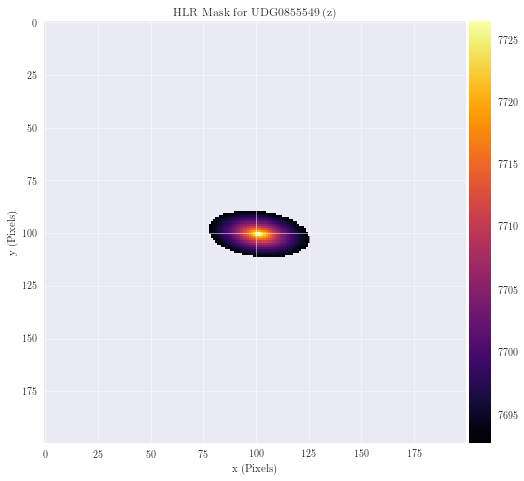


UDG0856259 (g) MODEL 
Percentile: 92.578

Interior 
	Flux: 15175.354 ADU 
	Mean: 5.111 ADU 
	RMS:  2.013 ADU 
	Area: 2969 ADU
Exterior 
	Flux: 15136.326 ADU 
	Mean: 0.409 ADU 
	RMS:  0.616 ADU 
	Area: 37031 ADU

SEMI-MAJOR AXIS:   67.706 pixels 
ANGULAR SIZE:      18.281 arcsec


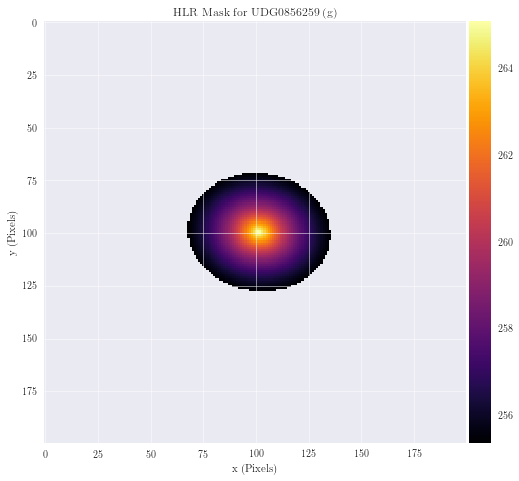


UDG0856259 (r) MODEL 
Percentile: 92.578

Interior 
	Flux: 24737.070 ADU 
	Mean: 8.332 ADU 
	RMS:  3.284 ADU 
	Area: 2969 ADU
Exterior 
	Flux: 24760.271 ADU 
	Mean: 0.669 ADU 
	RMS:  1.004 ADU 
	Area: 37031 ADU

SEMI-MAJOR AXIS:   70.880 pixels 
ANGULAR SIZE:      19.138 arcsec


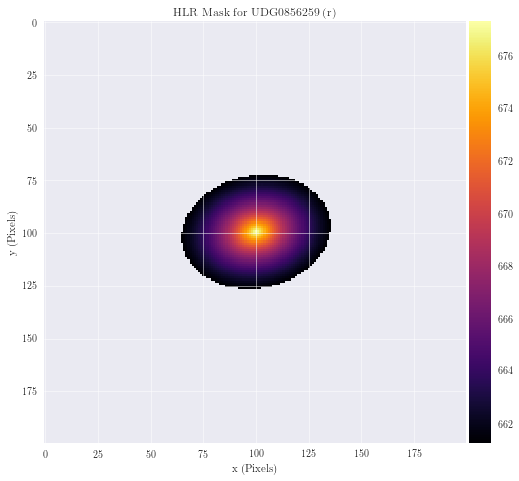


UDG0112072 (g) MODEL 
Percentile: 94.883

Interior 
	Flux: 8449.575 ADU 
	Mean: 4.128 ADU 
	RMS:  1.736 ADU 
	Area: 2047 ADU
Exterior 
	Flux: 8443.802 ADU 
	Mean: 0.222 ADU 
	RMS:  0.407 ADU 
	Area: 37953 ADU

SEMI-MAJOR AXIS:   55.672 pixels 
ANGULAR SIZE:      15.031 arcsec


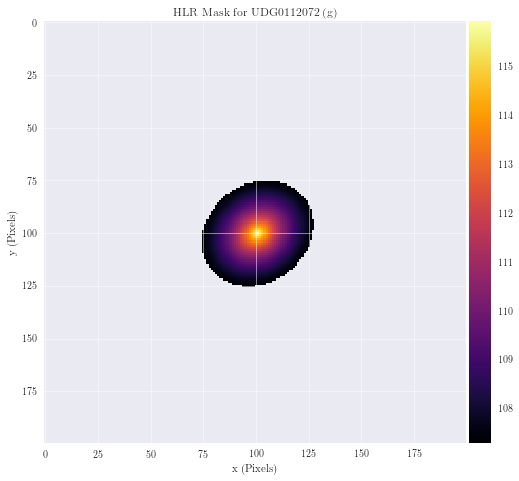


UDG0112072 (r) MODEL 
Percentile: 95.273

Interior 
	Flux: 15581.334 ADU 
	Mean: 8.240 ADU 
	RMS:  3.496 ADU 
	Area: 1891 ADU
Exterior 
	Flux: 15607.961 ADU 
	Mean: 0.410 ADU 
	RMS:  0.781 ADU 
	Area: 38109 ADU

SEMI-MAJOR AXIS:   58.875 pixels 
ANGULAR SIZE:      15.896 arcsec


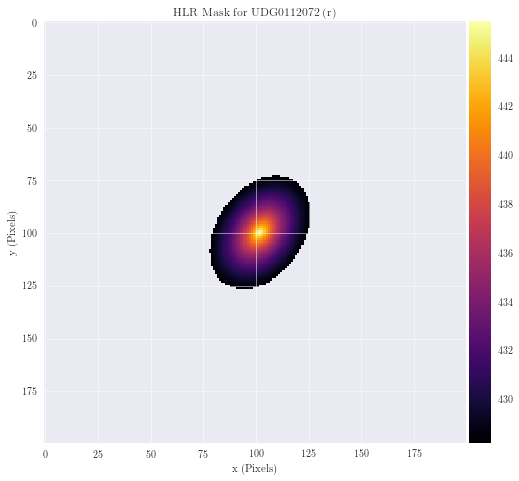


UDG0112072 (z) MODEL 
Percentile: 93.672

Interior 
	Flux: 18460.684 ADU 
	Mean: 7.291 ADU 
	RMS:  2.967 ADU 
	Area: 2532 ADU
Exterior 
	Flux: 18443.688 ADU 
	Mean: 0.492 ADU 
	RMS:  0.805 ADU 
	Area: 37468 ADU

SEMI-MAJOR AXIS:   61.303 pixels 
ANGULAR SIZE:      16.552 arcsec


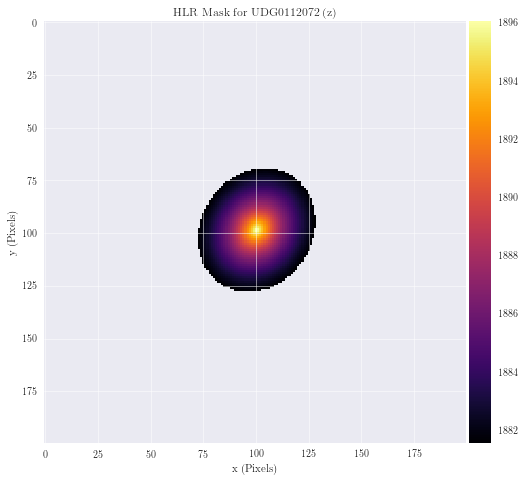


UDG0113101 (g) MODEL 
Percentile: 97.383

Interior 
	Flux: 1760.696 ADU 
	Mean: 1.682 ADU 
	RMS:  0.735 ADU 
	Area: 1047 ADU
Exterior 
	Flux: 1767.697 ADU 
	Mean: 0.045 ADU 
	RMS:  0.120 ADU 
	Area: 38953 ADU

SEMI-MAJOR AXIS:   45.026 pixels 
ANGULAR SIZE:      12.157 arcsec


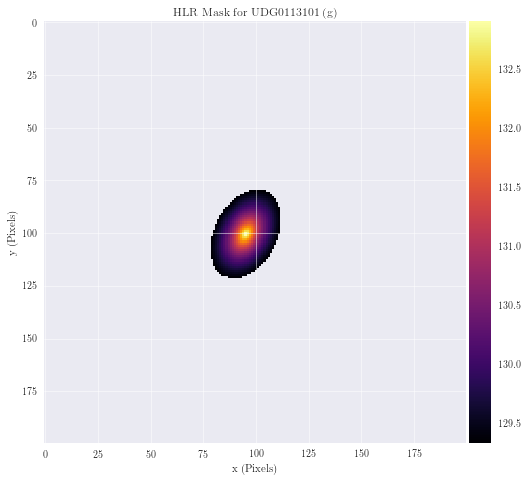


UDG0113101 (z) MODEL 
Percentile: 97.715

Interior 
	Flux: 3498.644 ADU 
	Mean: 3.824 ADU 
	RMS:  1.681 ADU 
	Area: 915 ADU
Exterior 
	Flux: 3495.009 ADU 
	Mean: 0.089 ADU 
	RMS:  0.256 ADU 
	Area: 39085 ADU

SEMI-MAJOR AXIS:   40.798 pixels 
ANGULAR SIZE:      11.015 arcsec


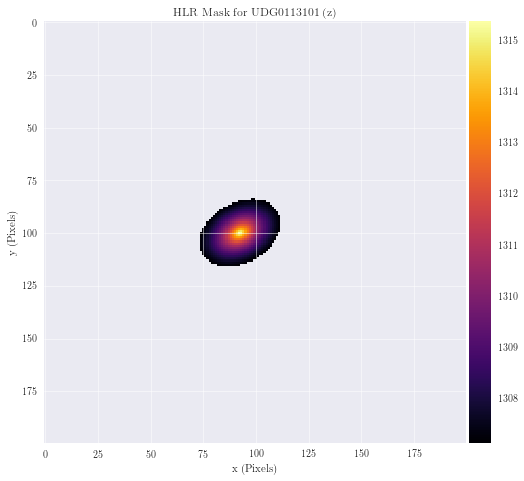


UDG0113177 (g) MODEL 
Percentile: 95.820

Interior 
	Flux: 5913.945 ADU 
	Mean: 3.537 ADU 
	RMS:  1.520 ADU 
	Area: 1672 ADU
Exterior 
	Flux: 5899.751 ADU 
	Mean: 0.154 ADU 
	RMS:  0.315 ADU 
	Area: 38328 ADU

SEMI-MAJOR AXIS:   50.775 pixels 
ANGULAR SIZE:      13.709 arcsec


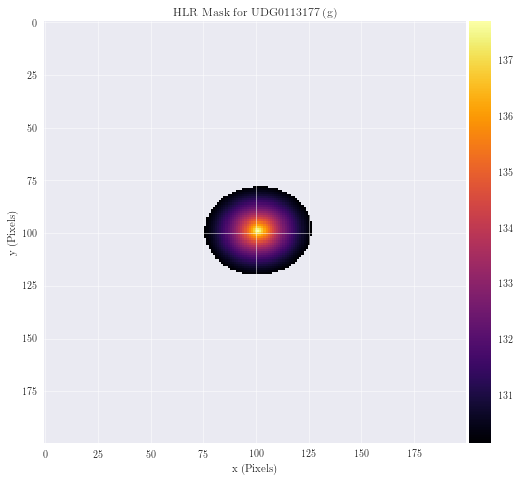


UDG0113177 (r) MODEL 
Percentile: 95.938

Interior 
	Flux: 13561.994 ADU 
	Mean: 8.346 ADU 
	RMS:  3.590 ADU 
	Area: 1625 ADU
Exterior 
	Flux: 13558.231 ADU 
	Mean: 0.353 ADU 
	RMS:  0.734 ADU 
	Area: 38375 ADU

SEMI-MAJOR AXIS:   51.216 pixels 
ANGULAR SIZE:      13.828 arcsec


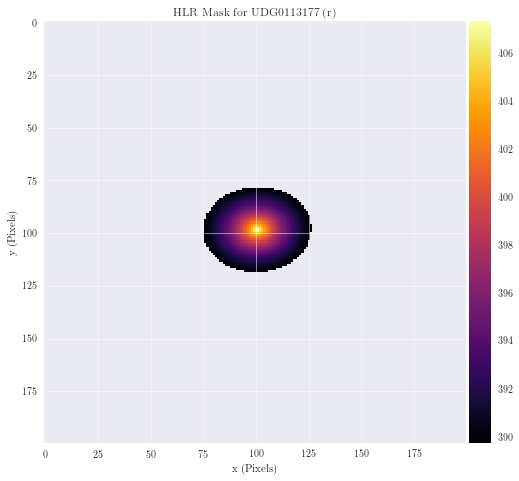


UDG0113177 (z) MODEL 
Percentile: 96.641

Interior 
	Flux: 13721.404 ADU 
	Mean: 10.209 ADU 
	RMS:  4.452 ADU 
	Area: 1344 ADU
Exterior 
	Flux: 13663.510 ADU 
	Mean: 0.353 ADU 
	RMS:  0.817 ADU 
	Area: 38656 ADU

SEMI-MAJOR AXIS:   48.623 pixels 
ANGULAR SIZE:      13.128 arcsec


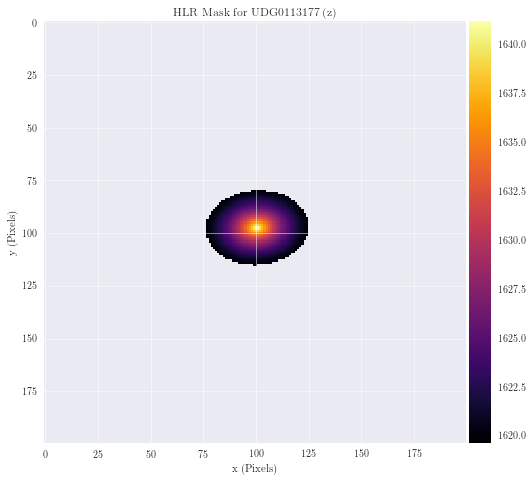


UDG0115016 (g) MODEL 
Percentile: 93.672

Interior 
	Flux: 5414.279 ADU 
	Mean: 2.138 ADU 
	RMS:  0.874 ADU 
	Area: 2532 ADU
Exterior 
	Flux: 5416.588 ADU 
	Mean: 0.145 ADU 
	RMS:  0.235 ADU 
	Area: 37468 ADU

SEMI-MAJOR AXIS:   71.640 pixels 
ANGULAR SIZE:      19.343 arcsec


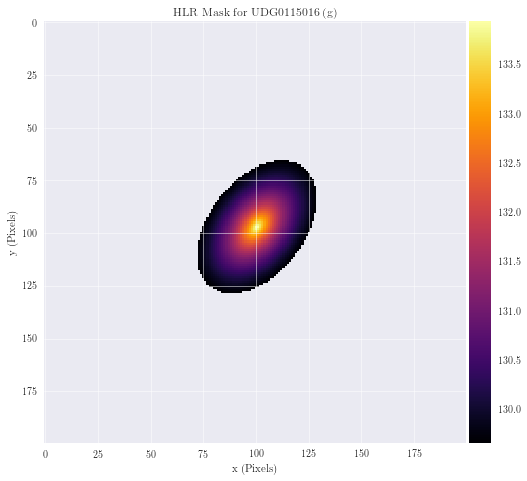


UDG0115016 (r) MODEL 
Percentile: 94.219

Interior 
	Flux: 12000.406 ADU 
	Mean: 5.188 ADU 
	RMS:  2.170 ADU 
	Area: 2313 ADU
Exterior 
	Flux: 11963.650 ADU 
	Mean: 0.317 ADU 
	RMS:  0.540 ADU 
	Area: 37687 ADU

SEMI-MAJOR AXIS:   73.643 pixels 
ANGULAR SIZE:      19.884 arcsec


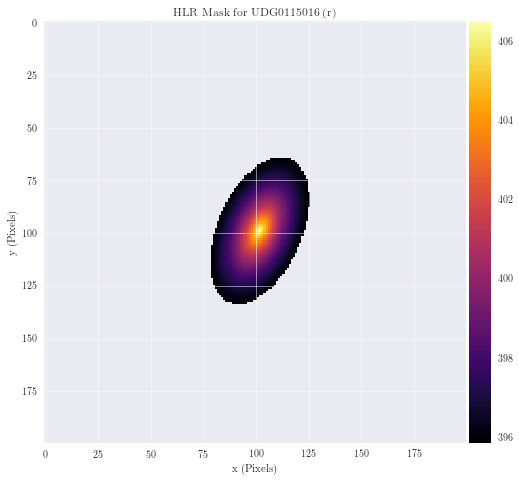


UDG0115016 (z) MODEL 
Percentile: 92.812

Interior 
	Flux: 15292.087 ADU 
	Mean: 5.319 ADU 
	RMS:  2.098 ADU 
	Area: 2875 ADU
Exterior 
	Flux: 15326.957 ADU 
	Mean: 0.413 ADU 
	RMS:  0.633 ADU 
	Area: 37125 ADU

SEMI-MAJOR AXIS:   60.584 pixels 
ANGULAR SIZE:      16.358 arcsec


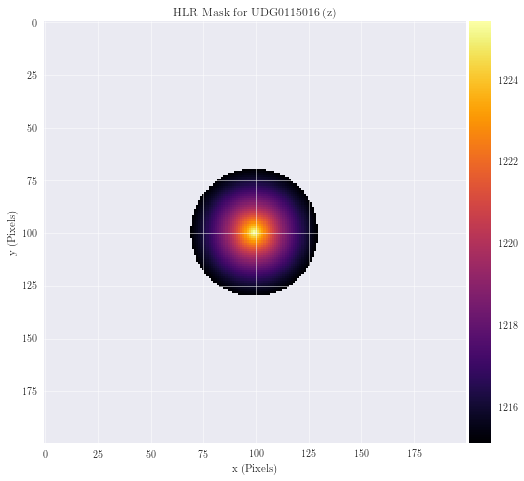


UDG0239472 (g) MODEL 
Percentile: 93.125

Interior 
	Flux: 3723.557 ADU 
	Mean: 1.354 ADU 
	RMS:  0.546 ADU 
	Area: 2750 ADU
Exterior 
	Flux: 3739.946 ADU 
	Mean: 0.100 ADU 
	RMS:  0.156 ADU 
	Area: 37250 ADU

SEMI-MAJOR AXIS:   74.218 pixels 
ANGULAR SIZE:      20.039 arcsec


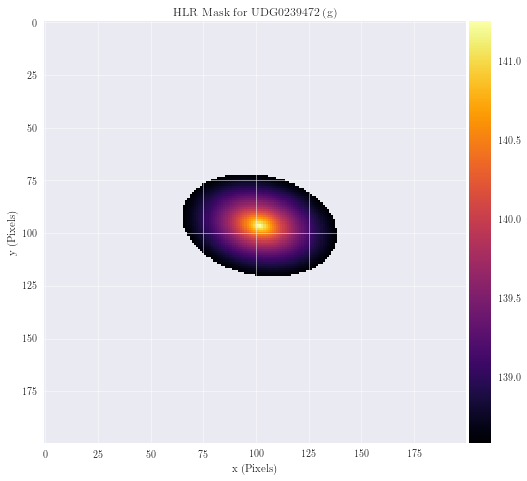


UDG0239472 (r) MODEL 
Percentile: 91.406

Interior 
	Flux: 8819.405 ADU 
	Mean: 2.565 ADU 
	RMS:  0.967 ADU 
	Area: 3438 ADU
Exterior 
	Flux: 8820.105 ADU 
	Mean: 0.241 ADU 
	RMS:  0.338 ADU 
	Area: 36562 ADU

SEMI-MAJOR AXIS:   74.632 pixels 
ANGULAR SIZE:      20.151 arcsec


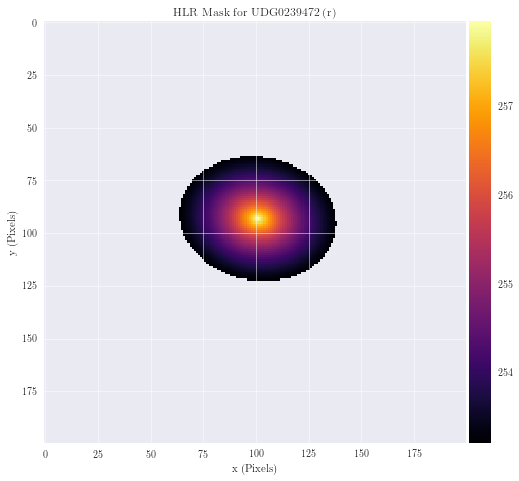


UDG0244338 (g) MODEL 
Percentile: 89.209

Interior 
	Flux: 21887.441 ADU 
	Mean: 5.070 ADU 
	RMS:  1.719 ADU 
	Area: 4317 ADU
Exterior 
	Flux: 21992.279 ADU 
	Mean: 0.616 ADU 
	RMS:  0.786 ADU 
	Area: 35683 ADU

SEMI-MAJOR AXIS:   87.982 pixels 
ANGULAR SIZE:      23.755 arcsec


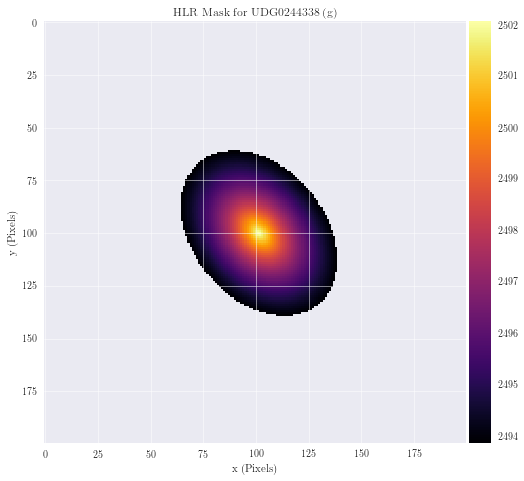


UDG0244338 (r) MODEL 
Percentile: 89.385

Interior 
	Flux: 40276.121 ADU 
	Mean: 9.488 ADU 
	RMS:  3.235 ADU 
	Area: 4245 ADU
Exterior 
	Flux: 40346.559 ADU 
	Mean: 1.128 ADU 
	RMS:  1.452 ADU 
	Area: 35755 ADU

SEMI-MAJOR AXIS:   79.515 pixels 
ANGULAR SIZE:      21.469 arcsec


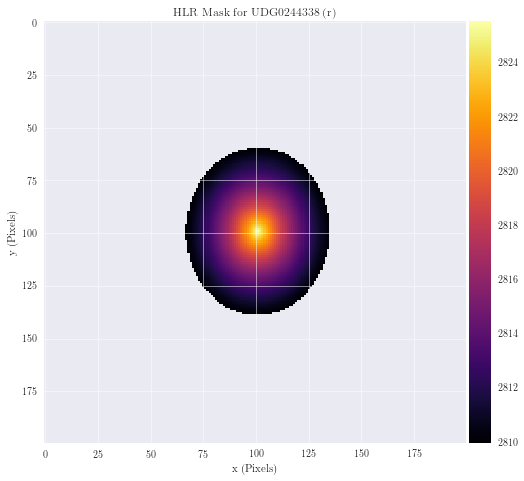


UDG0244338 (z) MODEL 
Percentile: 89.473

Interior 
	Flux: 51917.375 ADU 
	Mean: 12.329 ADU 
	RMS:  4.209 ADU 
	Area: 4211 ADU
Exterior 
	Flux: 51999.371 ADU 
	Mean: 1.453 ADU 
	RMS:  1.879 ADU 
	Area: 35789 ADU

SEMI-MAJOR AXIS:   77.949 pixels 
ANGULAR SIZE:      21.046 arcsec


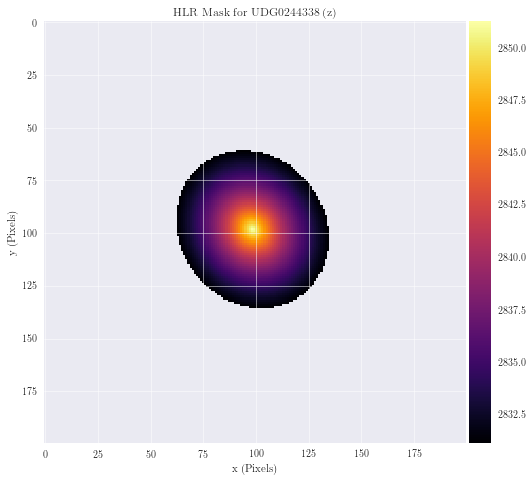

In [18]:
for obs in obs_list:

    if obs.process == False:
        background_statistics(obs, plot=False)
        half_light_mask(obs, percent=90, plot=True, verbose=True)
        
        obs.process = True

The plots above depict the half-light radius mask for all previously observed UDGs. We will analyze pixel variations in the regions defined by these masks.

# Characterizing Pixel Intensity Variations
See $\S6$: "Searching for Structure in Point Data" from <u> Statistics, Data Mining, and Machine Learning in Astronomy </u> by Ivezic, Connolly, VanderPlas, and Gray.

## Kernel Density Estimation
Given a sample, Kernel Density Estimation (KDE) is a non-parametric, smoothing technique used to construct an estimate for the underlying probability distribution used to generate the sample data. KDE is mathematically defined as

<center> $\hat{f}_N(x) = \frac{1}{h^D} \sum_{i=1}^N K\left(\frac{d(x,x_i)}{h}\right)$, </center>

where $K(u)$ is the kernel and $h$ is the bandwidth (i.e. size of kernel). KDE estimates the underlying distribution by taking a weighted mean of the sample data, using the kernel fuction as the weight.


### Using a Gaussian Kernel
We use the Gaussian kernel:

<center> $K(u) = \frac{1}{(2\pi)^{D/2}} \exp \left(-u^2/2 \right)$, </center>

where $D$ is the number of dimensions (i.e. 1 in this case), and $u = d(x, x_i)/h$. 

I chose a Gaussian kernel for the KDE since the underlying distribution of pixel intensities should be roughly Gaussian, due to the Central Limit Theorem. More specifically, the background fluctuation is roughly Gaussian. In low-surface brightness astronomy, the background is the dominant source of the flux.

KDE can easily be modified to use other kernels, including but not limited to 'exponential,' 'tophat,' and 'epanechnikov' kernels. Due to the relatively large number of pixels available, the KDE results using all kernels vary minimally. To plot the results from other kernels, include each kernel keyword into the "kernel_list" in the code below.

The bandwidth choice has a greater impact on KDE as opposed to the kernel choice when large number of pixels are available. Cross-validation can be used to optimize for the bandwidth, which will be implemented in the future. Here, I have determined the best KDE bandwidth by eye for each band. 


### Implementing a Gaussian KDE on Pixel Intensity Variations
Below follows the implementation of Scikit-Learn's 1D Kernel Density Estimation Example, which can be found here:
http://scikit-learn.org/stable/auto_examples/neighbors/plot_kde_1d.html

In [19]:
def plot_kde(data, mask=None, band='g', background=None, file=None, verbose=False):
    
    kernel_list = ['gaussian'] # Add Other Kernels: 'exponential', 'tophat', 'epanechnikov', 'gaussian'
    
    if mask==None:
        mask = np.ones(data.shape, dtype=bool)

    plt.rcParams.update({'font.size': 20})
    plt.rc('xtick', labelsize=20) 
    plt.rc('ytick', labelsize=20)

    
    
    # IMAGE WITH HALF-LIGHT RADIUS MASK    
    plt.clf()
    fig = plt.figure(figsize=(10, 15))
    gs = gridspec.GridSpec(3,2)
    
    ax1 = fig.add_subplot(gs[0,0])
    ax1.set_title(r"{0} ({1})".format(obs.name.split("_")[0], obs.band))
    
    image1 = fits.getdata(obs.get_unsub())
    min_scale = np.min(image1)
    max_scale = np.mean(image1) + 2.5*np.std(image1)
    img = plt.imshow(image1, interpolation='none', aspect='equal', cmap='inferno', vmin=min_scale, vmax=max_scale)
    #ax1.grid(color='w', linestyle='-', linewidth=0.5)
    ax1.grid(False)
    plt.xticks([])
    plt.yticks([])
    
    
    ax2 = fig.add_subplot(gs[0,1])
    ax2.set_title(r"{0} ({1}) HLR Mask".format(obs.name.split("_")[0], obs.band))
    
    image2 = 1. * data
    image2[~mask] = np.nan
    min_scale = np.min(image2[mask])
    max_scale = np.mean(image2[mask]) + 2.5*np.std(image2[mask])
    img = plt.imshow(image2, interpolation='none', aspect='equal', cmap='inferno', vmin=min_scale, vmax=max_scale)
    #ax2.grid(color='w', linestyle='-', linewidth=0.5)
    ax2.grid(False)
    plt.xticks([])
    plt.yticks([])
    
    
    # INTENSITY HISTOGRAM OF MASKED IMAGES
    ax3 = fig.add_subplot(gs[1:, 0:])
    #ax3.set_facecolor('white')
    ax3.set_title("{0} ({1}) Pixel Variation".format(obs.name.split("_")[0], obs.band))
    ax3.set_xlabel("Pixel Intensity (ADU)")
    ax3.set_ylabel("PDF")
    
    """
    ax3.spines['right'].set_visible(True)
    ax3.spines['top'].set_visible(True)
    ax3.spines['right'].set_visible(True)
    ax3.spines['top'].set_visible(True)
    """
    
    # Plots Gaussian.
    arr = np.sort(data[mask].reshape((np.sum(mask),1)))
    x = np.linspace(np.min(arr), np.max(arr), arr.size)[:, np.newaxis]
        
    if background != None:
        obs.gal_mean   = np.mean(data[mask])
        obs.gal_median = np.median(data[mask])
        obs.gal_stdev  = np.sqrt( np.sum(data[mask][data[mask]<0]**2) / (data[mask][data[mask]<0].size-1) )

        gauss = norm.pdf(x, 0, obs.gal_stdev)
        plt.plot(x, gauss, color='g')
    
    
    # Plots mean, 1-sigma, 2-sigma, and 3-sigma.
    mu, sigma = norm.fit(arr)  
    plt.axvline(x=mu,         linestyle="-",  color='g', alpha=0.5)
    plt.axvline(x=mu+sigma,   linestyle="-.", color='g', alpha=0.5)
    plt.axvline(x=mu-sigma,   linestyle="-.", color='g', alpha=0.5)
    plt.axvline(x=mu-2*sigma, linestyle="--", color='g', alpha=0.5)
    plt.axvline(x=mu+2*sigma, linestyle="--", color='g', alpha=0.5)
    plt.axvline(x=mu-3*sigma, linestyle=":",  color='g', alpha=0.5)
    plt.axvline(x=mu+3*sigma, linestyle=":",  color='g', alpha=0.5)
    if verbose:
        print("\n\tmu:     %.3f" % mu,
              "\n\tsigma:  %.3f" % sigma,
              "\n\tMedian: %.3f" % np.median(arr))

    
    # Plots Histogram of Masked Data.
    ax3.hist(data[mask], bins=30, normed=True, alpha=0.3)
    
    
    # Plots the KDE Distribution.
    for kernel in kernel_list:
        if any([band == 'z',band=='z1']):
            kde = KernelDensity(kernel=kernel, bandwidth=1.75).fit(arr)
        if band == 'r':
            kde = KernelDensity(kernel=kernel, bandwidth=0.85).fit(arr)
        if band == 'g':
            kde = KernelDensity(kernel=kernel, bandwidth=0.7).fit(arr)

        y = np.exp(kde.score_samples(x))
        ax3.plot(x[:, 0], y, '-', c='r', label="kernel = '{0}'".format(kernel))

    
    ax3.set_xlim((mu-3.5*sigma, mu+3.5*sigma))
    ax3.legend(loc='best')
    
    plt.tight_layout()
    if file != None:
        plt.savefig(file, format='png', bbox_inches='tight')
    plt.show()
    plt.close()
    
    del data, mask, image1, image2, img
    gc.collect()
    
    return x,y

For each unique band for every target, I have plotted the mask-applied residual image (left) and its pixel-intensity histogram (right). The Gaussian kernel density estimate is plotted in red. The green curve is a Gaussian centered on the mean intensity of the mask-applied residual. The 1st, 2nd, and 3rd standard deviations of the Gaussian are denoted by dashed green lines. The choice of bandwidth varies with each band. The appropriate bandwidth choice is necessary to prevent over- and underfitting the distribution.

# Results

If the candidates were perfectly smooth objects (i.e. lacking features, structures, and clumpiness), subtracting a smooth model from the original image should remove the galaxy in its entirety. However, if structures remain, we will see it in the residual images. In the case where the model image is a composite of a uniform background (with no errors) and a near-exponential profile for the galaxy, the residual image of a featureless galaxy should have a mean of zero with Poisson noise from both the background and the galaxy. To first order, a featureless galaxy will have a pixel intensity variation modeled by $\mathcal{N}(\mu=0, \sigma)$, where $\sigma$ is standard deviation of the mask-applied residual image.

### Mean Square Error
The mean square error (MSE) measures the average squared deviation from the actual and predicted values, such that
<center> $\mathrm{MSE} = \frac{1}{n} \sum\limits_{i=1}^N \left(Y_i - \widehat{Y}_i \right)^2$ </center>.

The assume that the true distribution is the one estimated by Gaussian KDE. The predicted distribution is determined by theory. I use the MSE to quantify the amount of pixel variation observed in each of our targets.

In [20]:
def set_mse(obs, sigma=5, verbose=False): 
    
    x,y = obs.kde
    gauss1  = norm.pdf(x, 0, obs.gal_stdev)
    obs.mse = np.sum(((y-gauss1)**2)) / y.size

    return obs.mse

In [21]:
# For Debugging Purposes
# Set process to False after Each Step.

for obs in obs_list:
    obs.process = False

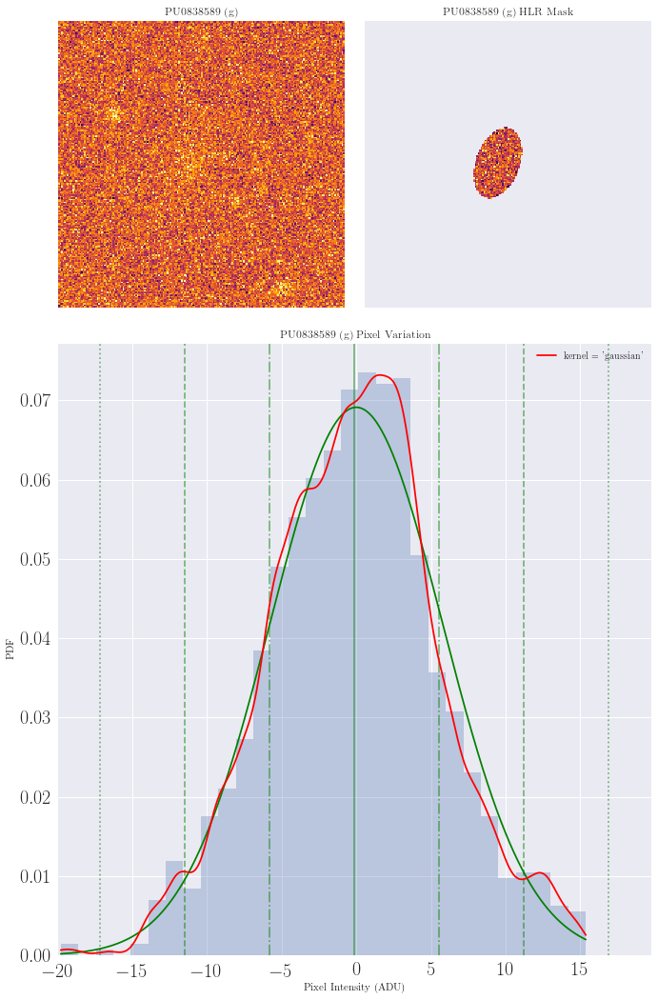

PU0838589 (g) 
	Background Mean:   124.481 ADU 
	Background StDev:  0.001 ADU 
	Galaxy Mean:       -0.110 ADU 
	Galaxy Median:     0.037 ADU 
	Galaxy StDev:      5.773 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 1.480 ADU


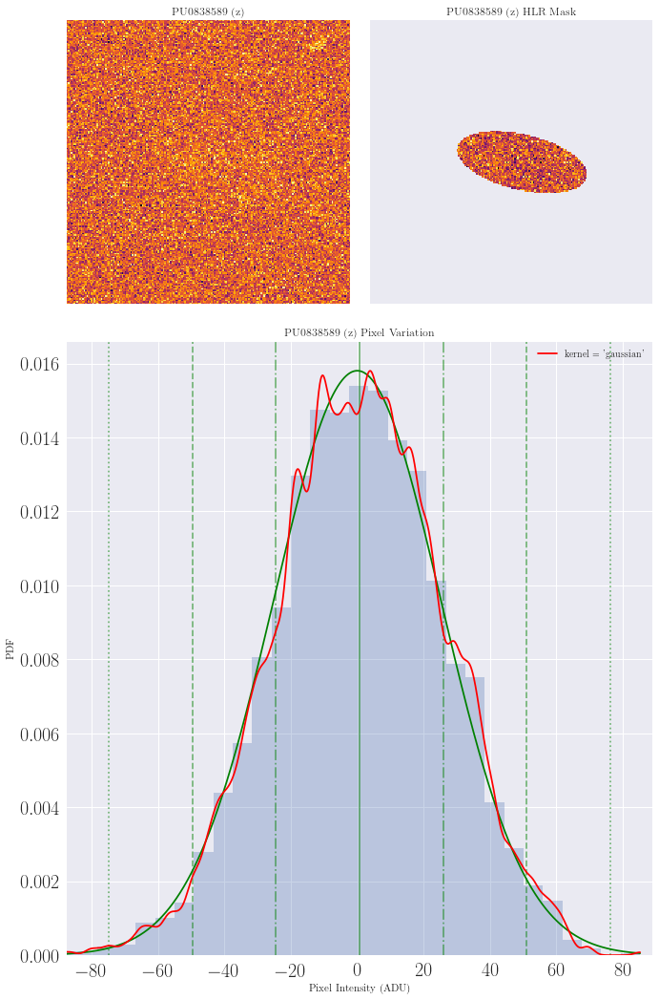

PU0838589 (z) 
	Background Mean:   2894.259 ADU 
	Background StDev:  0.023 ADU 
	Galaxy Mean:       0.677 ADU 
	Galaxy Median:     0.942 ADU 
	Galaxy StDev:      25.242 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 0.180 ADU


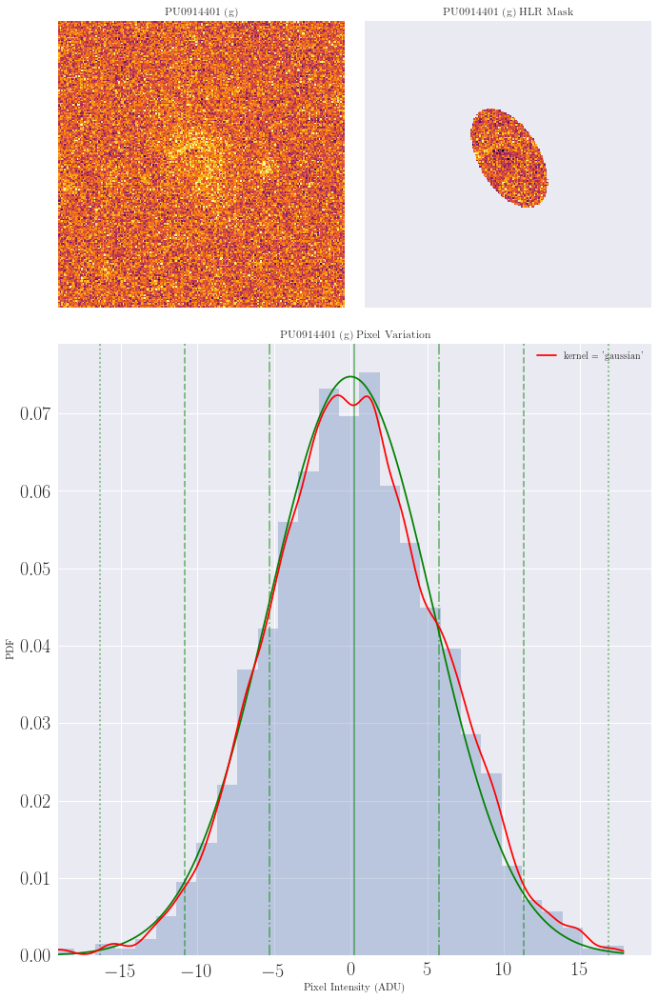

PU0914401 (g) 
	Background Mean:   116.684 ADU 
	Background StDev:  0.018 ADU 
	Galaxy Mean:       0.266 ADU 
	Galaxy Median:     0.149 ADU 
	Galaxy StDev:      5.335 ADU 
	Recessional Vel:   6558.000 ADU 
	Mean Square Error: 3.398 ADU


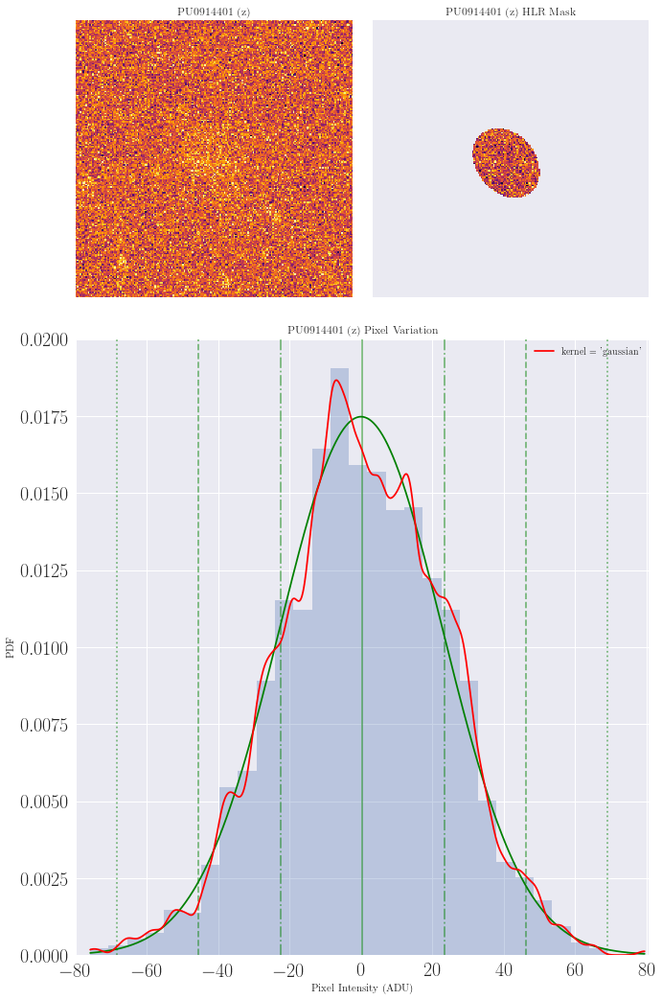

PU0914401 (z) 
	Background Mean:   2086.691 ADU 
	Background StDev:  0.020 ADU 
	Galaxy Mean:       0.337 ADU 
	Galaxy Median:     -0.015 ADU 
	Galaxy StDev:      22.822 ADU 
	Recessional Vel:   6558.000 ADU 
	Mean Square Error: 0.140 ADU


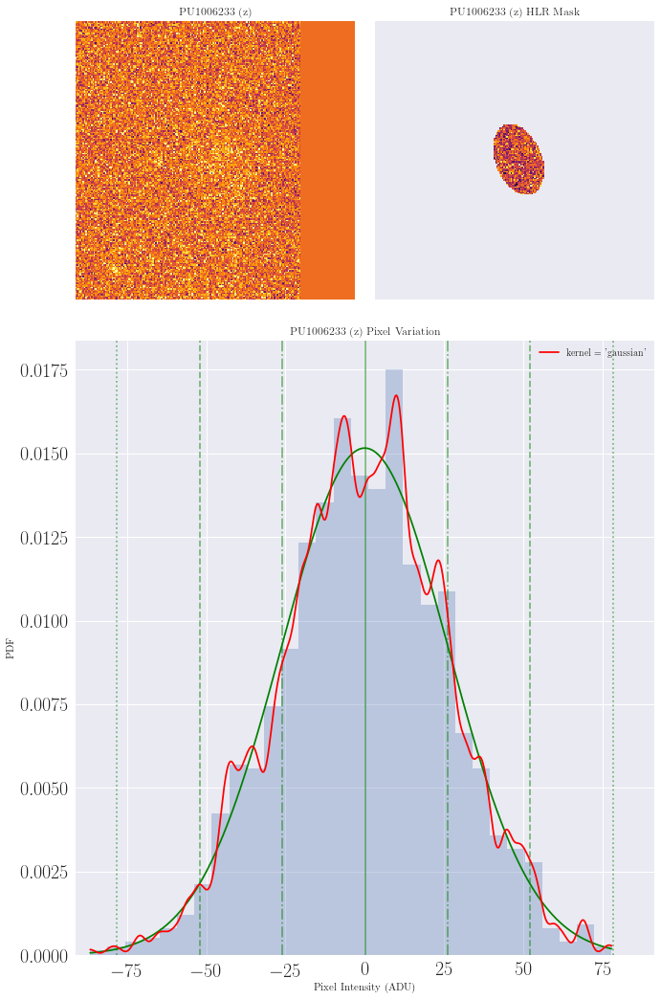

PU1006233 (z) 
	Background Mean:   2656.429 ADU 
	Background StDev:  0.006 ADU 
	Galaxy Mean:       0.066 ADU 
	Galaxy Median:     0.438 ADU 
	Galaxy StDev:      26.320 ADU 
	Recessional Vel:   1202.000 ADU 
	Mean Square Error: 0.079 ADU


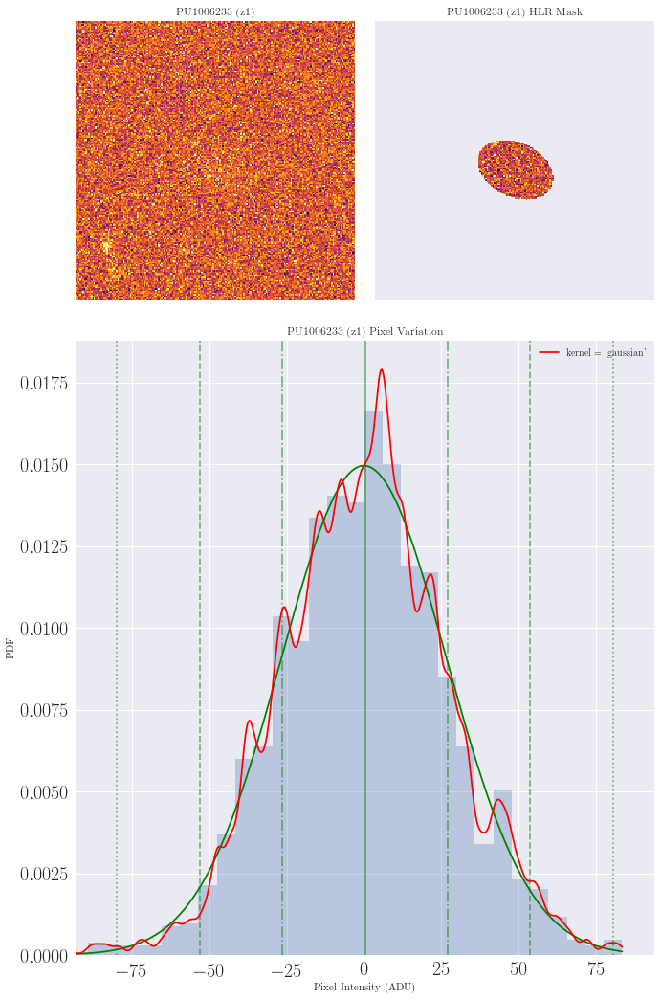

PU1006233 (z1) 
	Background Mean:   2687.441 ADU 
	Background StDev:  0.011 ADU 
	Galaxy Mean:       0.346 ADU 
	Galaxy Median:     0.740 ADU 
	Galaxy StDev:      26.675 ADU 
	Recessional Vel:   1202.000 ADU 
	Mean Square Error: 0.099 ADU


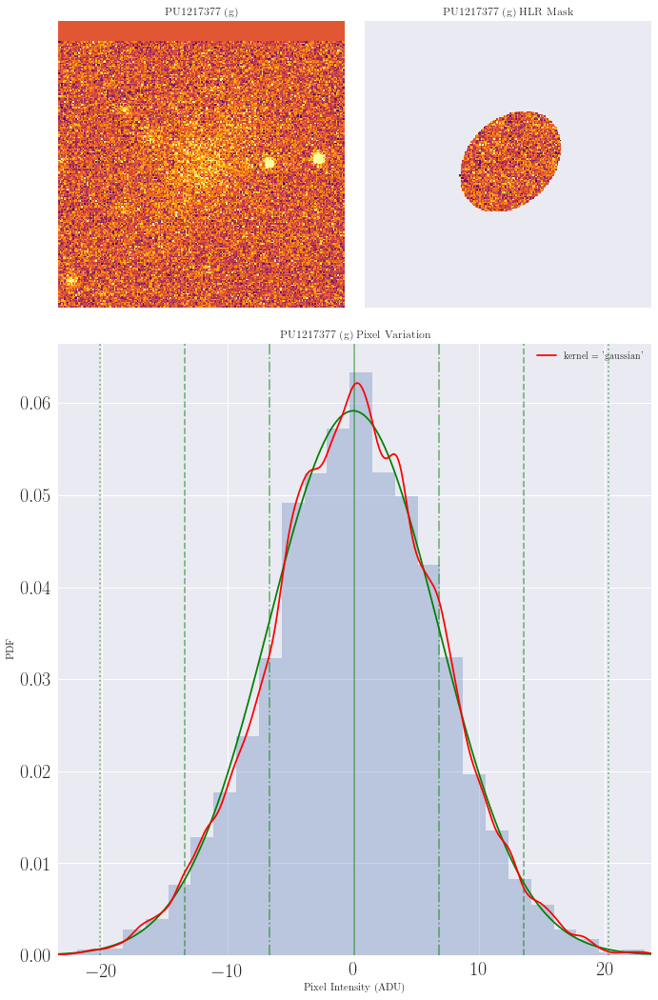

PU1217377 (g) 
	Background Mean:   164.827 ADU 
	Background StDev:  0.093 ADU 
	Galaxy Mean:       0.109 ADU 
	Galaxy Median:     0.134 ADU 
	Galaxy StDev:      6.743 ADU 
	Recessional Vel:   526.000 ADU 
	Mean Square Error: 3.252 ADU


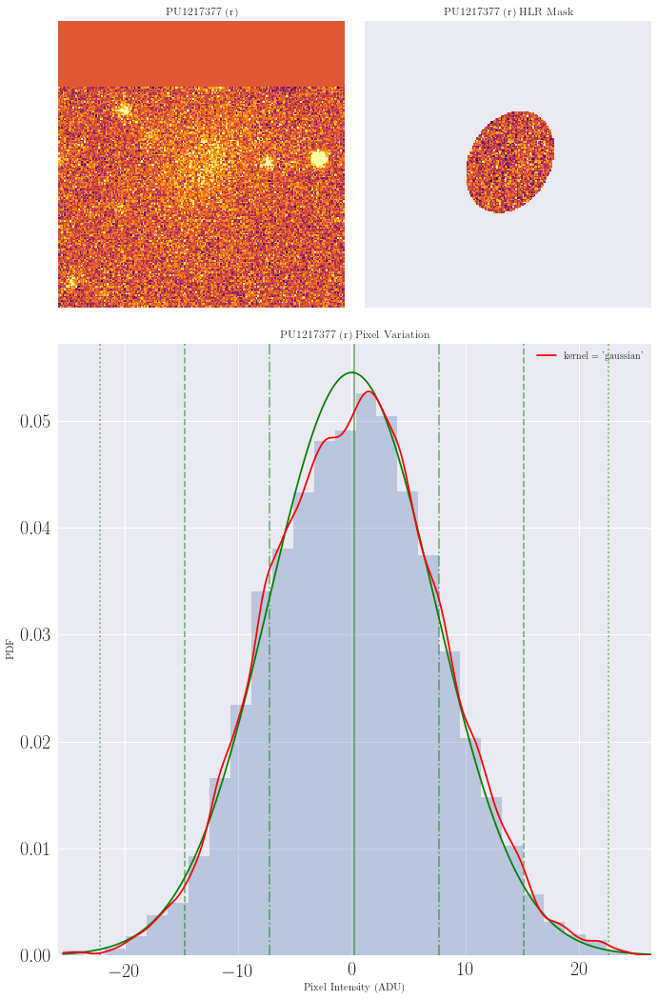

PU1217377 (r) 
	Background Mean:   201.131 ADU 
	Background StDev:  0.068 ADU 
	Galaxy Mean:       0.248 ADU 
	Galaxy Median:     0.320 ADU 
	Galaxy StDev:      7.320 ADU 
	Recessional Vel:   526.000 ADU 
	Mean Square Error: 2.402 ADU


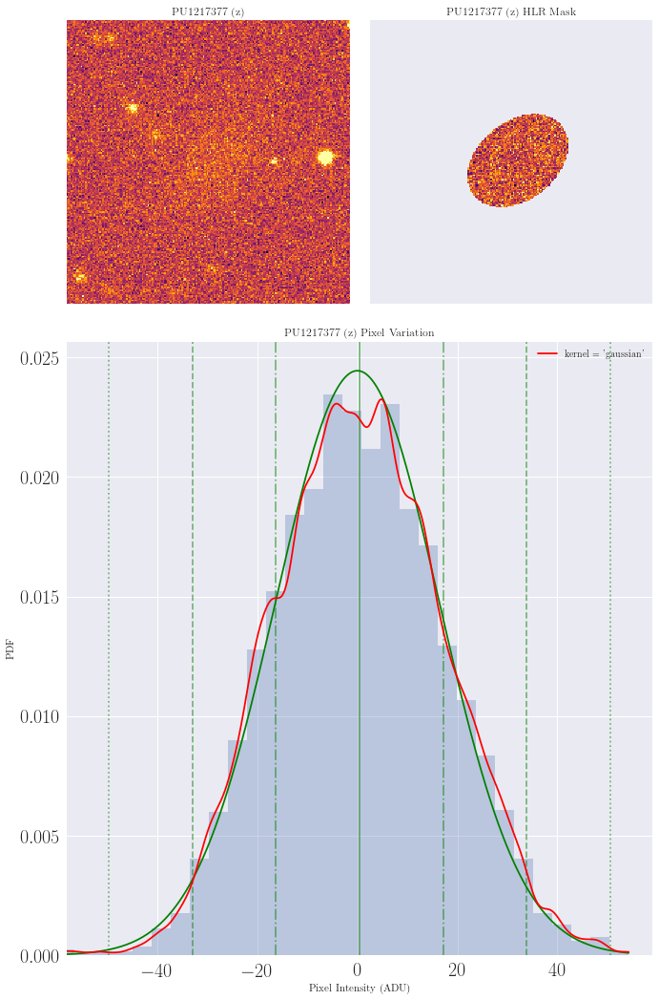

PU1217377 (z) 
	Background Mean:   2829.628 ADU 
	Background StDev:  0.120 ADU 
	Galaxy Mean:       0.420 ADU 
	Galaxy Median:     0.203 ADU 
	Galaxy StDev:      16.321 ADU 
	Recessional Vel:   526.000 ADU 
	Mean Square Error: 0.493 ADU


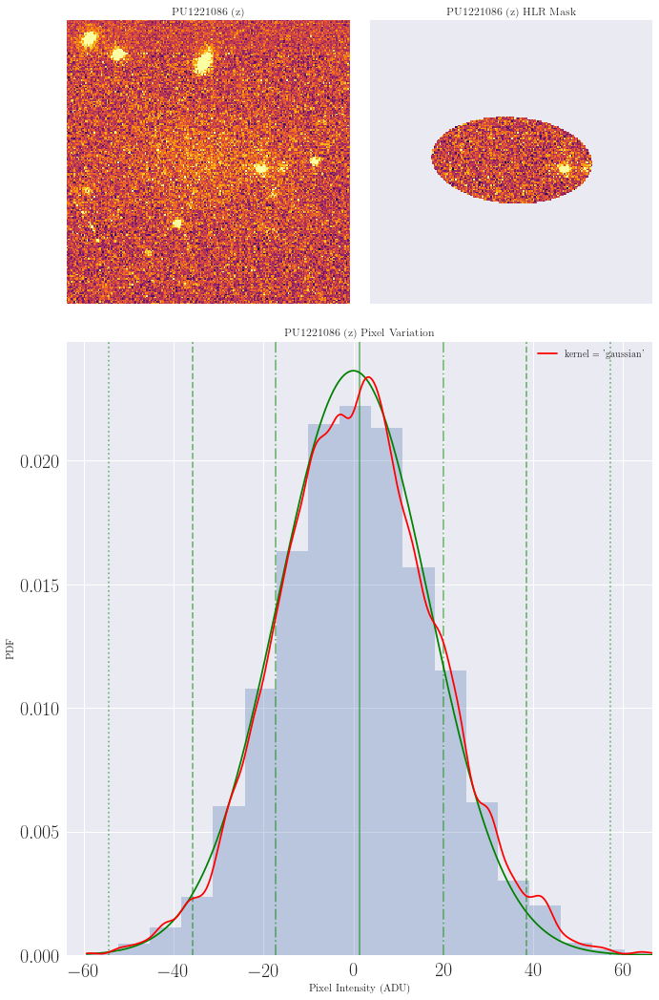

PU1221086 (z) 
	Background Mean:   3459.031 ADU 
	Background StDev:  0.370 ADU 
	Galaxy Mean:       1.358 ADU 
	Galaxy Median:     0.969 ADU 
	Galaxy StDev:      16.877 ADU 
	Recessional Vel:   1287.000 ADU 
	Mean Square Error: 0.594 ADU


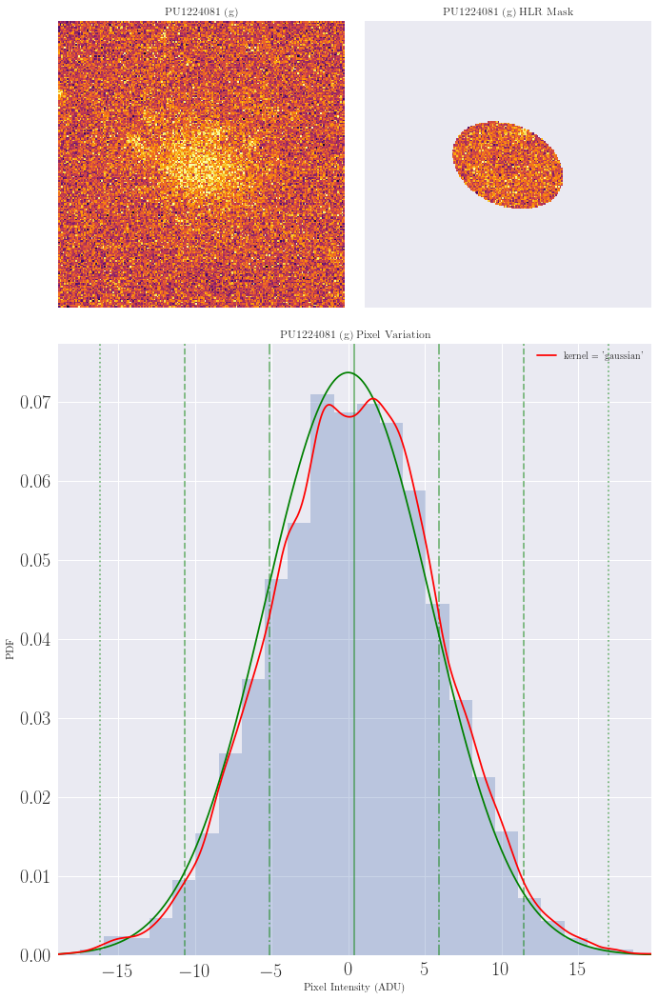

PU1224081 (g) 
	Background Mean:   171.654 ADU 
	Background StDev:  0.099 ADU 
	Galaxy Mean:       0.425 ADU 
	Galaxy Median:     0.482 ADU 
	Galaxy StDev:      5.409 ADU 
	Recessional Vel:   37.000 ADU 
	Mean Square Error: 4.637 ADU


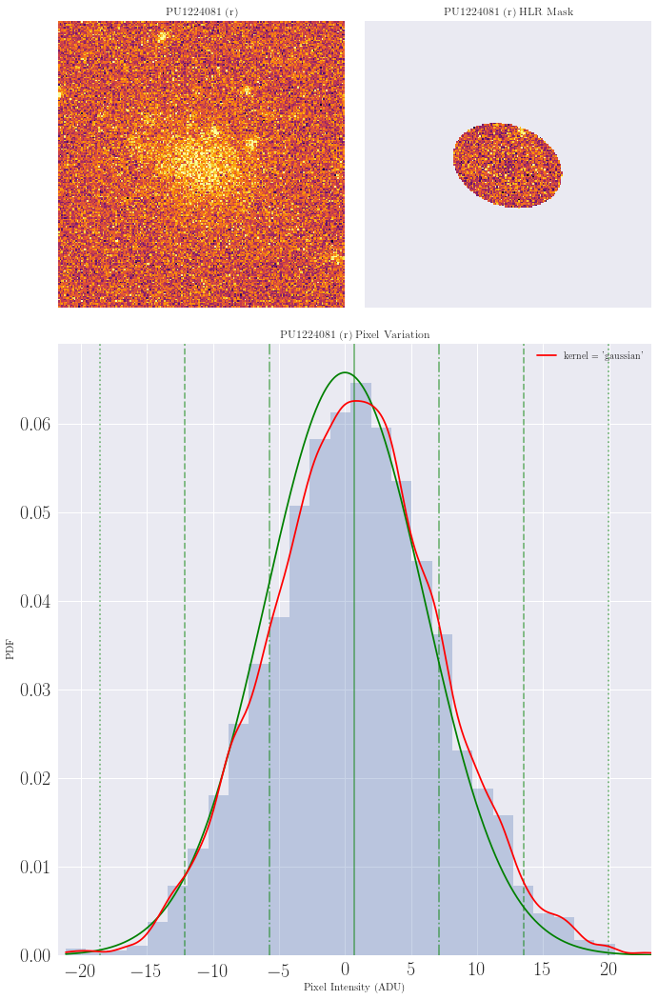

PU1224081 (r) 
	Background Mean:   264.633 ADU 
	Background StDev:  0.100 ADU 
	Galaxy Mean:       0.730 ADU 
	Galaxy Median:     0.681 ADU 
	Galaxy StDev:      6.064 ADU 
	Recessional Vel:   37.000 ADU 
	Mean Square Error: 3.516 ADU


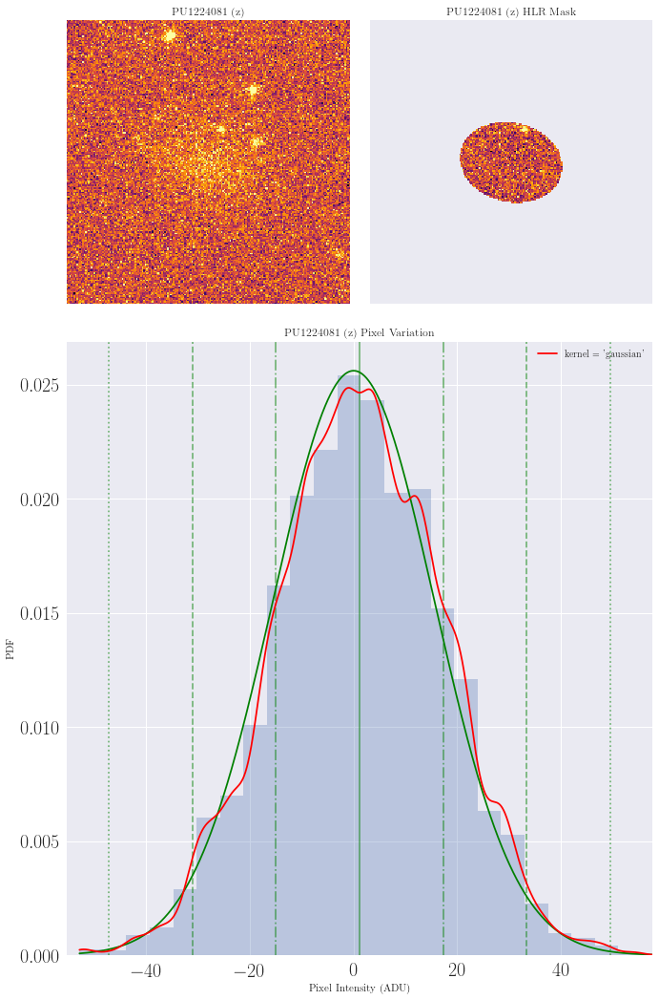

PU1224081 (z) 
	Background Mean:   2697.571 ADU 
	Background StDev:  0.126 ADU 
	Galaxy Mean:       1.133 ADU 
	Galaxy Median:     1.094 ADU 
	Galaxy StDev:      15.582 ADU 
	Recessional Vel:   37.000 ADU 
	Mean Square Error: 0.495 ADU


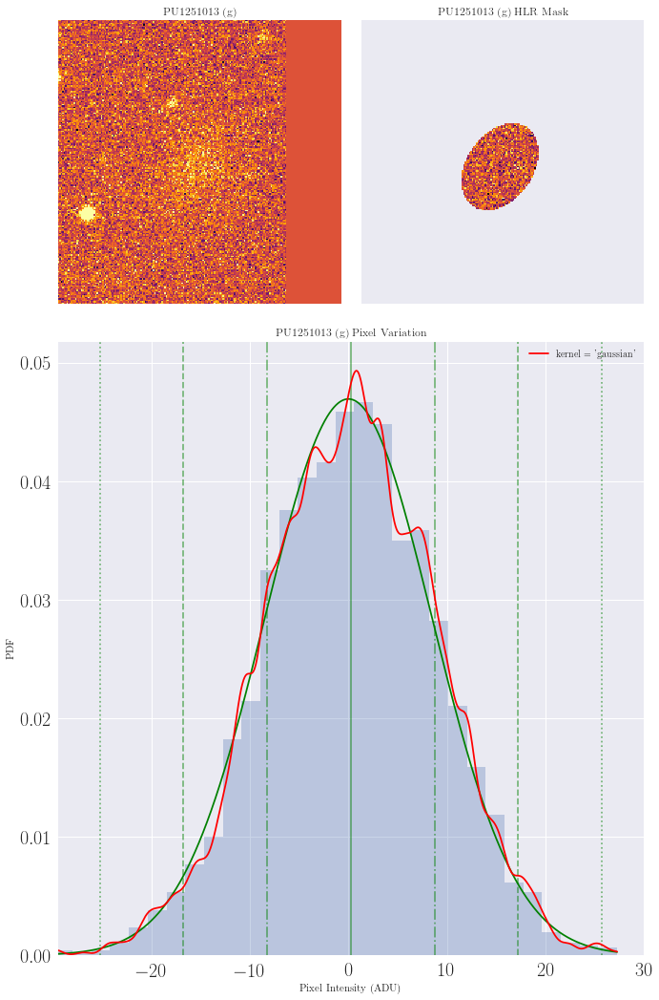

PU1251013 (g) 
	Background Mean:   129.377 ADU 
	Background StDev:  0.027 ADU 
	Galaxy Mean:       0.251 ADU 
	Galaxy Median:     0.343 ADU 
	Galaxy StDev:      8.500 ADU 
	Recessional Vel:   6159.000 ADU 
	Mean Square Error: 1.349 ADU


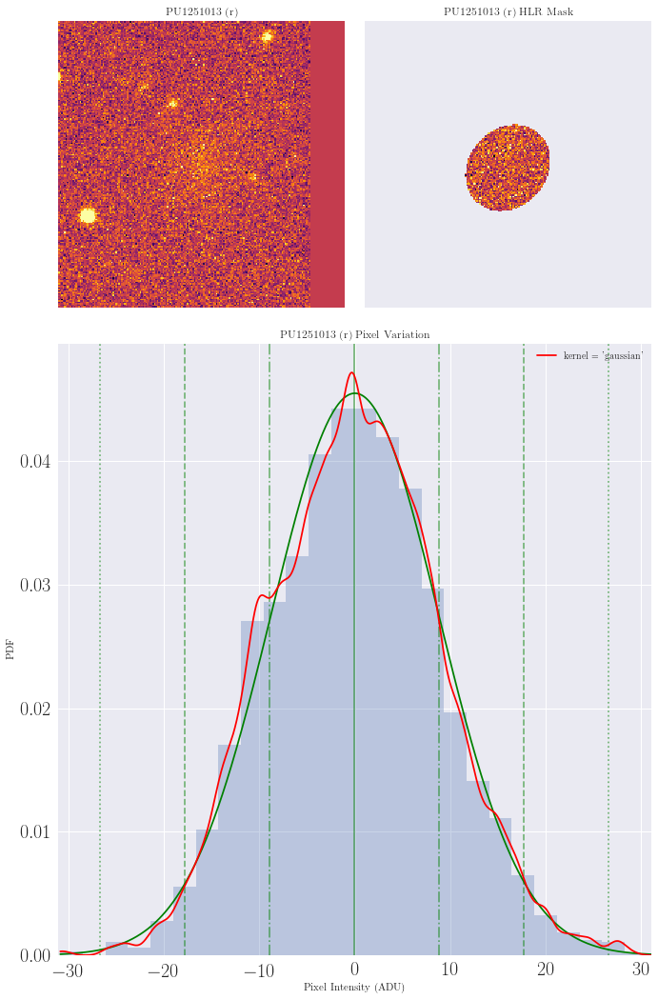

PU1251013 (r) 
	Background Mean:   149.314 ADU 
	Background StDev:  0.033 ADU 
	Galaxy Mean:       -0.029 ADU 
	Galaxy Median:     -0.072 ADU 
	Galaxy StDev:      8.774 ADU 
	Recessional Vel:   6159.000 ADU 
	Mean Square Error: 1.374 ADU


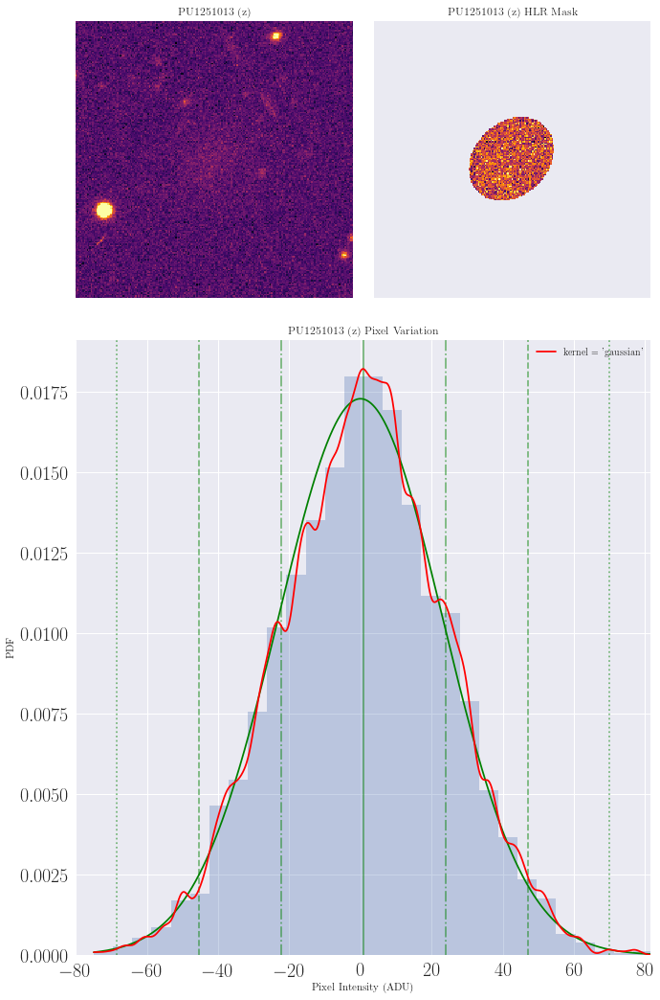

PU1251013 (z) 
	Background Mean:   5666.656 ADU 
	Background StDev:  0.116 ADU 
	Galaxy Mean:       0.773 ADU 
	Galaxy Median:     1.017 ADU 
	Galaxy StDev:      23.071 ADU 
	Recessional Vel:   6159.000 ADU 
	Mean Square Error: 0.210 ADU


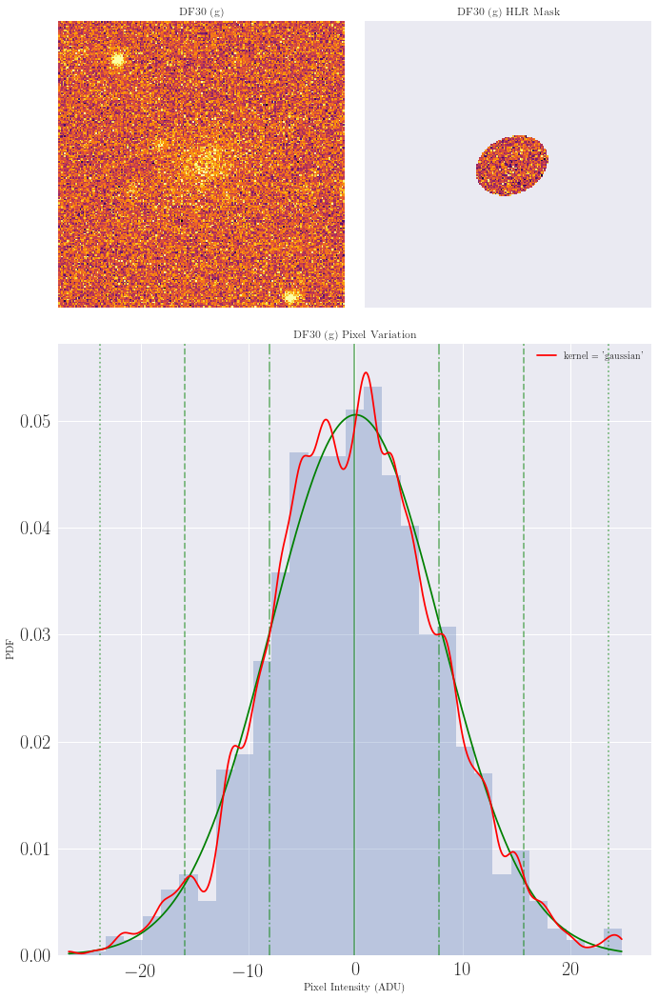

DF30 (g) 
	Background Mean:   220.425 ADU 
	Background StDev:  0.008 ADU 
	Galaxy Mean:       -0.091 ADU 
	Galaxy Median:     -0.091 ADU 
	Galaxy StDev:      7.891 ADU 
	Recessional Vel:   7316.000 ADU 
	Mean Square Error: 1.038 ADU


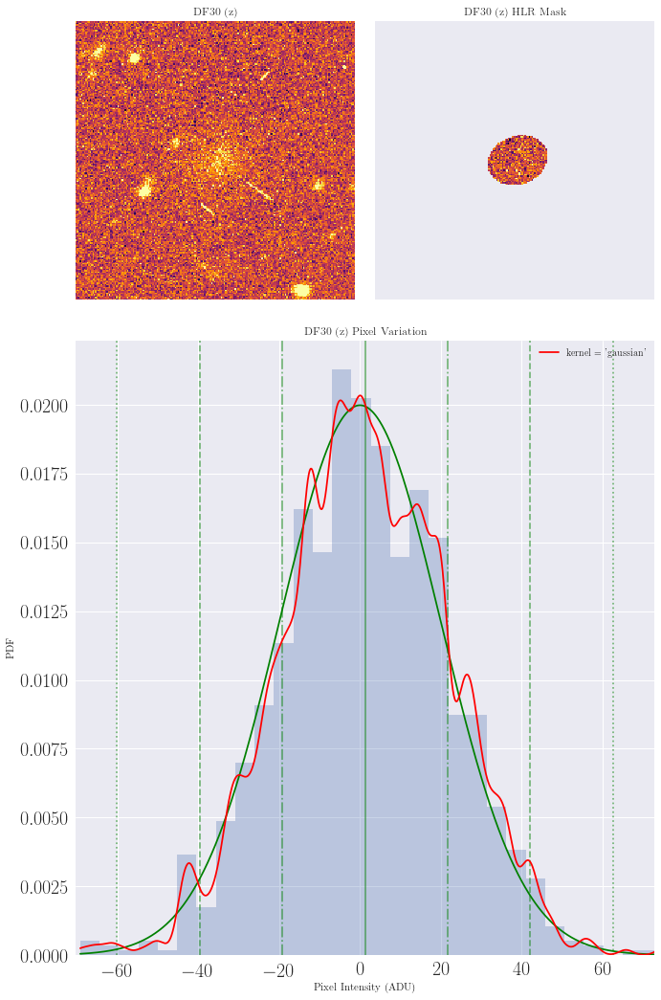

DF30 (z) 
	Background Mean:   5044.535 ADU 
	Background StDev:  0.007 ADU 
	Galaxy Mean:       1.219 ADU 
	Galaxy Median:     0.974 ADU 
	Galaxy StDev:      19.962 ADU 
	Recessional Vel:   7316.000 ADU 
	Mean Square Error: 0.117 ADU


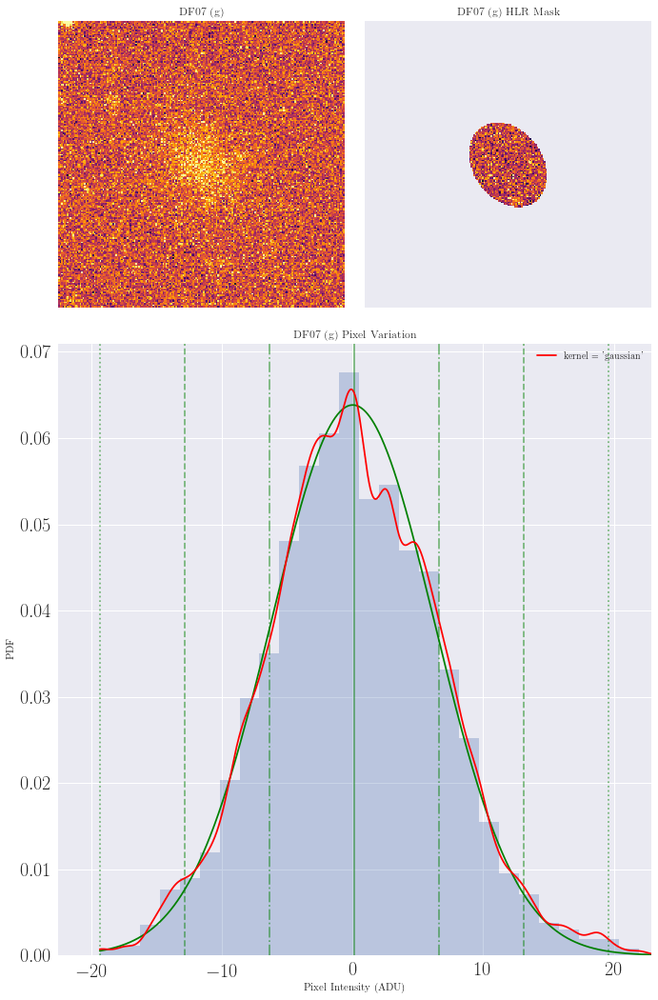

DF07 (g) 
	Background Mean:   144.948 ADU 
	Background StDev:  0.029 ADU 
	Galaxy Mean:       0.141 ADU 
	Galaxy Median:     -0.088 ADU 
	Galaxy StDev:      6.249 ADU 
	Recessional Vel:   6587.000 ADU 
	Mean Square Error: 2.376 ADU


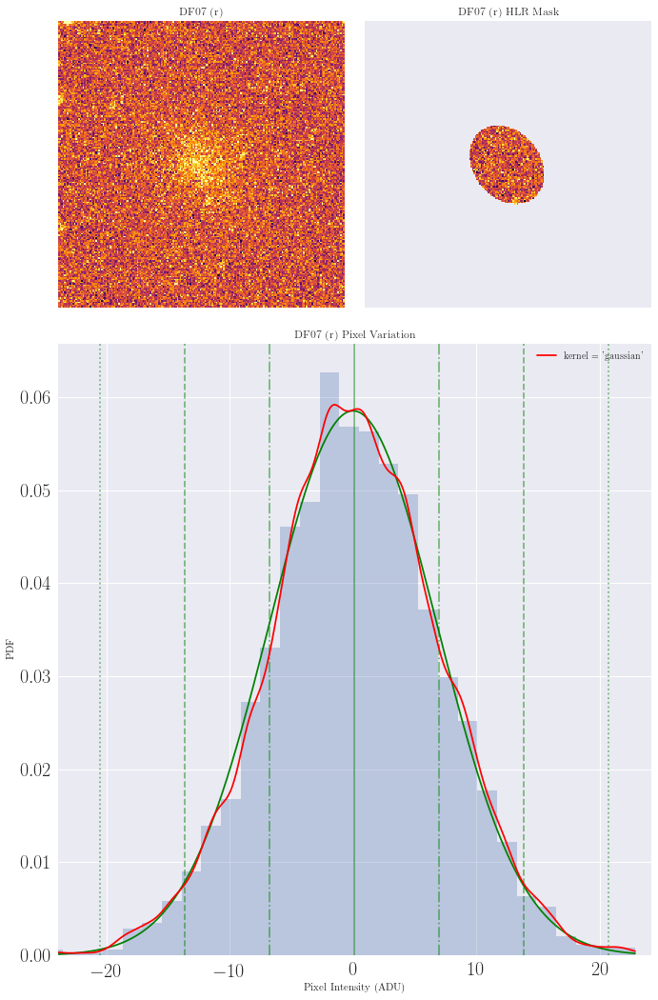

DF07 (r) 
	Background Mean:   168.509 ADU 
	Background StDev:  0.022 ADU 
	Galaxy Mean:       0.125 ADU 
	Galaxy Median:     0.071 ADU 
	Galaxy StDev:      6.814 ADU 
	Recessional Vel:   6587.000 ADU 
	Mean Square Error: 1.841 ADU


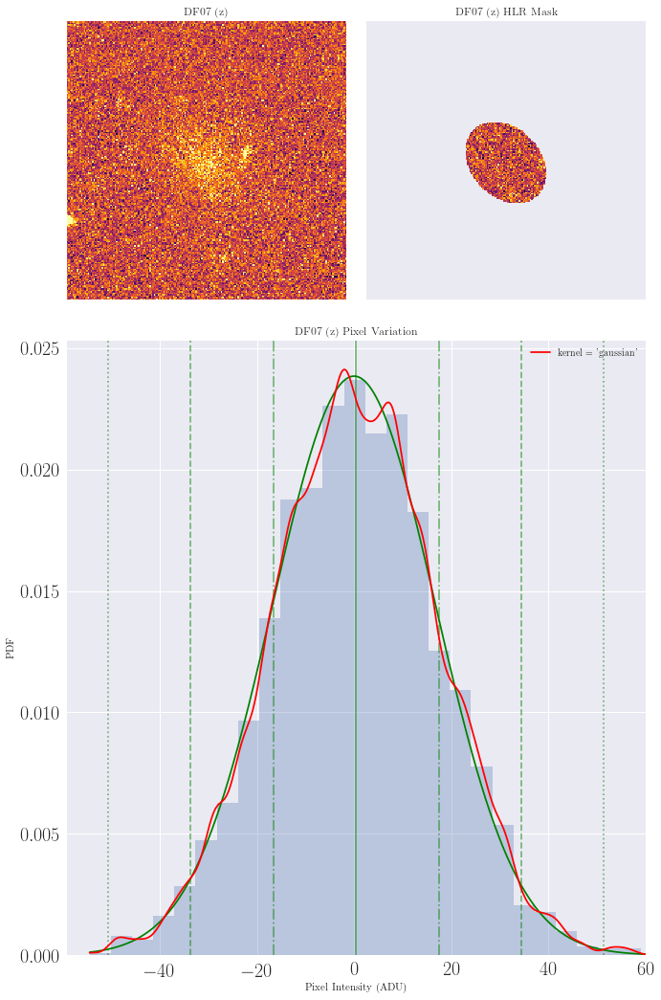

DF07 (z) 
	Background Mean:   3436.929 ADU 
	Background StDev:  0.084 ADU 
	Galaxy Mean:       0.414 ADU 
	Galaxy Median:     0.189 ADU 
	Galaxy StDev:      16.728 ADU 
	Recessional Vel:   6587.000 ADU 
	Mean Square Error: 0.356 ADU


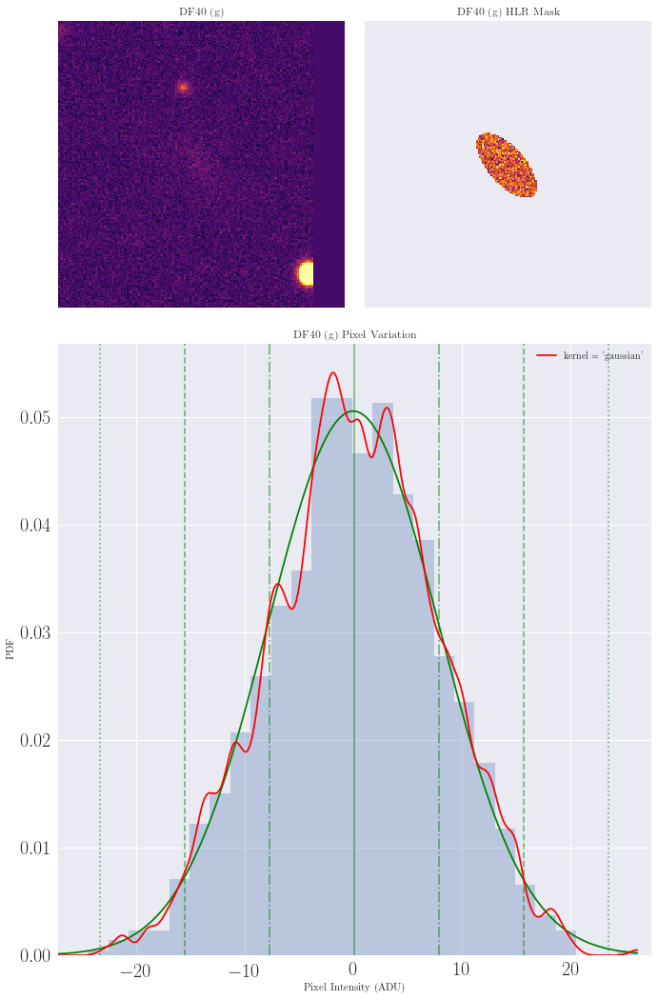

DF40 (g) 
	Background Mean:   219.770 ADU 
	Background StDev:  0.002 ADU 
	Galaxy Mean:       0.123 ADU 
	Galaxy Median:     0.185 ADU 
	Galaxy StDev:      7.885 ADU 
	Recessional Vel:   7792.000 ADU 
	Mean Square Error: 0.731 ADU


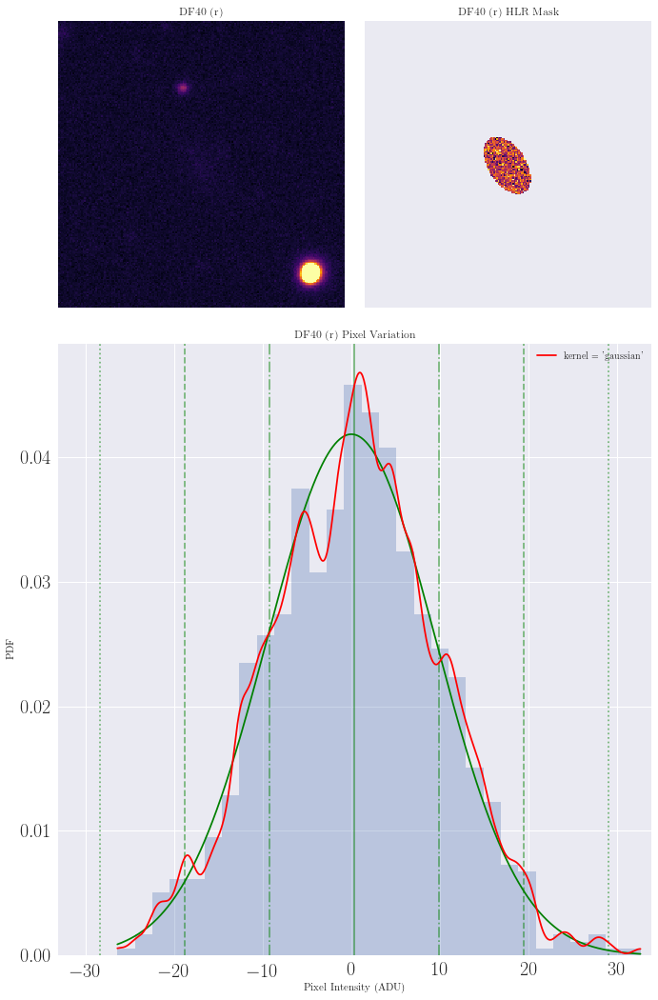

DF40 (r) 
	Background Mean:   497.810 ADU 
	Background StDev:  0.001 ADU 
	Galaxy Mean:       0.368 ADU 
	Galaxy Median:     0.541 ADU 
	Galaxy StDev:      9.531 ADU 
	Recessional Vel:   7792.000 ADU 
	Mean Square Error: 0.388 ADU


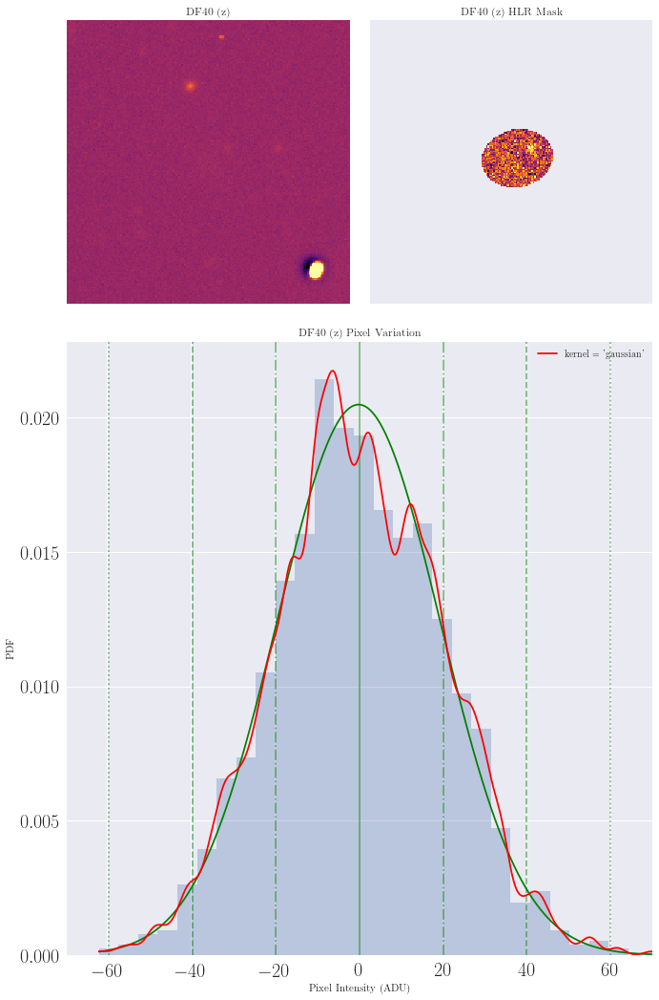

DF40 (z) 
	Background Mean:   4118.306 ADU 
	Background StDev:  0.010 ADU 
	Galaxy Mean:       0.217 ADU 
	Galaxy Median:     -0.504 ADU 
	Galaxy StDev:      19.473 ADU 
	Recessional Vel:   7792.000 ADU 
	Mean Square Error: 0.166 ADU


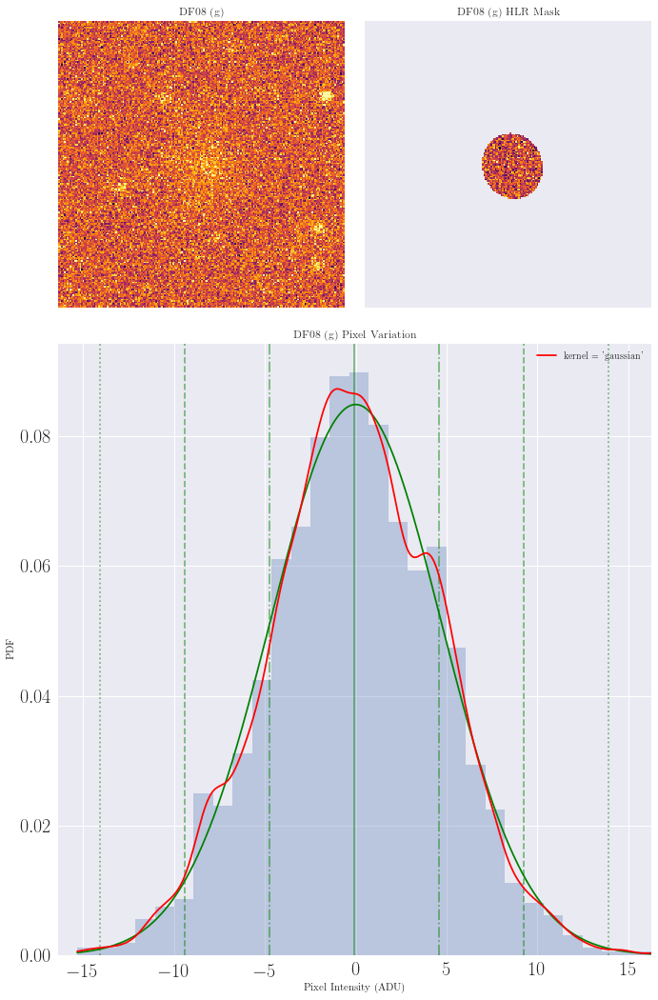

DF08 (g) 
	Background Mean:   163.990 ADU 
	Background StDev:  0.003 ADU 
	Galaxy Mean:       -0.058 ADU 
	Galaxy Median:     -0.070 ADU 
	Galaxy StDev:      4.700 ADU 
	Recessional Vel:   7051.000 ADU 
	Mean Square Error: 2.711 ADU


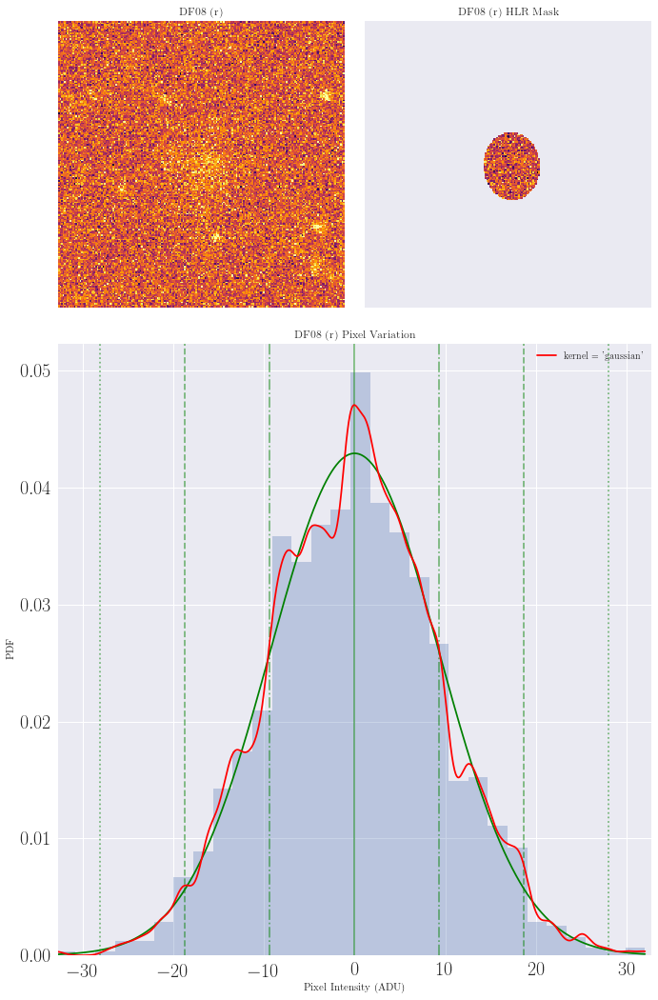

DF08 (r) 
	Background Mean:   504.347 ADU 
	Background StDev:  0.005 ADU 
	Galaxy Mean:       0.001 ADU 
	Galaxy Median:     -0.032 ADU 
	Galaxy StDev:      9.294 ADU 
	Recessional Vel:   7051.000 ADU 
	Mean Square Error: 0.669 ADU


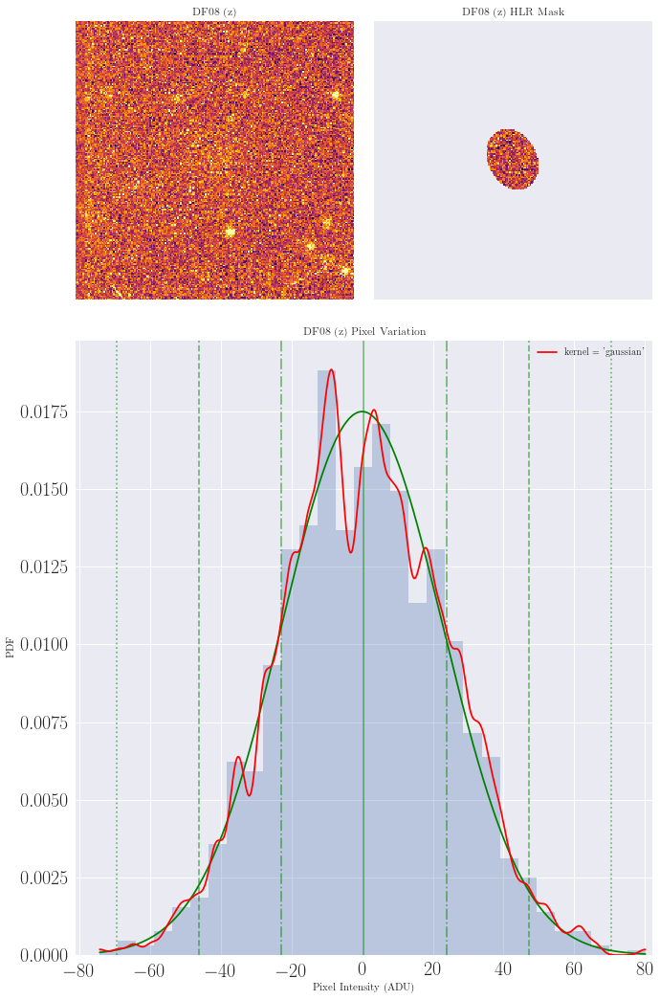

DF08 (z) 
	Background Mean:   5020.734 ADU 
	Background StDev:  0.003 ADU 
	Galaxy Mean:       0.508 ADU 
	Galaxy Median:     0.364 ADU 
	Galaxy StDev:      22.803 ADU 
	Recessional Vel:   7051.000 ADU 
	Mean Square Error: 0.093 ADU


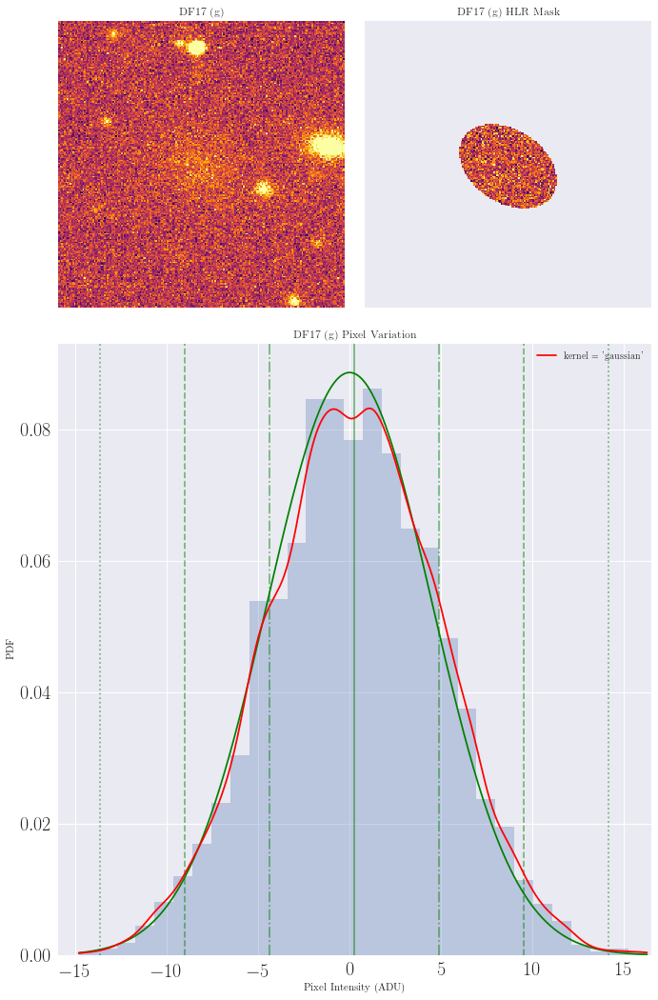

DF17 (g) 
	Background Mean:   163.954 ADU 
	Background StDev:  0.028 ADU 
	Galaxy Mean:       0.272 ADU 
	Galaxy Median:     0.310 ADU 
	Galaxy StDev:      4.495 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 5.549 ADU


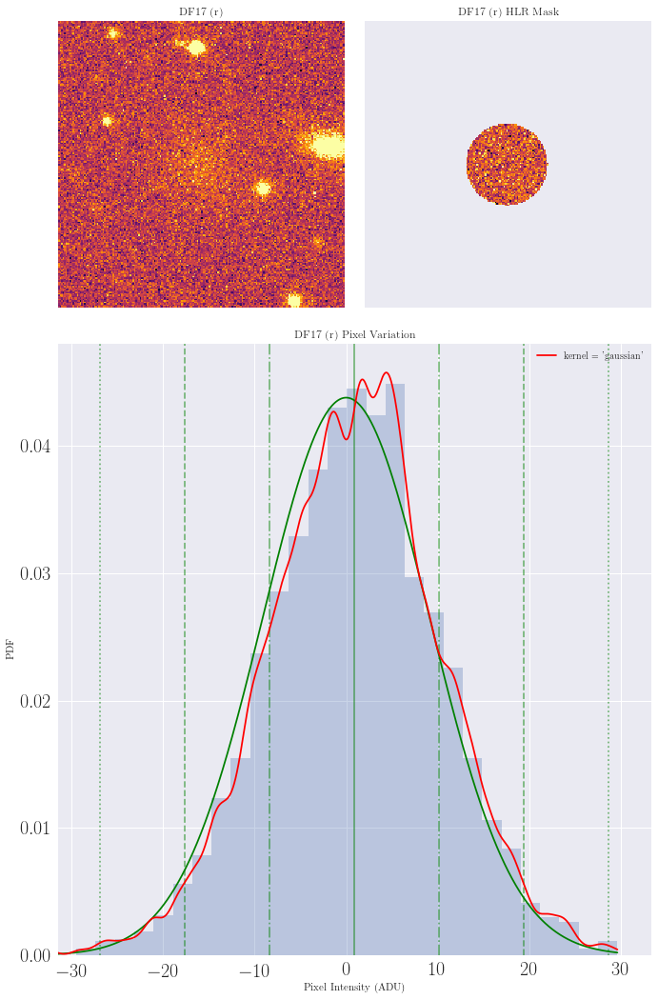

DF17 (r) 
	Background Mean:   504.189 ADU 
	Background StDev:  0.031 ADU 
	Galaxy Mean:       0.924 ADU 
	Galaxy Median:     1.207 ADU 
	Galaxy StDev:      9.111 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 1.211 ADU


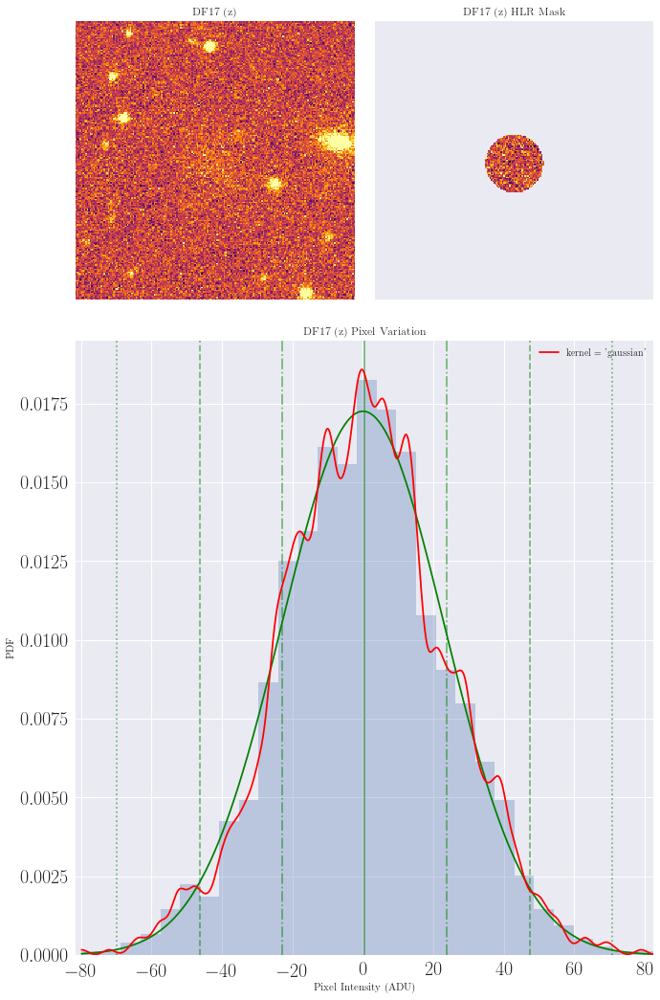

DF17 (z) 
	Background Mean:   5018.648 ADU 
	Background StDev:  0.007 ADU 
	Galaxy Mean:       0.463 ADU 
	Galaxy Median:     0.435 ADU 
	Galaxy StDev:      23.118 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 0.101 ADU


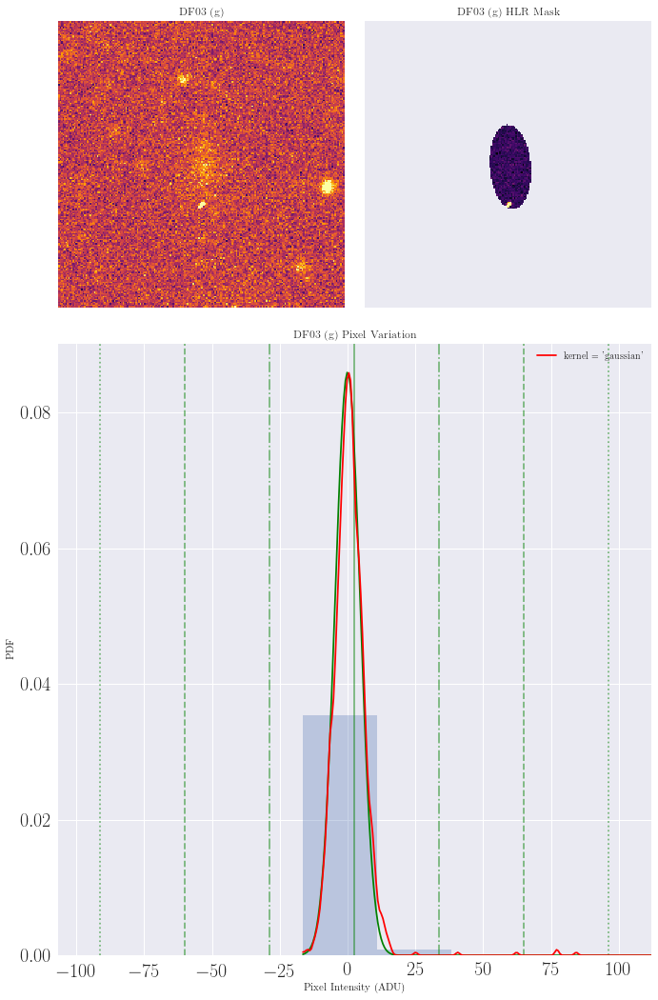

DF03 (g) 
	Background Mean:   164.189 ADU 
	Background StDev:  0.001 ADU 
	Galaxy Mean:       2.583 ADU 
	Galaxy Median:     0.540 ADU 
	Galaxy StDev:      4.642 ADU 
	Recessional Vel:   10150.000 ADU 
	Mean Square Error: 0.183 ADU


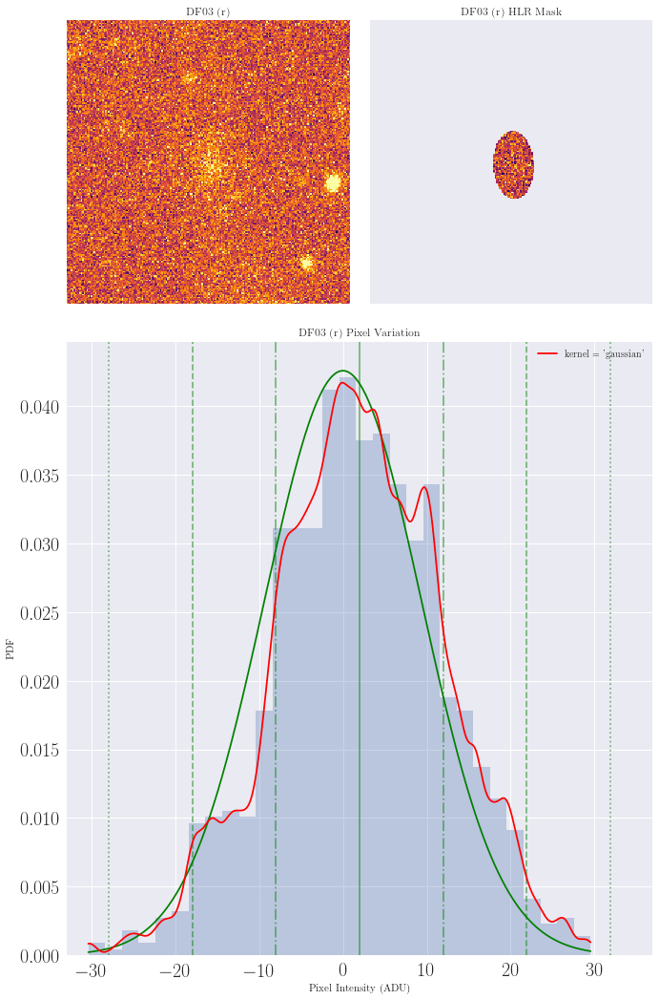

DF03 (r) 
	Background Mean:   504.322 ADU 
	Background StDev:  0.001 ADU 
	Galaxy Mean:       1.974 ADU 
	Galaxy Median:     1.948 ADU 
	Galaxy StDev:      9.365 ADU 
	Recessional Vel:   10150.000 ADU 
	Mean Square Error: 0.462 ADU


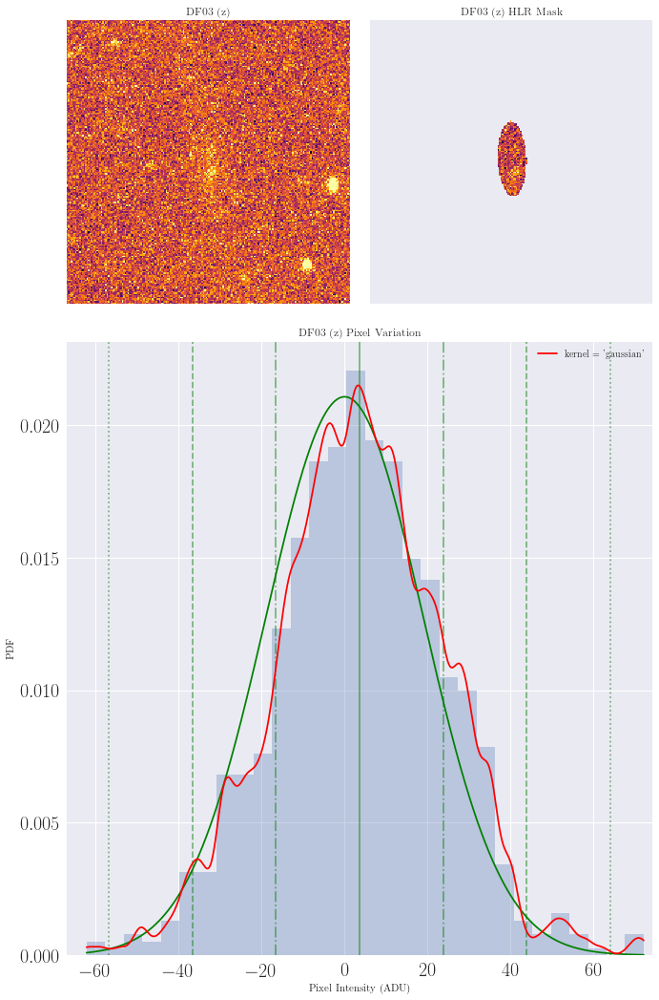

DF03 (z) 
	Background Mean:   4755.168 ADU 
	Background StDev:  0.000 ADU 
	Galaxy Mean:       3.594 ADU 
	Galaxy Median:     3.573 ADU 
	Galaxy StDev:      18.928 ADU 
	Recessional Vel:   10150.000 ADU 
	Mean Square Error: 0.091 ADU


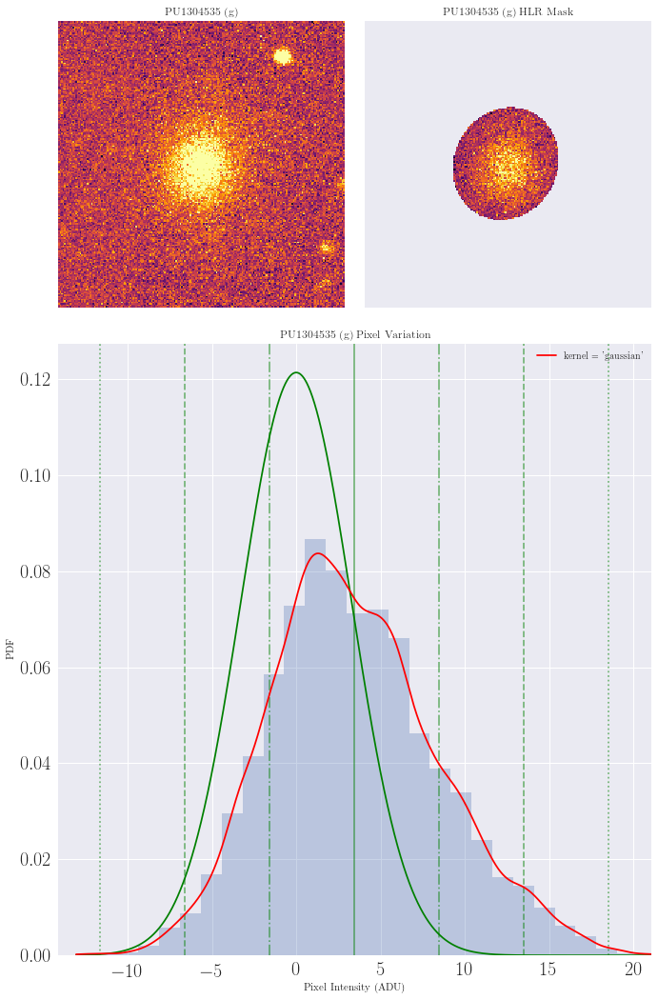

PU1304535 (g) 
	Background Mean:   183.055 ADU 
	Background StDev:  0.156 ADU 
	Galaxy Mean:       3.465 ADU 
	Galaxy Median:     3.015 ADU 
	Galaxy StDev:      3.287 ADU 
	Recessional Vel:   7333.000 ADU 
	Mean Square Error: 10.812 ADU


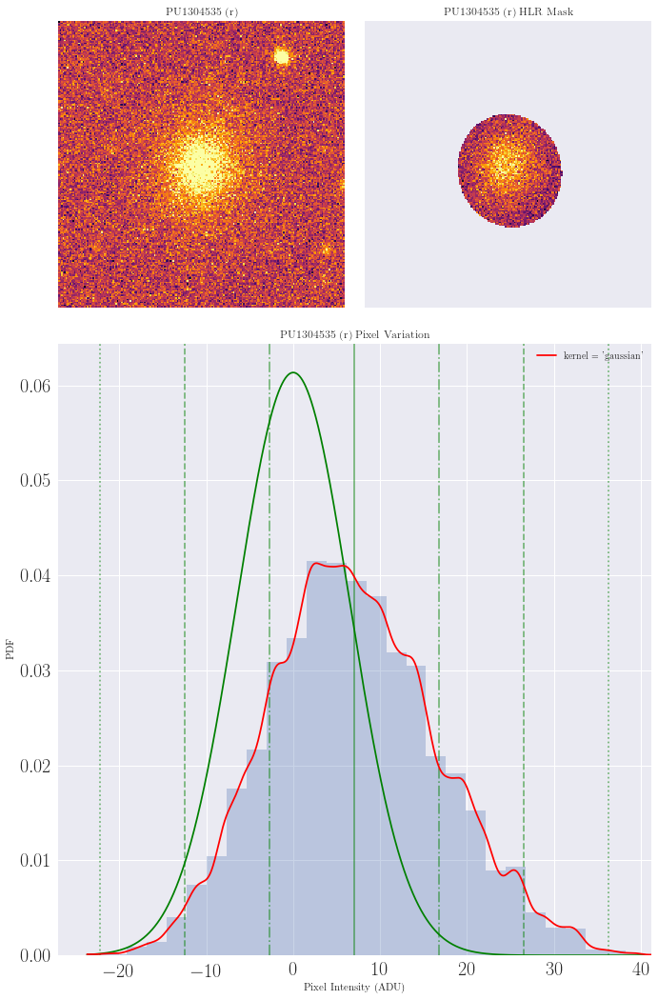

PU1304535 (r) 
	Background Mean:   551.694 ADU 
	Background StDev:  0.233 ADU 
	Galaxy Mean:       7.062 ADU 
	Galaxy Median:     6.494 ADU 
	Galaxy StDev:      6.502 ADU 
	Recessional Vel:   7333.000 ADU 
	Mean Square Error: 2.822 ADU


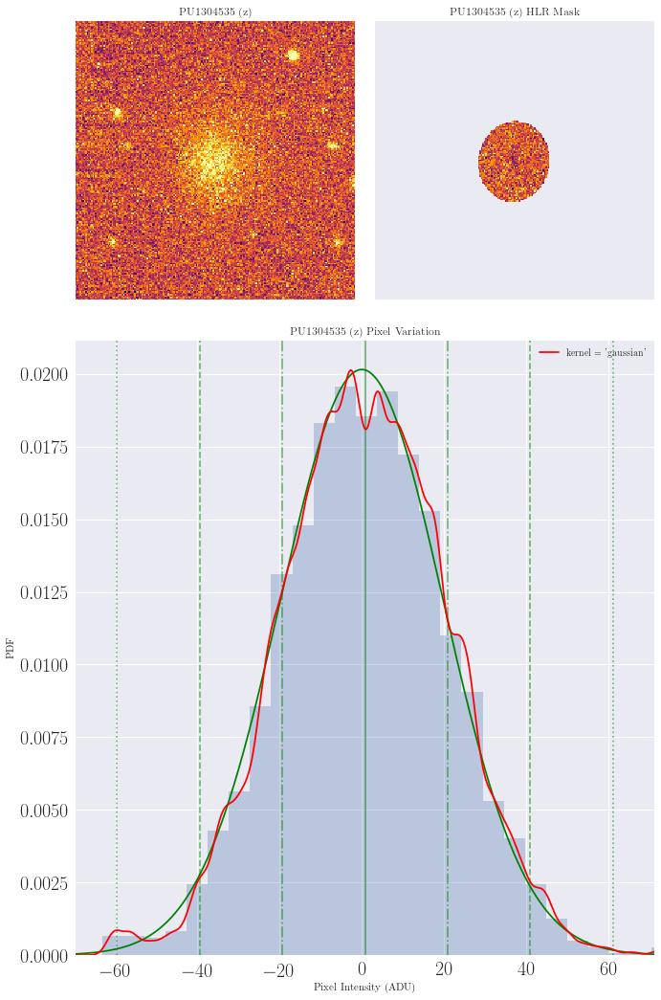

PU1304535 (z) 
	Background Mean:   4608.827 ADU 
	Background StDev:  0.122 ADU 
	Galaxy Mean:       0.772 ADU 
	Galaxy Median:     0.538 ADU 
	Galaxy StDev:      19.796 ADU 
	Recessional Vel:   7333.000 ADU 
	Mean Square Error: 0.231 ADU


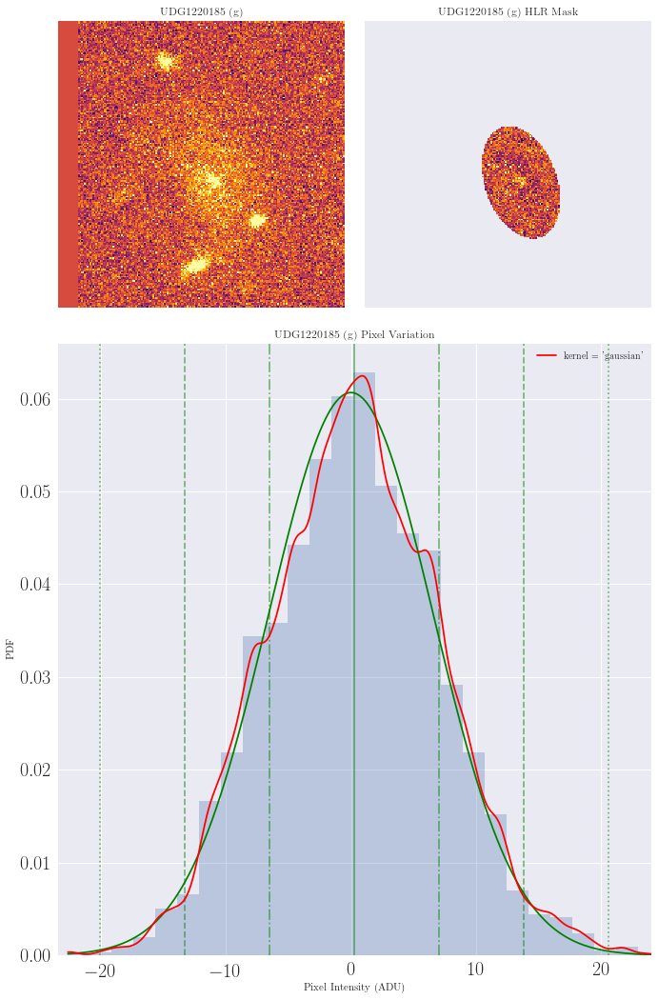

UDG1220185 (g) 
	Background Mean:   163.880 ADU 
	Background StDev:  0.072 ADU 
	Galaxy Mean:       0.293 ADU 
	Galaxy Median:     0.256 ADU 
	Galaxy StDev:      6.577 ADU 
	Recessional Vel:   2282.000 ADU 
	Mean Square Error: 2.816 ADU


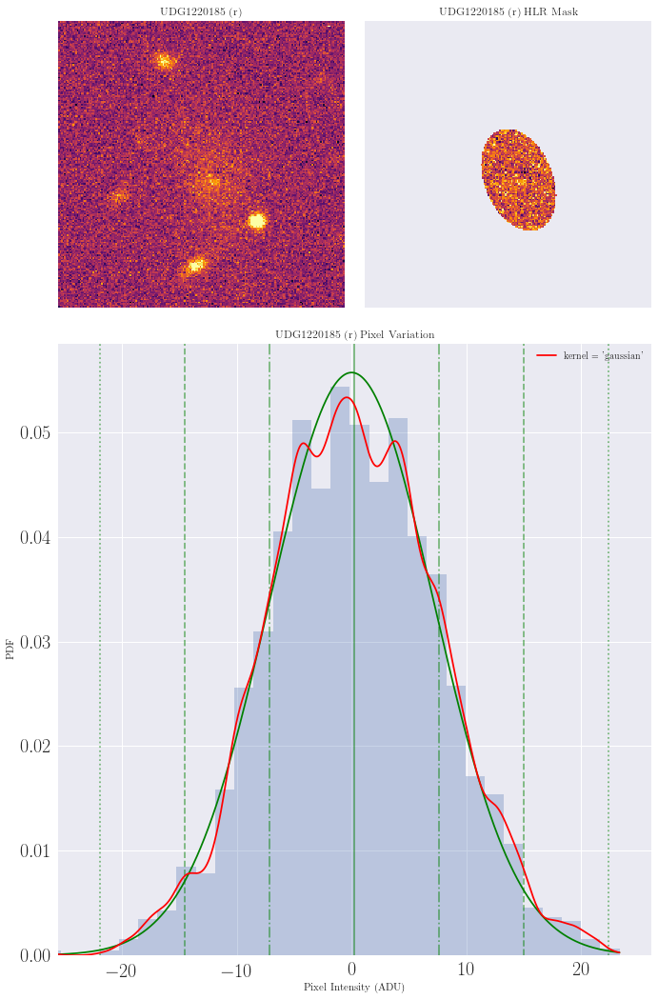

UDG1220185 (r) 
	Background Mean:   200.480 ADU 
	Background StDev:  0.045 ADU 
	Galaxy Mean:       0.261 ADU 
	Galaxy Median:     0.127 ADU 
	Galaxy StDev:      7.161 ADU 
	Recessional Vel:   2282.000 ADU 
	Mean Square Error: 2.055 ADU


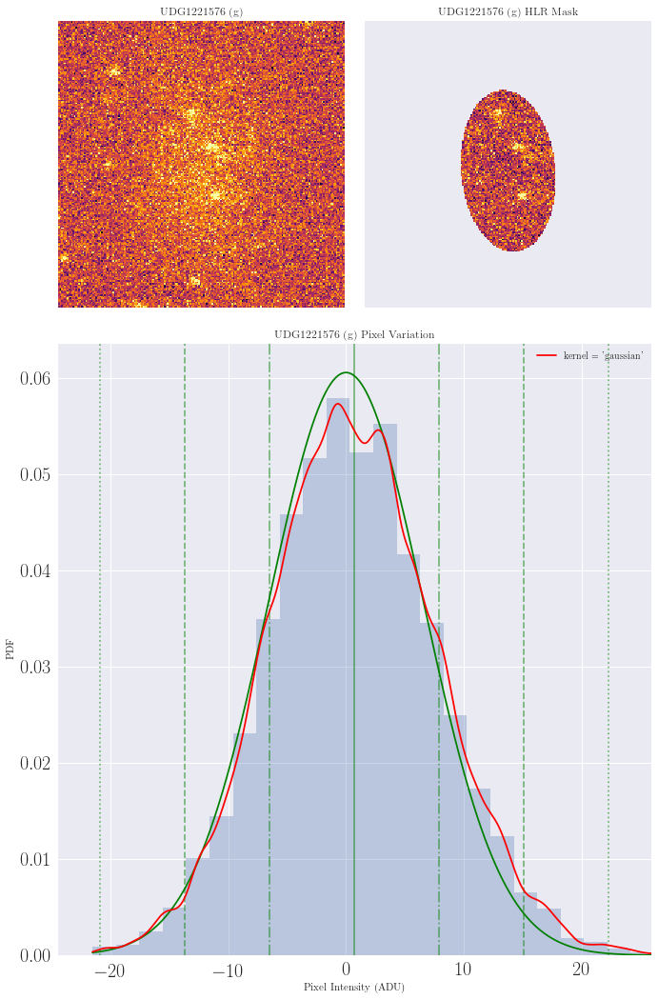

UDG1221576 (g) 
	Background Mean:   164.809 ADU 
	Background StDev:  0.287 ADU 
	Galaxy Mean:       0.729 ADU 
	Galaxy Median:     0.500 ADU 
	Galaxy StDev:      6.581 ADU 
	Recessional Vel:   450.000 ADU 
	Mean Square Error: 4.801 ADU


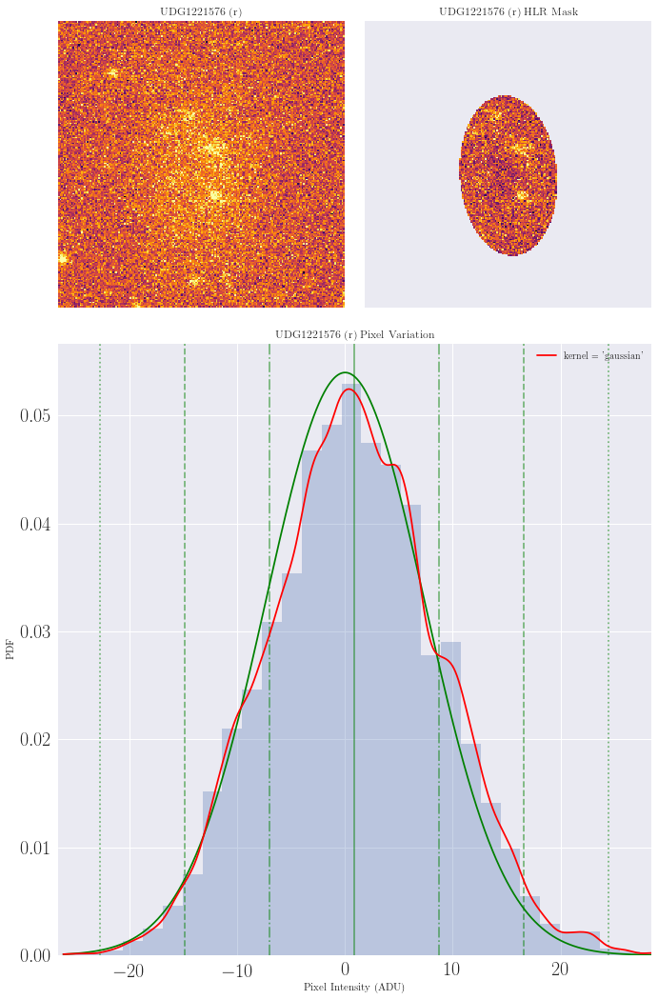

UDG1221576 (r) 
	Background Mean:   201.347 ADU 
	Background StDev:  0.341 ADU 
	Galaxy Mean:       0.880 ADU 
	Galaxy Median:     0.762 ADU 
	Galaxy StDev:      7.389 ADU 
	Recessional Vel:   450.000 ADU 
	Mean Square Error: 4.060 ADU


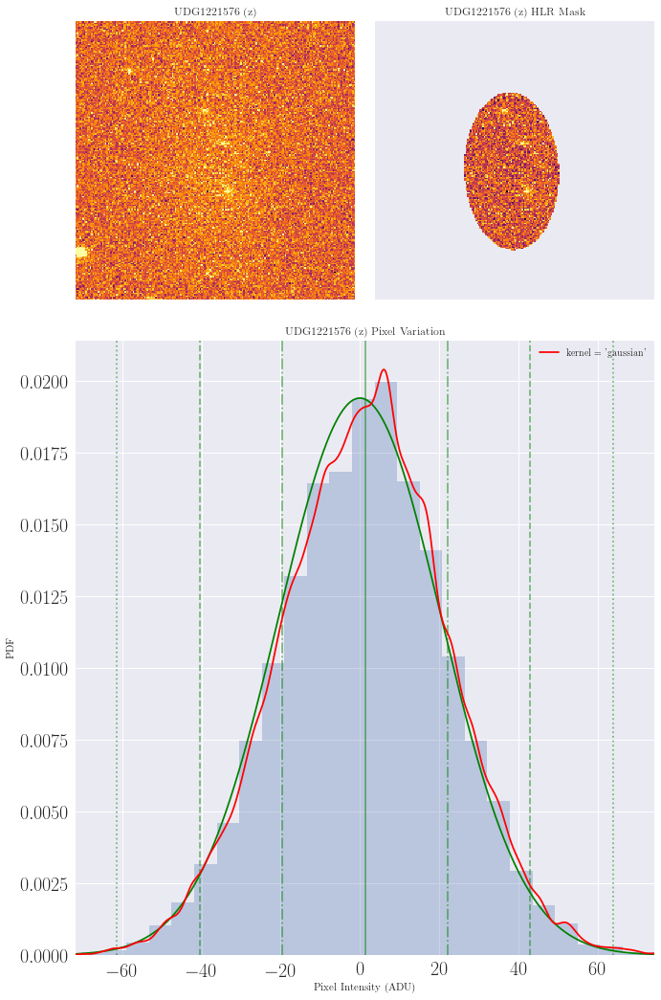

UDG1221576 (z) 
	Background Mean:   3036.323 ADU 
	Background StDev:  0.532 ADU 
	Galaxy Mean:       1.280 ADU 
	Galaxy Median:     1.569 ADU 
	Galaxy StDev:      20.548 ADU 
	Recessional Vel:   450.000 ADU 
	Mean Square Error: 0.548 ADU


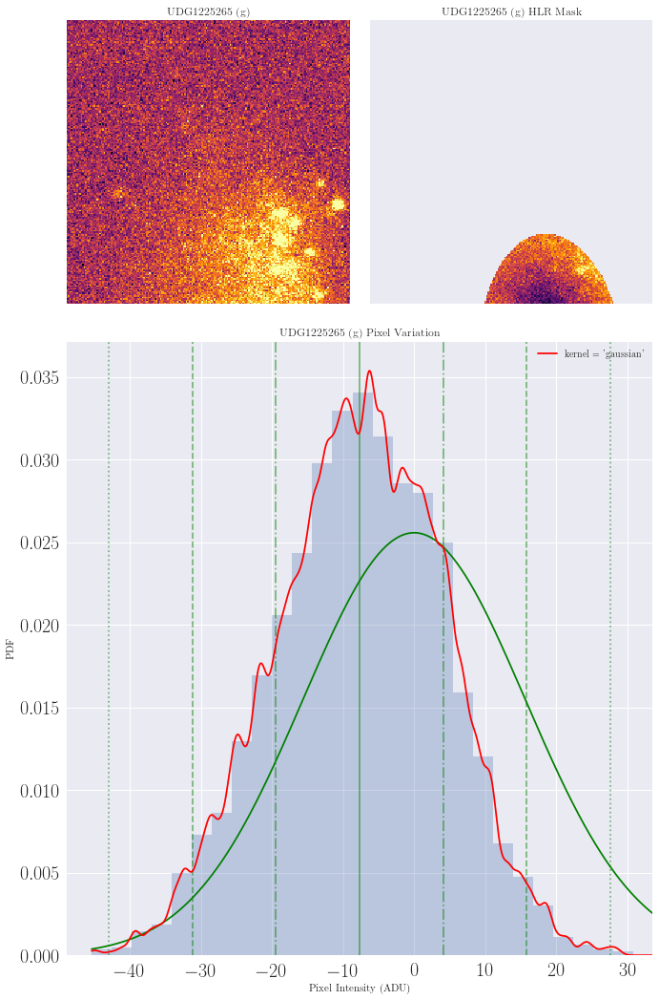

UDG1225265 (g) 
	Background Mean:   139.910 ADU 
	Background StDev:  0.214 ADU 
	Galaxy Mean:       -7.685 ADU 
	Galaxy Median:     -7.346 ADU 
	Galaxy StDev:      15.604 ADU 
	Recessional Vel:   483.000 ADU 
	Mean Square Error: 0.698 ADU


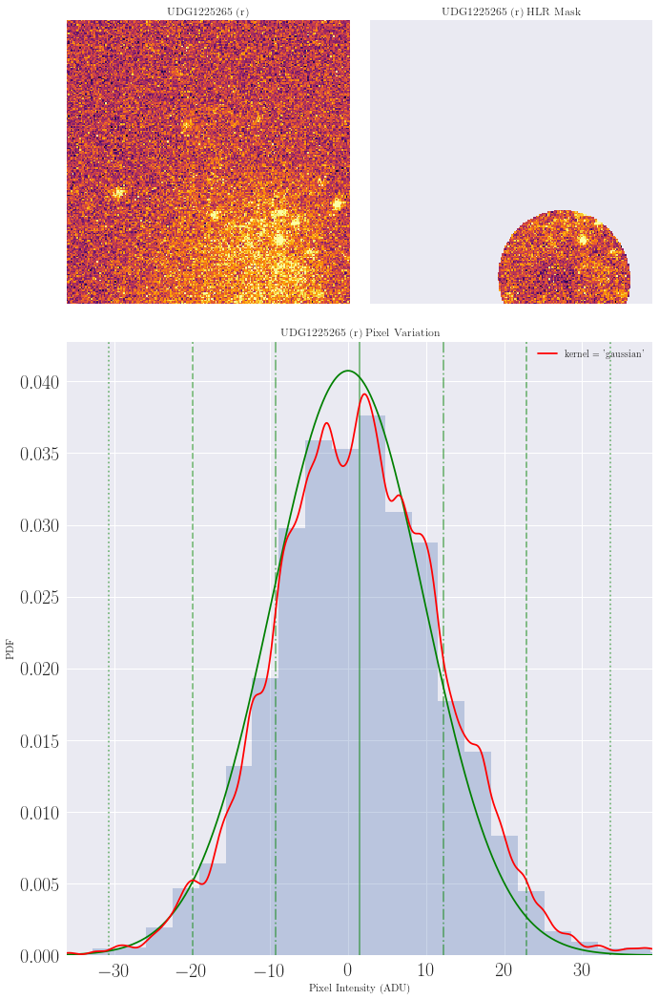

UDG1225265 (r) 
	Background Mean:   309.684 ADU 
	Background StDev:  0.497 ADU 
	Galaxy Mean:       1.466 ADU 
	Galaxy Median:     1.285 ADU 
	Galaxy StDev:      9.791 ADU 
	Recessional Vel:   483.000 ADU 
	Mean Square Error: 1.814 ADU


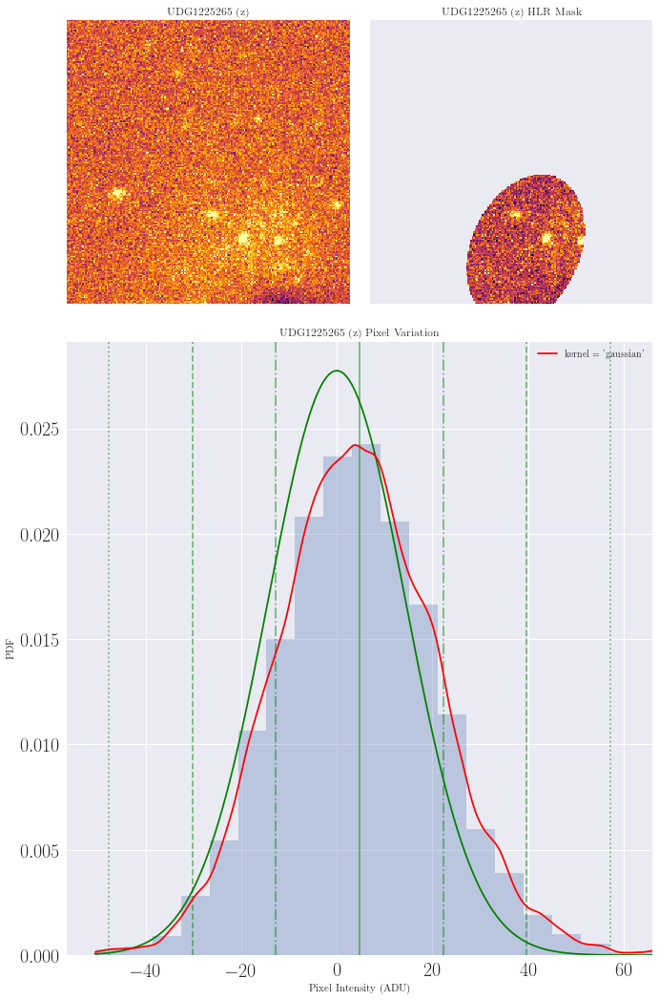

UDG1225265 (z) 
	Background Mean:   2570.427 ADU 
	Background StDev:  0.518 ADU 
	Galaxy Mean:       4.753 ADU 
	Galaxy Median:     4.088 ADU 
	Galaxy StDev:      14.384 ADU 
	Recessional Vel:   483.000 ADU 
	Mean Square Error: 0.866 ADU


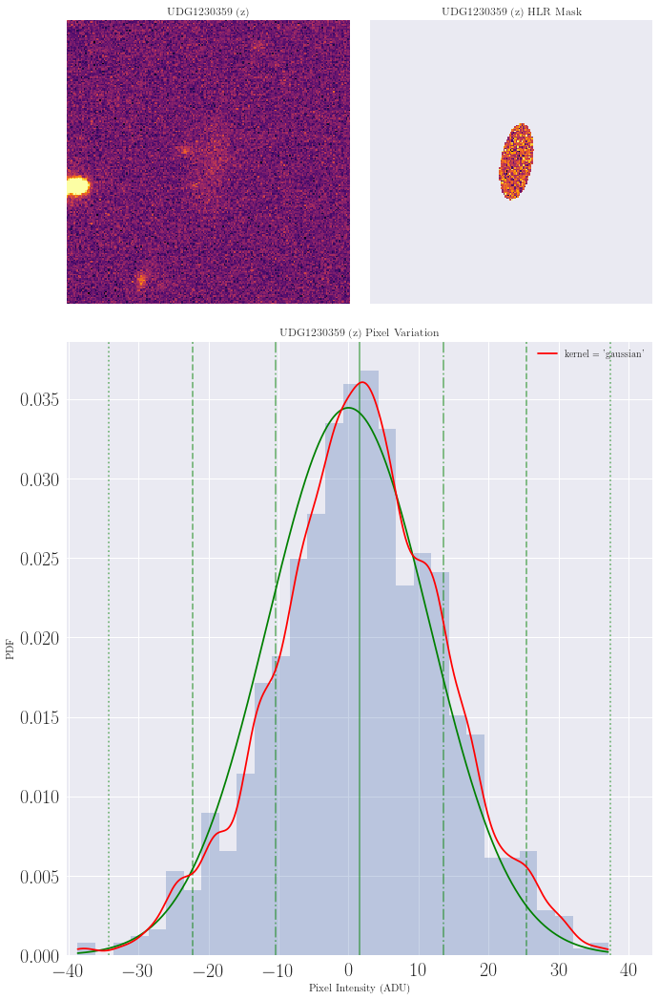

UDG1230359 (z) 
	Background Mean:   1657.624 ADU 
	Background StDev:  0.000 ADU 
	Galaxy Mean:       1.572 ADU 
	Galaxy Median:     1.711 ADU 
	Galaxy StDev:      11.581 ADU 
	Recessional Vel:   -111.000 ADU 
	Mean Square Error: 0.279 ADU


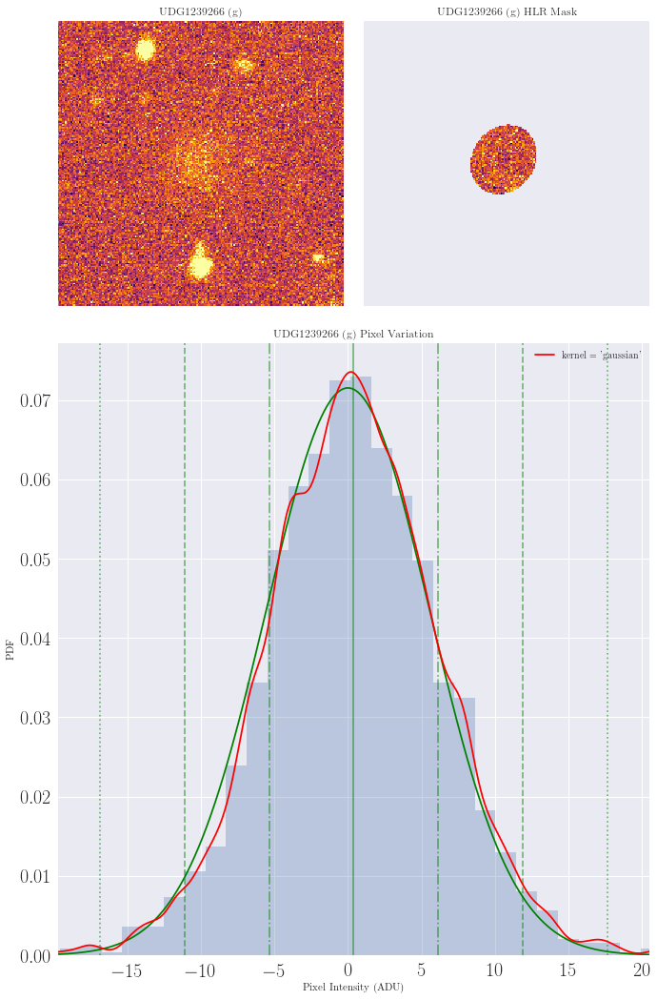

UDG1239266 (g) 
	Background Mean:   136.988 ADU 
	Background StDev:  0.008 ADU 
	Galaxy Mean:       0.387 ADU 
	Galaxy Median:     0.294 ADU 
	Galaxy StDev:      5.578 ADU 
	Recessional Vel:   55.000 ADU 
	Mean Square Error: 2.198 ADU


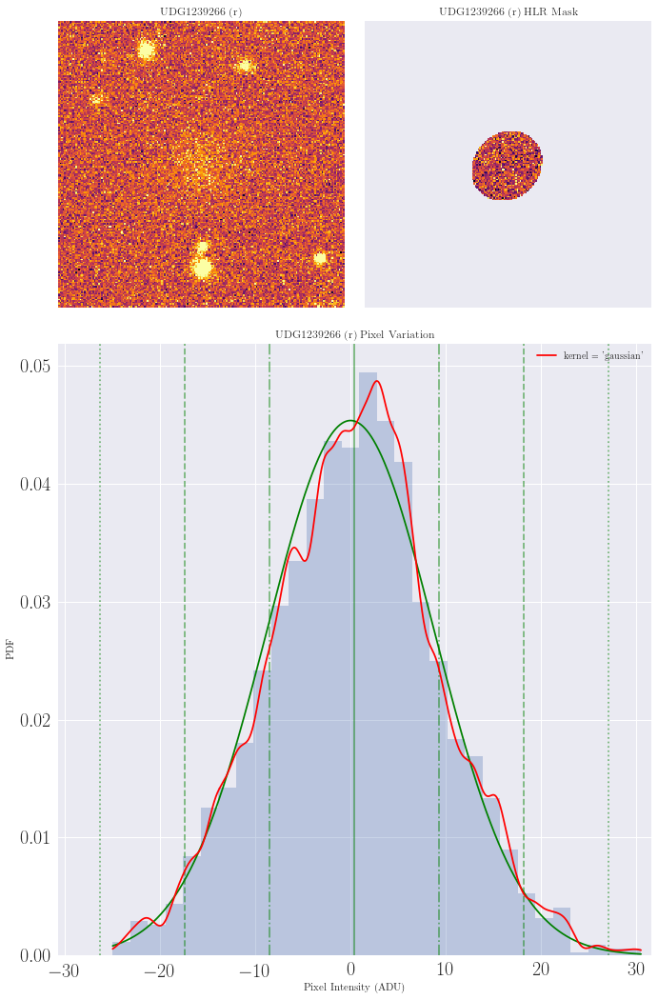

UDG1239266 (r) 
	Background Mean:   293.006 ADU 
	Background StDev:  0.011 ADU 
	Galaxy Mean:       0.428 ADU 
	Galaxy Median:     0.672 ADU 
	Galaxy StDev:      8.791 ADU 
	Recessional Vel:   55.000 ADU 
	Mean Square Error: 0.944 ADU


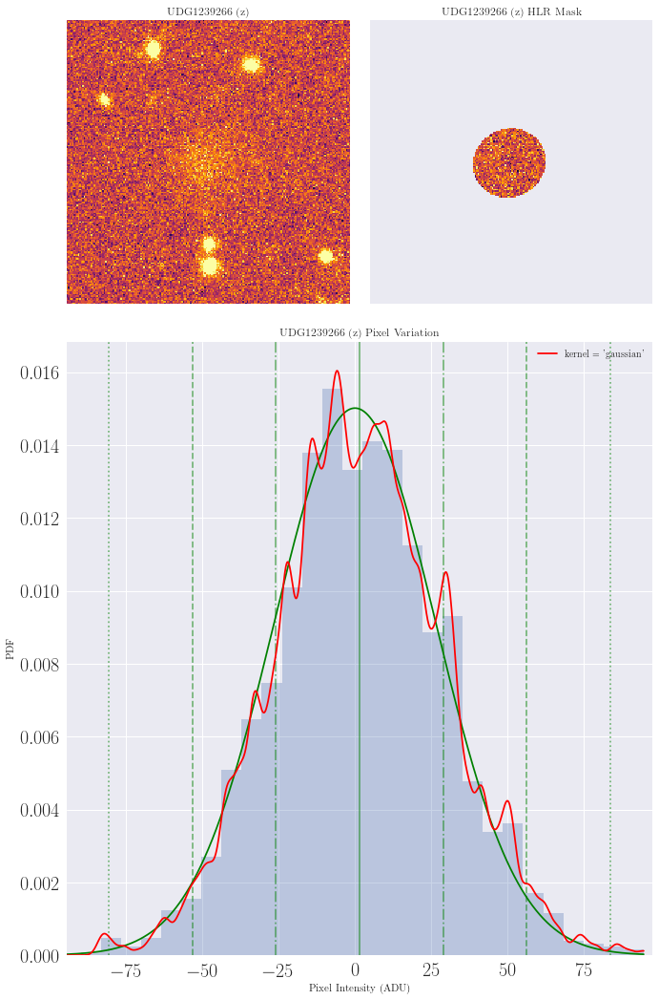

UDG1239266 (z) 
	Background Mean:   6973.821 ADU 
	Background StDev:  0.057 ADU 
	Galaxy Mean:       1.485 ADU 
	Galaxy Median:     1.228 ADU 
	Galaxy StDev:      26.570 ADU 
	Recessional Vel:   55.000 ADU 
	Mean Square Error: 0.109 ADU


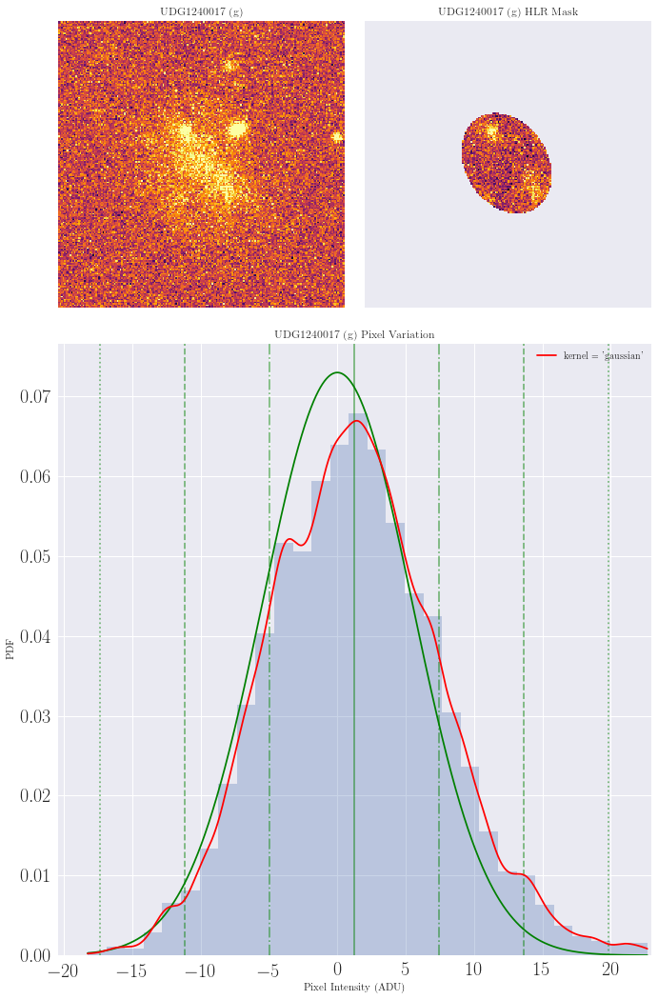

UDG1240017 (g) 
	Background Mean:   158.292 ADU 
	Background StDev:  0.101 ADU 
	Galaxy Mean:       1.262 ADU 
	Galaxy Median:     1.132 ADU 
	Galaxy StDev:      5.466 ADU 
	Recessional Vel:   451.000 ADU 
	Mean Square Error: 3.969 ADU


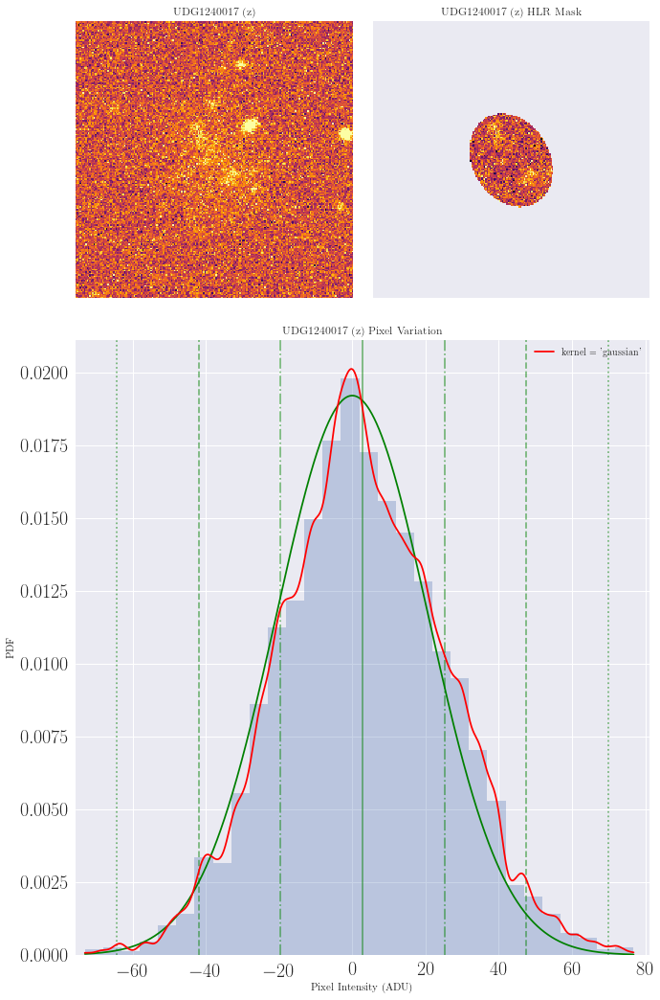

UDG1240017 (z) 
	Background Mean:   4304.902 ADU 
	Background StDev:  0.126 ADU 
	Galaxy Mean:       2.778 ADU 
	Galaxy Median:     1.911 ADU 
	Galaxy StDev:      20.769 ADU 
	Recessional Vel:   451.000 ADU 
	Mean Square Error: 0.266 ADU


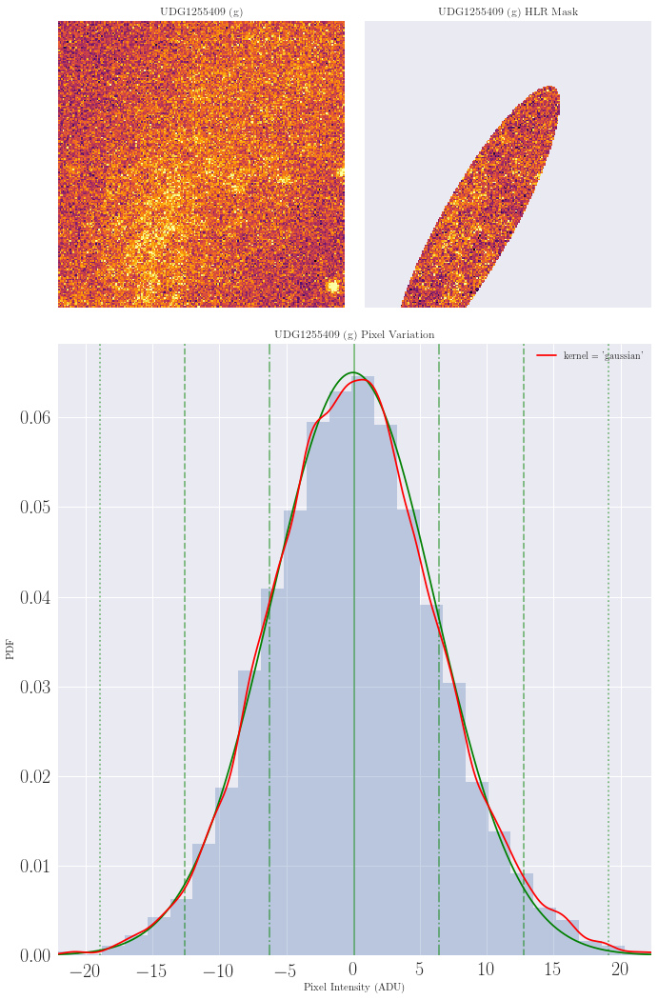

UDG1255409 (g) 
	Background Mean:   120.876 ADU 
	Background StDev:  0.599 ADU 
	Galaxy Mean:       0.118 ADU 
	Galaxy Median:     0.011 ADU 
	Galaxy StDev:      6.138 ADU 
	Recessional Vel:   420.000 ADU 
	Mean Square Error: 7.545 ADU


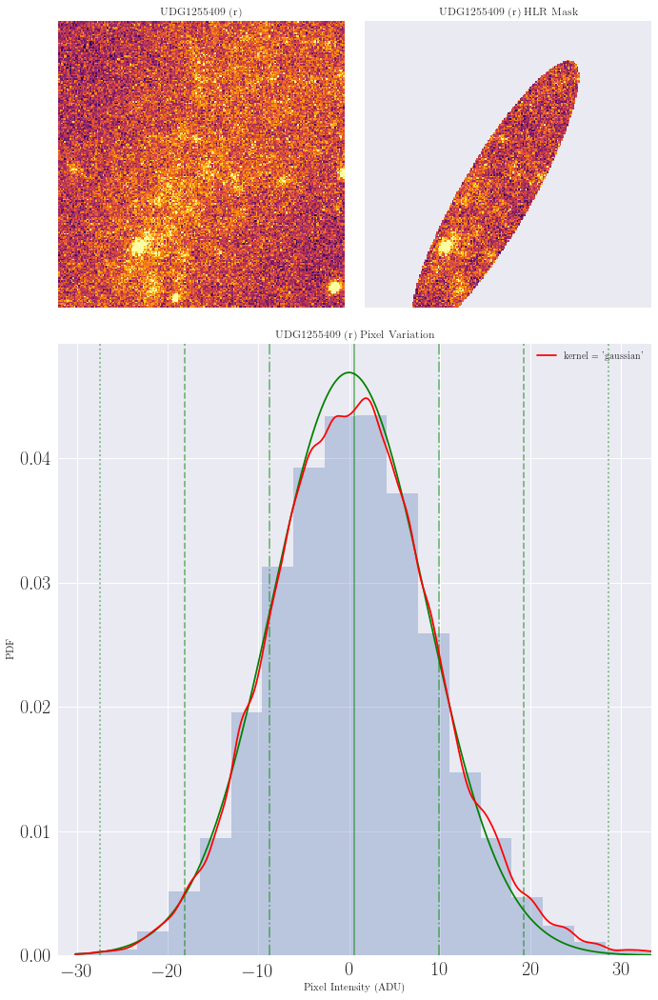

UDG1255409 (r) 
	Background Mean:   438.780 ADU 
	Background StDev:  1.039 ADU 
	Galaxy Mean:       0.614 ADU 
	Galaxy Median:     0.366 ADU 
	Galaxy StDev:      8.510 ADU 
	Recessional Vel:   420.000 ADU 
	Mean Square Error: 3.519 ADU


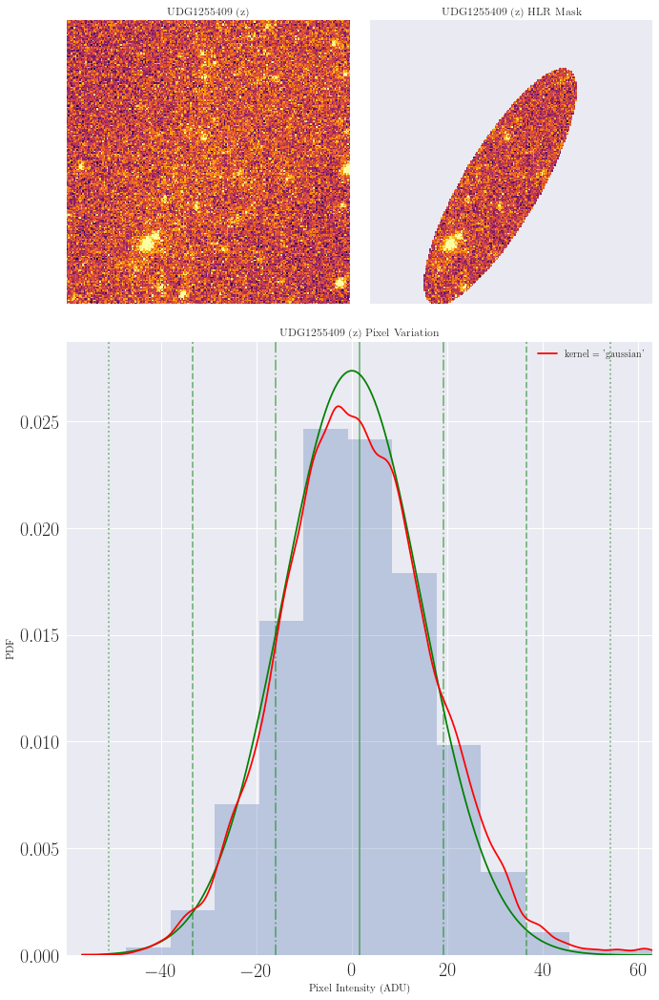

UDG1255409 (z) 
	Background Mean:   2074.602 ADU 
	Background StDev:  0.897 ADU 
	Galaxy Mean:       1.597 ADU 
	Galaxy Median:     0.668 ADU 
	Galaxy StDev:      14.581 ADU 
	Recessional Vel:   420.000 ADU 
	Mean Square Error: 0.882 ADU


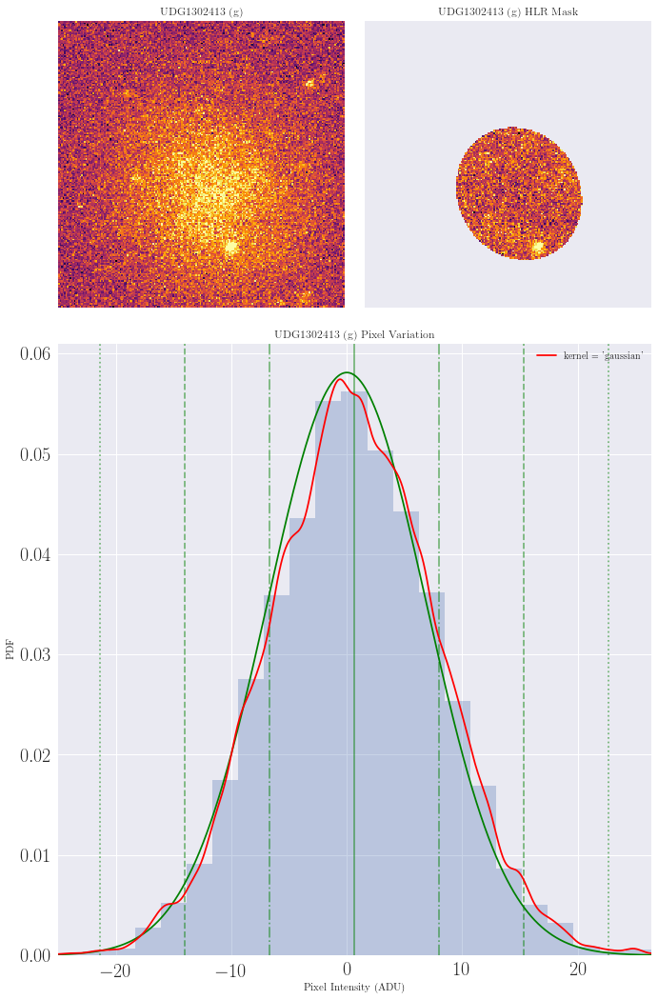

UDG1302413 (g) 
	Background Mean:   159.916 ADU 
	Background StDev:  1.219 ADU 
	Galaxy Mean:       0.674 ADU 
	Galaxy Median:     0.546 ADU 
	Galaxy StDev:      6.866 ADU 
	Recessional Vel:   267.000 ADU 
	Mean Square Error: 4.762 ADU


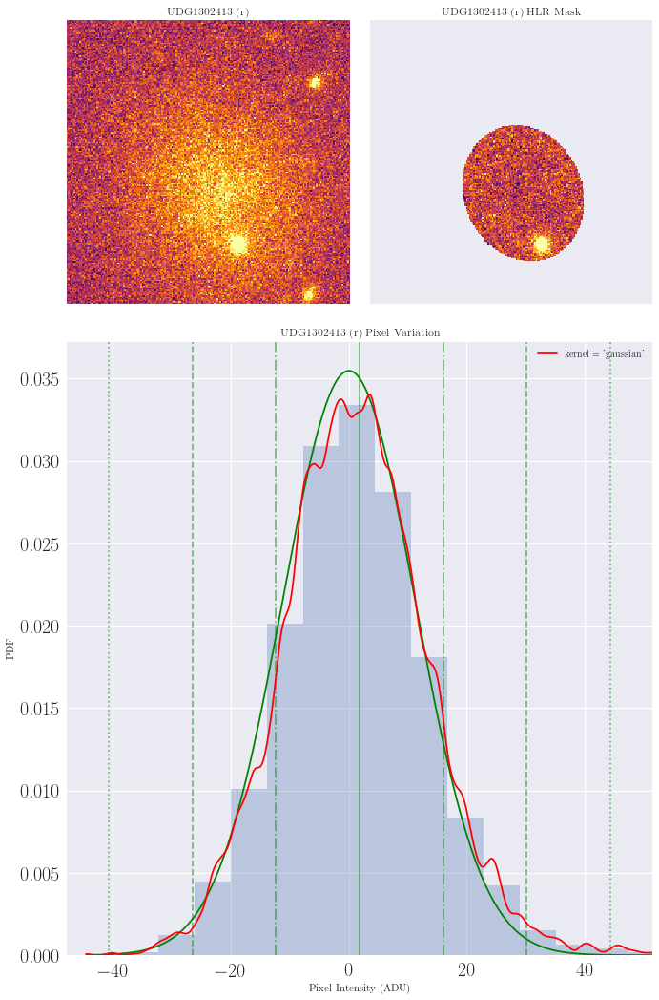

UDG1302413 (r) 
	Background Mean:   464.622 ADU 
	Background StDev:  2.013 ADU 
	Galaxy Mean:       1.803 ADU 
	Galaxy Median:     1.032 ADU 
	Galaxy StDev:      11.248 ADU 
	Recessional Vel:   267.000 ADU 
	Mean Square Error: 1.317 ADU


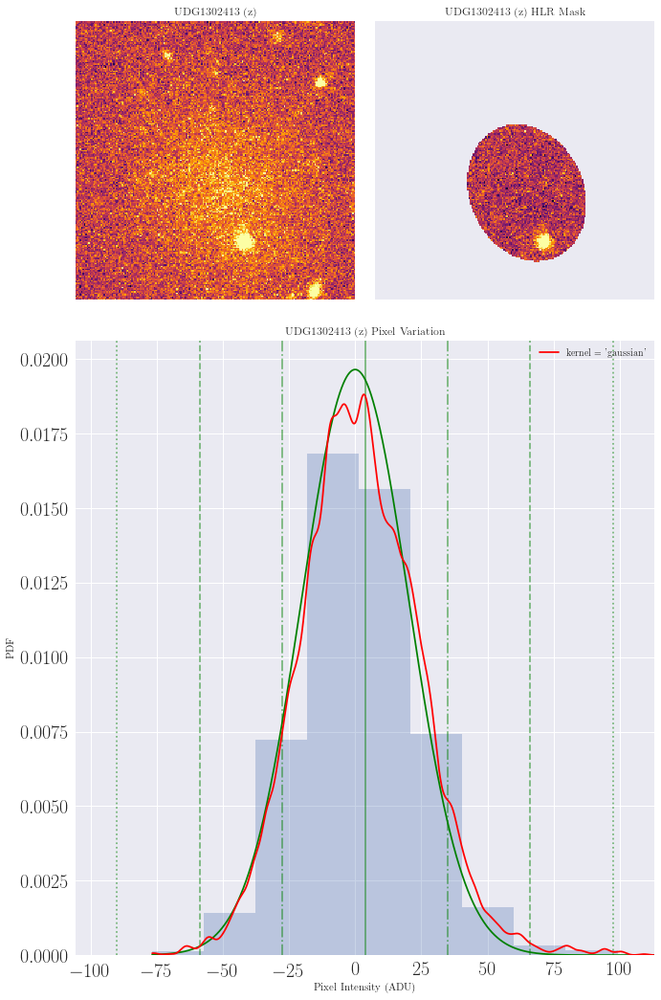

UDG1302413 (z) 
	Background Mean:   2856.355 ADU 
	Background StDev:  2.289 ADU 
	Galaxy Mean:       3.714 ADU 
	Galaxy Median:     1.432 ADU 
	Galaxy StDev:      20.295 ADU 
	Recessional Vel:   267.000 ADU 
	Mean Square Error: 0.257 ADU


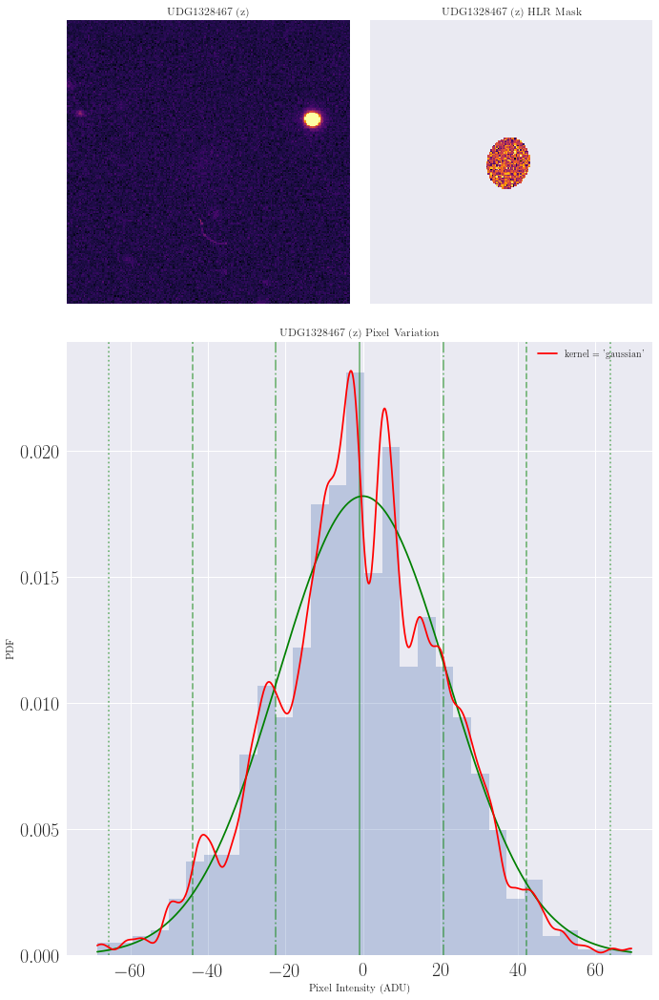

UDG1328467 (z) 
	Background Mean:   6115.424 ADU 
	Background StDev:  0.001 ADU 
	Galaxy Mean:       -0.879 ADU 
	Galaxy Median:     -1.532 ADU 
	Galaxy StDev:      21.923 ADU 
	Recessional Vel:   0.511 ADU 
	Mean Square Error: 0.075 ADU


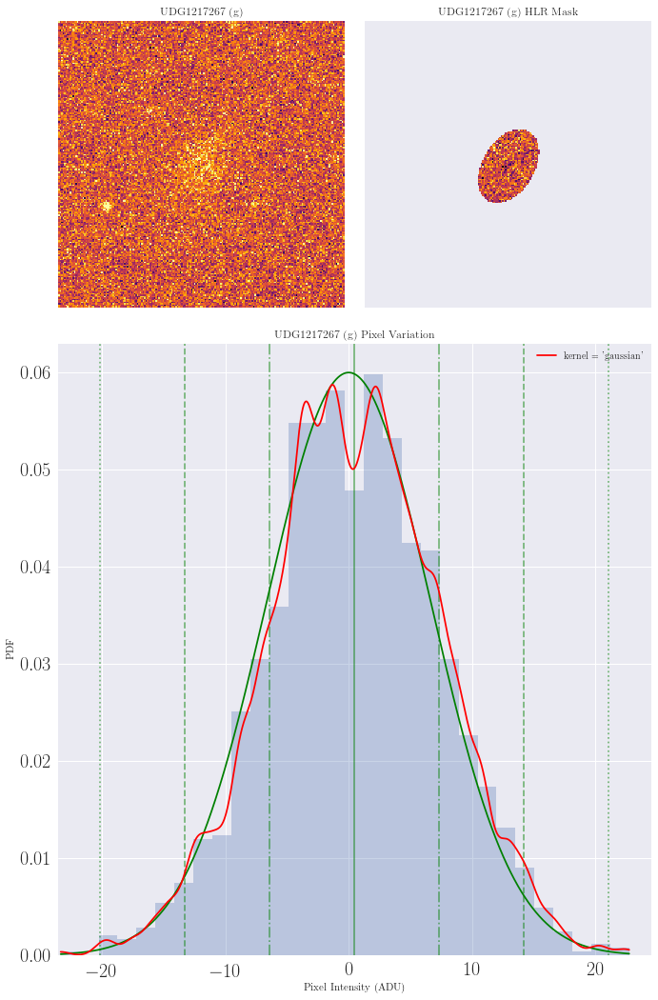

UDG1217267 (g) 
	Background Mean:   164.240 ADU 
	Background StDev:  0.005 ADU 
	Galaxy Mean:       0.480 ADU 
	Galaxy Median:     0.455 ADU 
	Galaxy StDev:      6.655 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 1.373 ADU


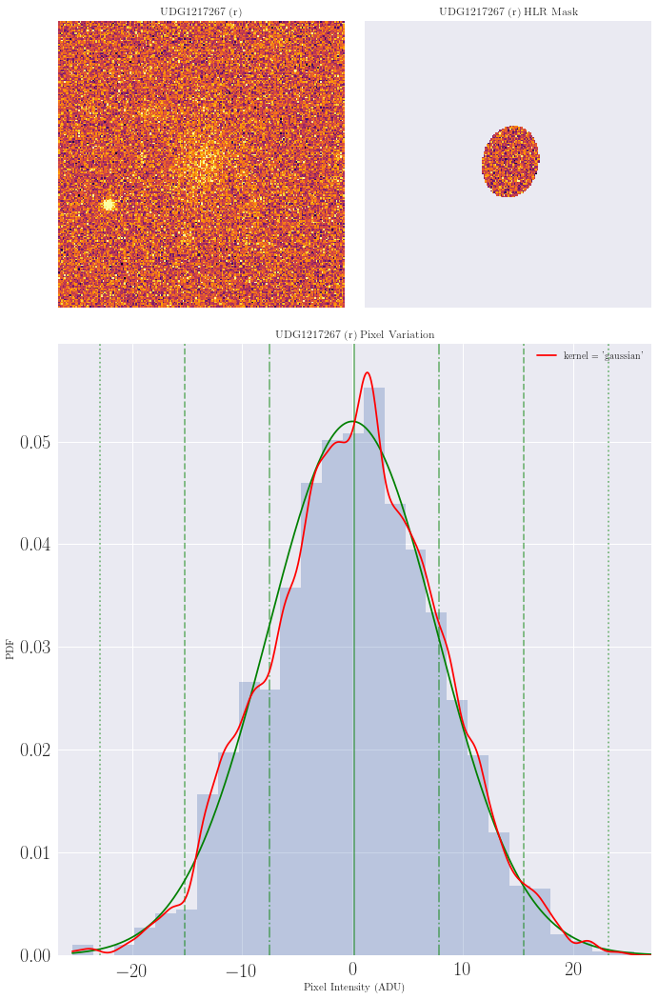

UDG1217267 (r) 
	Background Mean:   200.451 ADU 
	Background StDev:  0.006 ADU 
	Galaxy Mean:       0.196 ADU 
	Galaxy Median:     0.301 ADU 
	Galaxy StDev:      7.679 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 1.041 ADU


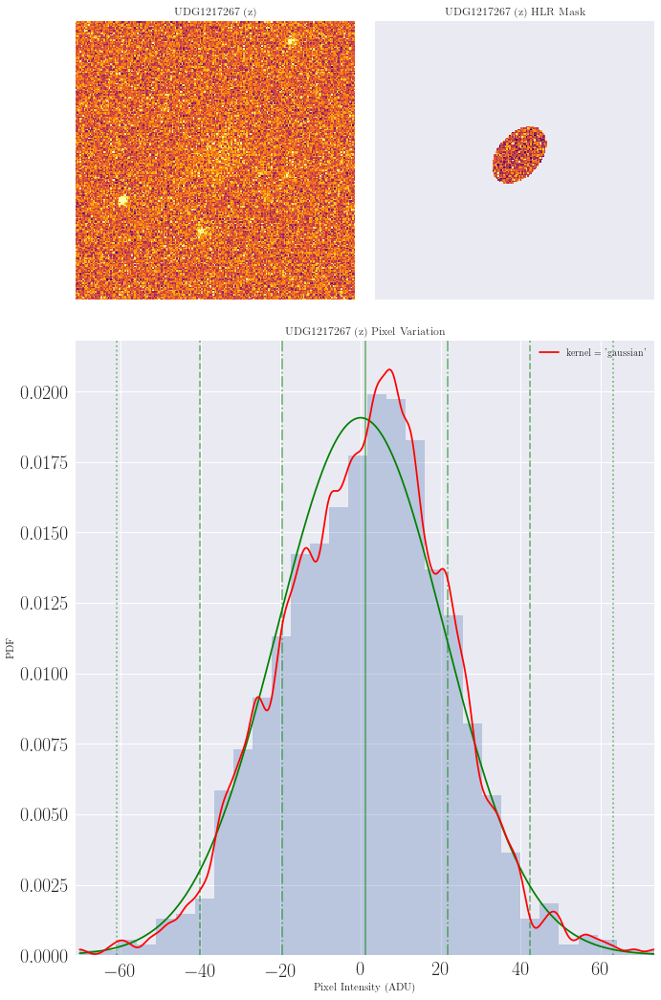

UDG1217267 (z) 
	Background Mean:   3037.386 ADU 
	Background StDev:  0.003 ADU 
	Galaxy Mean:       1.087 ADU 
	Galaxy Median:     2.265 ADU 
	Galaxy StDev:      20.921 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 0.106 ADU


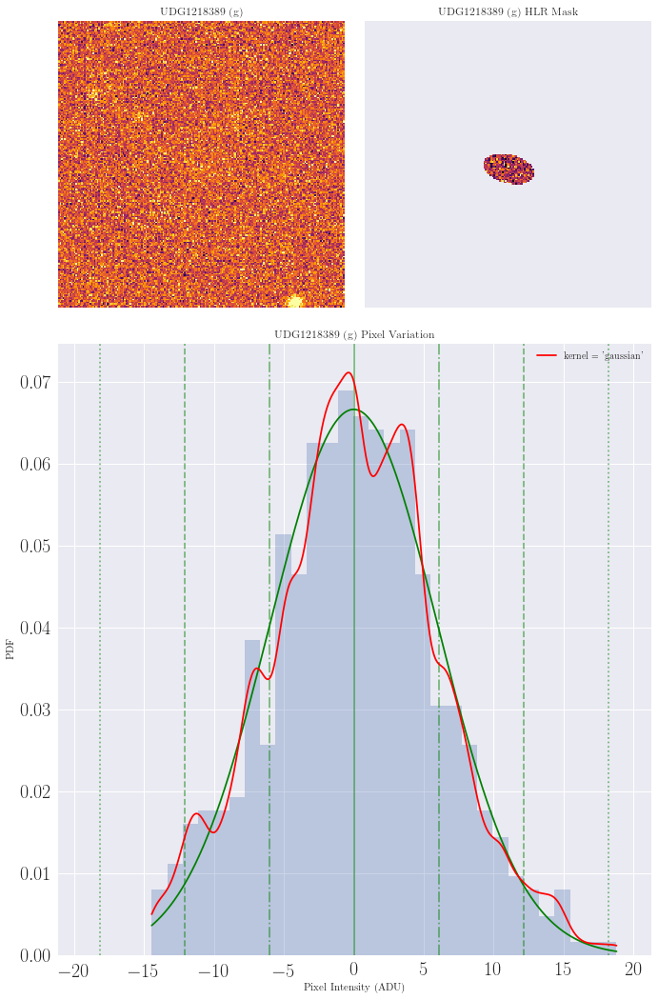

UDG1218389 (g) 
	Background Mean:   163.791 ADU 
	Background StDev:  0.000 ADU 
	Galaxy Mean:       0.065 ADU 
	Galaxy Median:     0.001 ADU 
	Galaxy StDev:      5.991 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 0.586 ADU


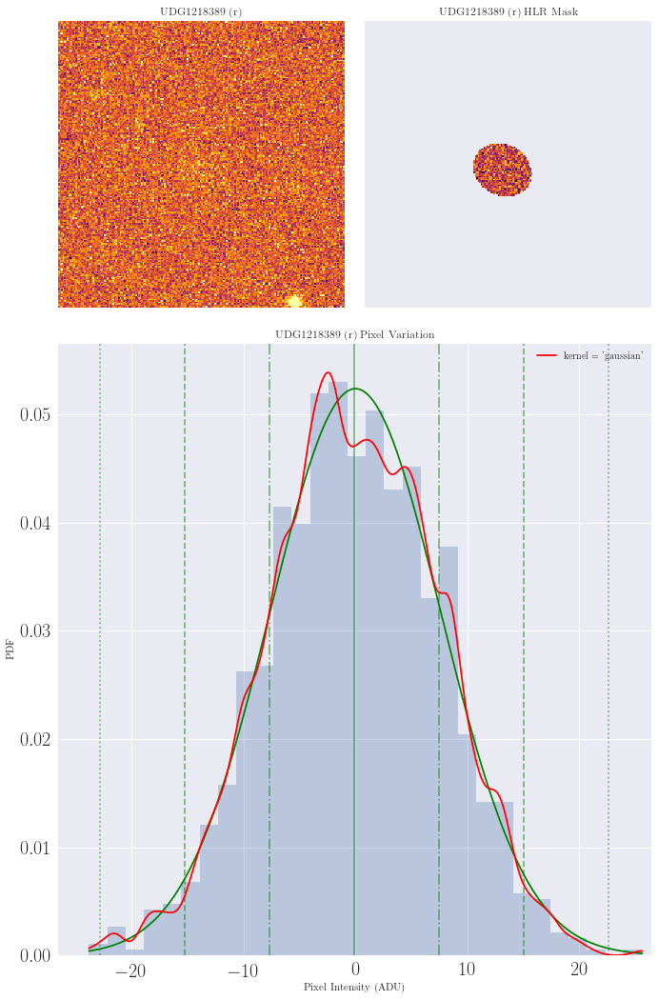

UDG1218389 (r) 
	Background Mean:   200.840 ADU 
	Background StDev:  0.001 ADU 
	Galaxy Mean:       -0.071 ADU 
	Galaxy Median:     -0.151 ADU 
	Galaxy StDev:      7.616 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 0.785 ADU


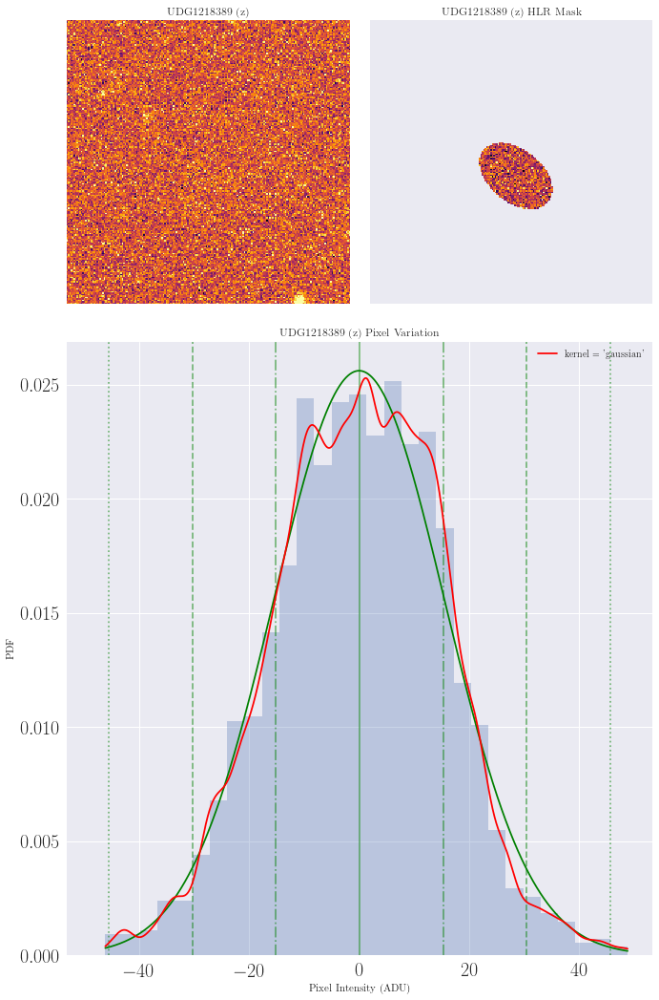

UDG1218389 (z) 
	Background Mean:   2369.411 ADU 
	Background StDev:  0.003 ADU 
	Galaxy Mean:       0.066 ADU 
	Galaxy Median:     0.648 ADU 
	Galaxy StDev:      15.579 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 0.282 ADU


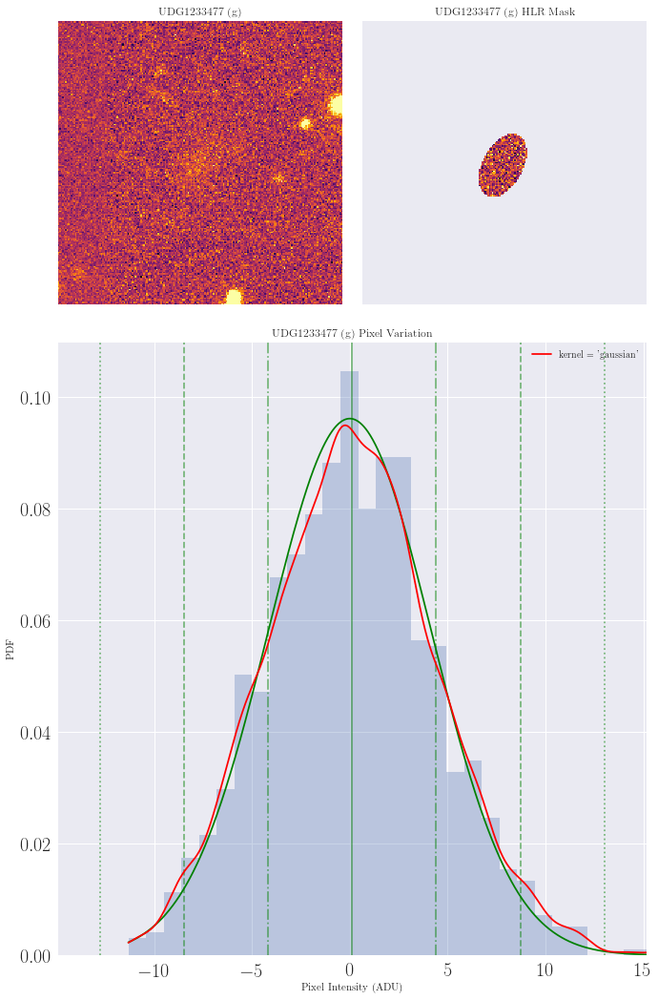

UDG1233477 (g) 
	Background Mean:   141.015 ADU 
	Background StDev:  0.001 ADU 
	Galaxy Mean:       0.124 ADU 
	Galaxy Median:     0.010 ADU 
	Galaxy StDev:      4.148 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 2.366 ADU


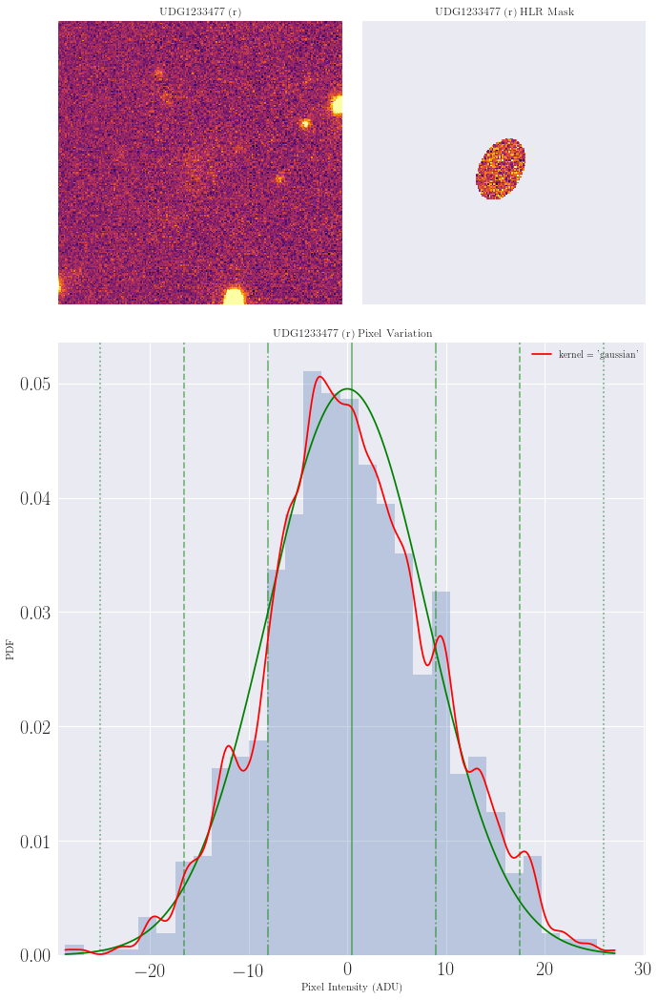

UDG1233477 (r) 
	Background Mean:   446.909 ADU 
	Background StDev:  0.001 ADU 
	Galaxy Mean:       0.462 ADU 
	Galaxy Median:     0.135 ADU 
	Galaxy StDev:      8.057 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 0.654 ADU


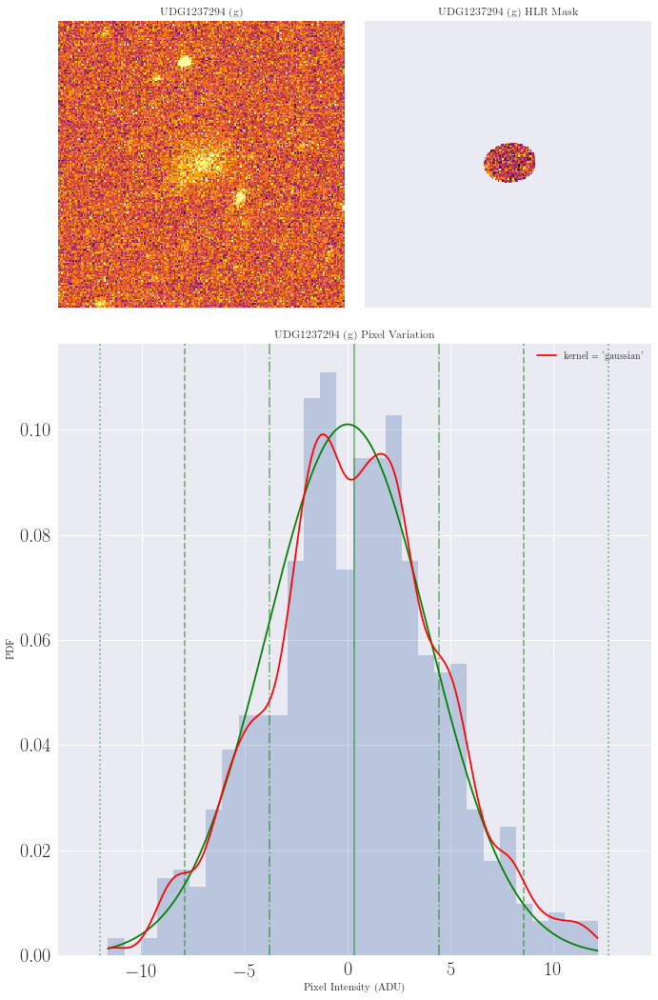

UDG1237294 (g) 
	Background Mean:   128.363 ADU 
	Background StDev:  0.000 ADU 
	Galaxy Mean:       0.334 ADU 
	Galaxy Median:     0.383 ADU 
	Galaxy StDev:      3.948 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 1.825 ADU


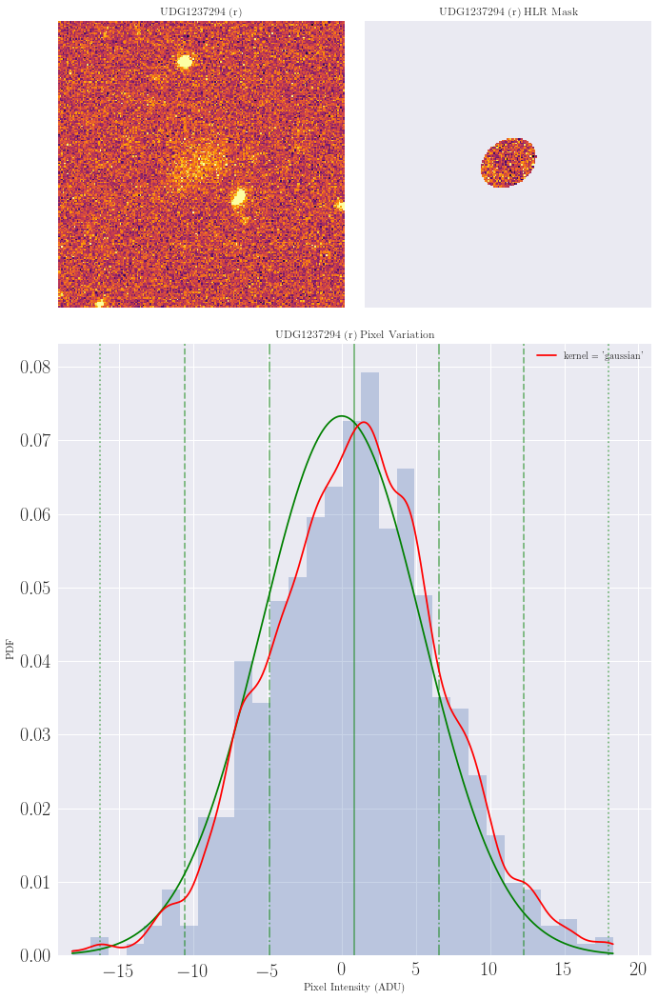

UDG1237294 (r) 
	Background Mean:   297.923 ADU 
	Background StDev:  0.001 ADU 
	Galaxy Mean:       0.873 ADU 
	Galaxy Median:     0.943 ADU 
	Galaxy StDev:      5.443 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 1.282 ADU


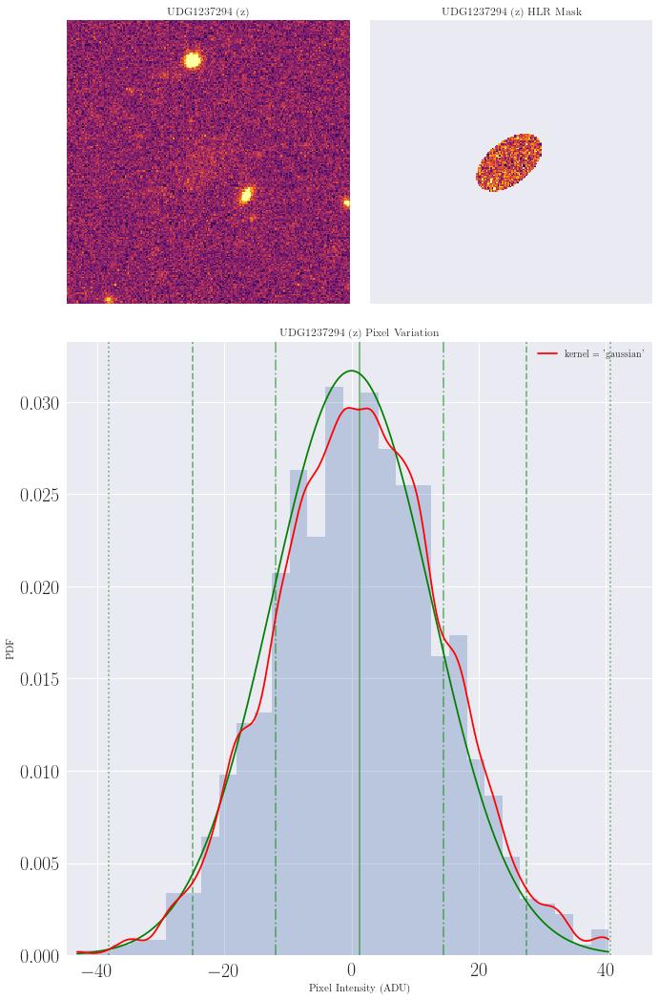

UDG1237294 (z) 
	Background Mean:   2667.666 ADU 
	Background StDev:  0.004 ADU 
	Galaxy Mean:       1.250 ADU 
	Galaxy Median:     1.251 ADU 
	Galaxy StDev:      12.589 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 0.304 ADU


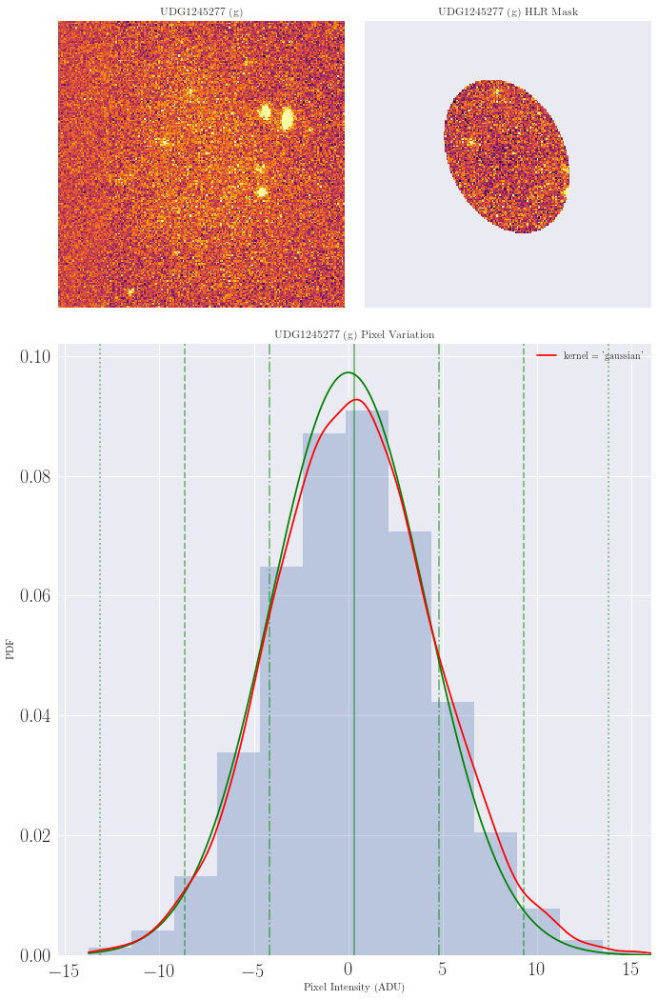

UDG1245277 (g) 
	Background Mean:   117.482 ADU 
	Background StDev:  0.300 ADU 
	Galaxy Mean:       0.336 ADU 
	Galaxy Median:     0.226 ADU 
	Galaxy StDev:      4.103 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 10.927 ADU


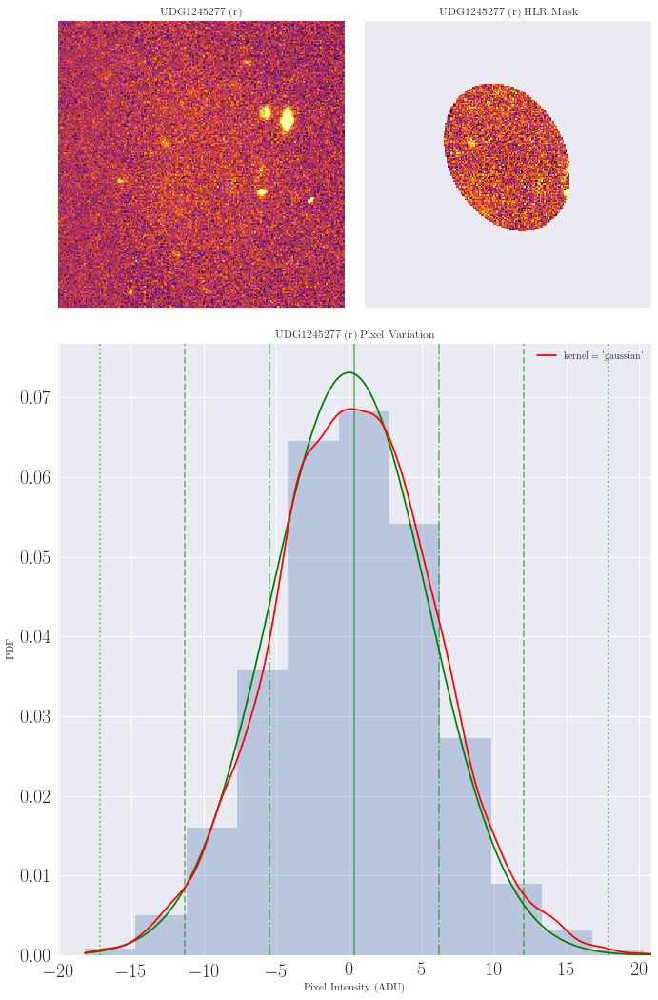

UDG1245277 (r) 
	Background Mean:   192.017 ADU 
	Background StDev:  0.308 ADU 
	Galaxy Mean:       0.386 ADU 
	Galaxy Median:     0.329 ADU 
	Galaxy StDev:      5.457 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 5.424 ADU


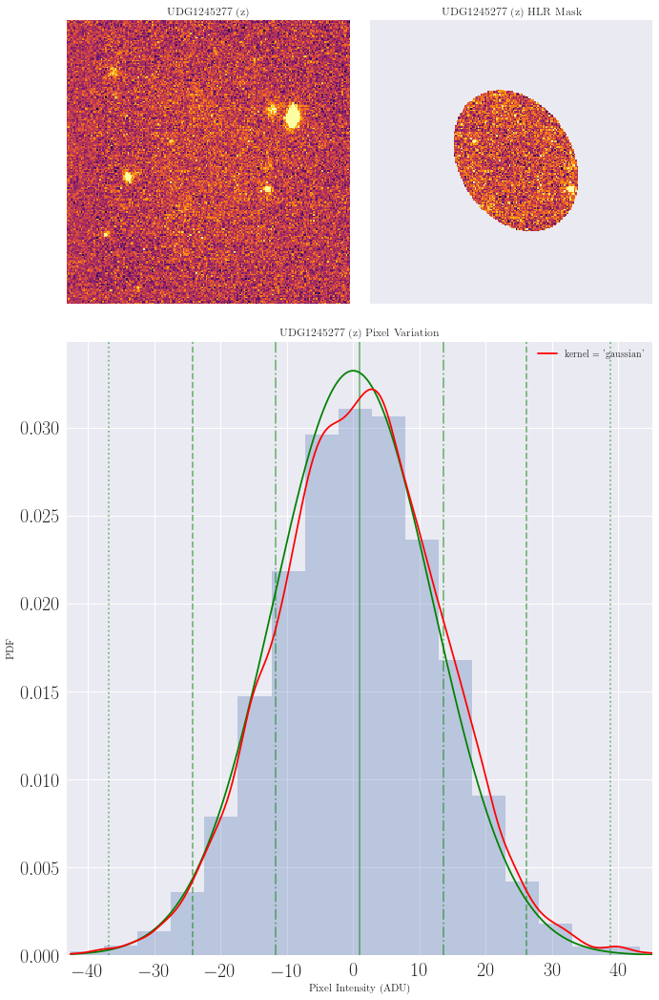

UDG1245277 (z) 
	Background Mean:   1592.692 ADU 
	Background StDev:  0.506 ADU 
	Galaxy Mean:       0.961 ADU 
	Galaxy Median:     0.970 ADU 
	Galaxy StDev:      12.008 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 1.458 ADU


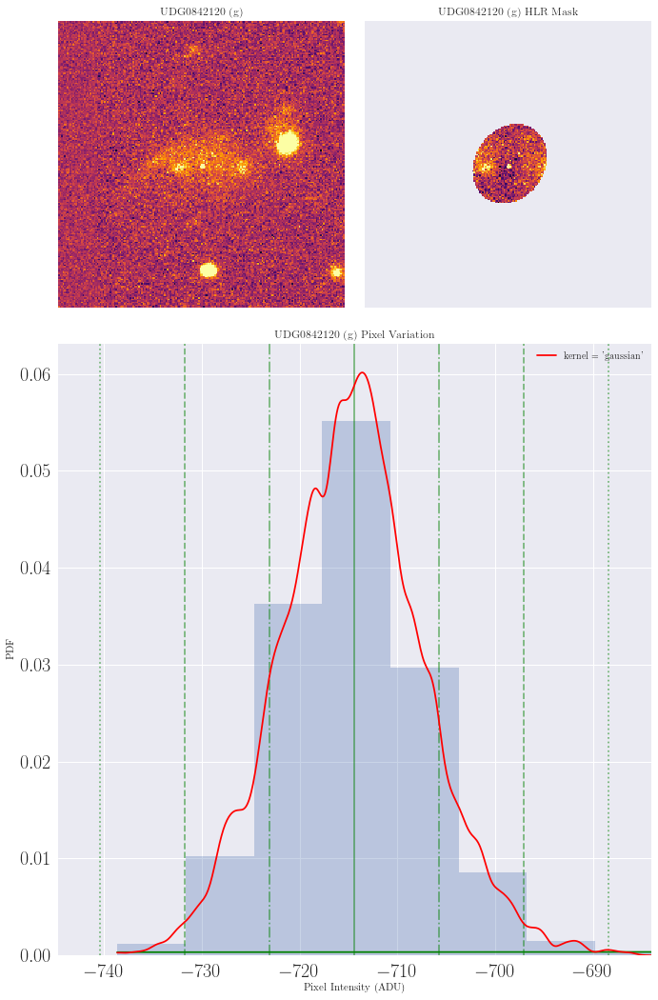

UDG0842120 (g) 
	Background Mean:   1020.853 ADU 
	Background StDev:  0.032 ADU 
	Galaxy Mean:       -714.369 ADU 
	Galaxy Median:     -714.543 ADU 
	Galaxy StDev:      714.584 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 0.404 ADU


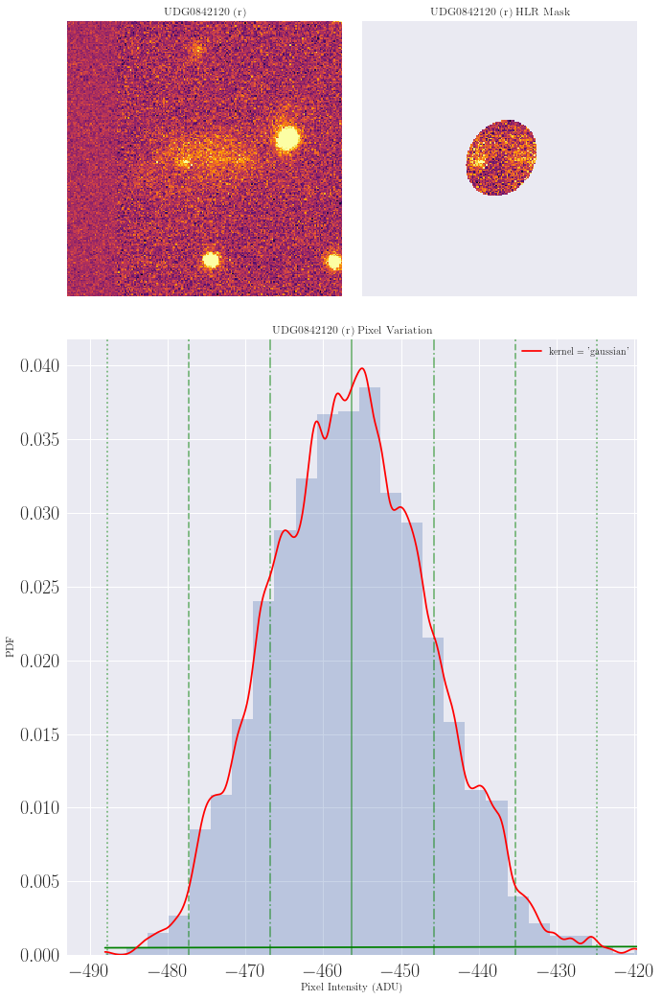

UDG0842120 (r) 
	Background Mean:   1020.853 ADU 
	Background StDev:  0.032 ADU 
	Galaxy Mean:       -456.303 ADU 
	Galaxy Median:     -456.478 ADU 
	Galaxy StDev:      456.527 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 0.699 ADU


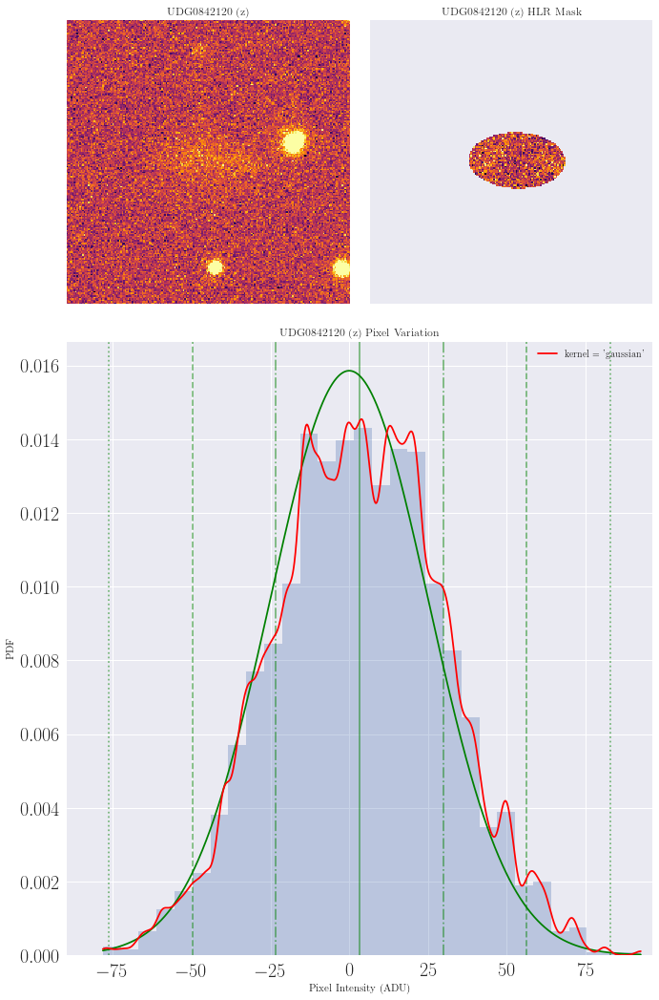

UDG0842120 (z) 
	Background Mean:   6337.553 ADU 
	Background StDev:  0.042 ADU 
	Galaxy Mean:       3.268 ADU 
	Galaxy Median:     3.443 ADU 
	Galaxy StDev:      25.153 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 0.125 ADU


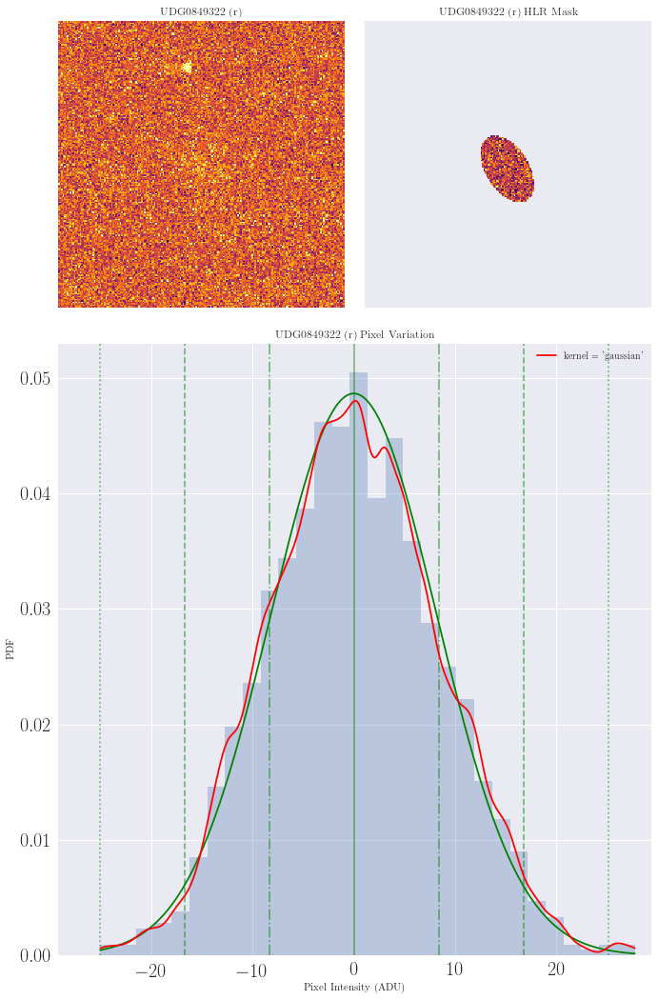

UDG0849322 (r) 
	Background Mean:   216.714 ADU 
	Background StDev:  0.001 ADU 
	Galaxy Mean:       0.083 ADU 
	Galaxy Median:     -0.089 ADU 
	Galaxy StDev:      8.201 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 0.681 ADU


/Users/jennifer_kadowaki/anaconda/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:1649: RuntimeWarning: divide by zero encountered in true_divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)


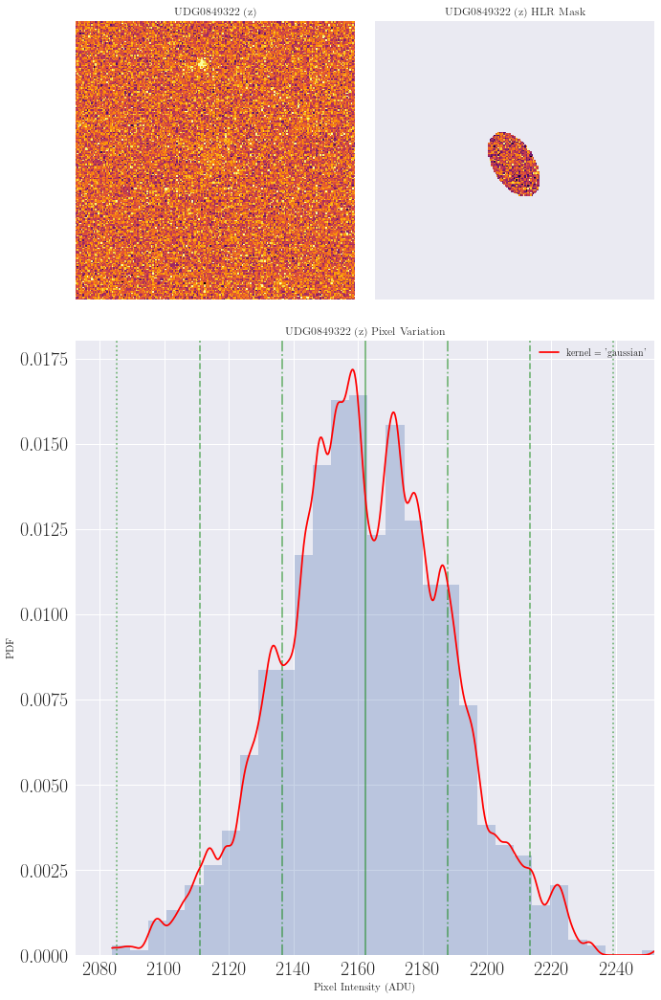

UDG0849322 (z) 
	Background Mean:   216.714 ADU 
	Background StDev:  0.001 ADU 
	Galaxy Mean:       2162.199 ADU 
	Galaxy Median:     2161.038 ADU 
	Galaxy StDev:      -0.000 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: nan ADU


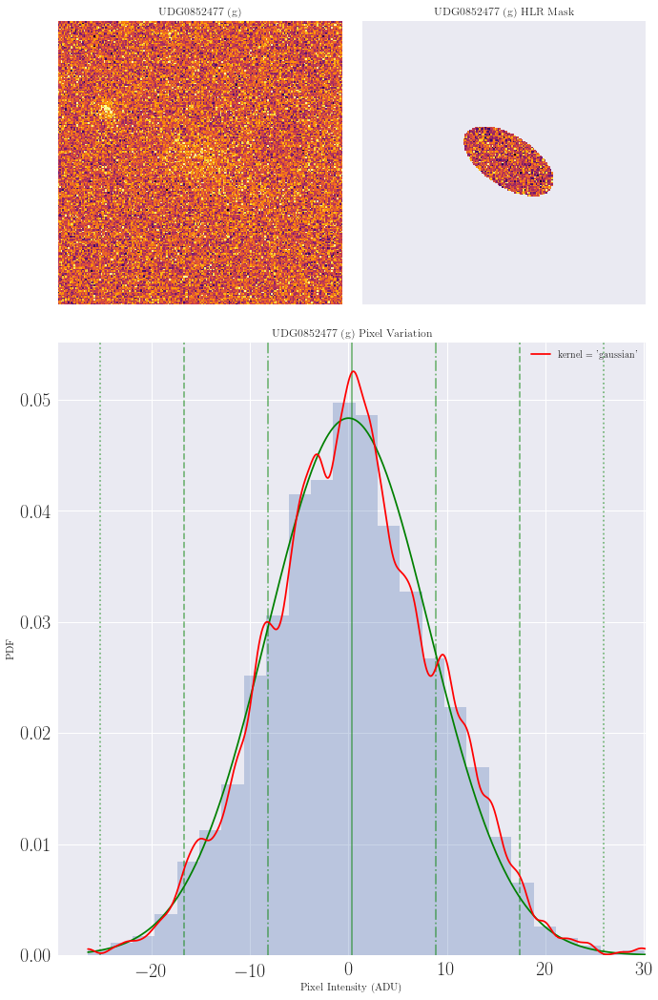

UDG0852477 (g) 
	Background Mean:   249.506 ADU 
	Background StDev:  0.009 ADU 
	Galaxy Mean:       0.328 ADU 
	Galaxy Median:     0.195 ADU 
	Galaxy StDev:      8.253 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 1.139 ADU


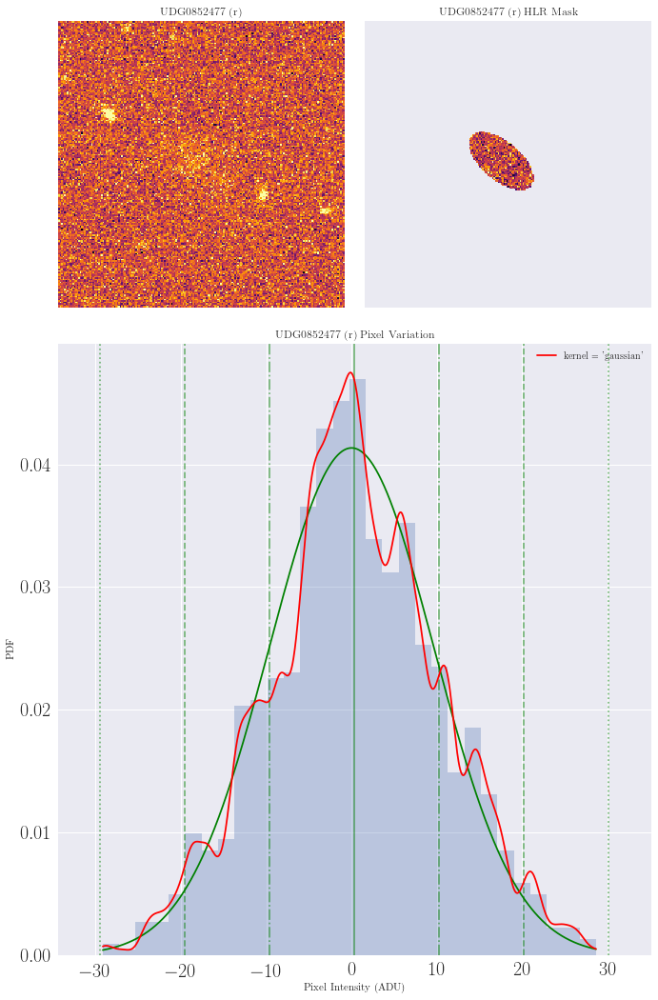

UDG0852477 (r) 
	Background Mean:   339.725 ADU 
	Background StDev:  0.002 ADU 
	Galaxy Mean:       0.355 ADU 
	Galaxy Median:     0.054 ADU 
	Galaxy StDev:      9.650 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 0.469 ADU


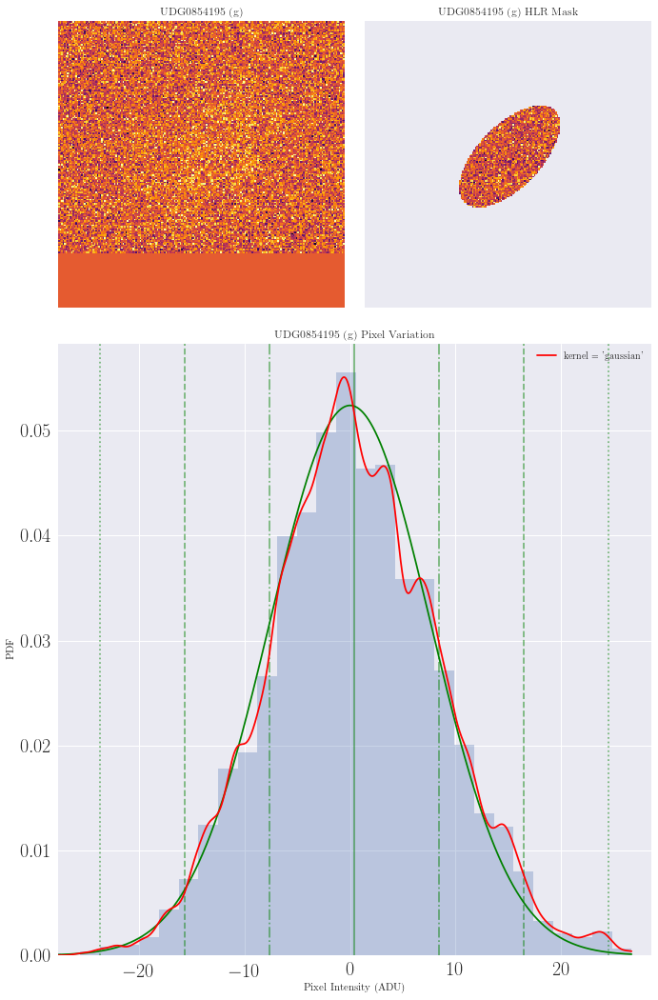

UDG0854195 (g) 
	Background Mean:   205.824 ADU 
	Background StDev:  0.023 ADU 
	Galaxy Mean:       0.428 ADU 
	Galaxy Median:     0.094 ADU 
	Galaxy StDev:      7.613 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 2.030 ADU


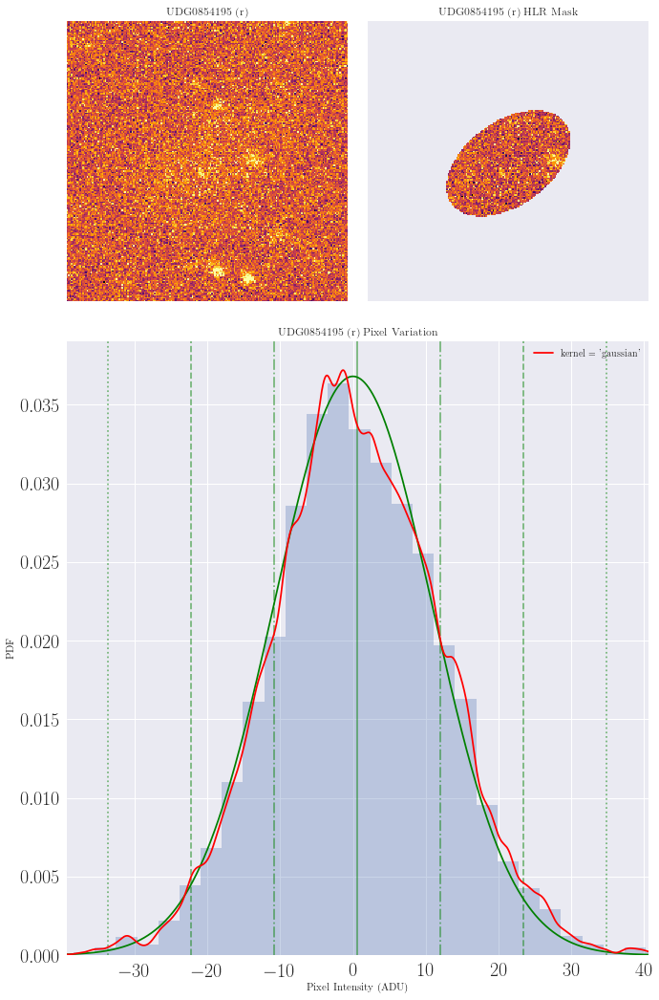

UDG0854195 (r) 
	Background Mean:   652.374 ADU 
	Background StDev:  0.161 ADU 
	Galaxy Mean:       0.640 ADU 
	Galaxy Median:     0.279 ADU 
	Galaxy StDev:      10.842 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 1.513 ADU


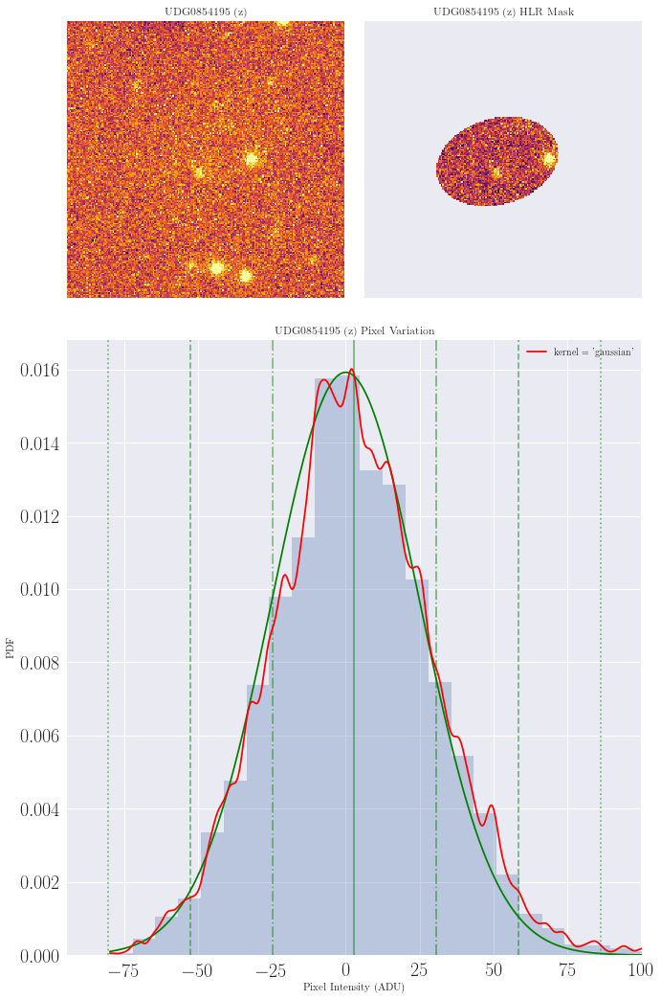

UDG0854195 (z) 
	Background Mean:   7886.662 ADU 
	Background StDev:  0.177 ADU 
	Galaxy Mean:       2.963 ADU 
	Galaxy Median:     1.879 ADU 
	Galaxy StDev:      25.060 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 0.248 ADU


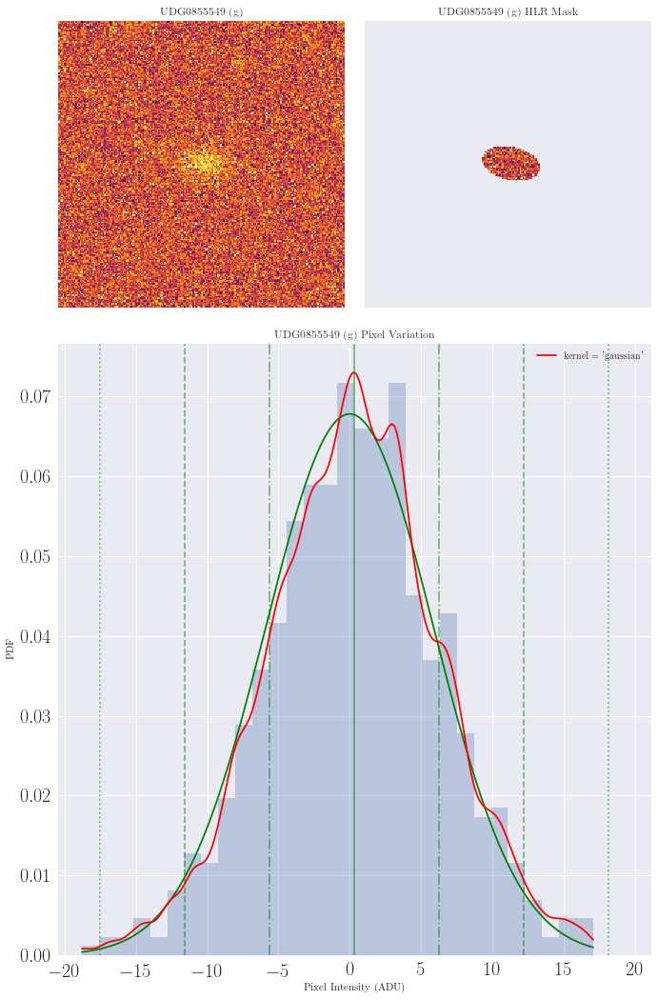

UDG0855549 (g) 
	Background Mean:   252.415 ADU 
	Background StDev:  0.000 ADU 
	Galaxy Mean:       0.346 ADU 
	Galaxy Median:     0.374 ADU 
	Galaxy StDev:      5.883 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 0.811 ADU


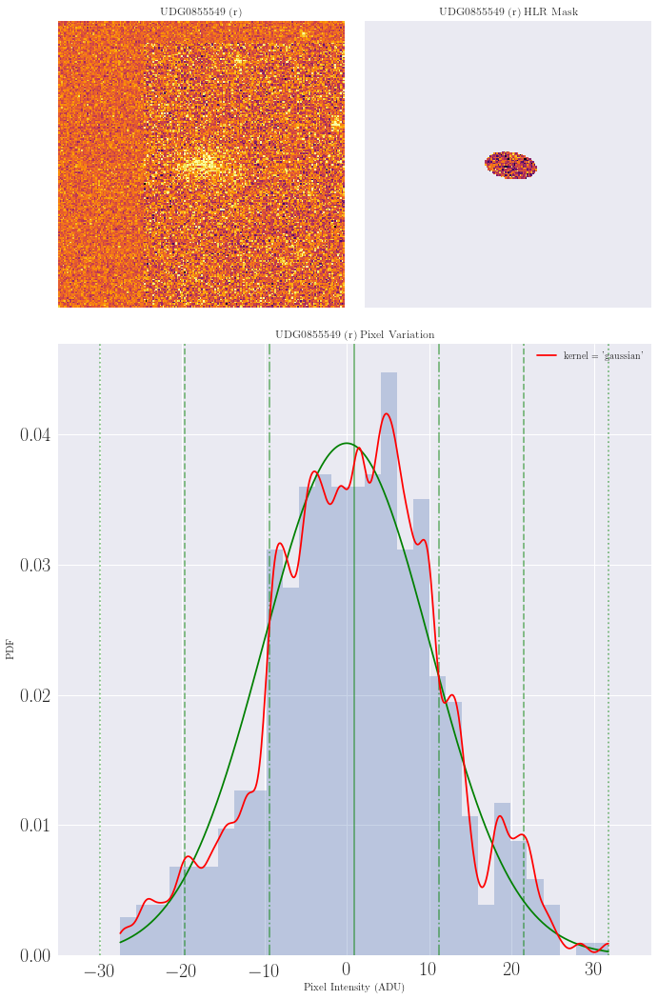

UDG0855549 (r) 
	Background Mean:   656.765 ADU 
	Background StDev:  0.000 ADU 
	Galaxy Mean:       0.964 ADU 
	Galaxy Median:     1.316 ADU 
	Galaxy StDev:      10.139 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 0.197 ADU


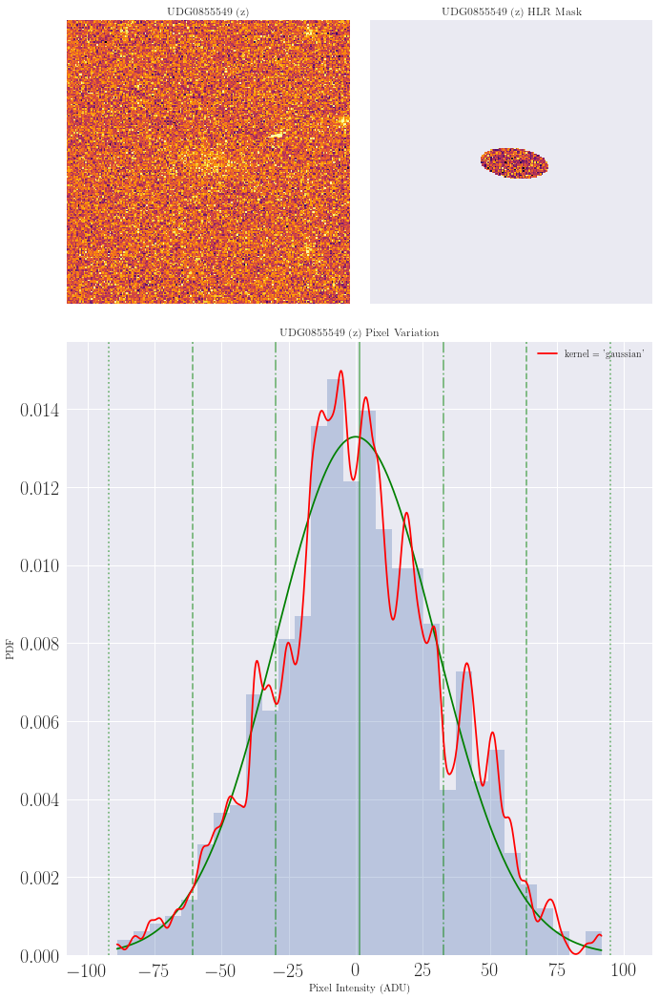

UDG0855549 (z) 
	Background Mean:   7684.102 ADU 
	Background StDev:  0.001 ADU 
	Galaxy Mean:       1.411 ADU 
	Galaxy Median:     0.651 ADU 
	Galaxy StDev:      30.023 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 0.034 ADU


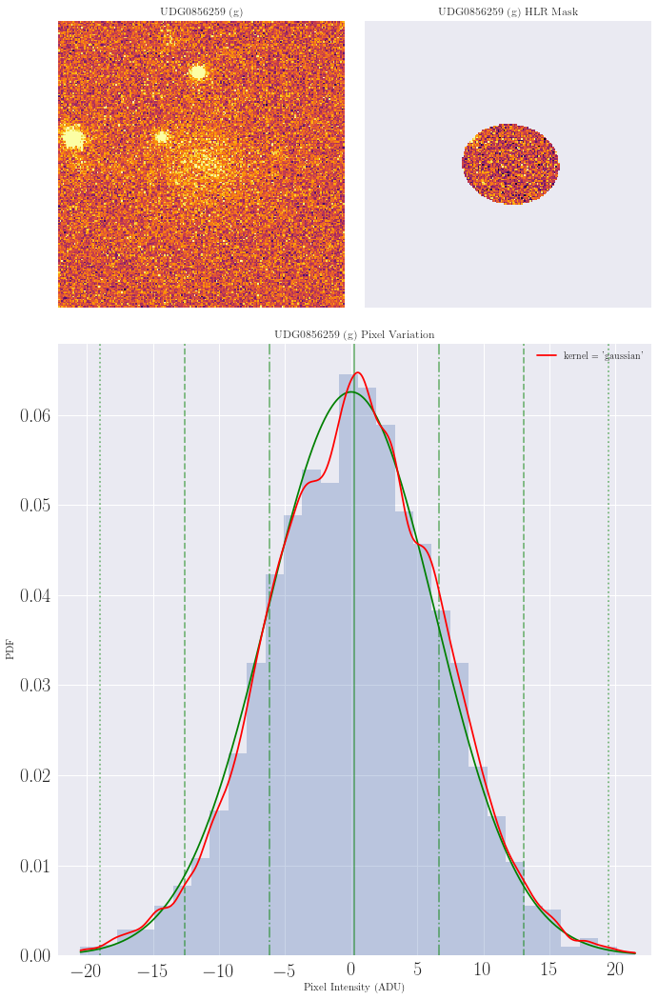

UDG0856259 (g) 
	Background Mean:   252.458 ADU 
	Background StDev:  0.048 ADU 
	Galaxy Mean:       0.261 ADU 
	Galaxy Median:     0.344 ADU 
	Galaxy StDev:      6.377 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 2.859 ADU


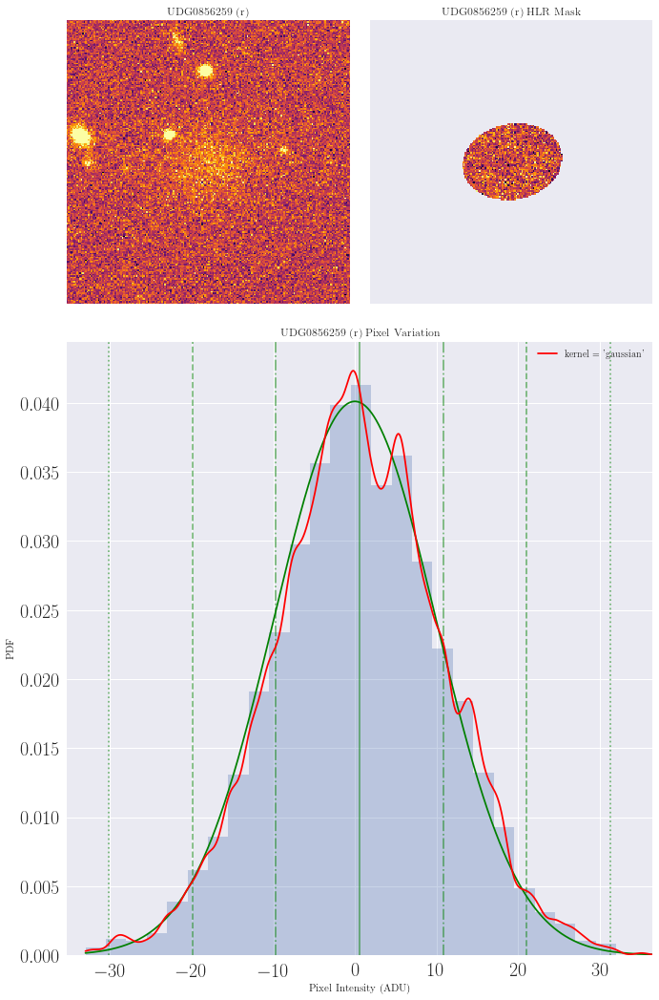

UDG0856259 (r) 
	Background Mean:   656.563 ADU 
	Background StDev:  0.078 ADU 
	Galaxy Mean:       0.568 ADU 
	Galaxy Median:     0.351 ADU 
	Galaxy StDev:      9.944 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 1.165 ADU


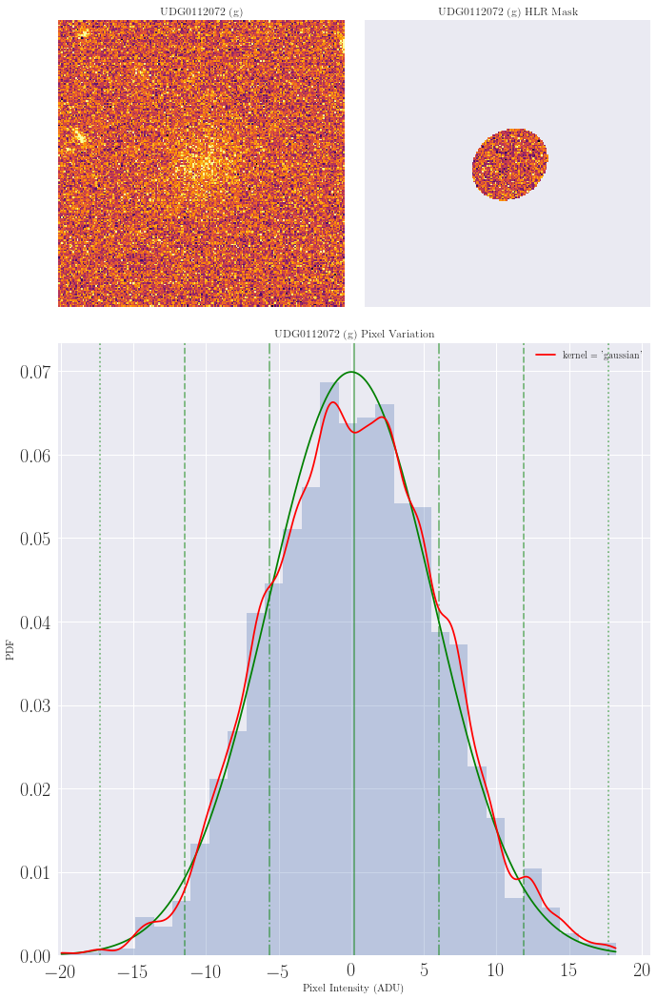

UDG0112072 (g) 
	Background Mean:   105.070 ADU 
	Background StDev:  0.012 ADU 
	Galaxy Mean:       0.199 ADU 
	Galaxy Median:     0.171 ADU 
	Galaxy StDev:      5.706 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 2.400 ADU


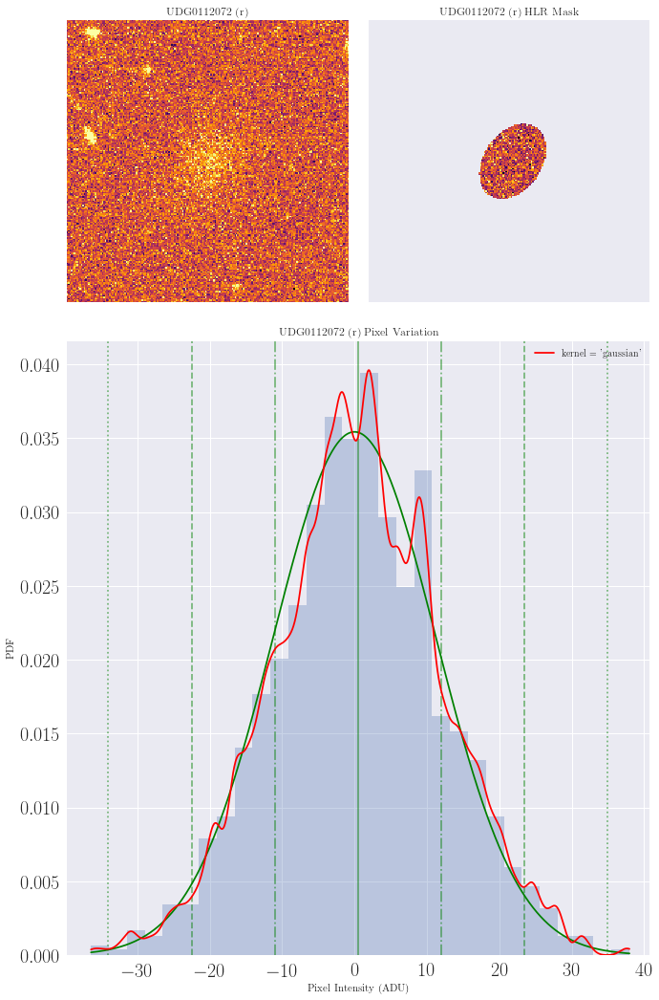

UDG0112072 (r) 
	Background Mean:   423.807 ADU 
	Background StDev:  0.020 ADU 
	Galaxy Mean:       0.495 ADU 
	Galaxy Median:     0.420 ADU 
	Galaxy StDev:      11.261 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 0.586 ADU


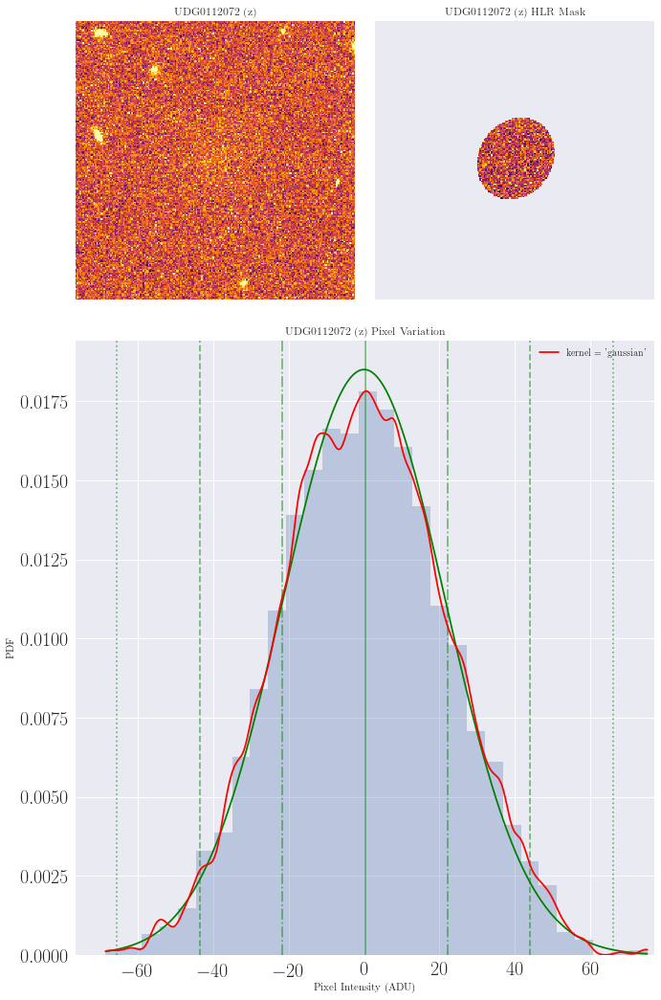

UDG0112072 (z) 
	Background Mean:   1877.539 ADU 
	Background StDev:  0.043 ADU 
	Galaxy Mean:       0.222 ADU 
	Galaxy Median:     -0.047 ADU 
	Galaxy StDev:      21.558 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 0.209 ADU


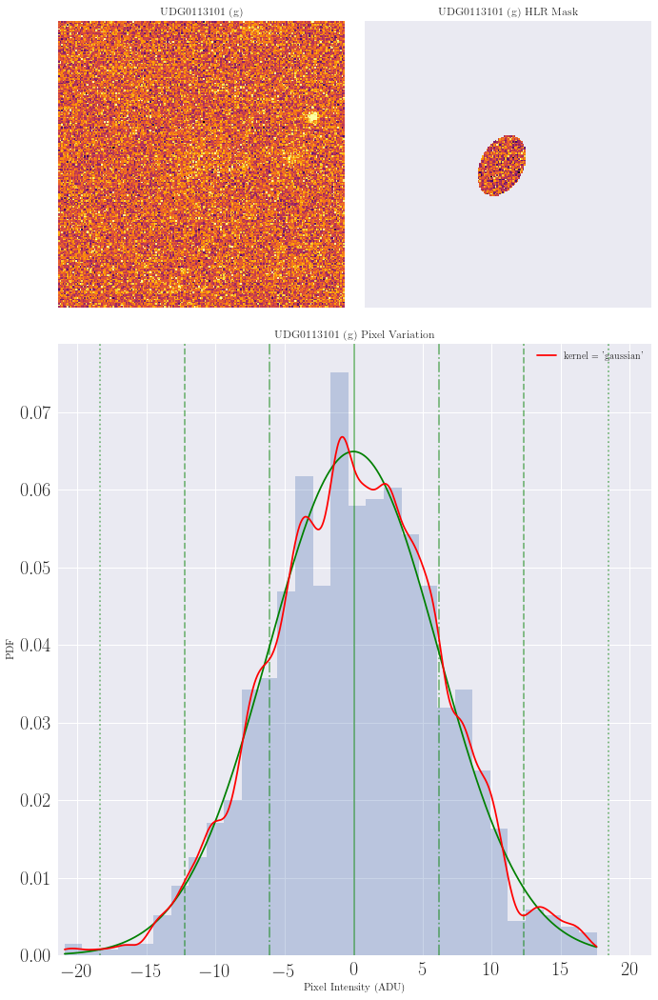

UDG0113101 (g) 
	Background Mean:   128.445 ADU 
	Background StDev:  0.000 ADU 
	Galaxy Mean:       0.087 ADU 
	Galaxy Median:     0.096 ADU 
	Galaxy StDev:      6.144 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 1.083 ADU


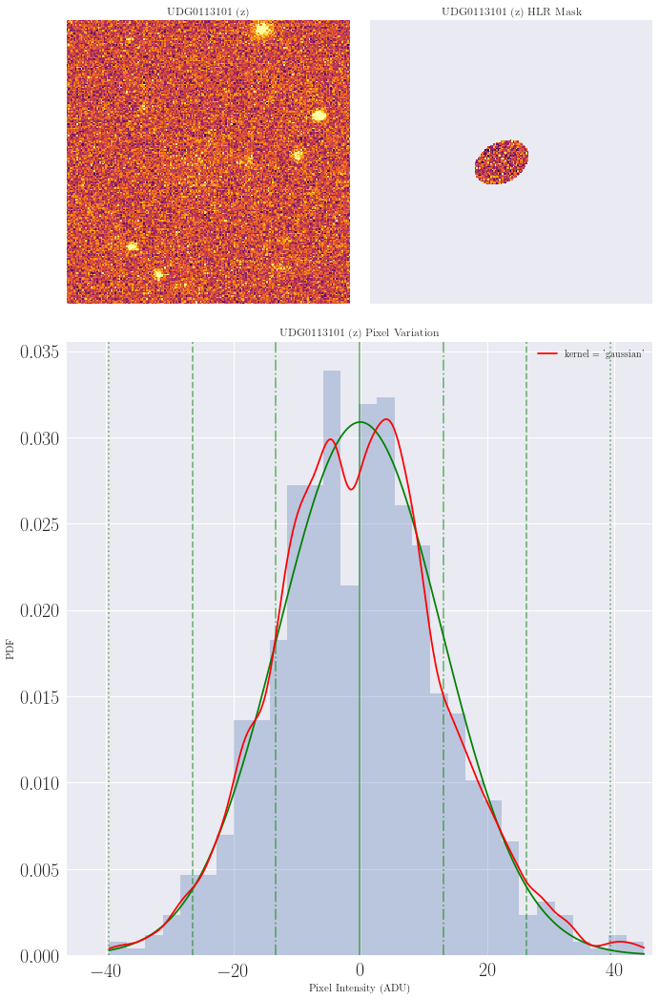

UDG0113101 (z) 
	Background Mean:   1305.134 ADU 
	Background StDev:  0.001 ADU 
	Galaxy Mean:       -0.123 ADU 
	Galaxy Median:     -0.151 ADU 
	Galaxy StDev:      12.913 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 0.215 ADU


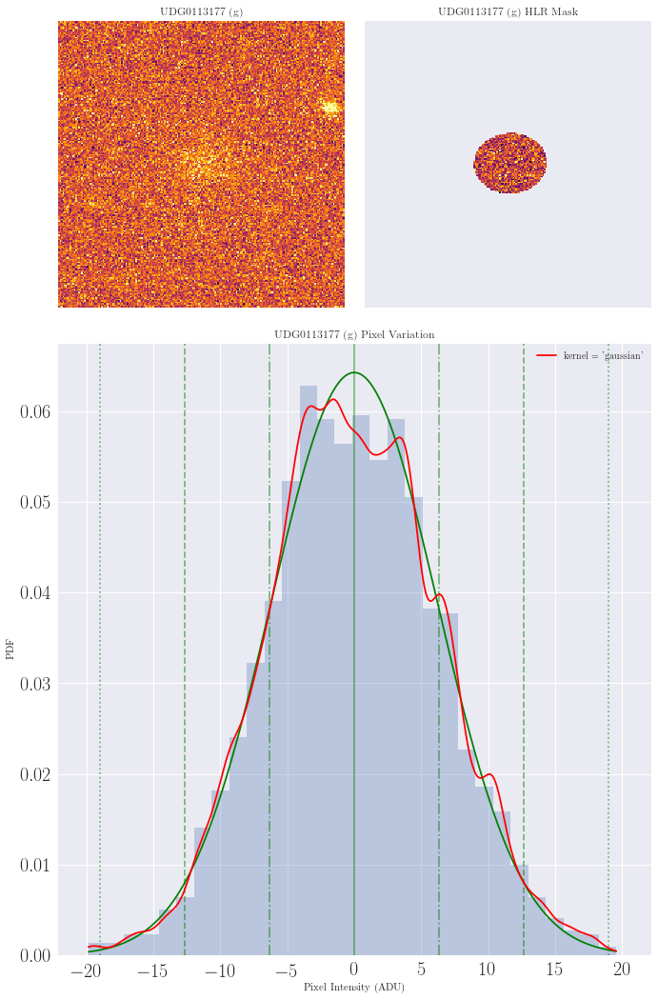

UDG0113177 (g) 
	Background Mean:   128.257 ADU 
	Background StDev:  0.005 ADU 
	Galaxy Mean:       0.025 ADU 
	Galaxy Median:     -0.113 ADU 
	Galaxy StDev:      6.207 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 1.657 ADU


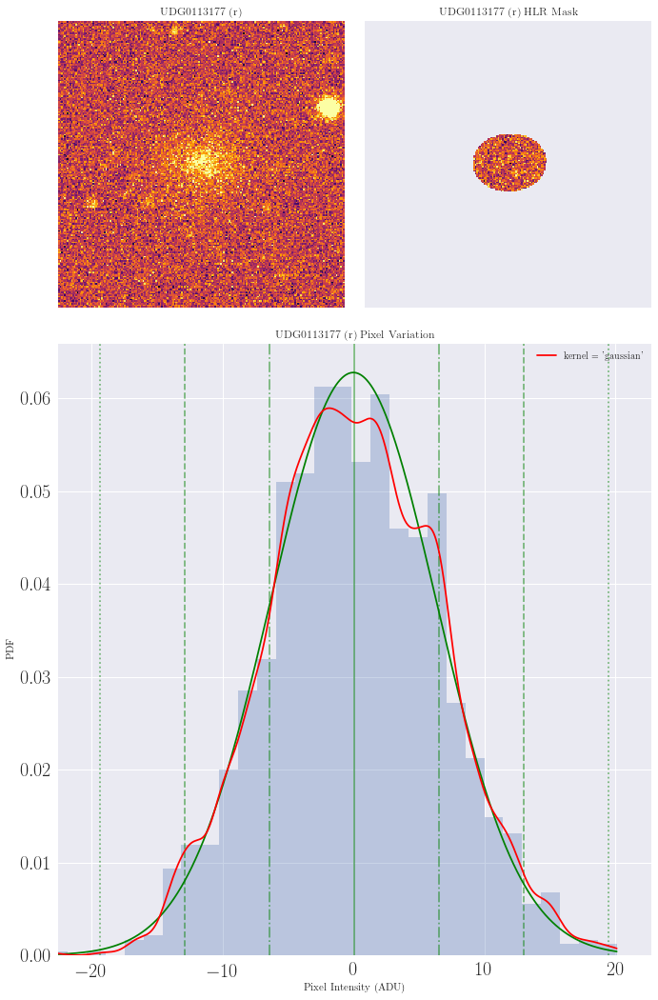

UDG0113177 (r) 
	Background Mean:   385.274 ADU 
	Background StDev:  0.011 ADU 
	Galaxy Mean:       0.096 ADU 
	Galaxy Median:     -0.042 ADU 
	Galaxy StDev:      6.354 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 1.548 ADU


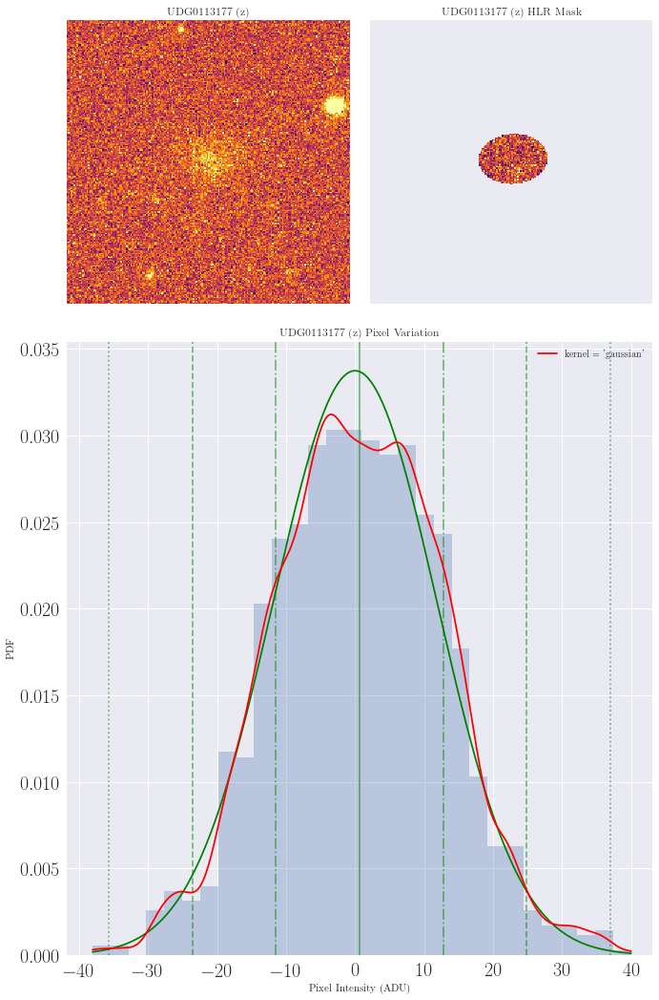

UDG0113177 (z) 
	Background Mean:   1614.255 ADU 
	Background StDev:  0.007 ADU 
	Galaxy Mean:       0.642 ADU 
	Galaxy Median:     0.525 ADU 
	Galaxy StDev:      11.821 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 0.367 ADU


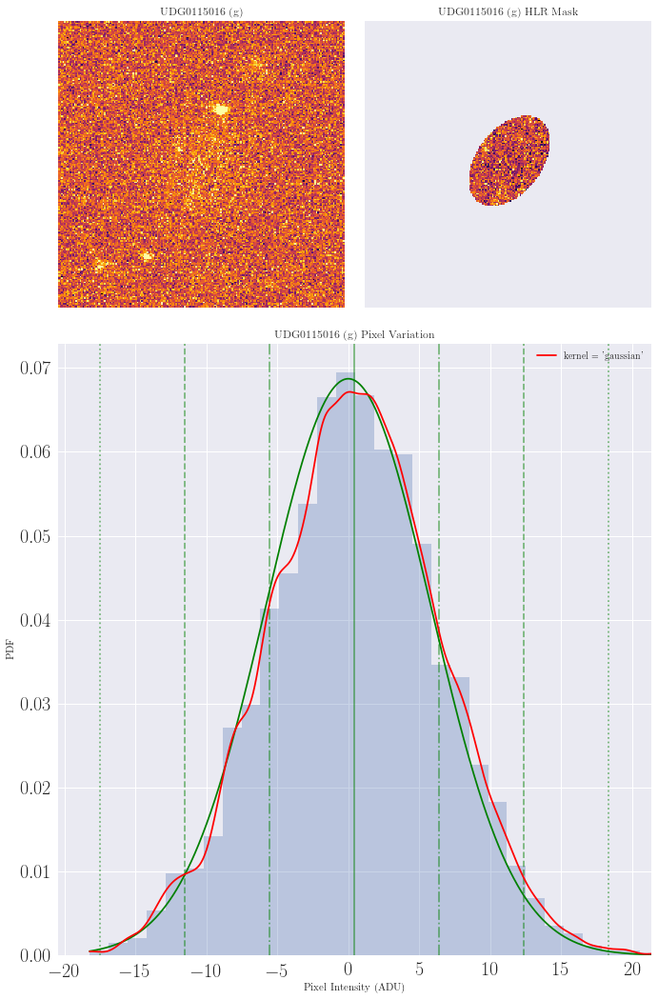

UDG0115016 (g) 
	Background Mean:   128.485 ADU 
	Background StDev:  0.014 ADU 
	Galaxy Mean:       0.443 ADU 
	Galaxy Median:     0.418 ADU 
	Galaxy StDev:      5.807 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 2.888 ADU


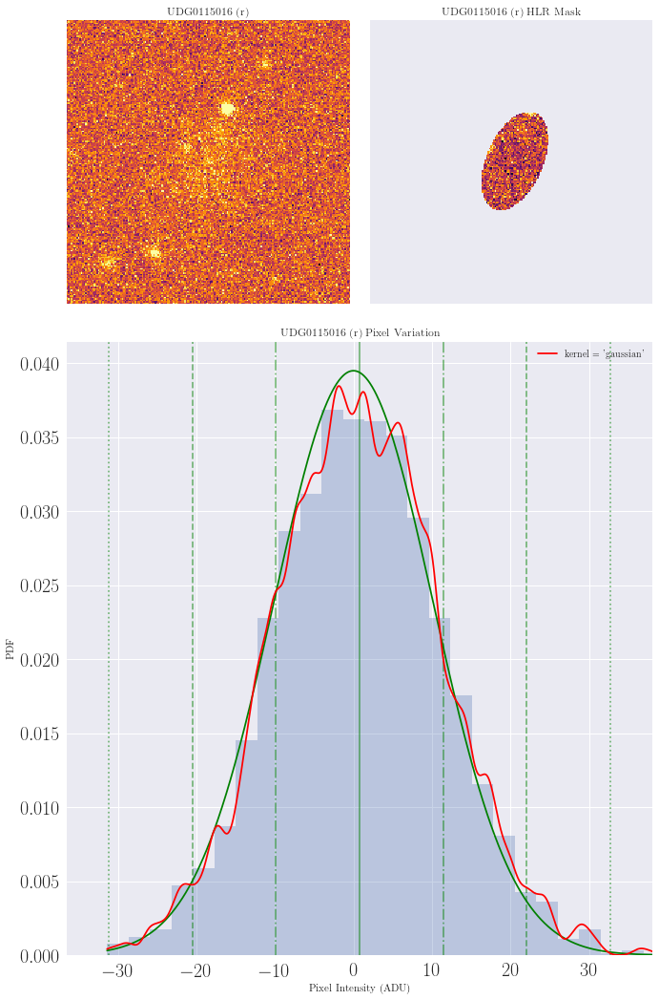

UDG0115016 (r) 
	Background Mean:   393.022 ADU 
	Background StDev:  0.020 ADU 
	Galaxy Mean:       0.770 ADU 
	Galaxy Median:     0.626 ADU 
	Galaxy StDev:      10.106 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 0.857 ADU


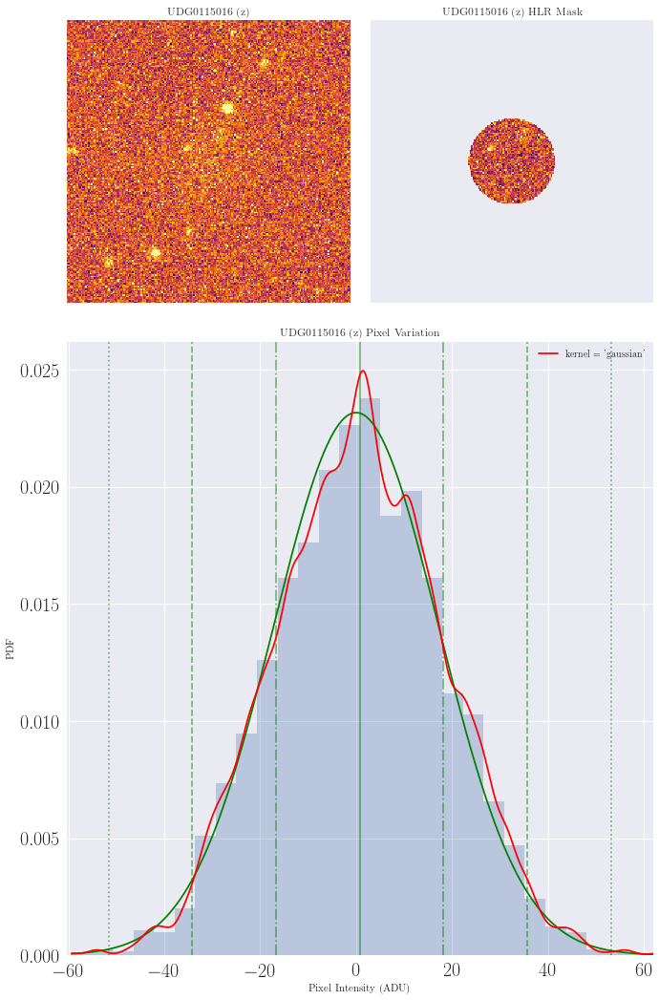

UDG0115016 (z) 
	Background Mean:   1212.140 ADU 
	Background StDev:  0.045 ADU 
	Galaxy Mean:       0.780 ADU 
	Galaxy Median:     0.865 ADU 
	Galaxy StDev:      17.214 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 0.376 ADU


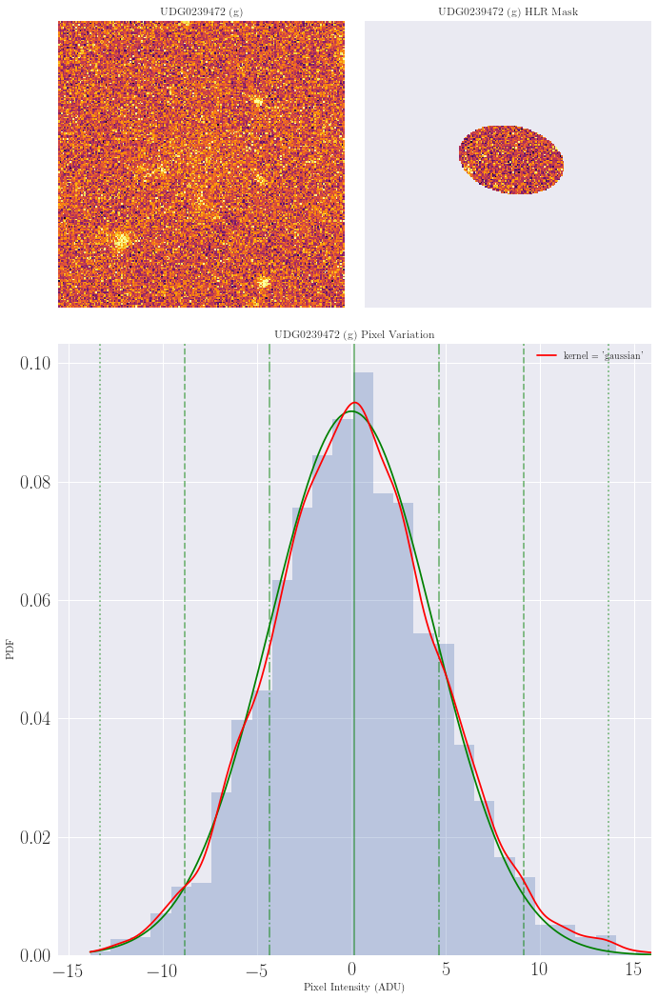

UDG0239472 (g) 
	Background Mean:   137.834 ADU 
	Background StDev:  0.009 ADU 
	Galaxy Mean:       0.162 ADU 
	Galaxy Median:     0.098 ADU 
	Galaxy StDev:      4.342 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 5.633 ADU


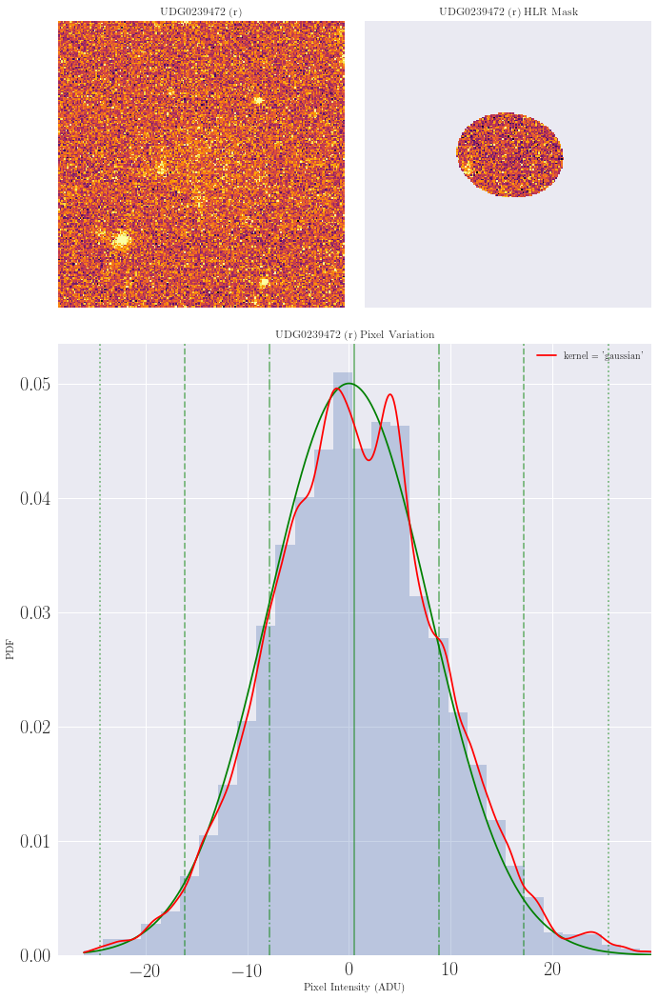

UDG0239472 (r) 
	Background Mean:   251.738 ADU 
	Background StDev:  0.038 ADU 
	Galaxy Mean:       0.553 ADU 
	Galaxy Median:     0.395 ADU 
	Galaxy StDev:      7.970 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 2.074 ADU


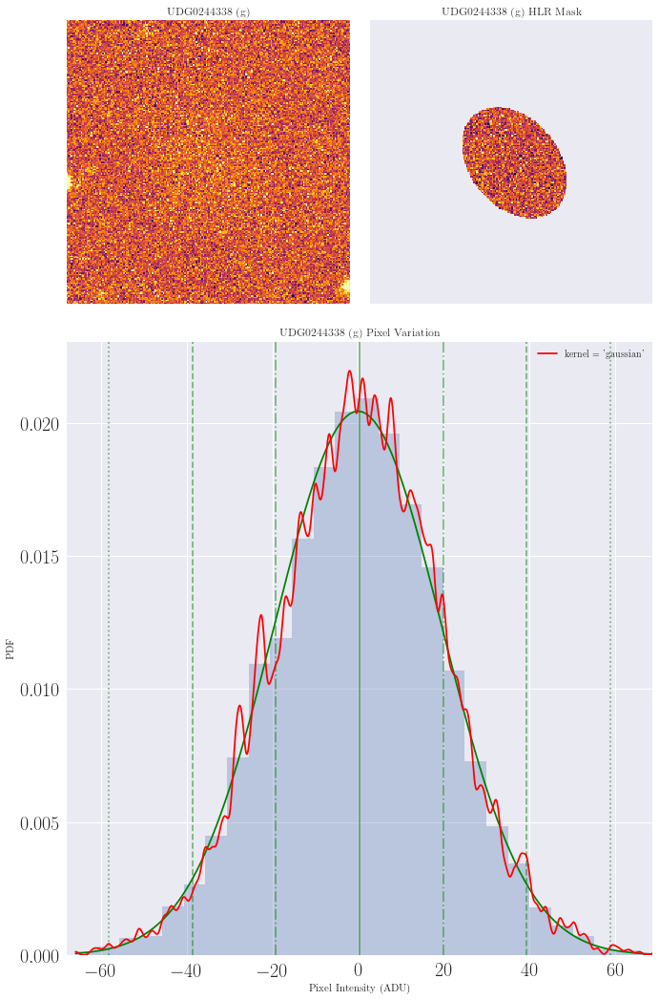

UDG0244338 (g) 
	Background Mean:   2490.794 ADU 
	Background StDev:  0.163 ADU 
	Galaxy Mean:       0.352 ADU 
	Galaxy Median:     0.490 ADU 
	Galaxy StDev:      19.518 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 0.451 ADU


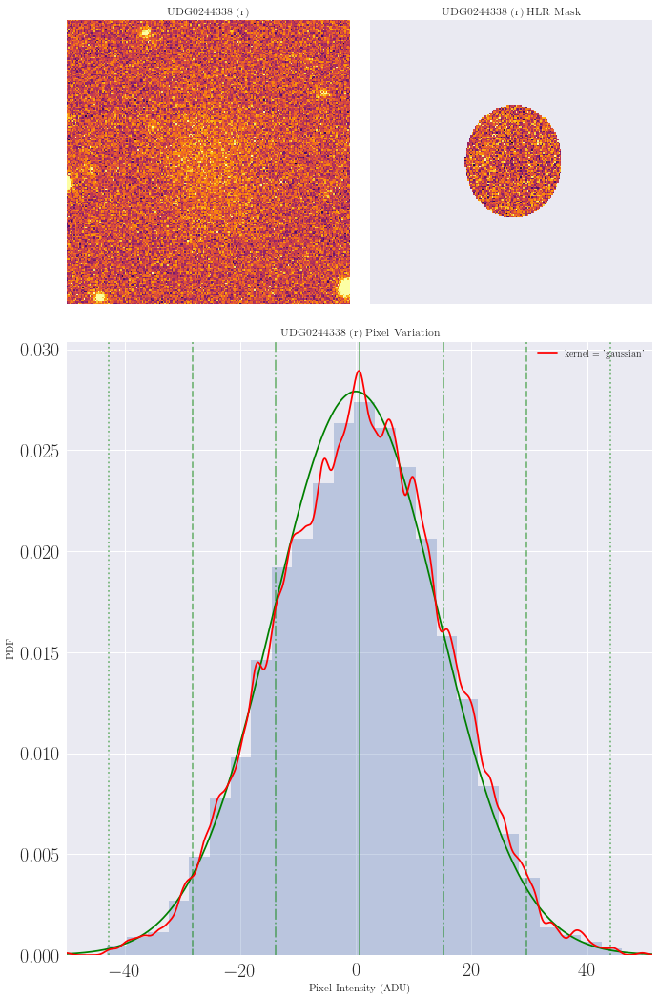

UDG0244338 (r) 
	Background Mean:   2804.242 ADU 
	Background StDev:  0.255 ADU 
	Galaxy Mean:       0.640 ADU 
	Galaxy Median:     0.711 ADU 
	Galaxy StDev:      14.293 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 0.807 ADU


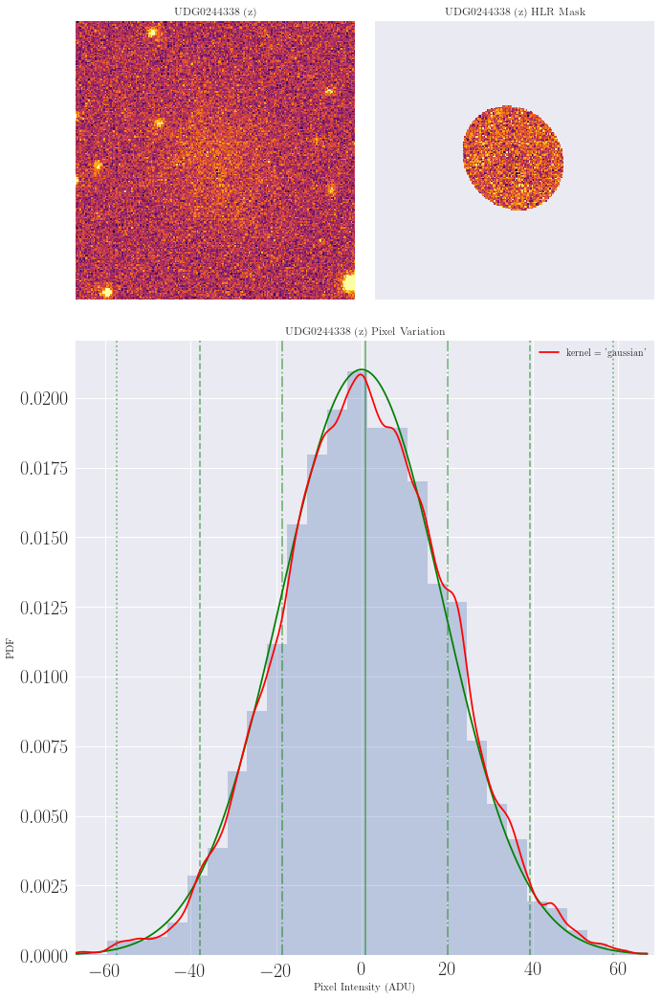

UDG0244338 (z) 
	Background Mean:   2823.670 ADU 
	Background StDev:  0.330 ADU 
	Galaxy Mean:       0.801 ADU 
	Galaxy Median:     0.506 ADU 
	Galaxy StDev:      18.976 ADU 
	Recessional Vel:   nan ADU 
	Mean Square Error: 0.454 ADU


In [22]:
from matplotlib import gridspec

for obs in obs_list:
    
    if obs.process == False:
        
        data = fits.getdata(obs.get_res())
        mask = fits.getdata(obs.get_mask()) > 0.5

        obs.kde = plot_kde(data, mask=mask, band=obs.band, background=(obs.bkg_mean, obs.bkg_stdev), file=obs.get_basename() + kde_ext + png_file)
        obs.mse = set_mse(obs)

        print("{0} ({1})".format(obs.name, obs.band),
              "\n\tBackground Mean:   %.3f ADU" % obs.bkg_mean,
              "\n\tBackground StDev:  %.3f ADU" % obs.bkg_stdev,
              "\n\tGalaxy Mean:       %.3f ADU" % obs.gal_mean,
              "\n\tGalaxy Median:     %.3f ADU" % obs.gal_median,
              "\n\tGalaxy StDev:      %.3f ADU" % obs.gal_stdev,
              "\n\tRecessional Vel:   %.3f ADU" % obs.velocity,
              "\n\tMean Square Error: %.3f ADU" % obs.mse)

        del [data, mask]
        gc.collect()
        
        obs.process = True


### Serializing / Pickling UDGs: Save Objects as Files

In [23]:
for obs in obs_list:

    create_directory(pickle_dir)
    file = os.path.join(pickle_dir, "{0}{1}.pkl".format(obs.name, obs.band))
    
    with open(file, 'wb') as f:
        pickle.dump(obs, f)
    f.close()
    
    del obs
    
# del obs_list

#### Optional: Load Pickled Objects into Pandas DF to Skip Data Generation Steps

In [150]:
obs_list = []

for file in g.glob(os.path.join(pickle_dir,'*.pkl')):
    obs_list.append(pd.read_pickle(file))
    
    """
    with open(file, 'rb') as f:
        obs_list.append(pickle.load(f))
    f.close()
    """

### Pixel Variations vs. Recessional Velocity

### Interactive Plot

In [24]:
from bokeh.plotting import figure, output_file, show, ColumnDataSource
from bokeh.models import HoverTool, NumeralTickFormatter

for some_band in ['g','r','z']:

    data = list(map(list, zip(*[[obs.name, obs.velocity, obs.mse, obs.radius_eff, obs.get_res().replace('res.fits','kde.png')] for obs in obs_list \
              if obs.velocity is not np.nan  \
              if obs.mse is not np.nan       \
              if some_band in obs.band])))

    some_name = data[0]
    some_vel  = data[1]
    some_mse  = data[2]
    some_rad  = data[3]
    some_kde  = data[4]

    c = [    'red'   if item > 4
        else 'green' if item > UDG_RADIUS
        else 'blue'  if item < UDG_RADIUS
        else 'black' for item in some_rad]

    
    
    output_file("pixval_{0}.html".format(some_band))

    source = ColumnDataSource(data=dict(
        x    = some_vel,
        y    = some_mse,
        r    = some_rad,
        s    = [6*(np.log10(radius)+3) if radius > 1.5 else 15 for radius in some_rad],
        desc = some_name,
        imgs = some_kde,
        col  = c
    ))

    hover = HoverTool( tooltips="""
        <style>
          .bordered {
            padding: 3px;
            border: 3px solid black;
          }
        </style>
        <div class="bordered">
            <div>
                <img
                    src=@imgs height="600" alt=@imgs width="400"
                    style="float: center; margin: 10px 10px 10px 10px;"
                    border="2"
                ></img>
                <div>
                    <span style="font-size: 30px; color: #669">@desc</span>
                </div>
            </div>
            <div>
                <span style="font-size: 30px;">Radius</span>
                <span style="font-size: 30px; color: #696;">   @r kpc</span>
            </div>
            <div>
                <span style="font-size: 30px;">Location</span>
                <span style="font-size: 30px; color: #696;">   ($x{int}, $y)</span>
            </div>
        </div>
        """
    )

    p = figure(plot_width=800, plot_height=1100, tools=[hover],
               title='{0}-band Pixel Variation'.format(some_band),
               x_axis_label='Recessional Velocity (km/s)',
               y_axis_label='MSE (Arbitrary Units)'
              )

    p.title.align = 'center'
    p.title.text_font_size = '25pt'
    p.xaxis.axis_label_text_font_size = "20pt"
    p.xaxis.major_label_text_font_size = "15pt"
    p.yaxis.axis_label_text_font_size = "20pt"
    p.yaxis.major_label_text_font_size = "15pt"

    p.min_border_top = 300
    p.min_border_bottom = 300

    p.circle('x', 'y', size='s', source=source, color=c, line_color="black", fill_alpha=0.7)

    show(p)

/Users/jennifer_kadowaki/anaconda/lib/python3.6/site-packages/bokeh/util/deprecation.py:34: BokehDeprecationWarning: 
Supplying a user-defined data source AND iterable values to glyph methods is deprecated.

See https://github.com/bokeh/bokeh/issues/2056 for more information.

  warn(message)
INFO:bokeh.core.state:Session output file 'pixval_r.html' already exists, will be overwritten.
/Users/jennifer_kadowaki/anaconda/lib/python3.6/site-packages/bokeh/util/deprecation.py:34: BokehDeprecationWarning: 
Supplying a user-defined data source AND iterable values to glyph methods is deprecated.

See https://github.com/bokeh/bokeh/issues/2056 for more information.

  warn(message)
INFO:bokeh.core.state:Session output file 'pixval_z.html' already exists, will be overwritten.
/Users/jennifer_kadowaki/anaconda/lib/python3.6/site-packages/bokeh/util/deprecation.py:34: BokehDeprecationWarning: 
Supplying a user-defined data source AND iterable values to glyph methods is deprecated.

See https://gi

# Discussion & Future Work

The plots above show the distribution of MSE given each wavelength (g-, r-, z-bands, respectively) for the true UDGs 

(red dots) and the spurious sources (blue crossmarks) for which we've attained spectroscopic redshifts. We must be careful when interpreting these results due to the lack of spurious sources in our data set and due to the high scatter around the best-fit line. However, in general, our contaminants have higher MSEs compared to the UDGs in our sample. This work shows promising preliminary results, suggesting that pixel variations can be used to determine the likelihood of the candidate being a true UDG.

In the future, I would like to implement the following:
1. Use cross-validation to more rigorously determine the appropriate bandwidth of KDE.
2. Acquire more LSB objects with spectroscopic redshifts to better constrain the fit.
3. Implement support vector machines to determine the thresholds separating UDGs from contaminants, given a the angular size of the object.

# NED Velocities

 OBJECT    | RA (J2000) | dec (J2000) | $cz$ (km/s) | $\theta$ (") | $R_\mathrm{eff}$ (kpc)
---------  | ---------- | ----------- | ----------- | ------------ | ----------------------    
UDG1220185 | 12:20:18.5 |  28:01:34   |    2282     |     12.7     | 1.9921
UDG1221576 | 12:21:57.6 |  28:14:36   |     450     |     30.9     | 0.9616
UDG1225265 | 12:25:26.5 |  28:29:10   |     483     |     29.4     | 0.9819
UDG1230359 | 12:30:35.9 |  27:33:12   |    -111     |     7.2      | 0.0554
UDG1239266 | 12:39:26.6 |  27:47:37   |      55     |     7.2      | 0.0274
UDG1240017 | 12:40:01.7 |  26:19:20   |     451     |     11.9     | 0.3711
UDG1253571 | 12:53:57.1 |  29:14:60   |      45     |     ----     | ---
UDG1255409 | 12:55:40.9 |  19:12:35   |     420     |    121.0     | 3.5148
UDG1302413 | 13:02:41.3 |  21:59:55   |     267     |     32.0     | 0.5912
UDG1328467 | 13:28:46.7 |  29:59:50   |   0.511     |      4.3     | 0.0001522

 OBJECT   | RA (J2000) | dec (J2000) | $cz$ (km/s) | $\theta$ (") | $R_\mathrm{eff}$ (kpc)
--------- | ---------- | ----------- | ----------- | ------------ | ----------------------    
DF03      | 13:02:16.5 |  28:57:17   |    10150    |           | 4.2
DF07      | 12:57:01.7 |  28:23:25   |    6587     |           | 4.3
DF08      | 13:01:30.4 |  28:22:28   |    7051     |           | 4.4
DF17      | 13:01:58.3 |  27:50:11   |    8311     |           | ---
DF30      | 12:53:15.1 |  27:41:15   |    7316     |           | 3.2
DF40      | 12:58:01.1 |  27:11:26   |    7792     |           | 2.9
PU0838589 | 08:38:58.9 |  26:04:28   |    ----     |           | ---
PU0914401 | 09:14:40.1 |  28:30:36   |    6558     |           | 4.5
PU1006233 | 10:06:23.3 |  28:52:19   |    1202     |           | 0.7
PU1217377 | 12:17:37.7 |  28:35:20   |    526      |           | 0.5
PU1221086 | 12:21:08.6 |  29:29:21   |    1287     |           | 2.4
PU1224081 | 12:24:08.1 |  28:05:45   |    37       |           | 0.04
PU1251013 | 12:51:01.3 |  27:47:53   |    6159     |           | 4.3
PU1304535 | 13:04:53.5 |  27:42:53   |    7333     |           | 4.6

# To Do List

### Memory Limit: Too many files open.
http://docs.astropy.org/en/stable/io/fits/appendix/faq.html#i-m-opening-many-fits-files-in-a-loop-and-getting-oserror-too-many-open-files

1. Set ulimit to (at minimum) 1000. (Preferably 10^4.)
2. Determine why os.system("ulimit -Sn 10000") does not work.

### Create a file to read in .Obs objects and bypass .Obs creation from scratch.
https://docs.python.org/3/library/pickle.html

### Cross-Validation on data set to check reproducibility.

### Create a more robust method to test whether model image is corrupt.
1. Enable try/except to bypass objects with corrupt models.
2. Determine why models are corrupt.
3. Fix models as needed.

### Update Results for March observing run.

### Implement Decision Trees, Random Forest, etc. (in addition to regression analysis) to determine appropriate cuts.
http://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestClassifier.html
http://scikit-learn.org/stable/auto_examples/ensemble/plot_forest_iris.html#sphx-glr-auto-examples-ensemble-plot-forest-iris-py


### Segment results for Coma Cluster, Stripe 82, etc.

### Create & Implement a Database Usin Queried by SQL

In [ ]:
data= pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/2014_usa_states.csv")


# Outdated Code

In [ ]:
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from plotly.graph_objs import Scatter, Figure, Layout
import plotly.plotly as py
import plotly.graph_objs as go

init_notebook_mode(connected=True)

iplot({
    "data": [Scatter(x= some_vel, y= some_mse,
                    mode= 'markers',
                    marker= dict(size= 14,
                                line= dict(width=1),
                                color= c,
                                opacity= 0.7),
                    name= y,
                    text= some_name)],
    
    "layout": Layout(title= 'Pixel Variation in {0}-band'.format(some_band),
                    hovermode= 'closest',
                    xaxis= dict(
                        title= 'Recession Velocity (km/s)',
                        ticklen= 5,
                        zeroline= False,
                        gridwidth= 2,
                    ),
                    yaxis=dict(
                        title= 'MSE (Arbitrary Units)',
                        ticklen= 5,
                        gridwidth= 2,
                    ),
                    showlegend= True
                )
})

In [ ]:
plt.rcParams.update({'font.size': 20})
plt.rc('xtick', labelsize=20) 
plt.rc('ytick', labelsize=20)

fig = plt.figure(figsize=(10,30))
fig.patch.set_facecolor('white')
ax1 = fig.add_subplot(311)
ax2 = fig.add_subplot(312)
ax3 = fig.add_subplot(313)

plot_list = [(ax1,'g'), (ax2,'r'), (ax3,'z')]
velocity  = np.linspace(0,10000,10)

for ax,band in plot_list:
    data  = [(obs.velocity, obs.mse, obs.radius_eff) for obs in obs_list if obs.velocity is not np.nan if band in obs.band]
    
    x,y,r = np.array(data).T
    
    ax.set_title("{0}-band Variation Plot".format(band))
    ax.set_xlabel(r"$cz$ (km/s)")
    ax.set_ylabel(r"MSE {0}-band (Arbitrary Units)".format(band))
    
    s = 50
    c = ['r' if item else 'b' for item in r > UDG_RADIUS]
    m = ['o' if item else 'x' for item in r > UDG_RADIUS]   
    
    for idx in np.arange(x.size):
        ax.scatter(x[idx], y[idx], color=c[idx], s=s, marker=m[idx])
    
    m,b = np.polyfit(x, y, 1)
    pred = m * velocity + b
    ax.plot(velocity, pred)

plt.savefig("pixel_variation.pdf")
plt.show()
plt.close()




In [ ]:
# Search for UDGs with the following parameters:
some_vel  = 500
some_band = 'g'
some_mse  = 2.0

results = [(obs.name, obs.velocity, obs.mse, obs.radius_eff) for obs in obs_list
    if obs.velocity > some_vel
    if some_band in obs.band
    if obs.mse < some_mse]

print("Name\t\t| Vel (km/s)\t| MSE\t\t| Radius (kpc)")
print("------------------------------------------------------------")
for res in results:
    print(res[0], "(" + some_band + ")\t|", res[1], " \t|", '%.3f' % res[2], "\t|", res[3])